<h1 align="center">Visual Behavior Neuropixels SWDB 2022 </h1>
<h2 align="center">Session Analysis for Representational Drift</h2>
<h3 align="center">Entrypoint</h3>

# 0. SET UP - Pick Session
set up the cache, define a session, view metadata and set up respective tables

### 0.1 imports

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec #Useful tool to arrange multiple plots in one figure (https://matplotlib.org/stable/api/_as_gen/matplotlib.gridspec.GridSpec.html)
from matplotlib.patches import Patch
from matplotlib.patches import Rectangle

from tqdm import tqdm 

from util import set_up_cache, get_session, plot_unit_spikes, plot_one_trial, plot_trials, plot_trials_chron, plot_trials_timeline, horizontal_bar_plot_trials, trials_data_description
from util_eda import get_missing_durations, create_unit_activity_vectors, plot_stimulus_presentations_with_activities, get_unit_activity_vectors_for_image, average_population_response_over_same_stimulus_presentations, count_same_image_appearences, extract_speed_and_pupil_data, plot_active_vs_passive_RS_running_speed_and_pupil_area_over_time, running_speeds_and_pupil_areas, count_all_same_image_appearences, construct_unit_activity_population_response_matrix
from util_RS_plots import specific_image, plot_layered_RS_running_speed_and_pupil_area_all_images, RS_behaviour_active_passive, RS_vs_time_avg_active_passive, correlation_between_picture_pair, RS_behaviour_avg, RS_vs_time_active_passive_within_blocks, tuning_curves_time_dependent, specific_image_z_scored_behaviour, plot_tuning_curves_time_dependent, get_all_tunings, show_tunings_norm_each_unit, show_tunings_norm_each_bin, plot_tuning_curves_time_dependent_all_images_layered, z_score_behaviour, z_score_behaviour_full
from optotagging import get_cre_pos_unit_ids_from_optotagging

%matplotlib inline

%load_ext autoreload
%autoreload 2
%aimport util

import util

### 0.2 set up cache

In [2]:
cache = set_up_cache()

In [3]:
ecephys_sessions_table = cache.get_ecephys_session_table()
ecephys_sessions_table.head()

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1044385384,1044408432,2020-08-19 14:47:08.574000+00:00,NP.1,EPHYS_1_images_G_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,151,2179.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'LGv...",G,30.0,1,Familiar,0,870,NaN,NaN
1044594870,1044624428,2020-08-20 15:03:56.422000+00:00,NP.1,EPHYS_1_images_H_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,152,2103.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'HPF...",H,0.0,2,Novel,1,872,NaN,NaN
1047969464,1048005547,2020-09-02 14:53:14.347000+00:00,NP.1,EPHYS_1_images_G_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,263,2438.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,62.0,1,Familiar,0,877,NaN,NaN
1047977240,1048009327,2020-09-02 15:15:03.733000+00:00,NP.0,EPHYS_1_images_G_3uL_reward,524925,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,165,1856.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,51.0,1,Familiar,0,878,NaN,NaN
1048189115,1048221709,2020-09-03 14:16:57.913000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,264,1925.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,879,NaN,NaN


In [4]:
len(ecephys_sessions_table)

103

In [5]:
sst_vip_sessions = ecephys_sessions_table[(ecephys_sessions_table['genotype'].str.contains('Sst')) | (ecephys_sessions_table['genotype'].str.contains('Vip'))]
len(sst_vip_sessions)

65

In [6]:
novel_sessions = ecephys_sessions_table[ecephys_sessions_table['experience_level']=='Novel']
novel_sessions['image_set'].value_counts()

H    42
G    10
Name: image_set, dtype: int64

### 0.3 pick mouse and session

In [7]:
ecephys_sessions_table[ecephys_sessions_table['experience_level']=='Novel'].head(3)

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1044594870,1044624428,2020-08-20 15:03:56.422000+00:00,NP.1,EPHYS_1_images_H_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,152,2103.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'HPF...",H,0.0,2,Novel,1,872,NaN,NaN
1048189115,1048221709,2020-09-03 14:16:57.913000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,264,1925.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,879,NaN,NaN
1048196054,1048222325,2020-09-03 14:25:07.290000+00:00,NP.0,EPHYS_1_images_H_3uL_reward,524925,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,166,2288.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,880,NaN,NaN


In [8]:
# ecephys_sessions_table[ecephys_sessions_table['mouse_id']==527749] # originial mouse
# ecephys_sessions_table[ecephys_sessions_table['mouse_id']==524761] # different mouse 1
ecephys_sessions_table[ecephys_sessions_table['mouse_id']==577287] # different mouse 2
# ecephys_sessions_table[ecephys_sessions_table['mouse_id']==568963] # different mouse 3 Vip

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1124285719,1124315985,2021-08-25 13:55:58.475000+00:00,NP.0,EPHYS_1_images_H_3uL_reward,577287,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,158,1801.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,1,Novel,0,1010,NaN,NaN
1124507277,1124536942,2021-08-26 14:32:42.128000+00:00,NP.0,EPHYS_1_images_G_3uL_reward,577287,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,159,2010.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,42.0,2,Familiar,1,1011,NaN,NaN


In [9]:
# sessionID = 1053941483  # 1 # Novel Session of Mouse with ID: 527749 sst (DAY 2, Novel, H)  (original)
sessionID = 1053718935  # 2 # Familiar Session of (same) Mouse with ID: 527749 sst (DAY 1, Familiar, G)
# sessionID = 1044385384  # 3 # Familiar Session of Mouse with ID: 524761 (different mouse, wt, f, DAY 1, G) 
# sessionID = 1124285719  # 4 # Novel Session of Mouse with ID: 577287 (H, DAY 1, f, sst)  (different)
# sessionID = 1111013640 # 5 # Familiar Session of Mouse with ID: 568963 (G, DAY 1, m, vip)
# sessionID = 1118327332

In [10]:
session = get_session(session_id=sessionID)

In [11]:
session.metadata

{'equipment_name': 'NP.1',
 'sex': 'M',
 'age_in_days': 179,
 'stimulus_frame_rate': 60.0,
 'session_type': 'EPHYS_1_images_G_3uL_reward',
 'date_of_acquisition': datetime.datetime(2020, 9, 30, 21, 27, 36, tzinfo=tzutc()),
 'reporter_line': 'Ai32(RCL-ChR2(H134R)_EYFP)',
 'cre_line': 'Sst-IRES-Cre',
 'behavior_session_uuid': None,
 'driver_line': ['Sst-IRES-Cre'],
 'mouse_id': 527749,
 'full_genotype': 'Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt',
 'behavior_session_id': 1053759573,
 'ecephys_session_id': 1053718935}

In [12]:
ecephys_sessions_table.loc[sessionID]

behavior_session_id                                                    1053759573
date_of_acquisition                              2020-09-30 14:27:36.212000+00:00
equipment_name                                                               NP.1
session_type                                          EPHYS_1_images_G_3uL_reward
mouse_id                                                                   527749
genotype                            Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt
sex                                                                             M
project_code                                             NeuropixelVisualBehavior
age_in_days                                                                   179
unit_count                                                                 2508.0
probe_count                                                                   6.0
channel_count                                                              2304.0
structure_acrony

In [13]:
ecephys_sessions_table.loc[sessionID].experience_level

'Familiar'

### 0.4 set up tables

In [14]:
stimulus_presentations = session.stimulus_presentations
# This table is a record of every stimulus we presented to the mouse over the course of this experiment
print(len(stimulus_presentations))
# stimulus_presentations.tail()
# stimulus_presentations.head()

13393


In [15]:
units = session.get_units()
# This table contains quality metrics and waveform metrics for every unit recorded during this session
units.head()

channels = session.get_channels()
# This table contains info about where each channel was in the brain as well as it's relative position along the probe.
channels.head(3)

# merge
units = units.merge(channels, left_on='peak_channel_id', right_index=True)
#units.head()

# how many units were recorded in each brain area for this session?
# units.value_counts('structure_acronym')

In [16]:
trials = session.trials
change_trials = trials[trials.is_change]
spike_times = session.spike_times
running_speed = session.running_speed
eye_tracking = session.eye_tracking
rewards = session.rewards

# 1. Pick Units 
specify which units are considered 'good' and from which brain regions

### 1.1 'good units' -> all ; VIS ;  VISp ; VIS \ VISp ; CA1 - Units

<div style="border-left: 3px solid #000; padding: 1px; padding-left: 10px; background: #F0FAFF; ">

Now that we have our change times, we're almost ready to make our PSTH. Next we need to get spike times for a good unit. To start out, let's filter our units dataframe for 'good' units, based on the following criteria:
    <p> &emsp; a) <code>quality</code> == 'good'
            <p> &emsp; b) <code>firing_rate</code> > 1 Hz
            <p> &emsp; c) <code>snr</code> > 1
            <p> &emsp; d) <code>isi_violations</code> < 1
                                                         
Then we'll grab an example unit from this curated list
</div>

In [17]:
# Filter units by the quality criteria
good_units = units[(units['quality']=='good') &
                   (units['firing_rate']>1) &
                   (units['snr']>1) &
                   (units['isi_violations']<1)]

len(good_units)

1337

In [18]:
good_units.head(1)

,PT_ratio,amplitude,amplitude_cutoff,cluster_id,cumulative_drift,d_prime,firing_rate,isi_violations,isolation_distance,l_ratio,...,waveform_duration,anterior_posterior_ccf_coordinate,dorsal_ventral_ccf_coordinate,filtering,left_right_ccf_coordinate,probe_channel_number,probe_horizontal_position,probe_id,probe_vertical_position,structure_acronym
id,,,,,,,,,,,,,,,,,,,,,
1061830308,0.413745,281.14827,0.056194,118,146.09,4.718301,28.548694,0.014405,89.97752,0.001004,...,0.192295,8203.0,3288.0,AP band: 500 Hz high-pass; LFP band: 1000 Hz l...,7024.0,79,27,1053896352,800,APN


In [19]:
good_VISp_units = good_units[good_units['structure_acronym']=='VISp']
good_CA1_units = good_units[good_units['structure_acronym']=='CA1']
good_VIS_units = good_units[good_units['structure_acronym'].str.contains('VIS')]
good_VISpm_units = good_units[good_units['structure_acronym'] == 'VISpm']
all_VISp_units = good_units[good_units['structure_acronym'].str.contains('VISp')]
len(good_CA1_units), len(good_VISp_units), len(good_VIS_units), len(good_VISpm_units), len(all_VISp_units)

(197, 57, 344, 82, 139)

In [20]:
good_non_VISp_units = good_units[good_units['structure_acronym']!='VISp']
good_VIS_without_VISp_units = good_non_VISp_units[good_non_VISp_units['structure_acronym'].str.contains('VIS')]

assert len(good_VIS_units) == (len(good_VIS_without_VISp_units)+len(good_VISp_units))

len(good_non_VISp_units), len(good_VIS_without_VISp_units), len(good_VIS_without_VISp_units)+len(good_VISp_units), len(good_VIS_units)
                                              

(1280, 287, 344, 344)

### 1.2 tagged units (OPTOTAGGING)

In [21]:
cre_pos_units_from_function = get_cre_pos_unit_ids_from_optotagging(session, structure_acronym='VIS')
print(cre_pos_units_from_function.flatten())

Number of trials: 150
[1061830571 1061830572 1061830578 1061830580 1061830569 1061830650
 1061830558 1061830500 1061830961 1061831189 1061831064 1061830971
 1061831053 1061831147 1061831069 1061831067 1061831038 1061831037
 1061831044 1061831043 1061831354 1061831328 1061831303 1061831352
 1061831374 1061831331 1061831323 1061831436 1061831396 1061831322
 1061831729 1061831727 1061831788 1061831720 1061831793 1061831754
 1061831795 1061831854 1061831725 1061831758 1061831737 1061831853
 1061831776 1061831813 1061831798 1061831865 1061831778 1061831815
 1061831779 1061831802 1061831706 1061831743 1061831886 1061831769
 1061831768 1061831774 1061831773 1061832308 1061832244 1061832214
 1061832245 1061832212 1061832242 1061832240 1061832247 1061832246
 1061832303 1061832236 1061832204 1061832205 1061832674 1061832698
 1061832669]


In [22]:
marked_VIS_units = cre_pos_units_from_function.flatten()
len(good_VIS_units), len(marked_VIS_units) # 88 with the ones that are not 'good' in original session

(344, 73)

In [23]:
VIS_units_tagged = good_units.loc[marked_VIS_units]
len(VIS_units_tagged)

73

In [24]:
# VIS_units_no_tag = good_units.loc[~marked_VIS_units]
VIS_units_no_tag = good_VIS_units[~good_VIS_units.index.isin(marked_VIS_units)]

assert len(VIS_units_no_tag) == len(good_VIS_units) - len(marked_VIS_units)

len(VIS_units_no_tag)

271

# 2. Construct Unit Activity Matrix (population response vectors)
 
 from picked units and spikes in each stimulus presentation

### 2.1 construct and plot RS
 

In [25]:
stimulus_presentations
(len(stimulus_presentations),len(stimulus_presentations[stimulus_presentations.stimulus_block == 0]))

(13393, 4798)

In [26]:
M_all_good = construct_unit_activity_population_response_matrix(good_units, spike_times, stimulus_presentations)


In [27]:
M_good_VIS = construct_unit_activity_population_response_matrix(good_VIS_units, spike_times, stimulus_presentations)


In [28]:
M_good_VISp = construct_unit_activity_population_response_matrix(good_VISp_units, spike_times, stimulus_presentations)


In [29]:
M_good_VIS_excld_VISp = construct_unit_activity_population_response_matrix(good_VIS_without_VISp_units, spike_times, stimulus_presentations)


In [30]:
M_good_CA1 = construct_unit_activity_population_response_matrix(good_CA1_units, spike_times, stimulus_presentations)


In [31]:
M_marked_VIS = construct_unit_activity_population_response_matrix(VIS_units_tagged, spike_times, stimulus_presentations)


In [32]:
M_VIS_no_tag = construct_unit_activity_population_response_matrix(VIS_units_no_tag, spike_times, stimulus_presentations)


### 2.2 show within image Correlation and between image-pair

(choose 2 images)

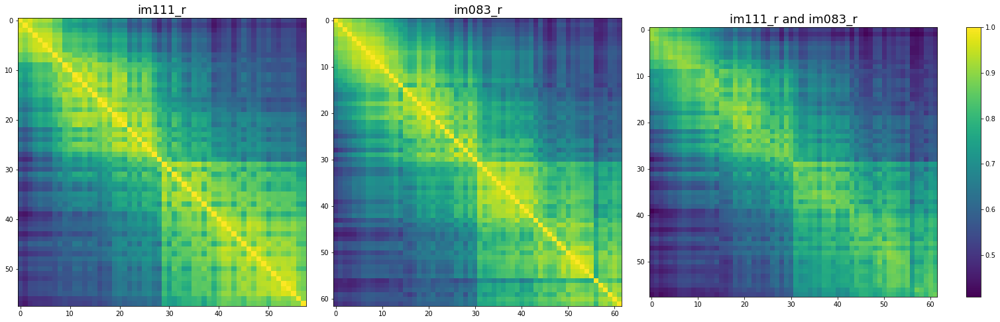

In [35]:
correlation_between_picture_pair('im111_r', 'im083_r', M_all_good, stimulus_presentations)

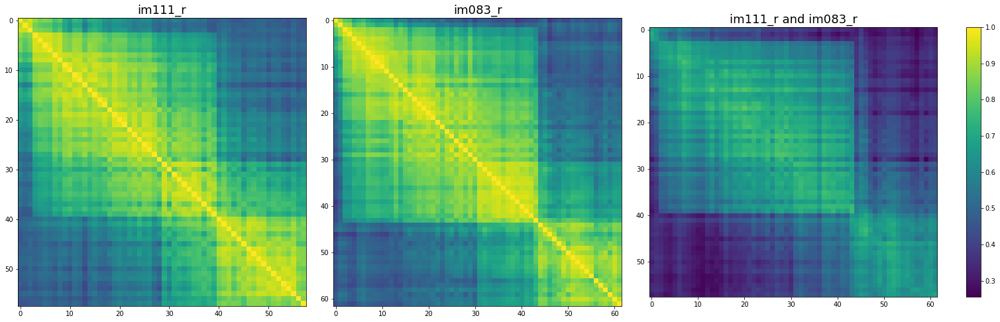

In [36]:
correlation_between_picture_pair('im111_r', 'im083_r', M_good_VIS, stimulus_presentations)

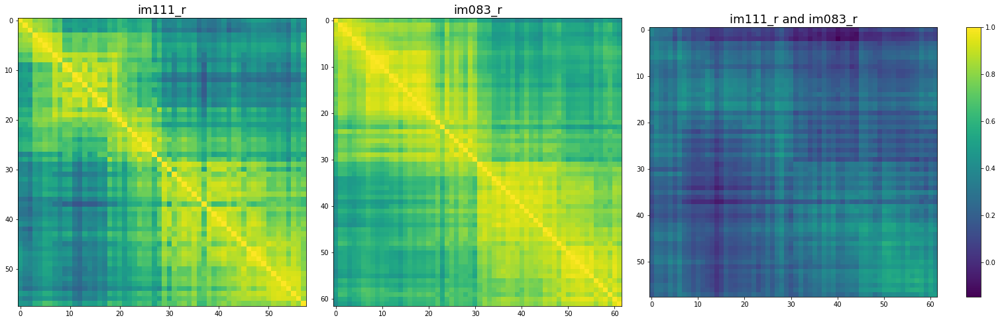

In [37]:
correlation_between_picture_pair('im111_r', 'im083_r', M_good_VISp, stimulus_presentations)

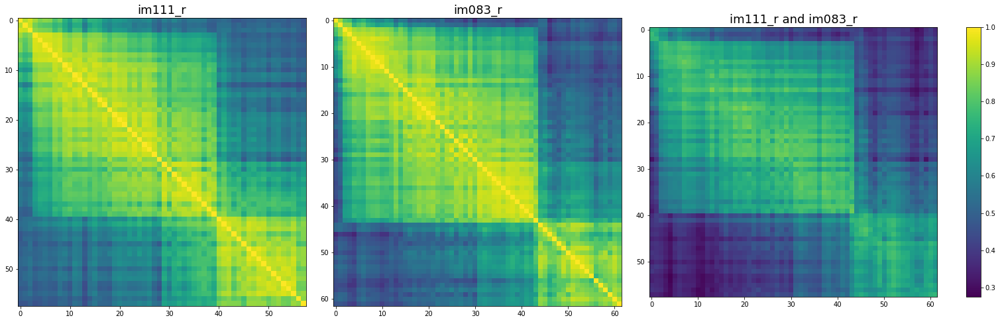

In [38]:
correlation_between_picture_pair('im111_r', 'im083_r', M_good_VIS_excld_VISp, stimulus_presentations)

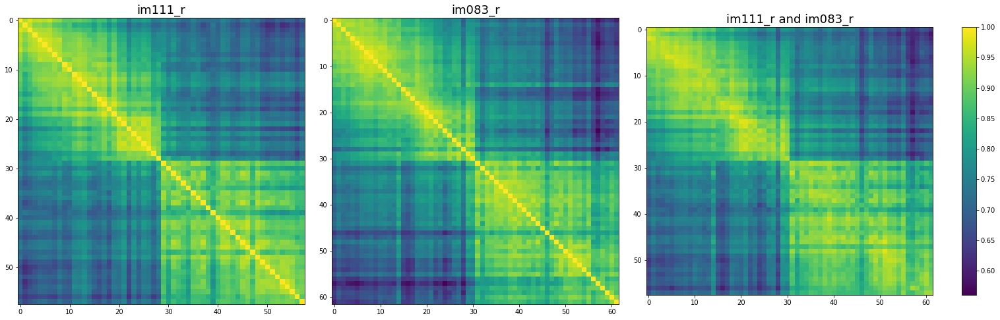

In [39]:
correlation_between_picture_pair('im111_r', 'im083_r', M_good_CA1, stimulus_presentations)

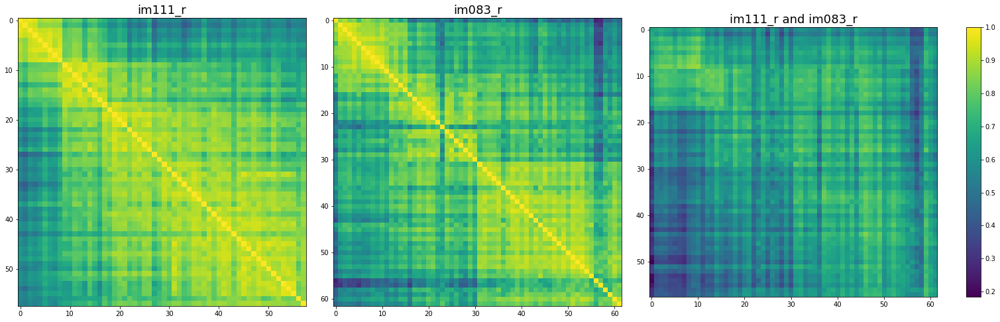

In [40]:
correlation_between_picture_pair('im111_r', 'im083_r', M_marked_VIS, stimulus_presentations)

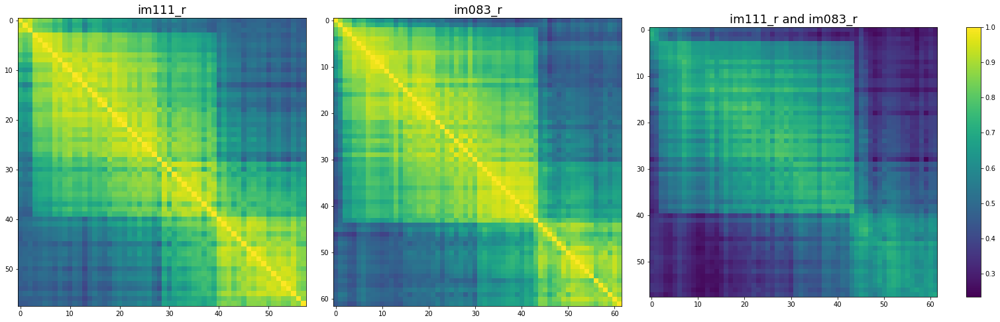

In [41]:
correlation_between_picture_pair('im111_r', 'im083_r', M_VIS_no_tag, stimulus_presentations)

### 2.3 final corrcoef matrix plot

In [33]:
dp = 360

In [34]:
# averaged:
def representational_similarity_correlation_matrix(image, M, stimulus_presentations, brain_structure, sessionID):
    M_im, M_im_b0, M_im_b5, t, t_S_E = average_population_response_over_same_stimulus_presentations(M, image, stimulus_presentations)

    C = np.corrcoef(np.transpose(M_im))
    
    n = len(C)
    half = int(n/2)
    title=f'Representational Similarity of {image[:-2]} in {brain_structure} \n sessionID={sessionID}'

    fig, axs = plt.subplots(1, figsize=(8, 8), dpi=dp)
    # fig.tight_layout()

    im0 = axs.imshow(C, origin='lower')
    axs.set_xlabel('stimulus presentations')
    axs.set_ylabel('active block                      |                  passive block', color='violet')

    axs.set_title(title, fontsize=20, y=1.05)
    axs.axhline(y=half, color='violet', linewidth=1, linestyle='-')
    axs.axvline(x=half, color='violet', linewidth=1, linestyle='-')
    fig.colorbar(im0, shrink=0.5)
    
    plt.savefig('plots/corrcoef1.png')
    

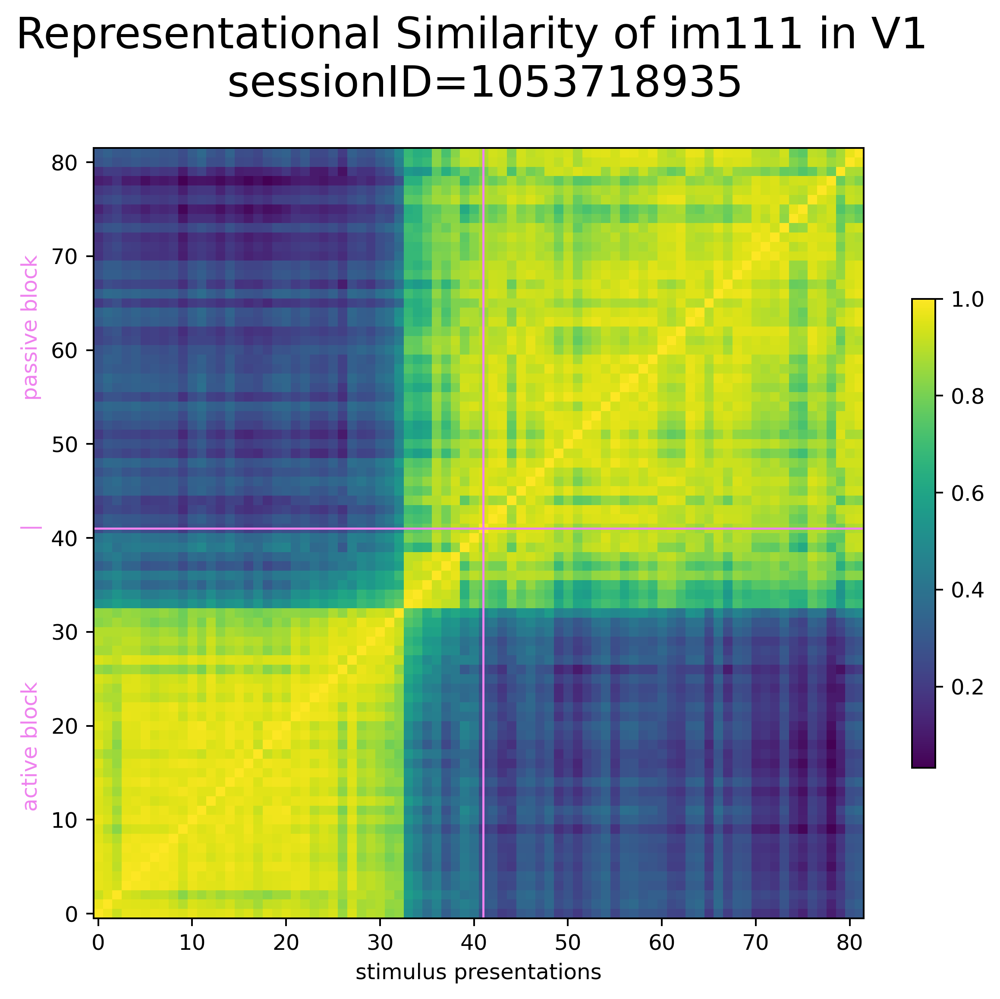

In [35]:
representational_similarity_correlation_matrix('im111_r', M_good_VISp, stimulus_presentations, 'V1', sessionID)

# 3. Representational Similarity, Pupil Area and Running Speed 
averaged over same image chains

In [36]:
valid_images = []
for im in stimulus_presentations.image_name.unique():
    if (im != 'omitted') and (type(im) is not float):
        valid_images.append(im)
        
print(valid_images)


['im036_r', 'im083_r', 'im111_r', 'im012_r', 'im115_r', 'im044_r', 'im047_r', 'im078_r']


### 3.1 one image
plot RS with Behaviour and Time for a specified image
 

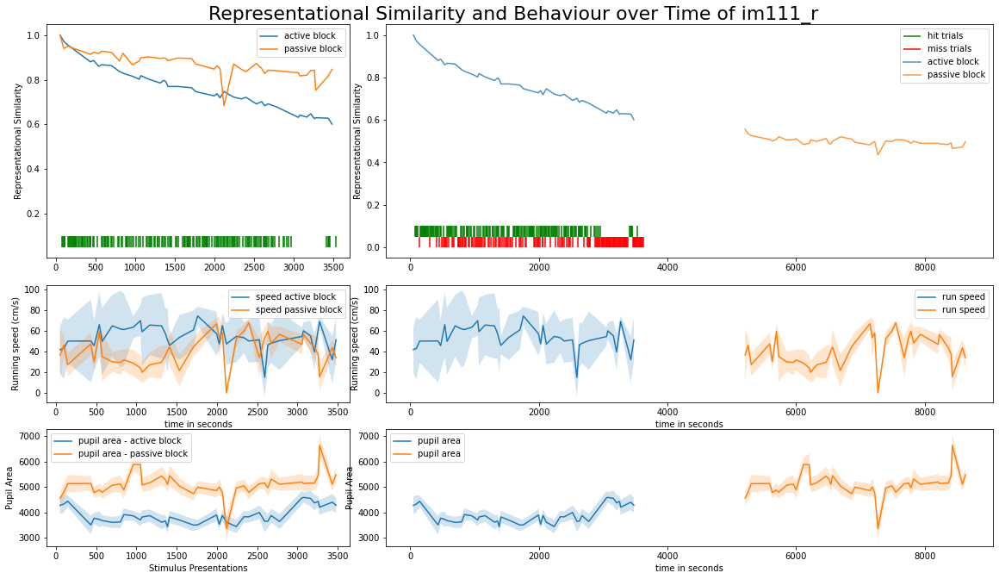

In [29]:
specific_image('im111_r', M_all_good, stimulus_presentations, running_speed, eye_tracking, change_trials)

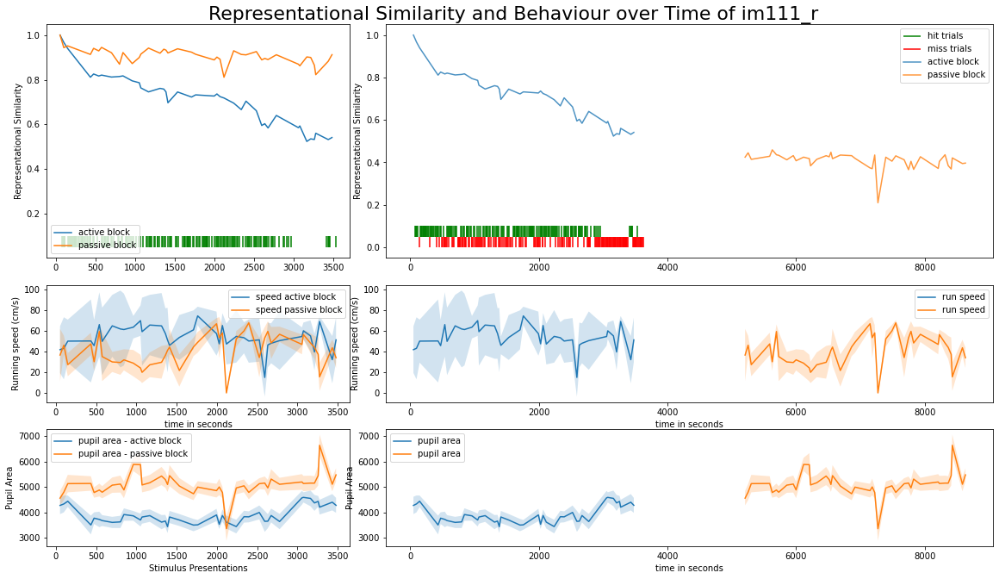

In [30]:
specific_image('im111_r', M_good_VIS, stimulus_presentations, running_speed, eye_tracking, change_trials)

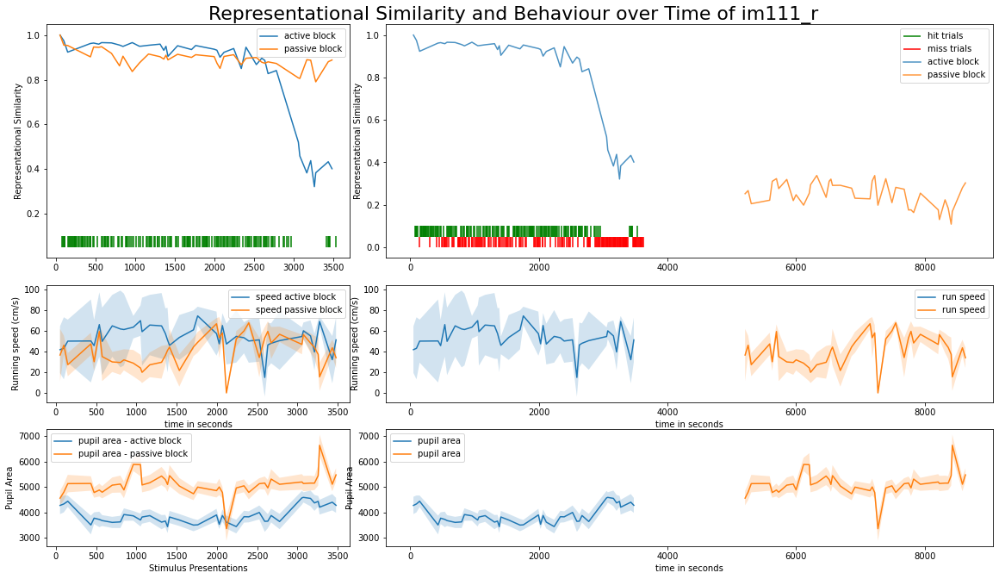

In [31]:
specific_image('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials)

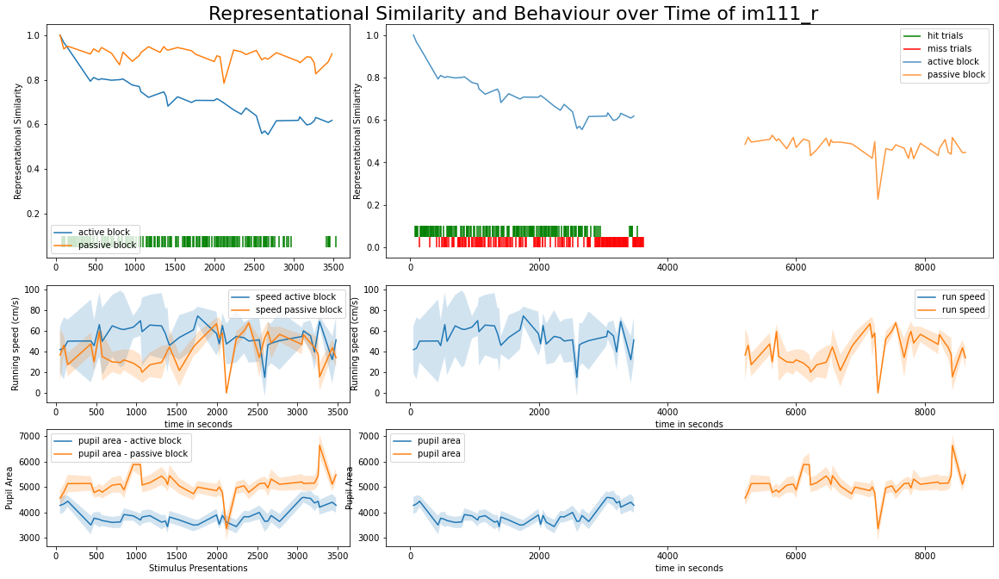

In [32]:
specific_image('im111_r', M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials)

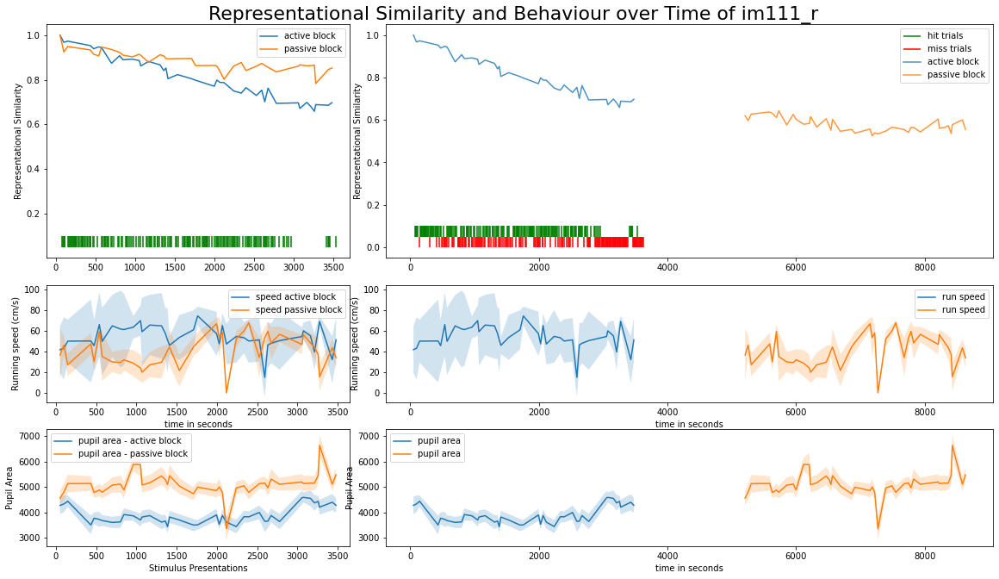

In [46]:
specific_image('im111_r', M_good_CA1, stimulus_presentations, running_speed, eye_tracking, change_trials)

### 3.2 all images layered
same plot with all images at once 

In [83]:
colors = ['blue', 'orange', 'purple', 'firebrick', 'cornflowerblue', 'darkblue', 'magenta', 'green', 'thistle']

In [84]:
sessionID

1124285719

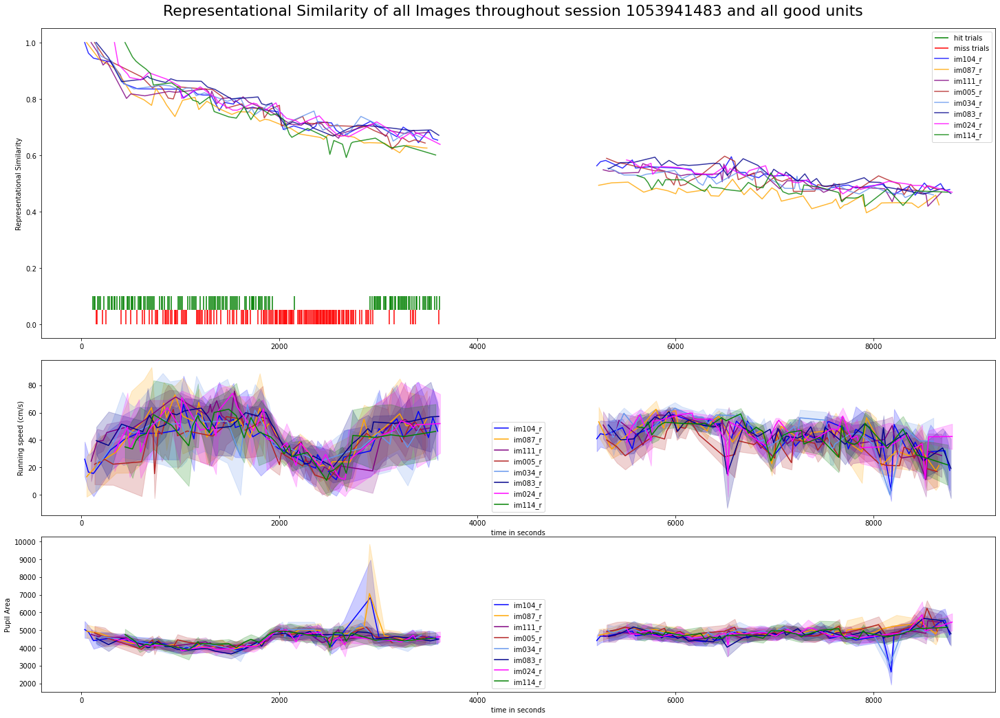

In [38]:
# print all images layered for M_all_good
title = f'Representational Similarity of all Images throughout session {sessionID} and all good units'
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_all_good, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)



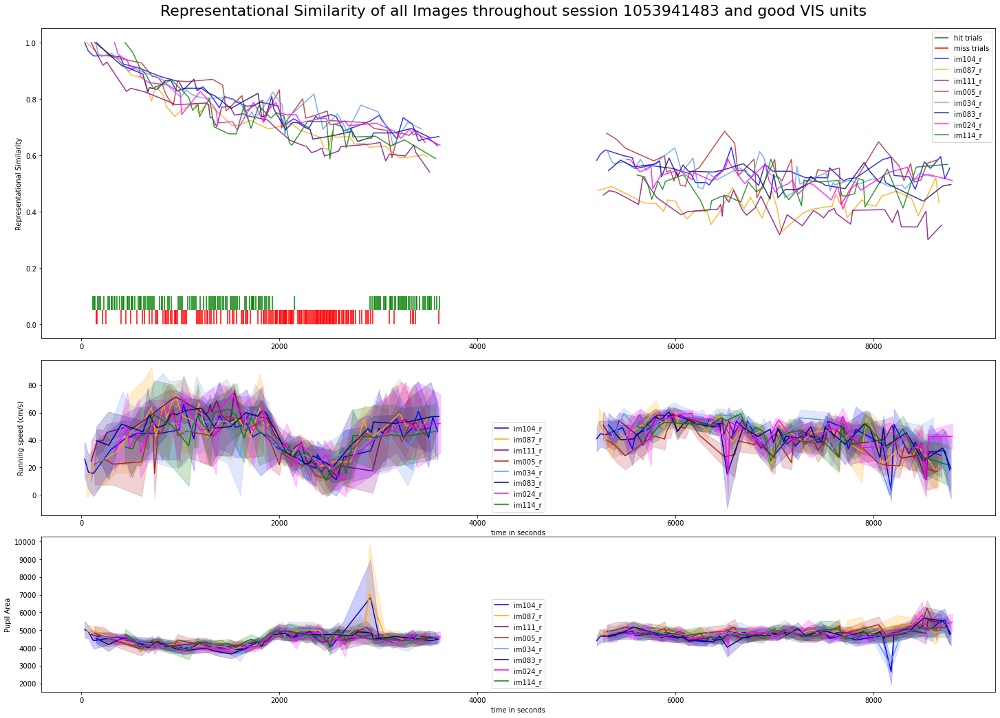

In [39]:
title = f'Representational Similarity of all Images throughout session {sessionID} and good VIS units'
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)


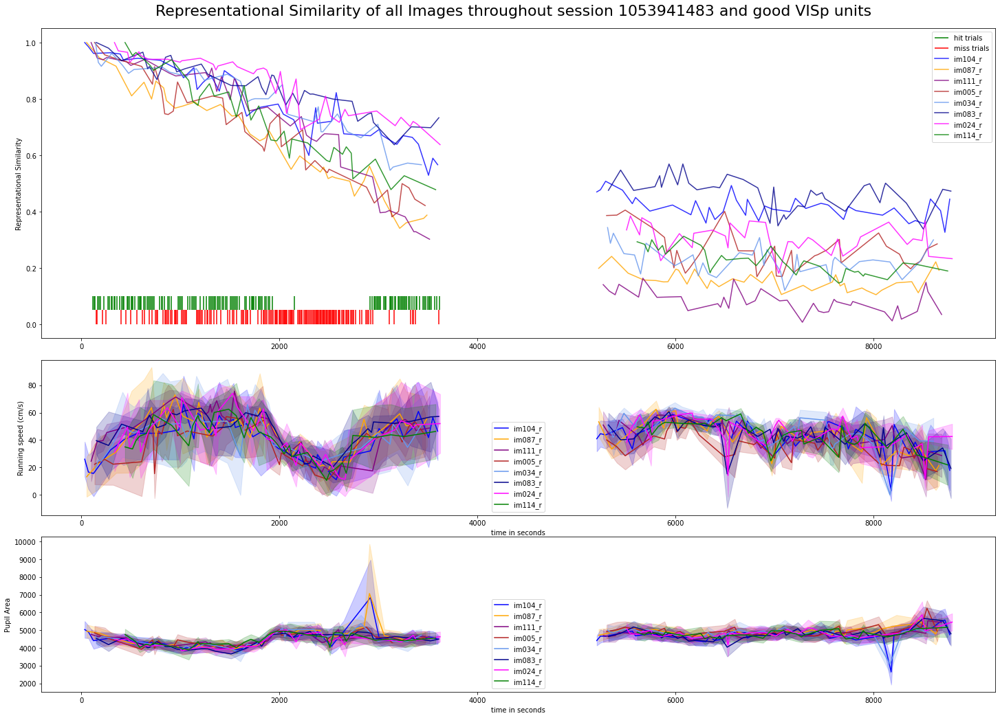

In [40]:

# print all images layered for M
title = f'Representational Similarity of all Images throughout session {sessionID} and good VISp units'
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)


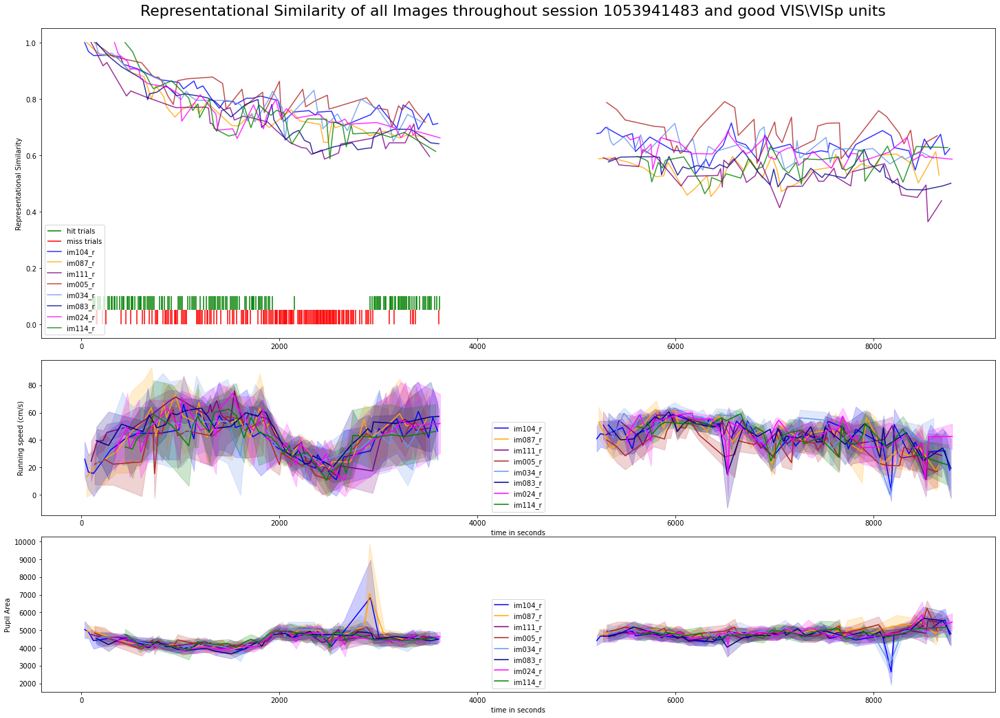

In [41]:
title = f'Representational Similarity of all Images throughout session {sessionID} and good VIS\VISp units'
# print all images layered for M
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)


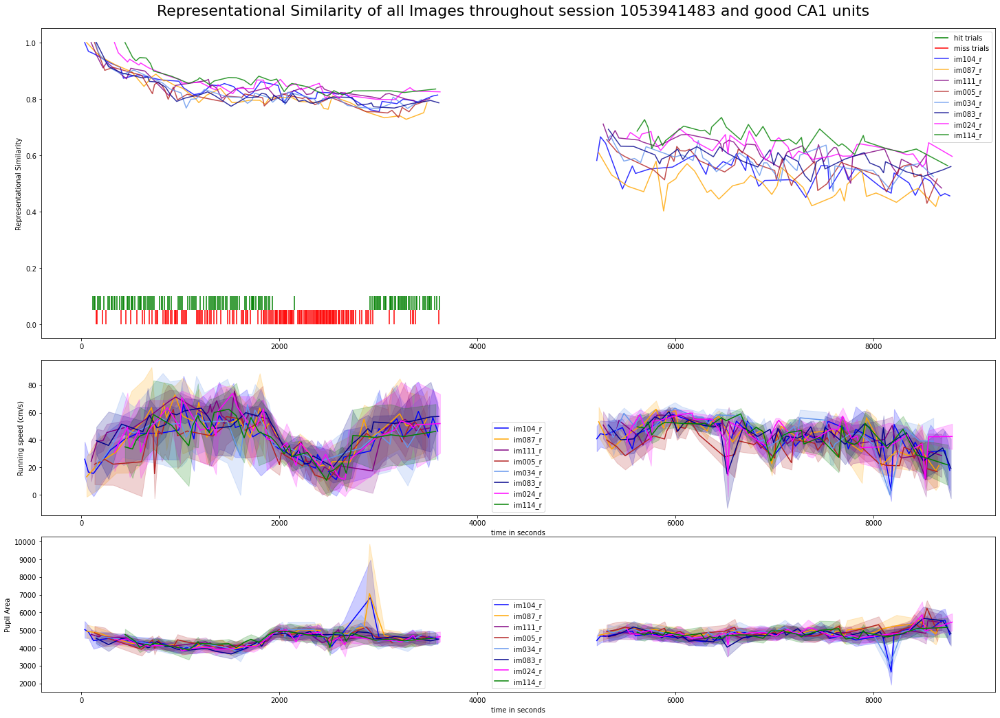

In [42]:
title = f'Representational Similarity of all Images throughout session {sessionID} and good CA1 units'
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)


### 3.3 each image
same plot for each image 

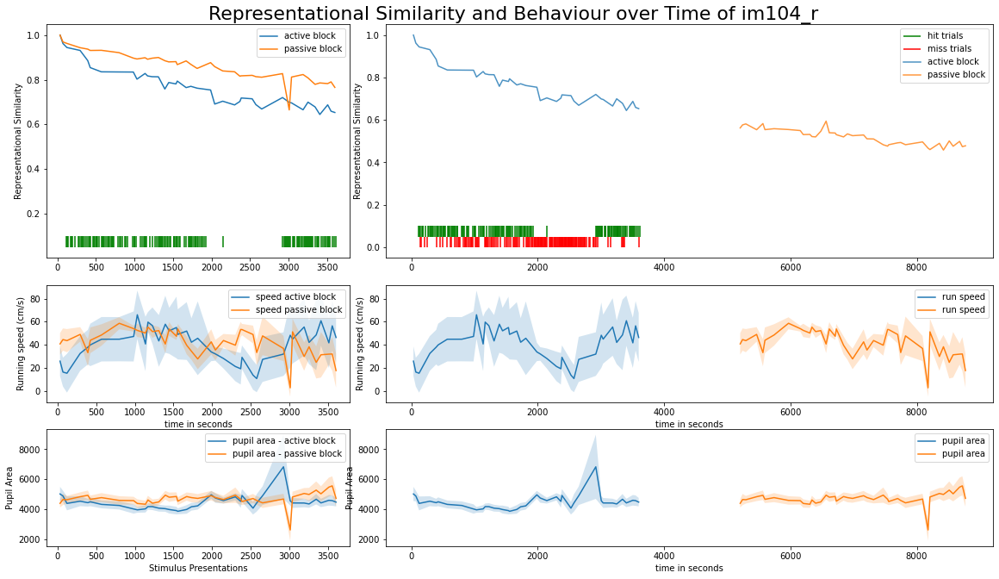

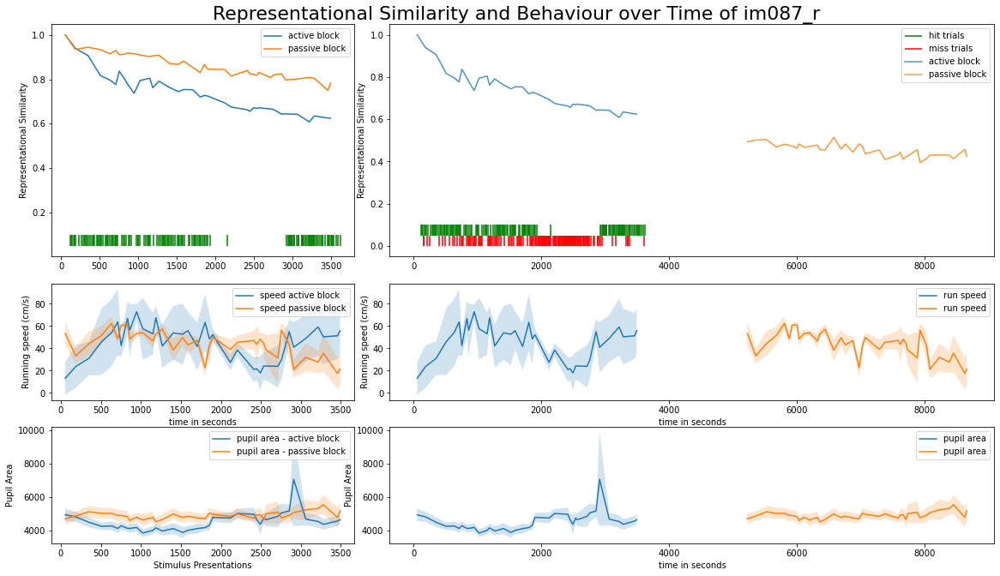

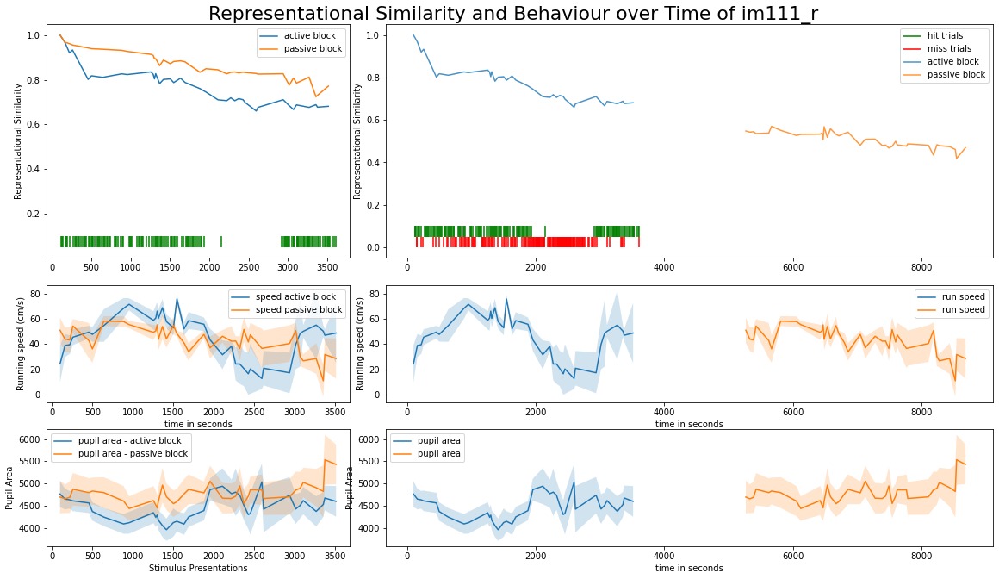

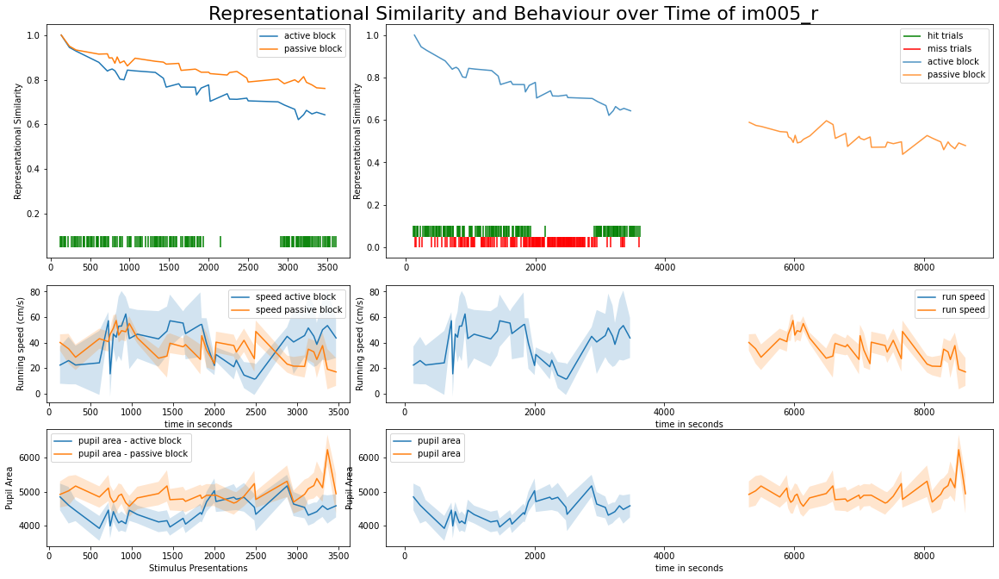

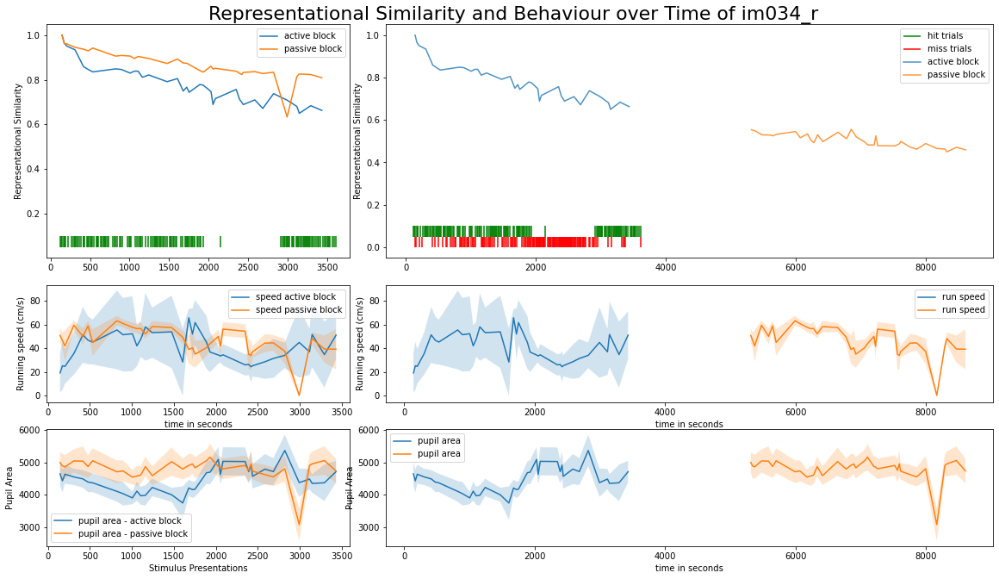

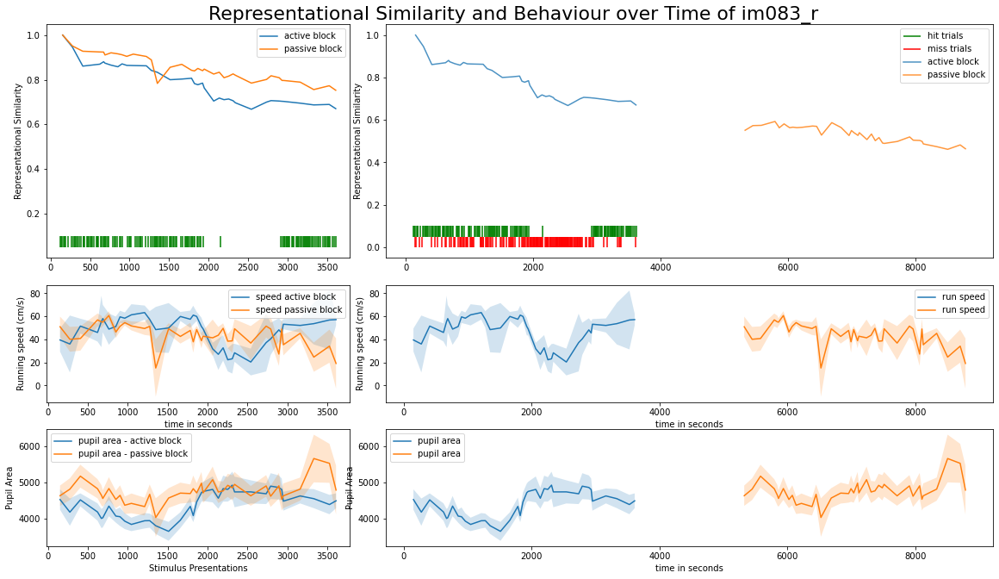

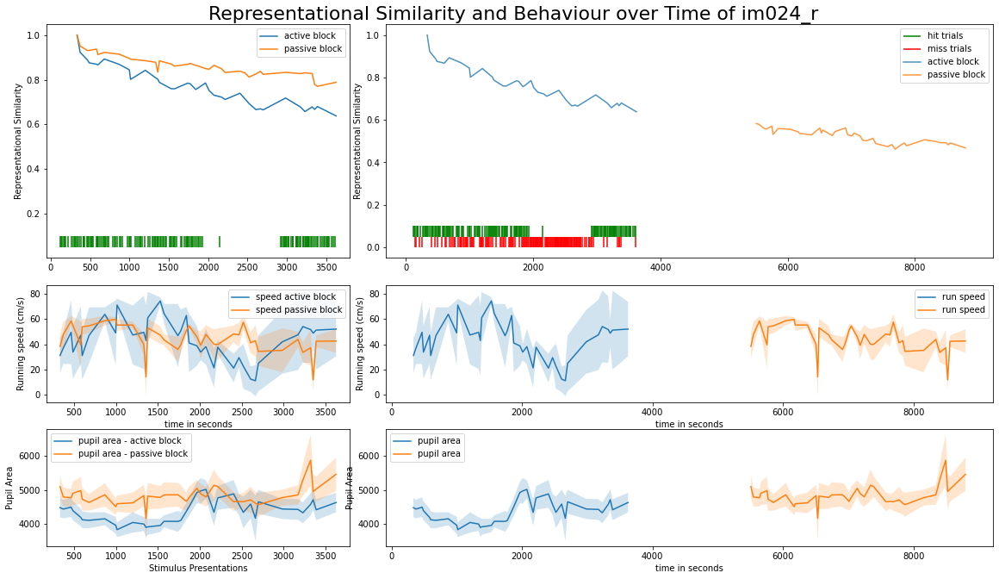

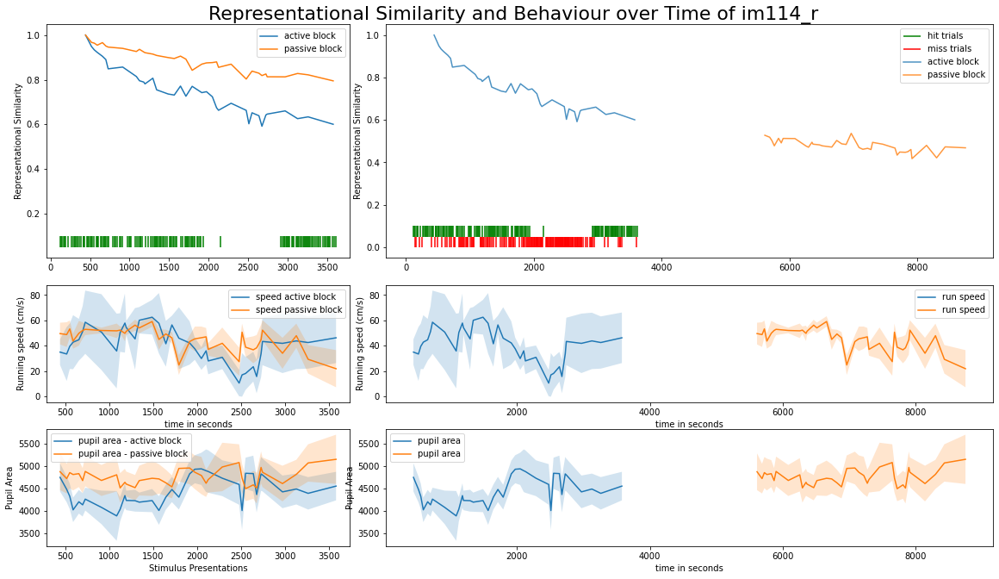

In [44]:
# print all images full information

for image in valid_images:
    specific_image(image, M_all_good, stimulus_presentations, running_speed, eye_tracking, change_trials)
    

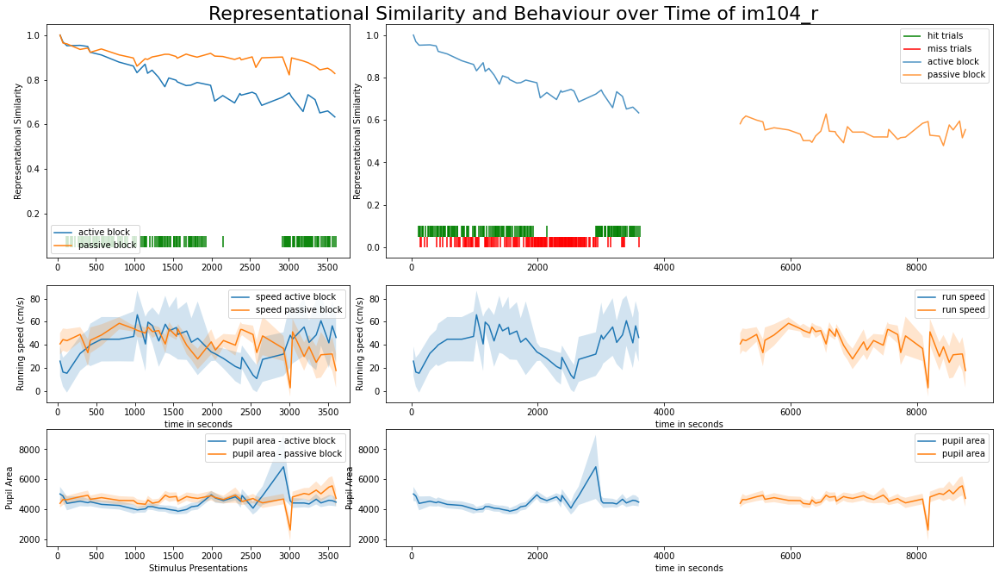

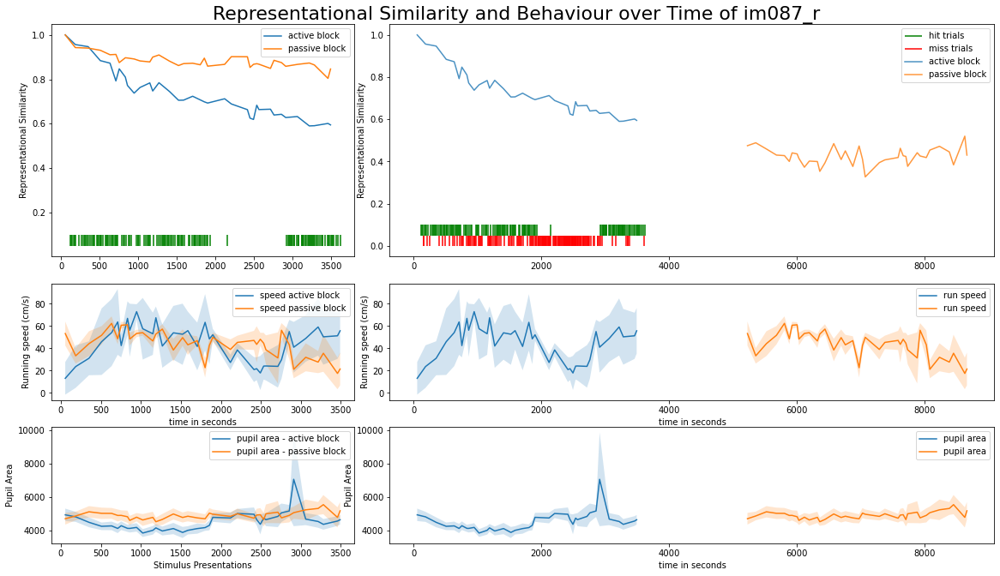

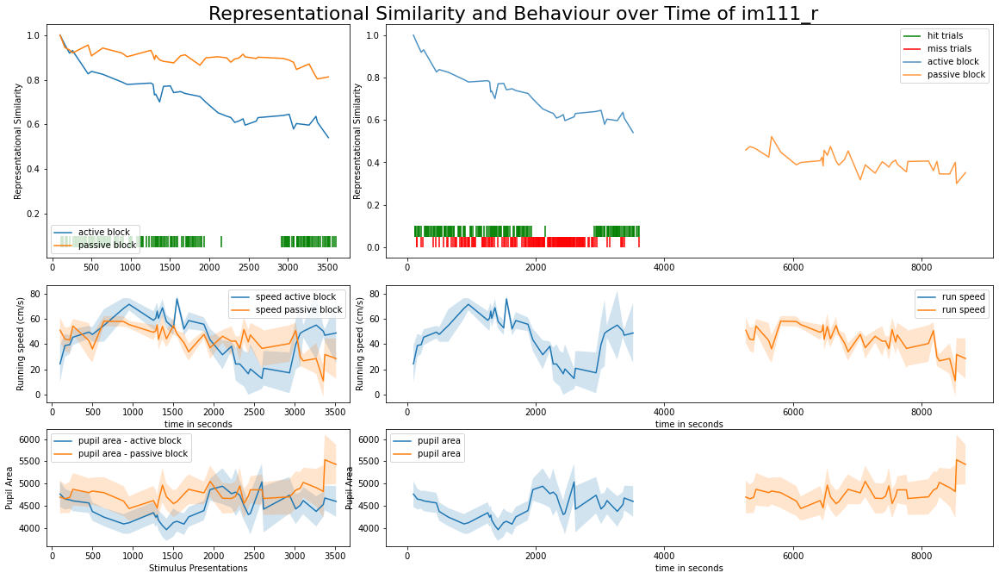

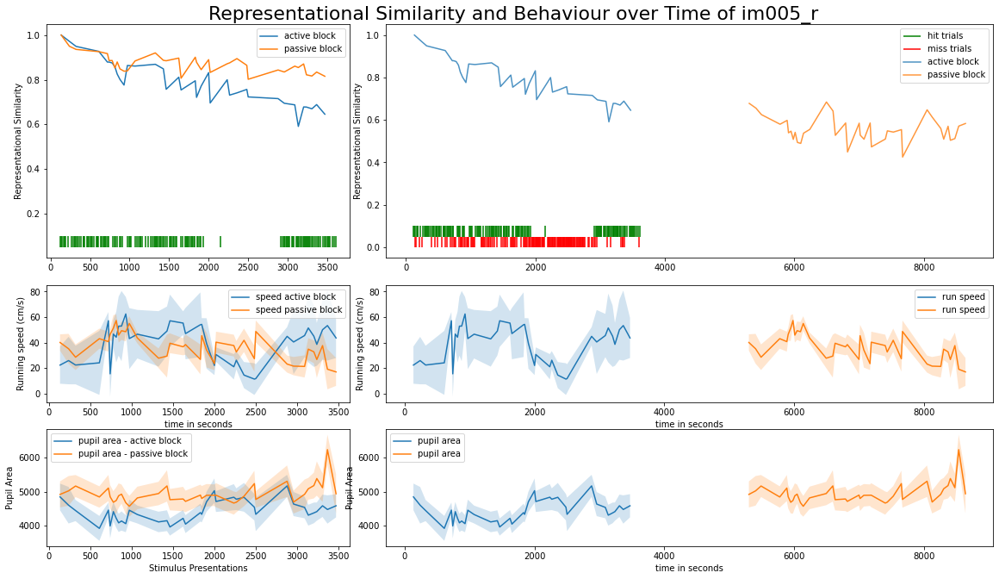

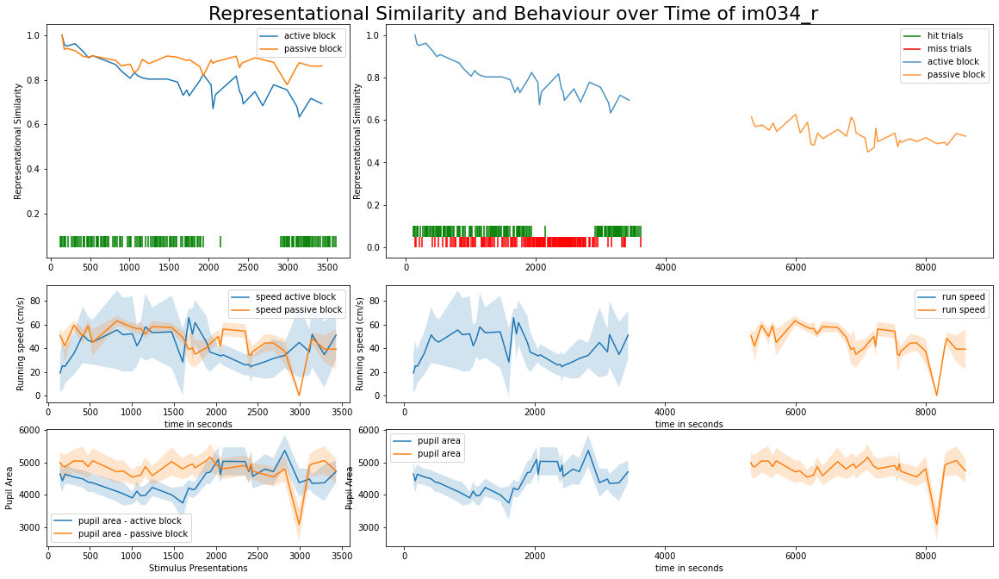

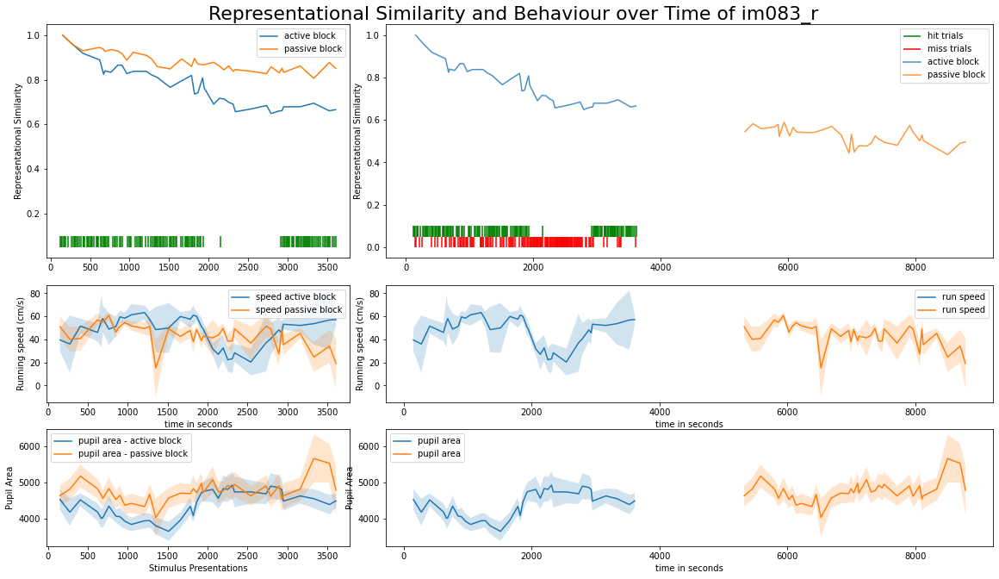

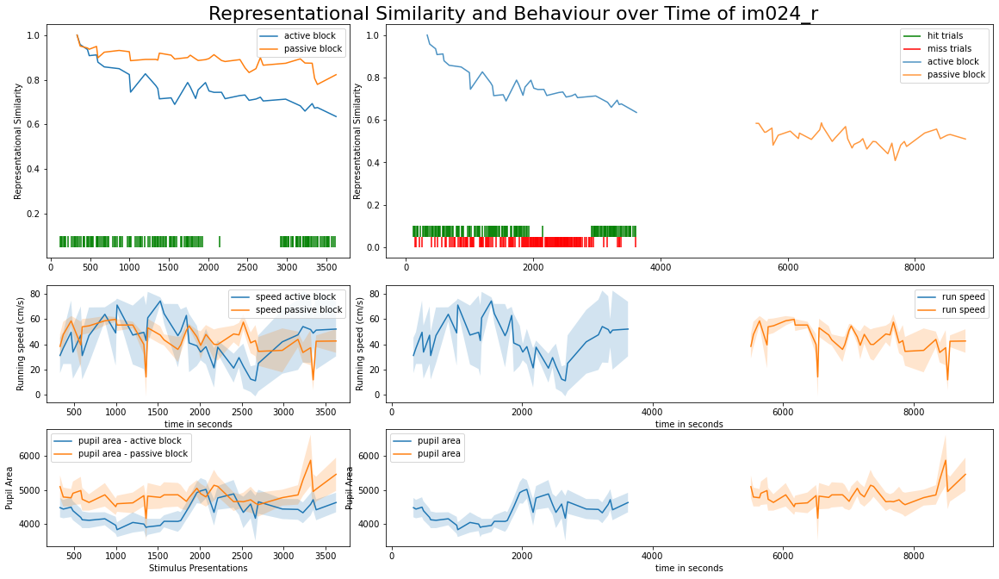

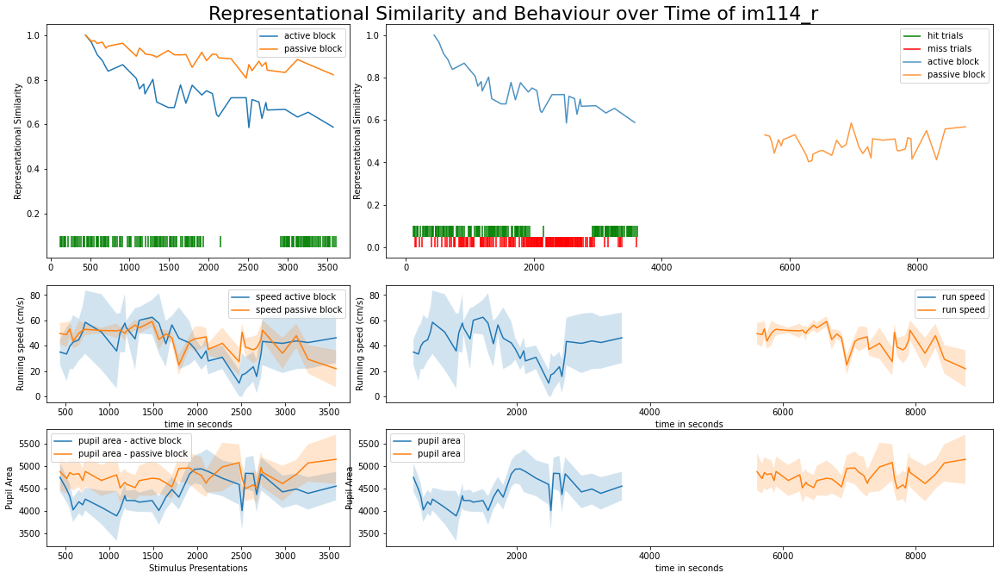

In [45]:
# print all images full information

for image in valid_images:
    specific_image(image, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, change_trials)

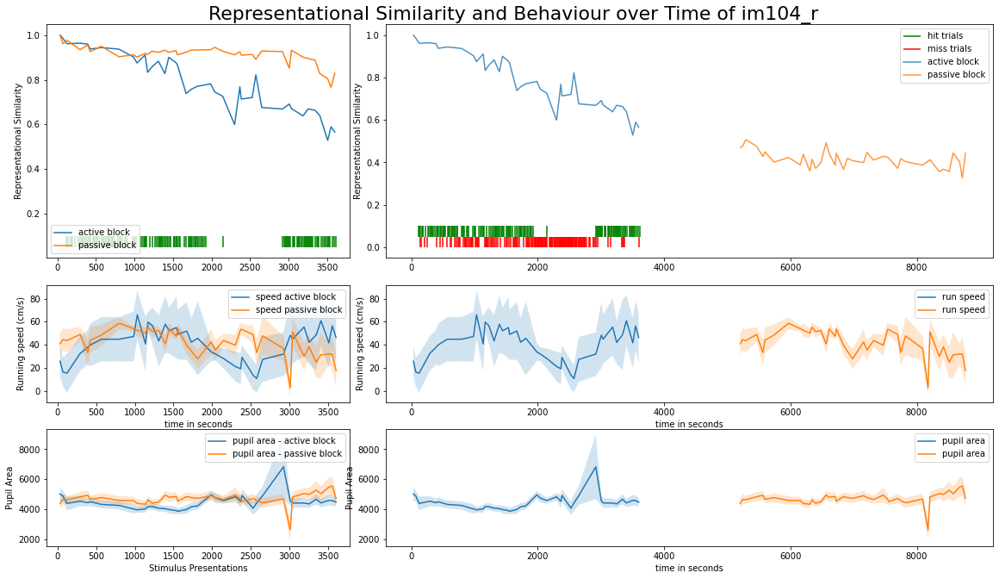

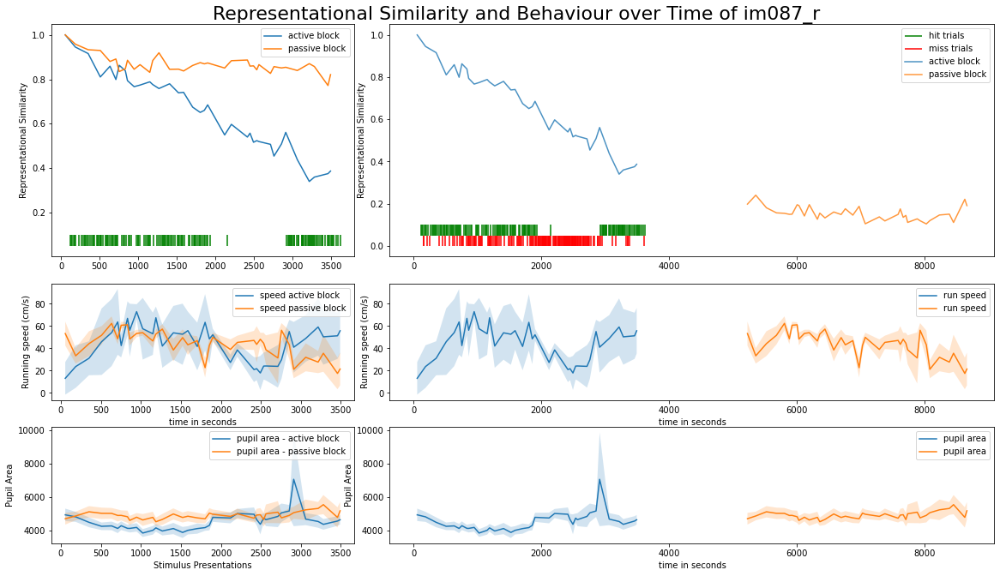

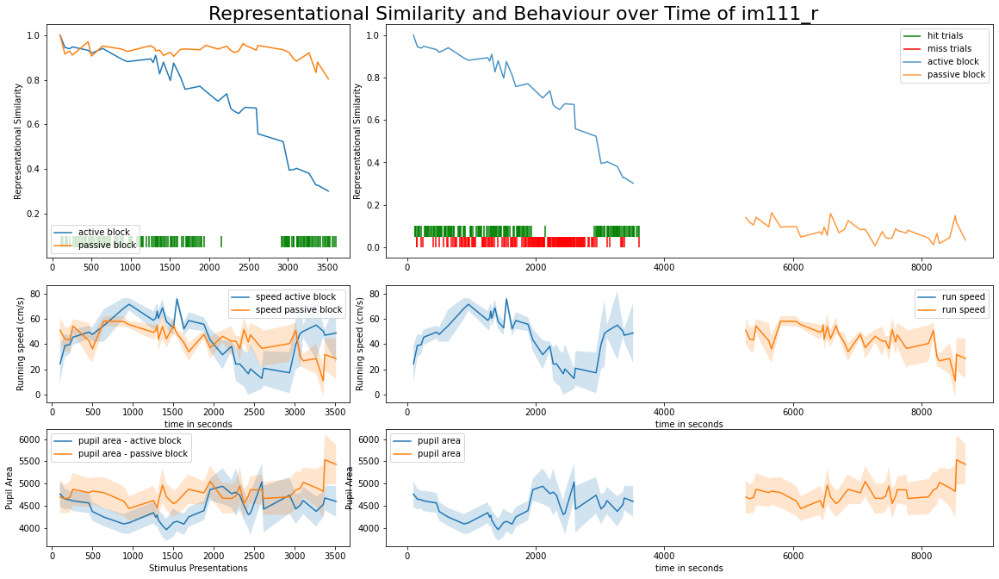

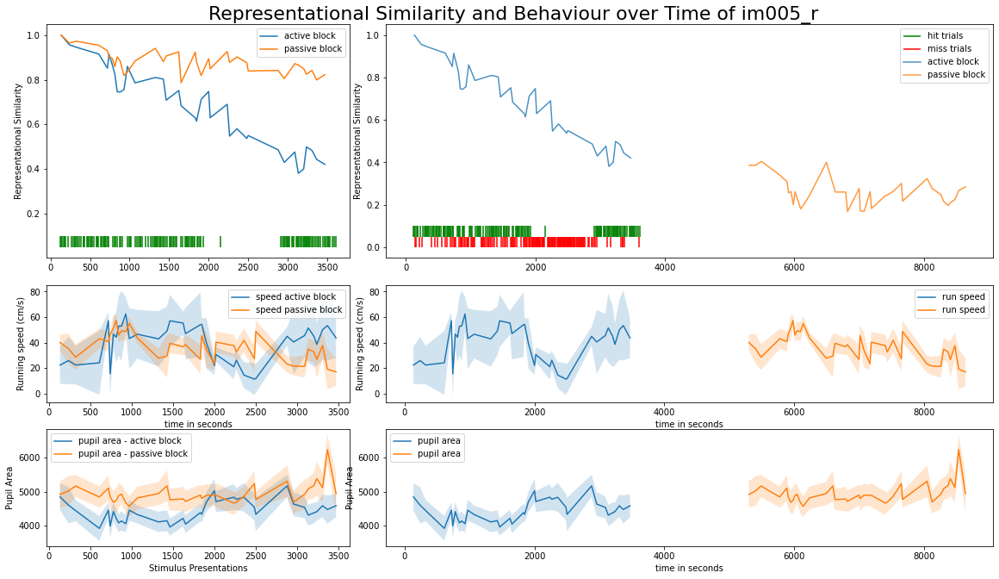

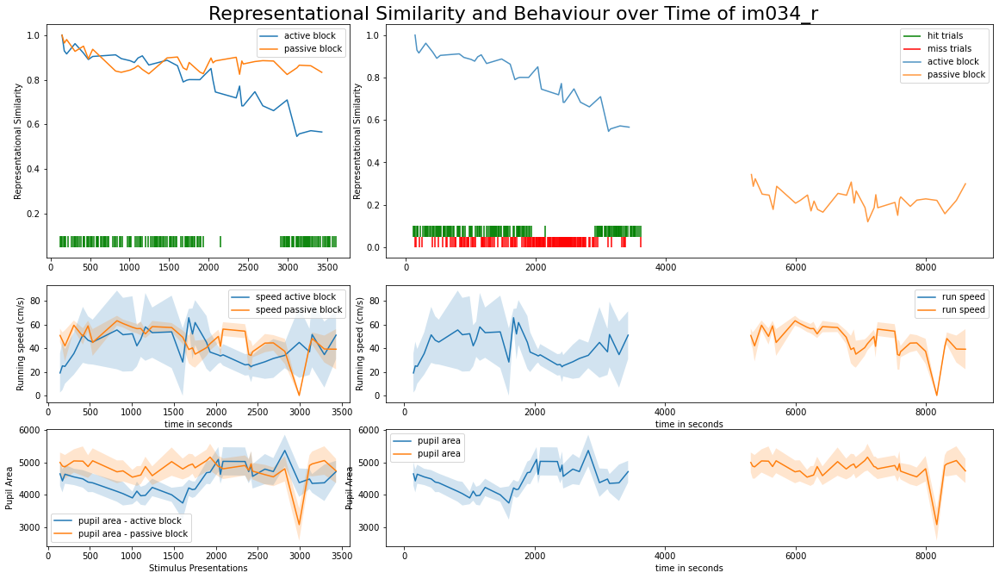

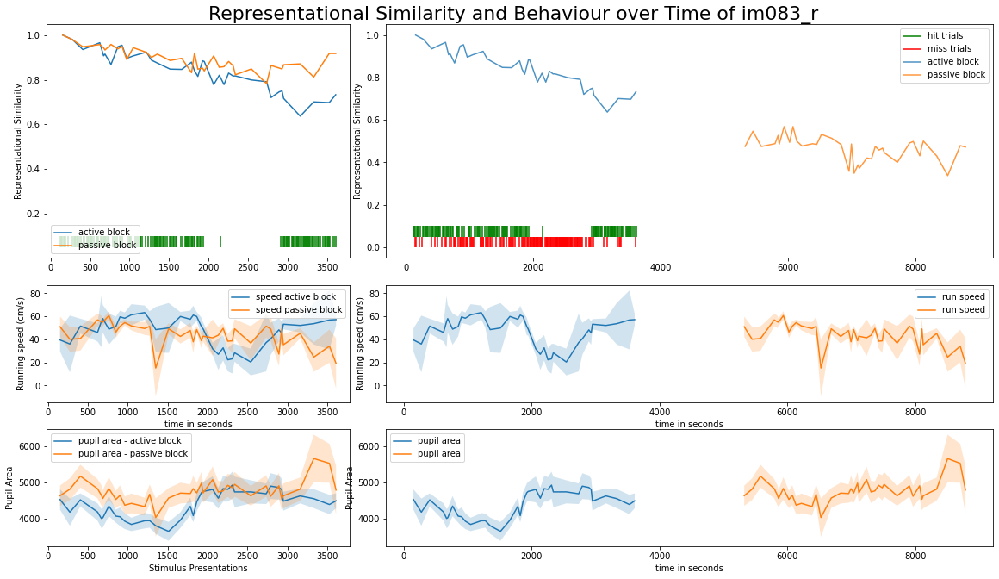

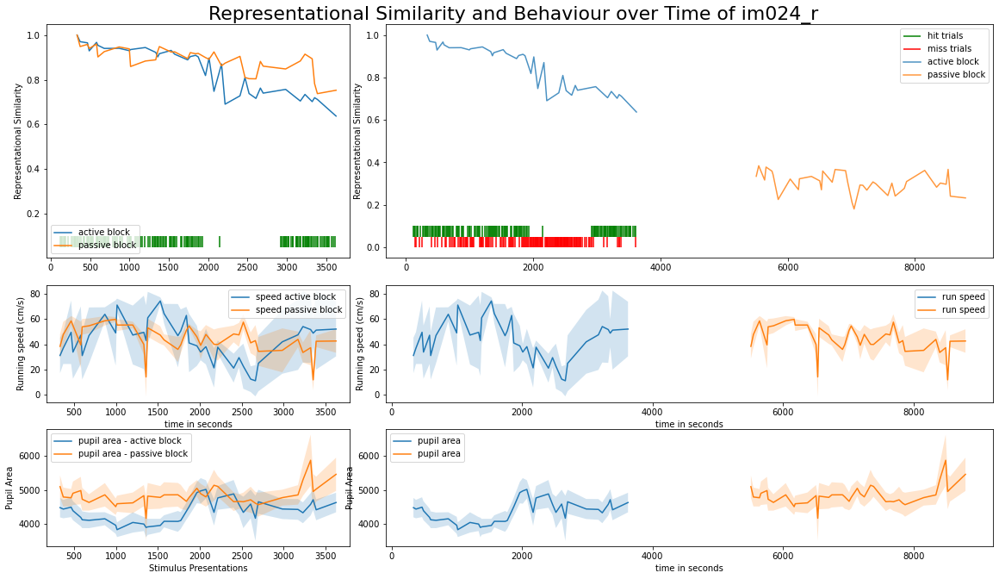

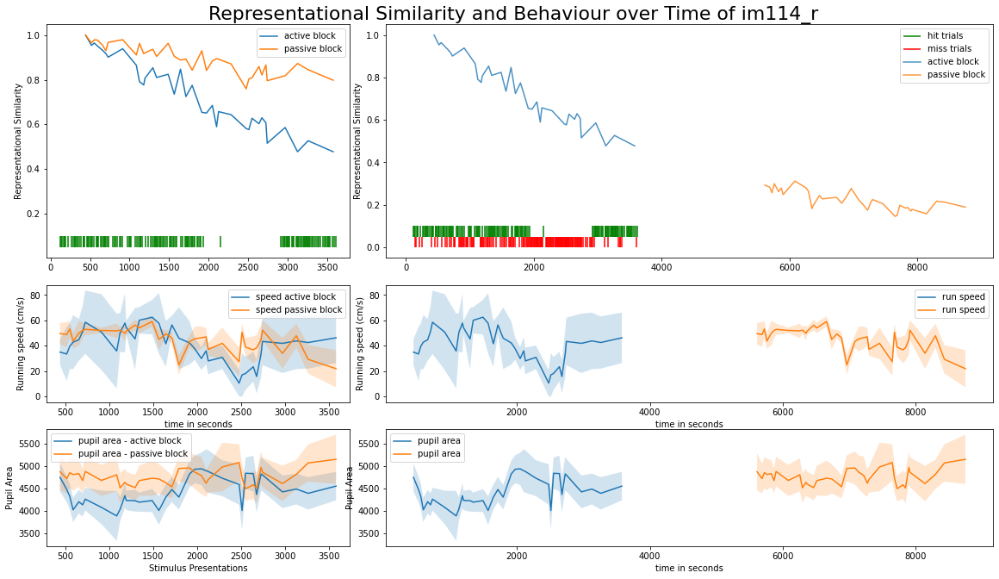

In [46]:
# print all images full information

for image in valid_images:
    specific_image(image, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials)

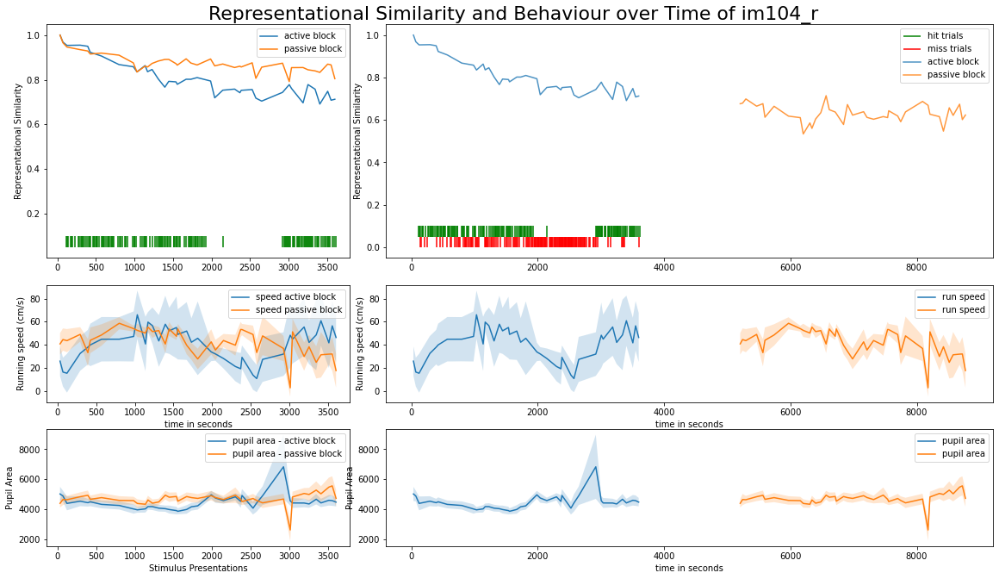

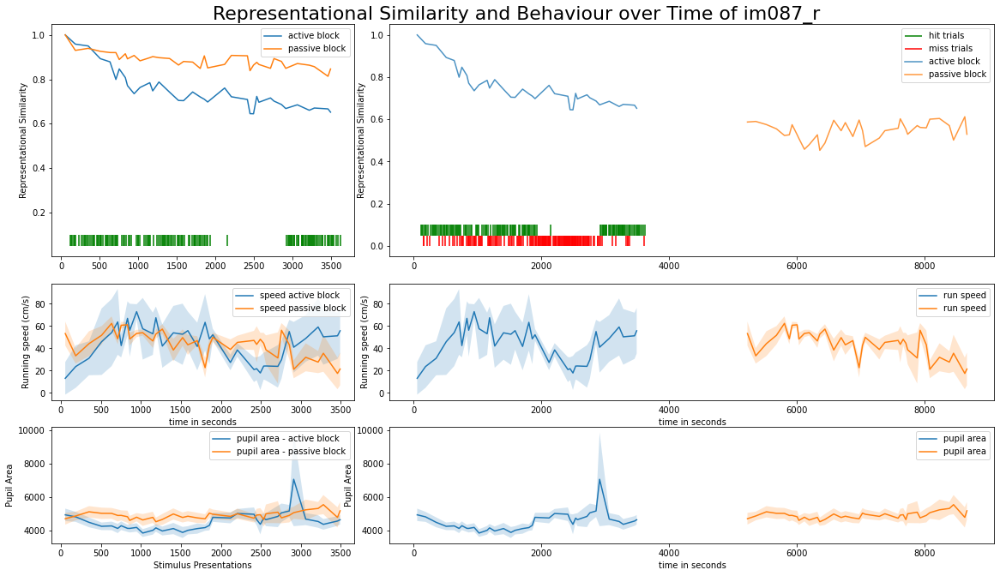

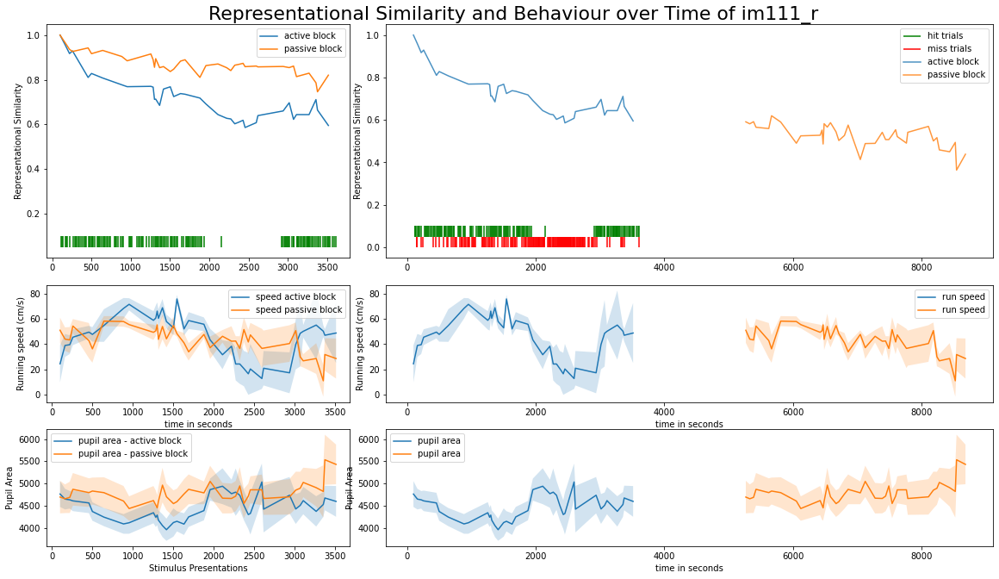

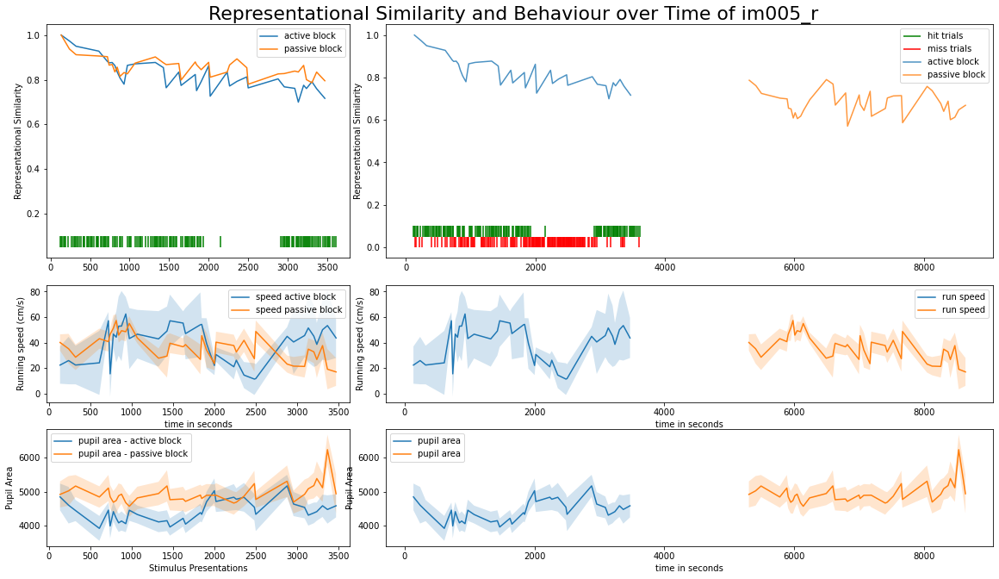

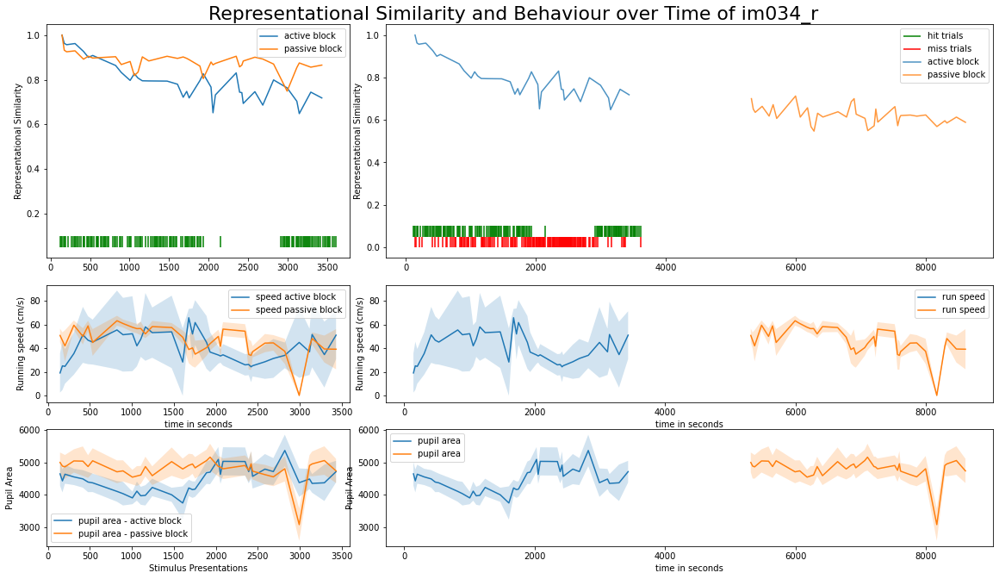

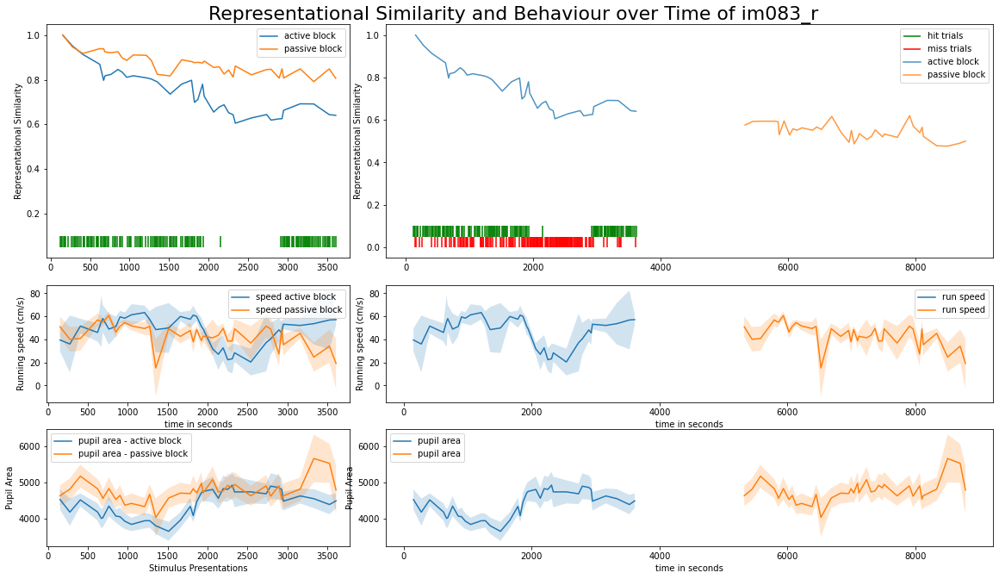

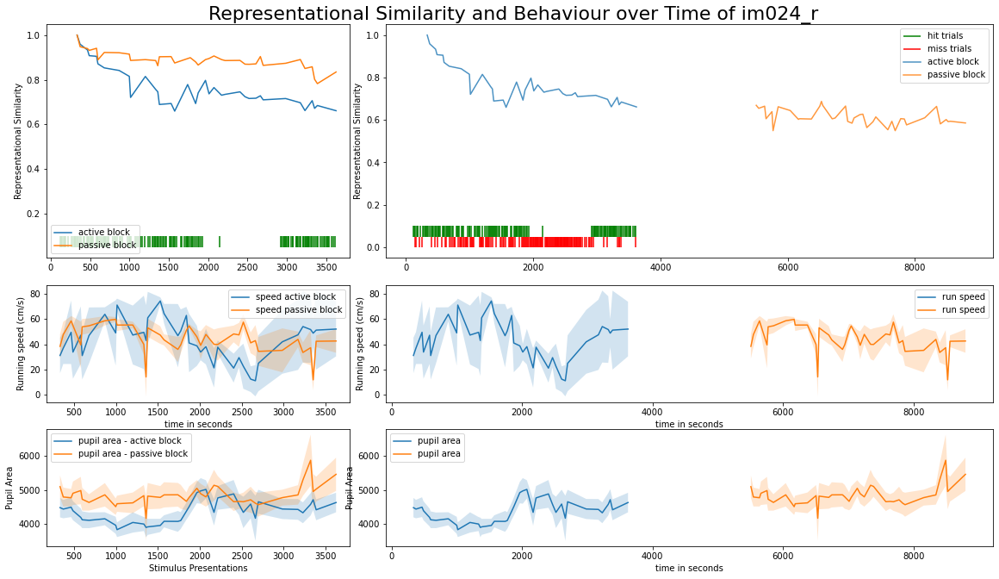

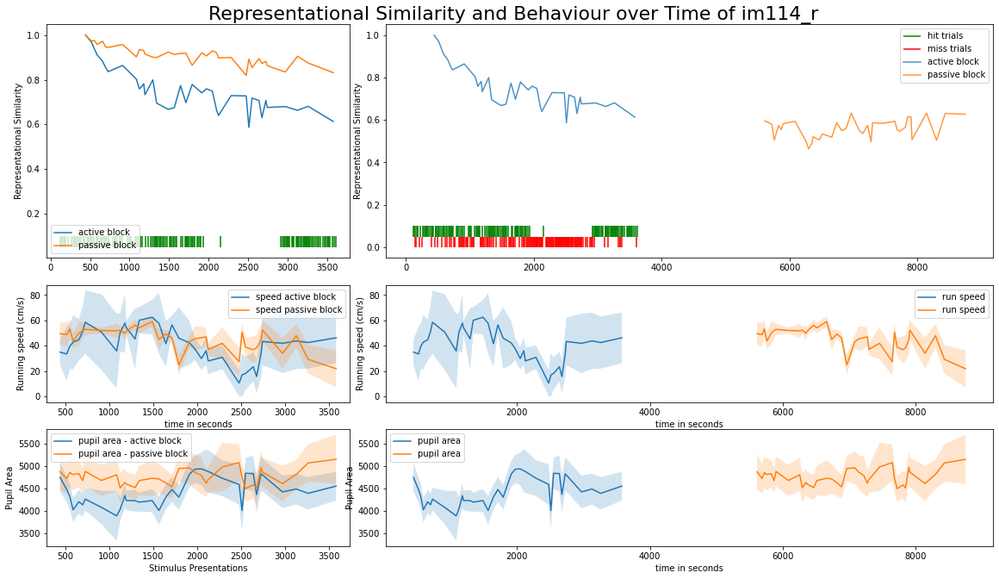

In [47]:
# print all images full information

for image in valid_images:
    specific_image(image, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials)

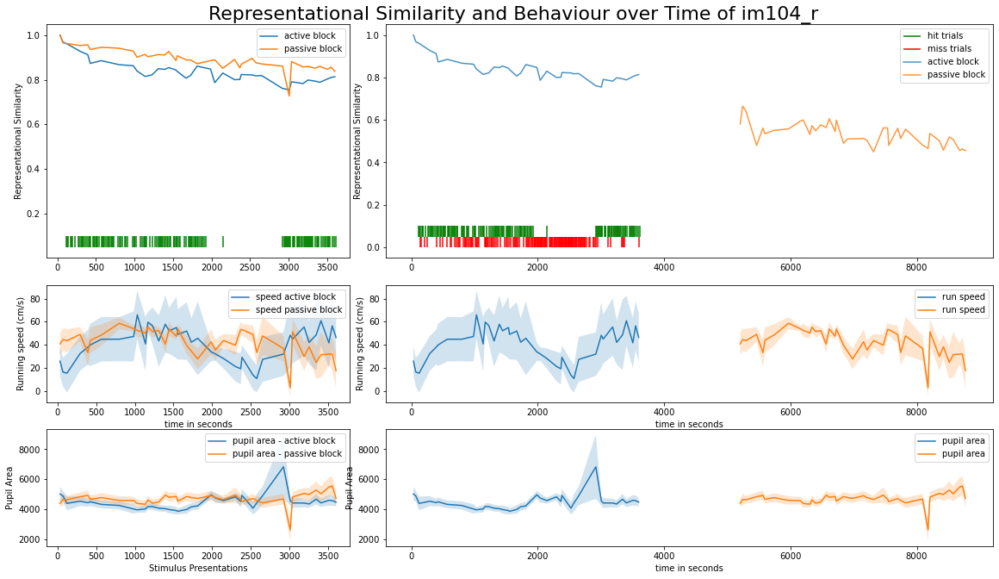

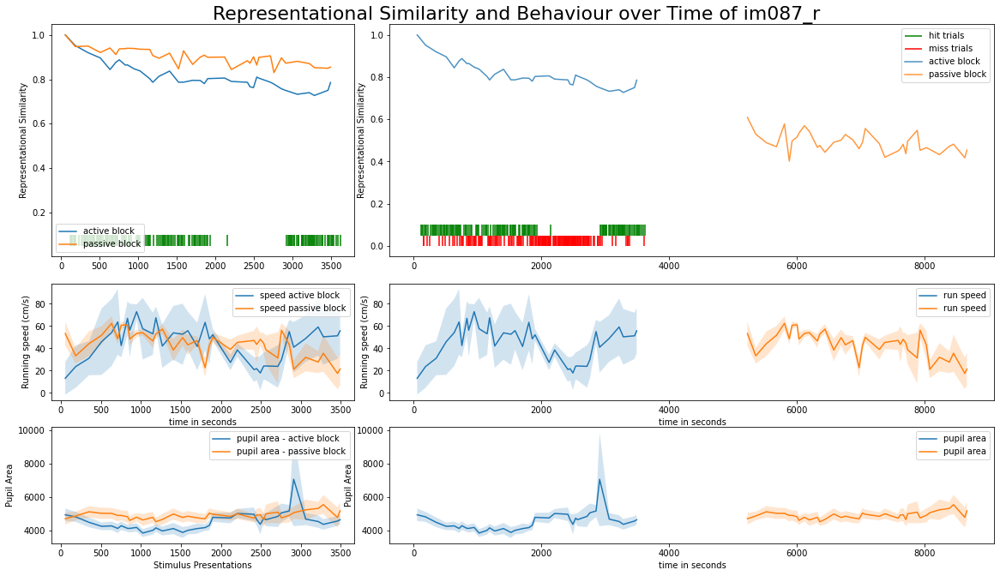

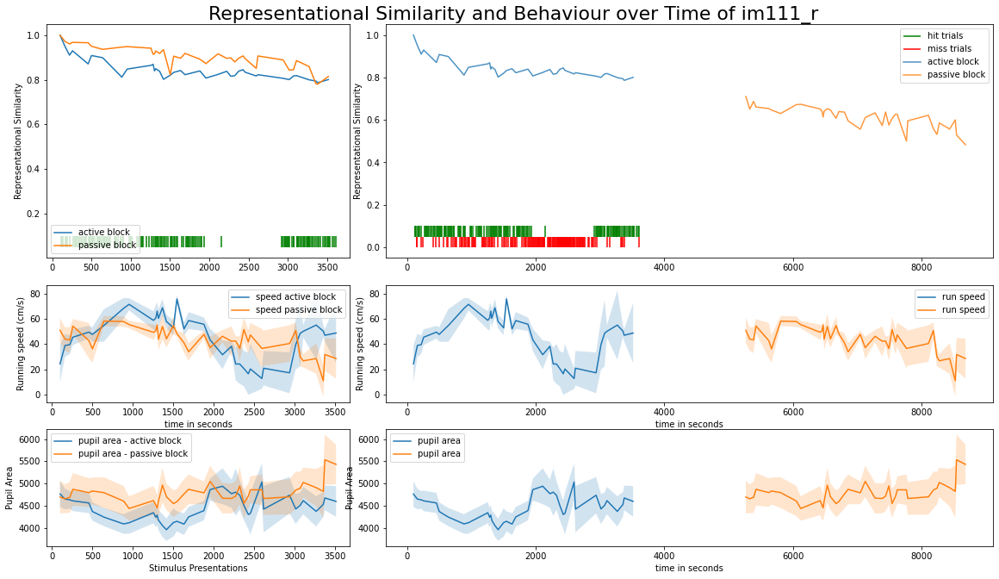

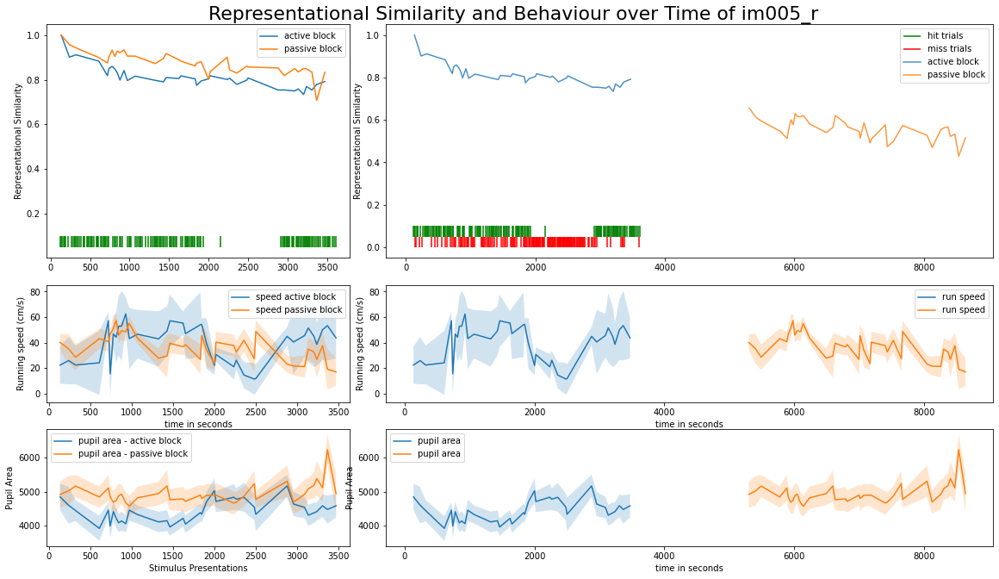

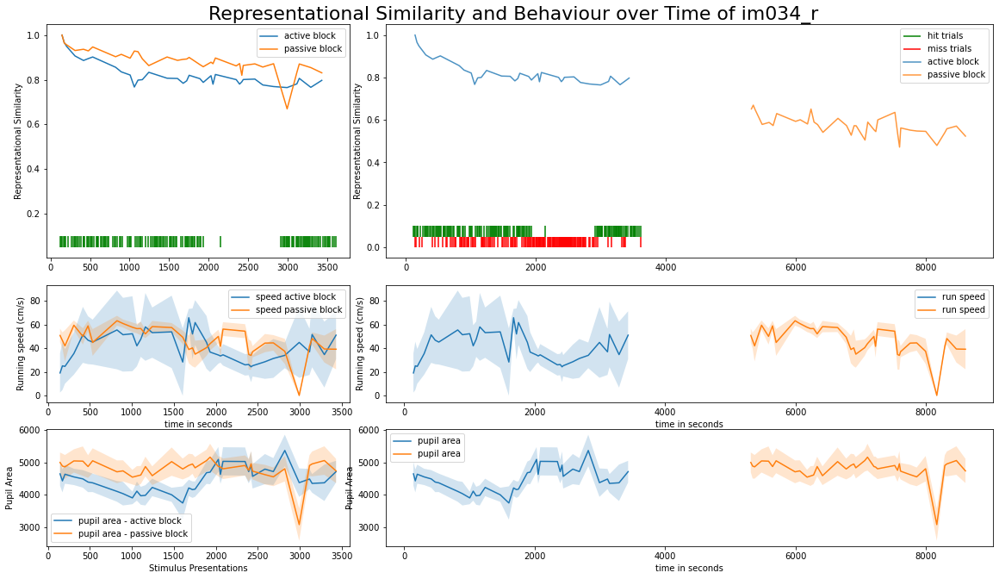

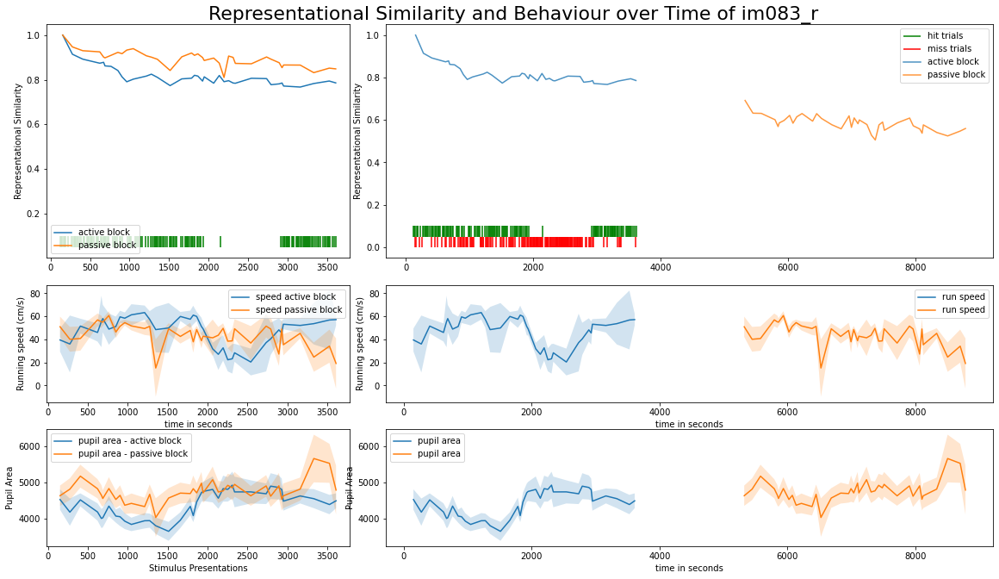

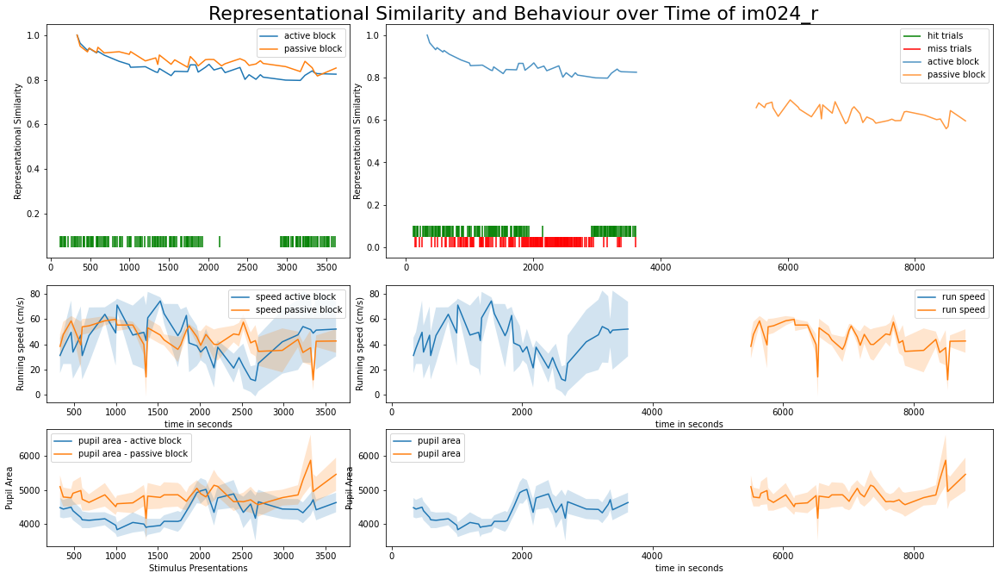

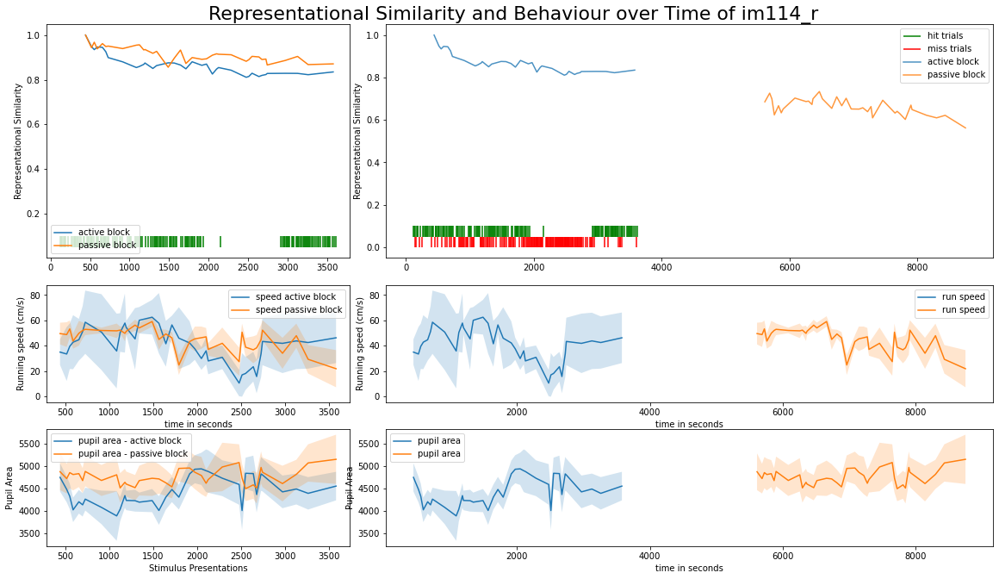

In [48]:
# print all images full information

for image in valid_images:
    specific_image(image, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, change_trials)

### 3.4 with z-scored behaviour

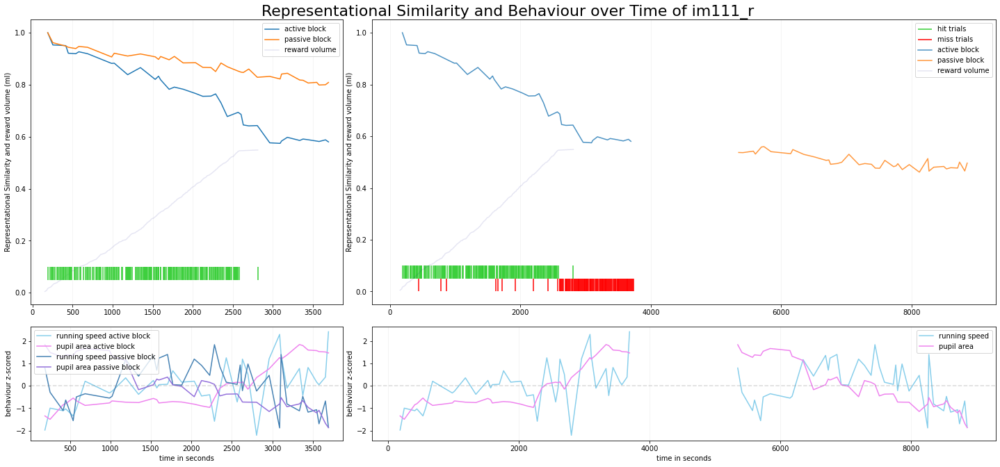

In [78]:
specific_image_z_scored_behaviour('im111_r', M_all_good, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


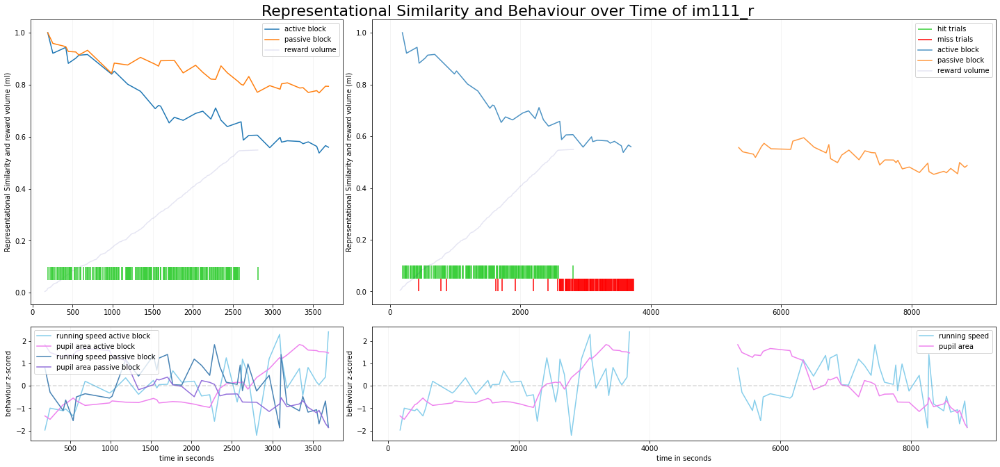

In [79]:
specific_image_z_scored_behaviour('im111_r', M_good_VIS, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


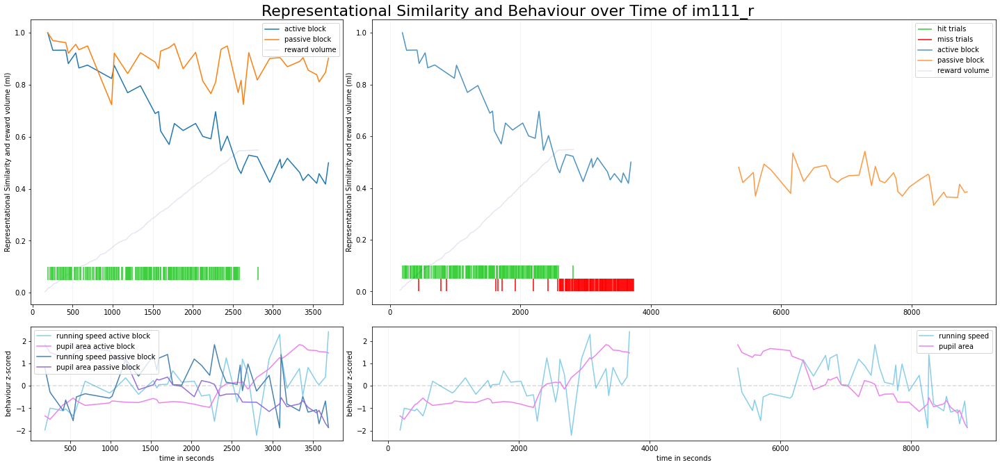

In [80]:
specific_image_z_scored_behaviour('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


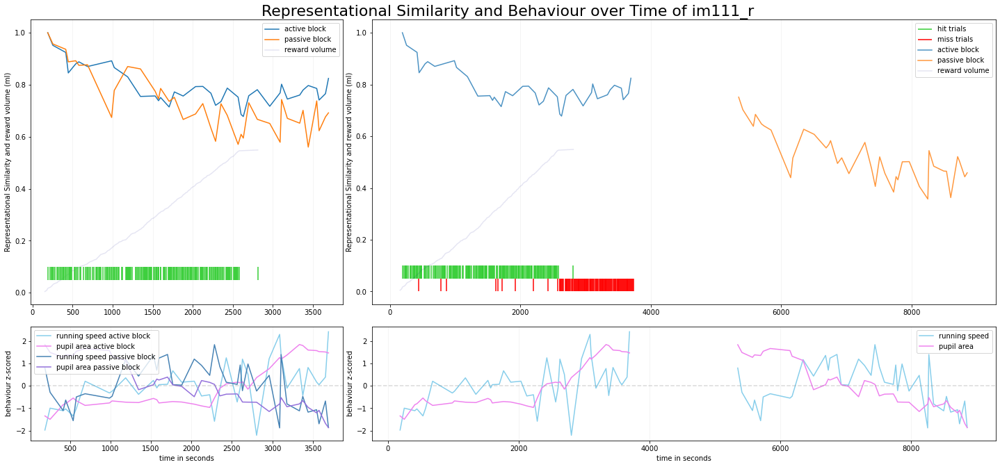

In [81]:
specific_image_z_scored_behaviour('im111_r', M_marked_VIS, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


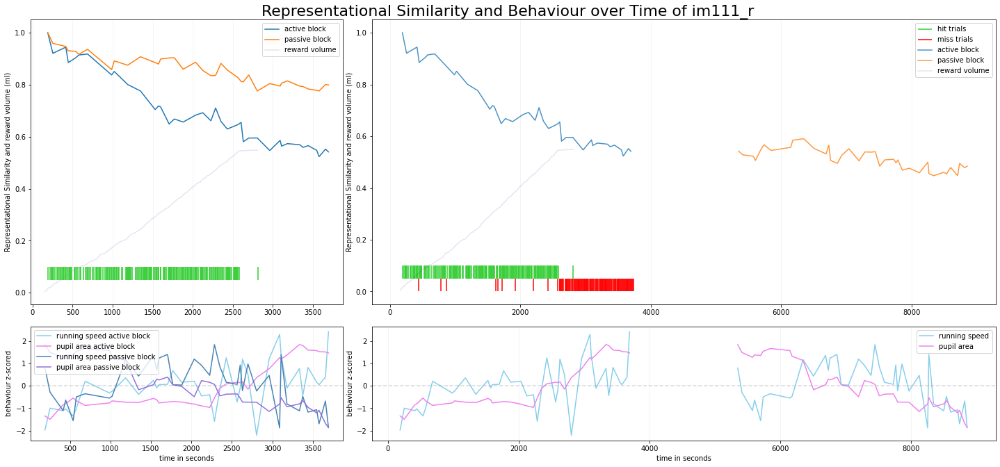

In [82]:
specific_image_z_scored_behaviour('im111_r', M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


### final plot repr. similarity

In [37]:
# this might be the better plot for the last result section, direct comparison between active and passive withins,
# as in the axs[0]

def final_Repr_Sim_plot(image_name, M, stimulus_presentations, brain_structure, sessionID):
    """
    plots Representational Similarity, Running Speed and Pupil Area over time for one fixed image
    """

    # extract the full unit activity for certain image
    # complete, b0, b5 = get_unit_activity_vectors_for_image(image_name, M, stimulus_presentations)

    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M,
                                                                                                                                    image_name,                                                                                                                         stimulus_presentations)
    # visualization of process:
    # check_reduction_over_stimuli(M_reduced, M_rd_active, M_rd_passive)

    # get the Representational Similarity
    C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
    C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
    C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

    half = len(C_rd_active)

    across_blocks = C_reduced[half:, :half]                    # lower middle correlation matrix
    across_blocks2 = C_reduced[:half, half:]                   # passive block? - lower right corr matrix

    # show only representational similarity over time:
    fig, ax = plt.subplots(1, figsize=(16, 8), dpi=dp)
    
    ax.plot(timings[:half], C_rd_active[0,:], alpha=0.8, label='active block')
    ax.plot(timings[half:], C_rd_passive[0,:], label='passive block', alpha=0.3)
    ax.plot(timings[half:], across_blocks2[0,:], alpha=0.8, label='across blocks')

    ax.set_xlabel('time in seconds   -   complete session (2.5h)')
    ax.set_ylabel('Representational Similarity')
    ax.tick_params('y', labelleft=True)
    ax.legend()
    ax.grid(axis='both', color='0.95')
    
    fig.suptitle(t='Representational Similarity over Time of '+ image_name[:-2] +f'; session={sessionID} in '+ brain_structure, fontsize=20)
    
    plt.savefig(f'plots/RS_over_time_plain_{sessionID}.png')
    

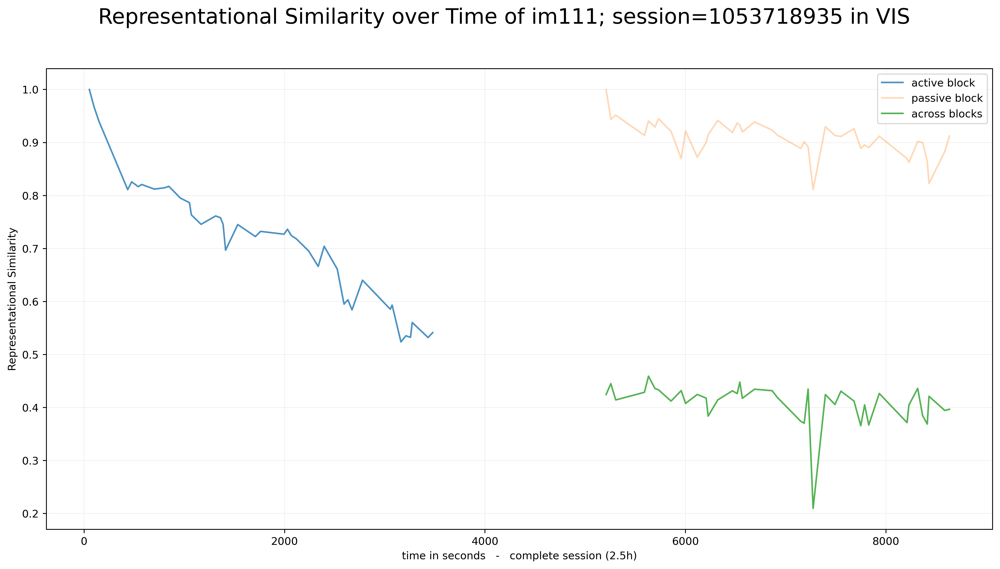

In [38]:
final_Repr_Sim_plot('im111_r', M_good_VIS, stimulus_presentations, 'VIS', sessionID)

In [39]:
# todo? - eliminate first replay from plot??

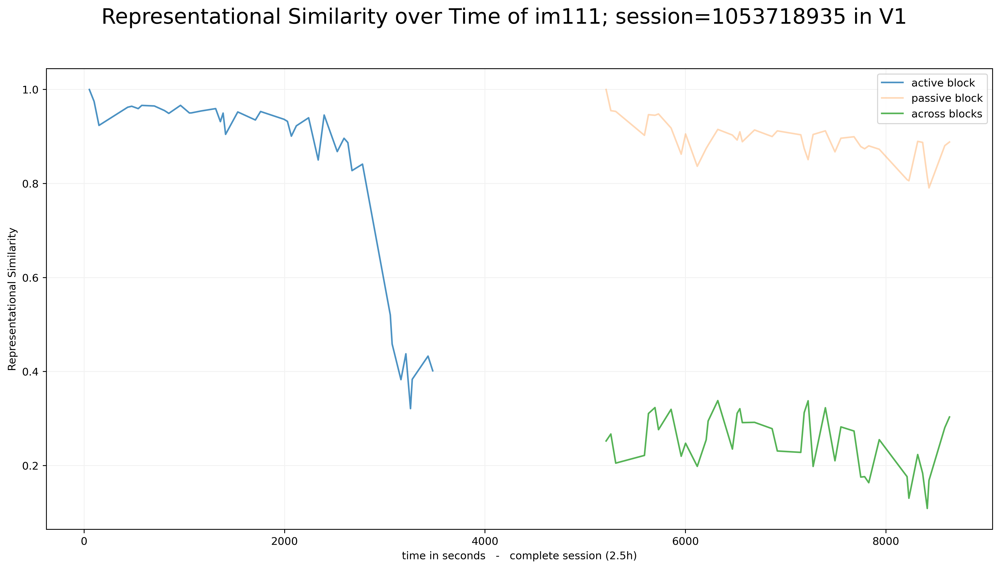

In [40]:
final_Repr_Sim_plot('im111_r', M_good_VISp, stimulus_presentations, 'V1', sessionID)

### final plot repr. similarity compare hierarchies

In [41]:
def final_Repr_Sim_plot_hierarchy(image_name, M, M1, M2, stimulus_presentations, brain_structures, sessionID):
    """
    plots Representational Similarity of 3 different brain structures over time for one fixed image
    """

    # M:
    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M,
                                                                                                                                    image_name,                                                                                                                         stimulus_presentations)

    # get the Representational Similarity
    C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
    C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
    C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

    half = len(C_rd_active)

    across_blocks = C_reduced[half:, :half]                    # lower middle correlation matrix
    across_blocks2 = C_reduced[:half, half:]                   # passive block? - lower right corr matrix

    # show only representational similarity over time:
    fig, ax = plt.subplots(1, figsize=(16, 8), dpi=dp)

    ax.plot(timings[:half], C_rd_active[0,:], alpha=0.8, label=f'V1 ({len(M)} units)', c='hotpink')
    ax.plot(timings[half:], across_blocks2[0,:], alpha=0.8, c='hotpink')
    ax.plot(timings[half:], C_rd_passive[0,:], label='V1 passive block', c='hotpink', alpha=0.3)
    ax.set_xlabel('time in seconds   -   complete session (2.5h)')
    ax.set_ylabel('Representational Similarity')
    ax.tick_params('y', labelleft=True)
    ax.legend()
    ax.grid(axis='both', color='0.95')
    
    #################################
    # M1:
    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M1_reduced, M1_rd_active, M1_rd_passive, timings1, timings_start_end1 = average_population_response_over_same_stimulus_presentations(M1,
                                                                                                                                    image_name,                                                                                                                         stimulus_presentations)

    # get the Representational Similarity
    C1_reduced = np.corrcoef(np.transpose(M1_reduced))            # the Correlation Matrix with reduced stimuli
    C1_rd_active = np.corrcoef(np.transpose(M1_rd_active))        # within active block
    C1_rd_passive = np.corrcoef(np.transpose(M1_rd_passive))      # within passive block
    across1_blocks2 = C1_reduced[:half, half:]                   # passive block? - lower right corr matrix
    
    ax.plot(timings1[:half], C1_rd_active[0,:], alpha=0.8, label=f'VIS \ V1 ({len(M1)} units)', c='mediumorchid')
    ax.plot(timings1[half:], across1_blocks2[0,:], alpha=0.8, c='mediumorchid')
    ax.plot(timings1[half:], C1_rd_passive[0,:], label='VIS \ V1 passive block', c='mediumorchid', alpha=0.3)
    
    #################################
    # M2:
    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M2_reduced, M2_rd_active, M2_rd_passive, timings2, timings_start_end2 = average_population_response_over_same_stimulus_presentations(M2,
                                                                                                                                    image_name,                                                                                                                         stimulus_presentations)

    # get the Representational Similarity
    C2_reduced = np.corrcoef(np.transpose(M2_reduced))            # the Correlation Matrix with reduced stimuli
    C2_rd_active = np.corrcoef(np.transpose(M2_rd_active))        # within active block
    C2_rd_passive = np.corrcoef(np.transpose(M2_rd_passive))      # within passive block
    across2_blocks2 = C2_reduced[:half, half:]                   # passive block? - lower right corr matrix
    
    ax.plot(timings2[:half], C2_rd_active[0,:], alpha=0.8, label=f'CA1 ({len(M2)} units)', c='mediumslateblue')
    ax.plot(timings2[half:], across2_blocks2[0,:], alpha=0.8, c='mediumslateblue')
    ax.plot(timings2[half:], C2_rd_passive[0,:], label='CA1 passive block', c='mediumslateblue', alpha=0.3)
    ax.legend()
    
    
    fig.suptitle(t='Representational Similarity over Time of '+ image_name[:-2] +f'; session={sessionID} by Hierarchy ', fontsize=20)
    plt.savefig('plots/RS_over_time_hierarchies.png')
    

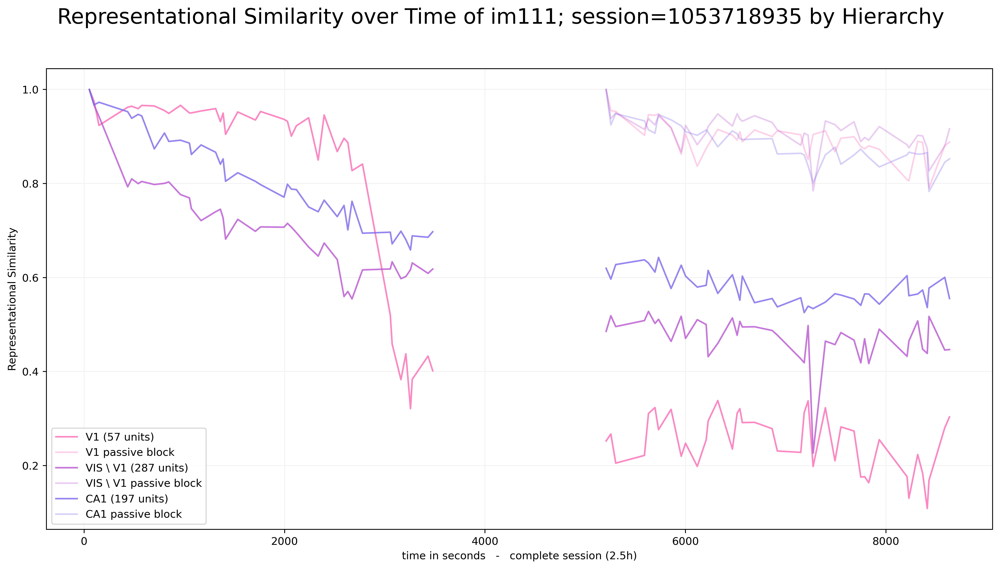

In [42]:
final_Repr_Sim_plot_hierarchy('im111_r', M_good_VISp, M_good_VIS_excld_VISp, M_good_CA1, stimulus_presentations, 'V1 -> VIS \ V1 -> CA1', sessionID)



In [43]:
len(M_good_VISp), len(M_good_VIS_excld_VISp), len(M_good_CA1), M_good_VISp.shape

(57, 287, 197, (57, 13393))

### final plot RS over time by cell types

In [44]:
def final_Repr_Sim_plot_cell_types(image_name, M, M2, stimulus_presentations, cell_types, sessionID):
    """
    plots Representational Similarity of 2 different cell structures over time for one fixed image
    """

    # M:
    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M,
                                                                                                                                    image_name,                                                                                                                         stimulus_presentations)

    # get the Representational Similarity
    C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
    C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
    C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

    half = len(C_rd_active)

    across_blocks = C_reduced[half:, :half]                    # lower middle correlation matrix
    across_blocks2 = C_reduced[:half, half:]                   # passive block? - lower right corr matrix

    # show only representational similarity over time:
    # fig, axs = plt.subplots(1, 2, figsize=(28, 7), gridspec_kw={'width_ratios': [1, 2]}, sharey=True)
    fig, ax = plt.subplots(1, figsize=(16, 8), dpi=dp)
    
    # axs[1].plot(timings, C_reduced[0,:], c='purple', alpha=0.2)
    ax.plot(timings[:half], C_rd_active[0,:], alpha=0.8, label='inhibitory', c='red')
    ax.plot(timings[half:], across_blocks2[0,:], alpha=0.8, c='red')
    ax.plot(timings[half:], C_rd_passive[0,:], label='inhibitory passive block', c='red', alpha=0.3)
    ax.set_xlabel('time in seconds   -   complete session (2.5h)')
    ax.set_ylabel('Representational Similarity')
    ax.tick_params('y', labelleft=True)
    ax.legend()
    ax.grid(axis='both', color='0.95')
    
    #################################
    # M2:
    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M2_reduced, M2_rd_active, M2_rd_passive, timings2, timings_start_end2 = average_population_response_over_same_stimulus_presentations(M2,
                                                                                                                                    image_name,                                                                                                                         stimulus_presentations)

    # get the Representational Similarity
    C2_reduced = np.corrcoef(np.transpose(M2_reduced))            # the Correlation Matrix with reduced stimuli
    C2_rd_active = np.corrcoef(np.transpose(M2_rd_active))        # within active block
    C2_rd_passive = np.corrcoef(np.transpose(M2_rd_passive))      # within passive block
    across2_blocks2 = C2_reduced[:half, half:]                   # passive block? - lower right corr matrix
    
    ax.plot(timings2[:half], C2_rd_active[0,:], alpha=0.8, label='exhibitory', c='blue')
    ax.plot(timings2[half:], across2_blocks2[0,:], alpha=0.8, c='blue')
    ax.plot(timings2[half:], C2_rd_passive[0,:], label='exhibitory passive block', c='blue', alpha=0.3)
    ax.legend()
    
    fig.suptitle(t='Representational Similarity over Time of '+ image_name[:-2] +f'; session={sessionID} in VIS cells '+ cell_types, fontsize=20)
    plt.savefig('plots/RS_over_time_cell_types.png')
    

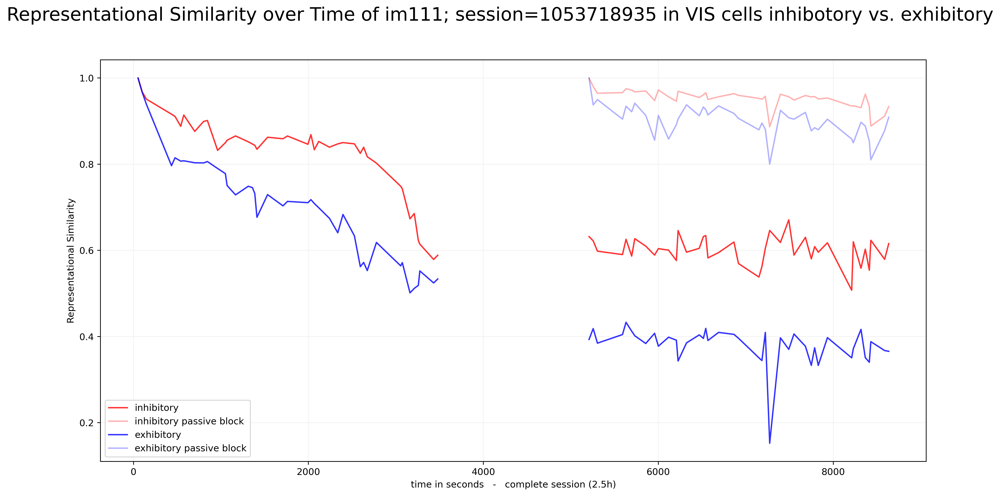

In [45]:
final_Repr_Sim_plot_cell_types('im111_r', M_marked_VIS, M_VIS_no_tag, stimulus_presentations, 'inhibotory vs. exhibitory', sessionID)



### final plot RS over time with z-scored behaviour

In [46]:
import scipy.stats as stats
def z_score_behaviour(avg_running_speed, avg_pupil_area, half):
    """
    z-scores the running speed and pupil area in one behaviour vector Z

    :param avg_running_speed: running speed averaged for time points
    :param avg_pupil_area: pupil areas averaged for same time points
    :param half: is the index where active block ends and passive block starts
    :return: 2 Z-Vectors with running speed and pupil area for active and passive block. z_t[i] will give the z-scored
             running speed and pupil area at time i. z_t[:, 0] is running speed and z_t[:, 1] is pupil area z-scored.
    """

    z_rt_a = stats.zscore(avg_running_speed[:half])
    z_pt_a = stats.zscore(avg_pupil_area[:half])
    z_t_a = np.array((z_rt_a, z_pt_a))
    z_t_a = np.transpose(z_t_a)

    z_rt_p = stats.zscore(avg_running_speed[half:])
    z_pt_p = stats.zscore(avg_pupil_area[half:])
    z_t_p = np.array((z_rt_p, z_pt_p))
    z_t_p = np.transpose(z_t_p)

    return z_t_a, z_t_p

In [47]:
def final_Repr_Sim_z_scored_behaviour(image_name, M, stimulus_presentations, running_speed, eye_tracking, strc, sessionID):
    """
    plots (chain averaged) Representational Similarity, z-scored Running Speed and Pupil Area over time for one fixed image
    """

    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M,
                                                                                                                                    image_name,
                                                                                                                                    stimulus_presentations)


    # get the Representational Similarity
    C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
    C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
    C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

    half = len(C_rd_active)

    across_blocks = C_reduced[half:, :half]                    # lower middle correlation matrix
    across_blocks2 = C_reduced[:half, half:]                   # passive block? - lower right corr matrix


    sp = stimulus_presentations[stimulus_presentations.image_name == image_name]
    avg_running_speed, std_running_speed, avg_pupil_area, std_pupil_area = extract_speed_and_pupil_data(sp, timings_start_end, running_speed, eye_tracking)
    z_t_a, z_t_p = z_score_behaviour(avg_running_speed, avg_pupil_area, half)


    fig, axs = plt.subplots(2, 1, figsize=(20,9), gridspec_kw={'height_ratios': [5, 2]}, dpi=dp)

    x = timings

    # plot representational similarity

    # axs[0].plot(x[:half], C_rd_active[0,:], label='active block')           #[0, :] takes first row of matrix
    # axs[0].plot(x[:half], C_rd_passive[0,:], label='passive block')
    # axs[0].grid(axis='x', color='0.95')
    # axs[0].set_ylabel('Representational Similarity')
    # axs[0].legend()

    axs[0].plot(x[:half], C_rd_active[0,:], alpha=0.8, label='active block')
    axs[0].plot(x[half:], C_rd_passive[0,:], label='passive block', alpha=0.3)
    axs[0].plot(x[half:], across_blocks2[0,:], alpha=0.8, label='across blocks')
    axs[0].grid(axis='x', color='0.95')
    axs[0].set_ylabel('Representational Similarity')
    axs[0].legend()

    # axs[1,0].set_title(label='running speed')
    # axs[1,0].plot(x[:half], z_t_a[:, 0], label='running speed active block', color='mediumpurple', alpha=0.2)
    # axs[1,0].plot(x[:half], z_t_a[:, 1], label='pupil area active block', color='violet', alpha=0.2)
    # axs[1,0].plot(x[:half], z_t_p[:, 0], label='running speed passive block', color='mediumpurple')
    # axs[1,0].plot(x[:half], z_t_p[:, 1], label='pupil area passive block', color='violet')
# 
    # axs[1, 0].axhline(y=0, color='gray', linestyle='--', alpha=0.3)
    # axs[1, 0].grid(axis='x', color='0.95')
    # axs[1,0].set_xlabel('time in seconds')
    # axs[1,0].set_ylabel('behaviour z-scored')
    # axs[1,0].legend()
    # axs[1,0].axis('off')

    # axs[1,1].set_title(label='running speed')
    axs[1].plot(x[:half], z_t_a[:, 0], label='running speed', color='mediumpurple')
    axs[1].plot(x[:half], z_t_a[:, 1], label='pupil area', color='violet')
    axs[1].plot(x[half:], z_t_p[:, 0], color='mediumpurple')
    axs[1].plot(x[half:], z_t_p[:, 1], color='violet')
    # axs,1].axvline(half, c='r')
    axs[1].axhline(y=0, color='gray', linestyle='--', alpha=0.3)
    axs[1].grid(axis='x', color='0.95')
    axs[1].set_xlabel('time in seconds')
    axs[1].set_ylabel('behaviour z-scored')
    axs[1].legend()

    fig.suptitle(t='Representational Similarity and Behaviour over Time of '+ image_name[:-2] + f' in {strc} - session={sessionID}', fontsize=20)
    plt.savefig(f'plots/RS_over_time_behaviour_in_{strc}.png')
    

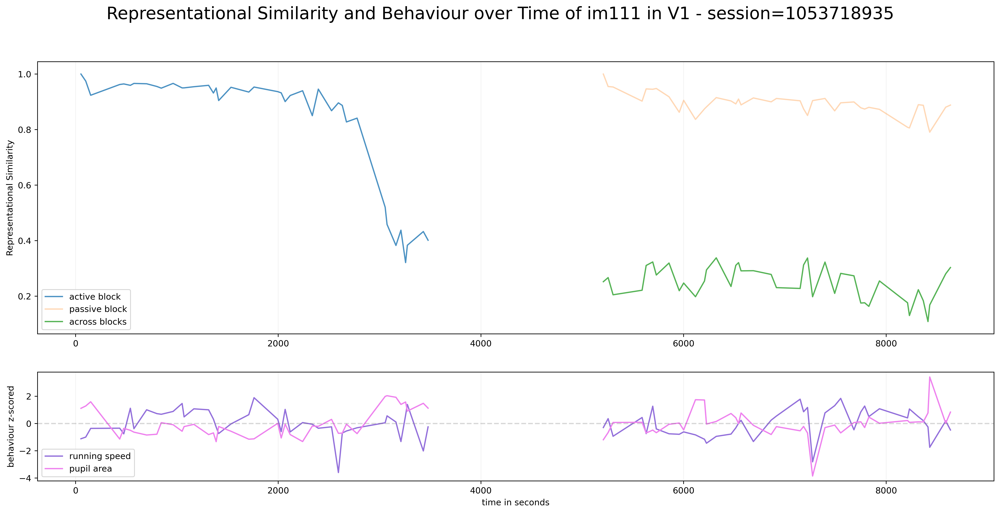

In [48]:
final_Repr_Sim_z_scored_behaviour('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'V1', sessionID)


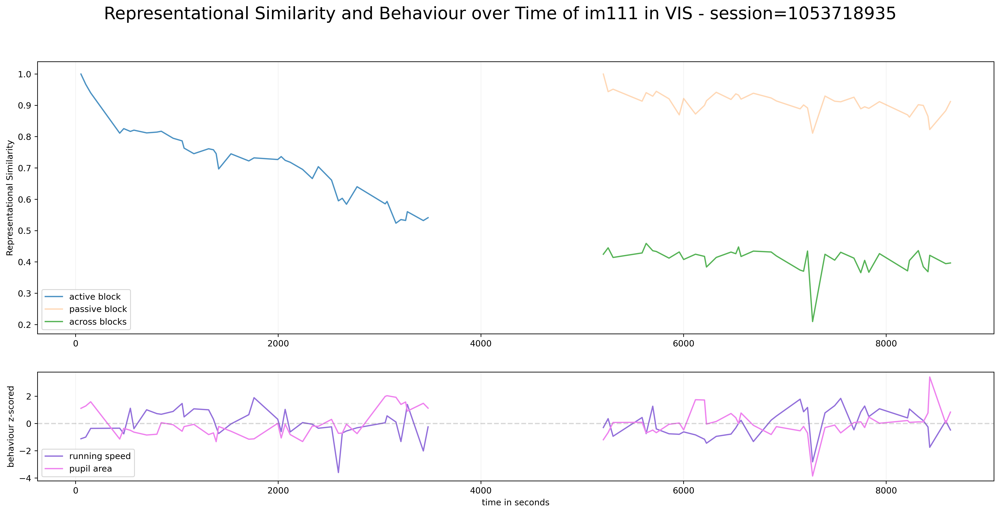

In [49]:
final_Repr_Sim_z_scored_behaviour('im111_r', M_good_VIS, stimulus_presentations, running_speed, eye_tracking, 'VIS', sessionID)


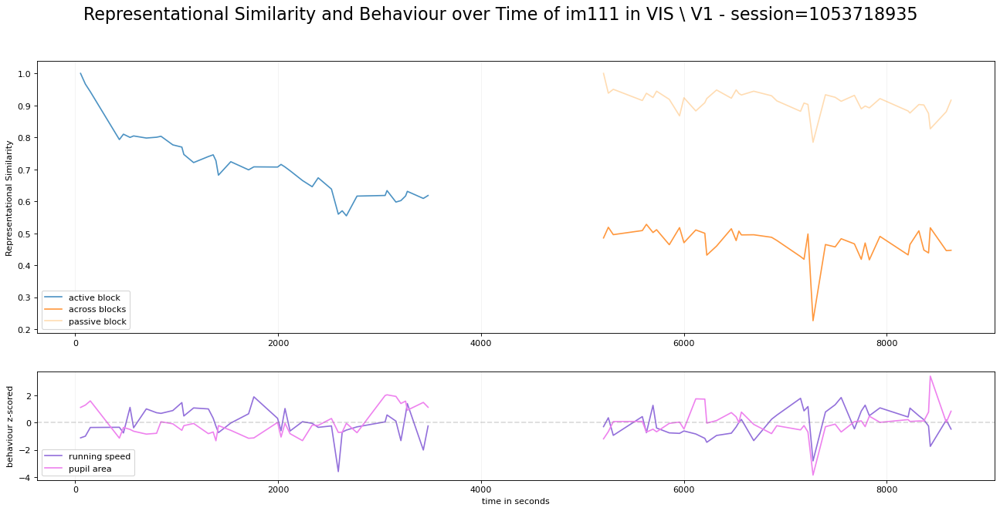

In [129]:
final_Repr_Sim_z_scored_behaviour('im111_r', M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, 'VIS \ V1', sessionID)


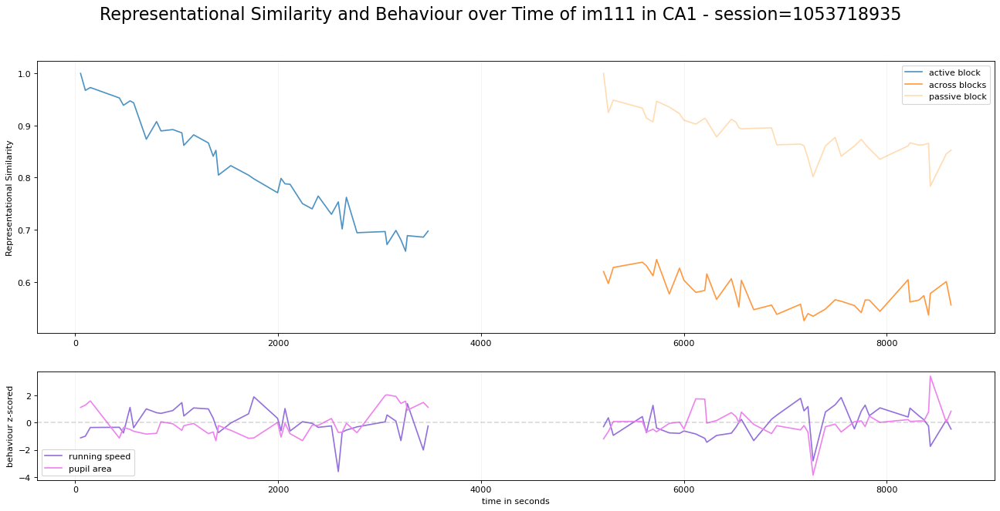

In [130]:
final_Repr_Sim_z_scored_behaviour('im111_r', M_good_CA1, stimulus_presentations, running_speed, eye_tracking, 'CA1', sessionID)


### final plot RS by image familarity

In [346]:
f = [1, 2, 3, 4, 5, 6, 7, 8, 9]
f[-1], f[4]

(9, 5)

In [50]:
def final_RS_plot_all_images_by_familiarity(images, M, stimulus_presentations, title, novel):
    """
    plots Representational Similarity, Running Speed and Pupil Area over time for all presented images
    """

    fig, ax = plt.subplots(1, figsize=(16,8), dpi=dp)
    # fig.tight_layout()

    for i, image in enumerate(images):
            
        # get image specific unit activities
        M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M, image, stimulus_presentations)

        # get the Representational Similarity
        C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
        C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
        C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

        half = len(C_rd_active)

        across_blocks2 = C_reduced[:half, half:]

        x = timings

        # plot representational similarity
        if (image == 'im111_r') or (image=='im083_r'):
            dark_blue, = ax.plot(x[:half], C_rd_active[0,:], alpha=0.9, color='darkblue')
            dark_green, = ax.plot(x[half:], across_blocks2[0,:], alpha=0.9, color='darkgreen')
            dark_orange, = ax.plot(x[half:], C_rd_passive[0,:], alpha=0.45, color='darkorange')
            ax.text(x[half-1]+50, C_rd_active[0,:][-1], image[:-2], style='italic', color='darkblue')
            ax.text(x[half]-400, across_blocks2[0,:][0], image[:-2], style='italic', color='darkgreen')
            ax.text(x[-1]+40, C_rd_passive[0,:][-1], image[:-2], style='italic', color='darkorange')
            
        else:
            blue, = ax.plot(x[:half], C_rd_active[0,:], alpha=0.3, color='C0')
            green, = ax.plot(x[half:], across_blocks2[0,:], alpha=0.3, color='C2')
            orange, = ax.plot(x[half:], C_rd_passive[0,:], alpha=0.15, color='C1')

    ax.set_ylabel('Representational Similarity')
    ax.set_xlabel('time in seconds')
    if novel:
        ax.legend(labels=['familiar image active', 'familiar image across', 'familiar image passive', 'novel image active', 'novel image across', 'novel image passive'], handles=[dark_blue, dark_green, dark_orange, blue, green, orange])
    else:
        ax.legend(labels=['within active block', 'across blocks', 'within passive block'], handles=[dark_blue, dark_orange, dark_green])
    ax.grid(axis='both', color='0.95')

    fig.suptitle(t=title, fontsize=20)
    plt.savefig('plots/'+title+'.png')

familiar session


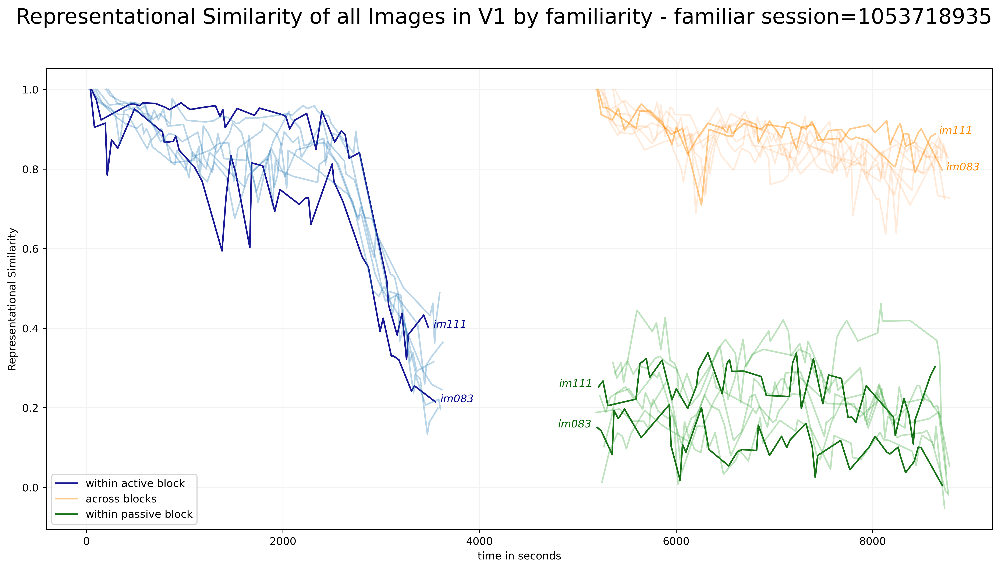

In [51]:
if ecephys_sessions_table.loc[sessionID].experience_level == 'Novel':
    print('Novel Session')
    title = f'Representational Similarity of all Images in V1 by familiarity - novel session={sessionID}'
    final_RS_plot_all_images_by_familiarity(valid_images, M_good_VISp, stimulus_presentations, title, True)
    # M_good_VIS_excld_VISp
    # M_good_CA1
else:
    print('familiar session')
    title = f'Representational Similarity of all Images in V1 by familiarity - familiar session={sessionID}'
    final_RS_plot_all_images_by_familiarity(valid_images, M_good_VISp, stimulus_presentations, title, False)


#  4. Representational Similarity vs. Behavioural State Difference
difference in running speed and pupil size for specified image with and without chain-average

In [39]:
# specify image:
im = 'im111_r'

### 4.1 RS and Behaviour: Running Speed and Pupil Area 
fix picture in active/passive/both blocks

plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861


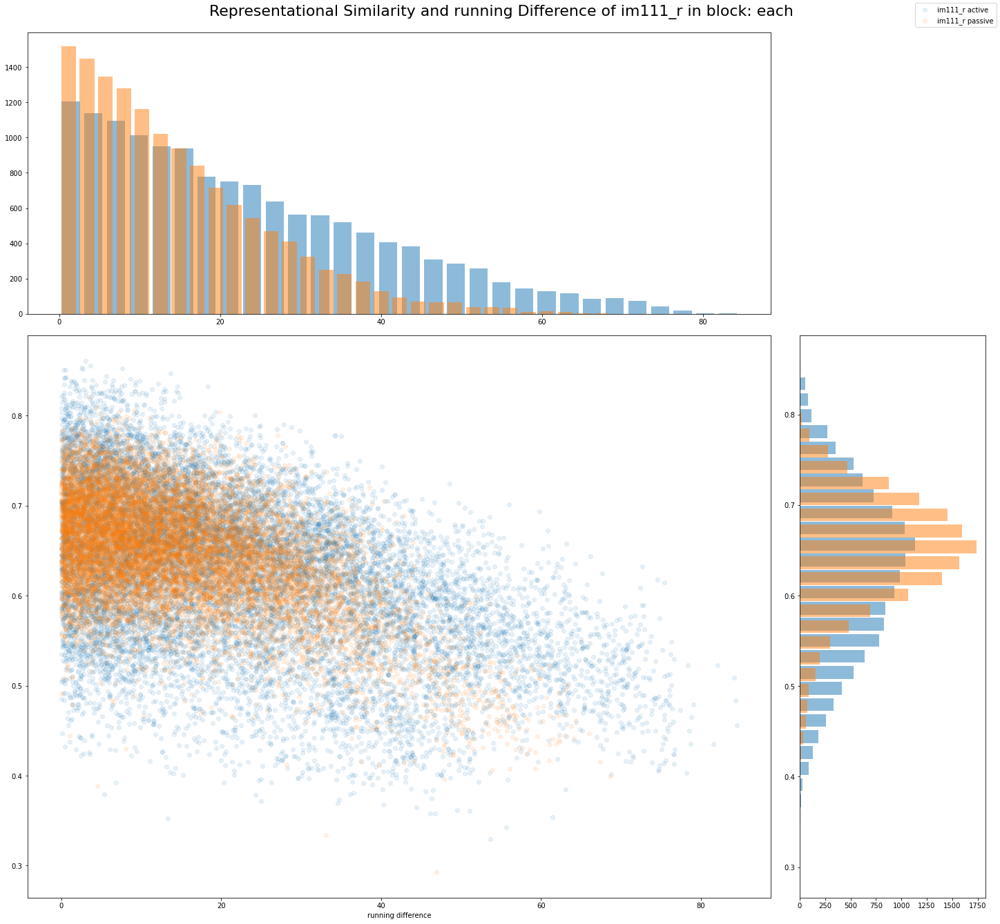

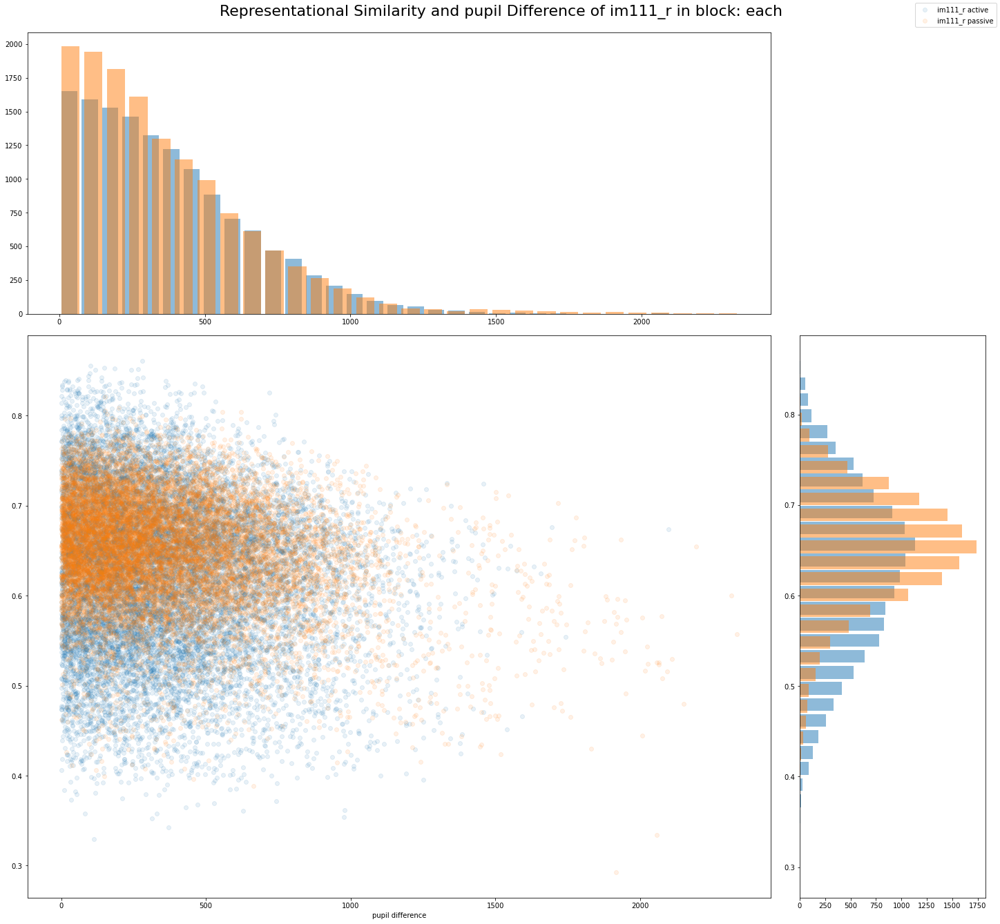

In [165]:
# all good units

RS_behaviour_active_passive(im, 
                            M_all_good, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')

RS_behaviour_active_passive(im, 
                            M_all_good, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# RS_behaviour_active_passive(im, 
#                             M_all_good, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')


plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861


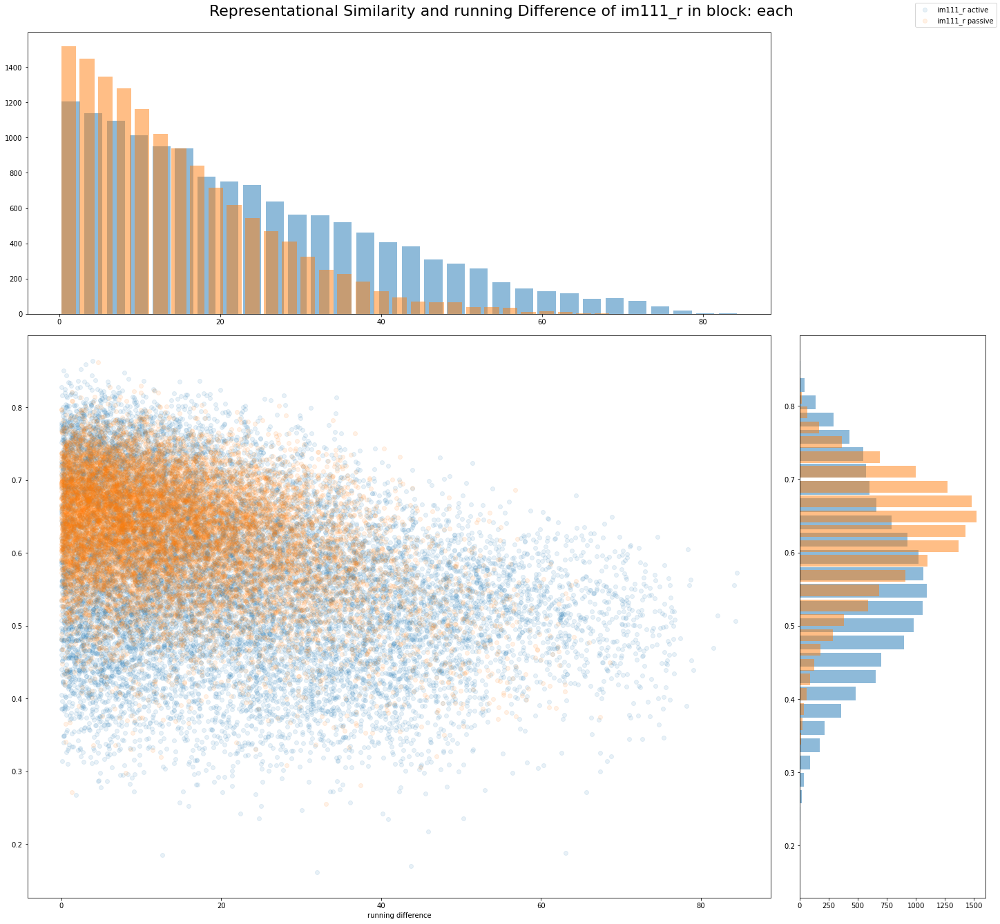

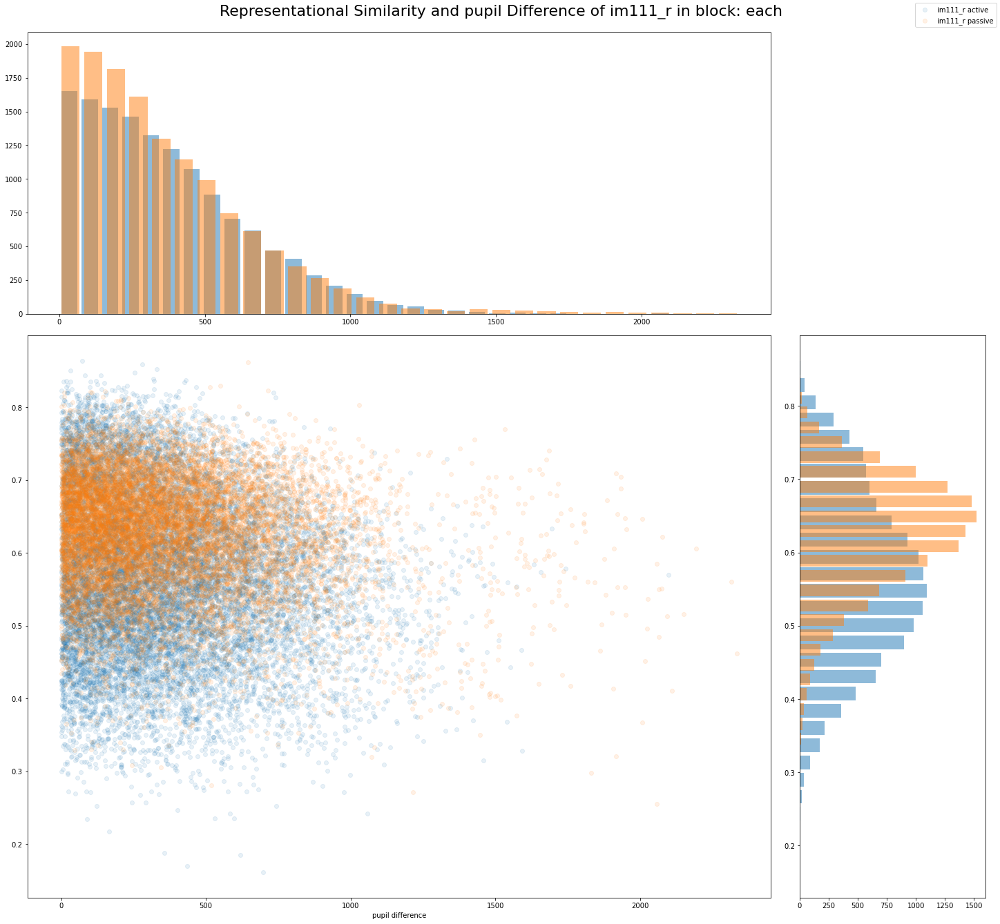

In [164]:
# good VIS


RS_behaviour_active_passive(im, 
                            M_good_VIS, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')

RS_behaviour_active_passive(im, 
                            M_good_VIS, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# RS_behaviour_active_passive(im, 
#                             M_good_VIS, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')



plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861


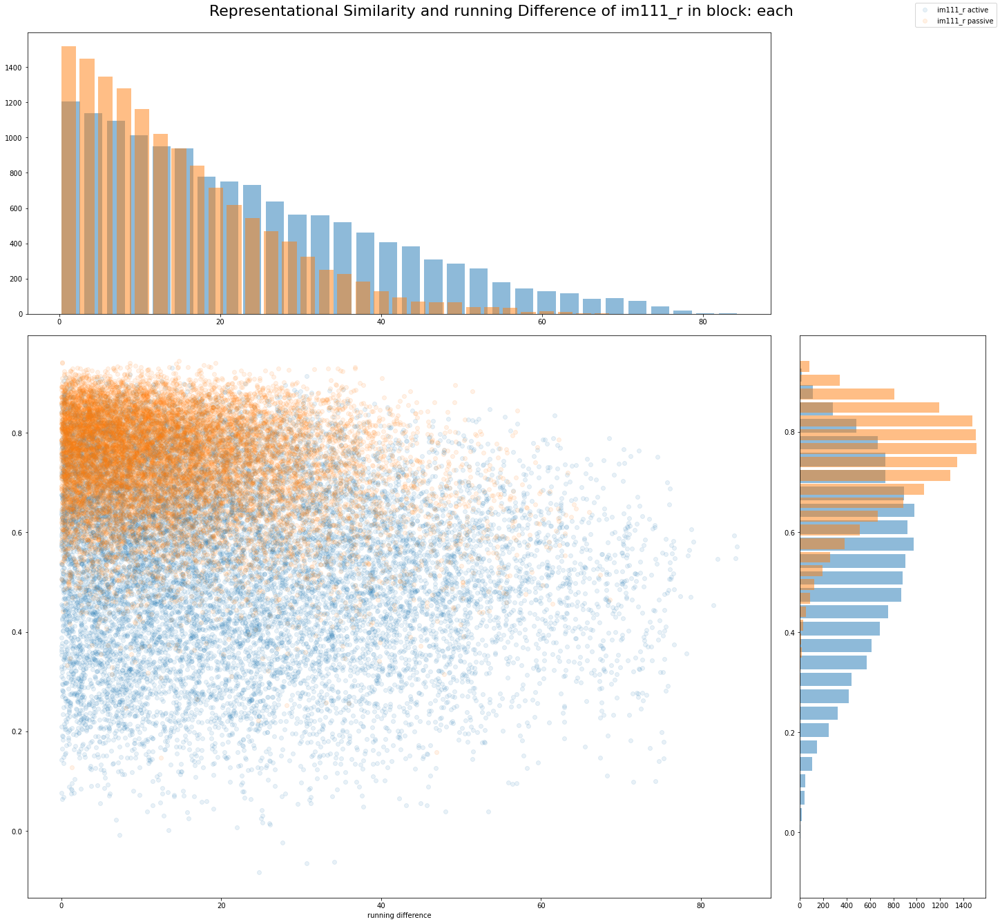

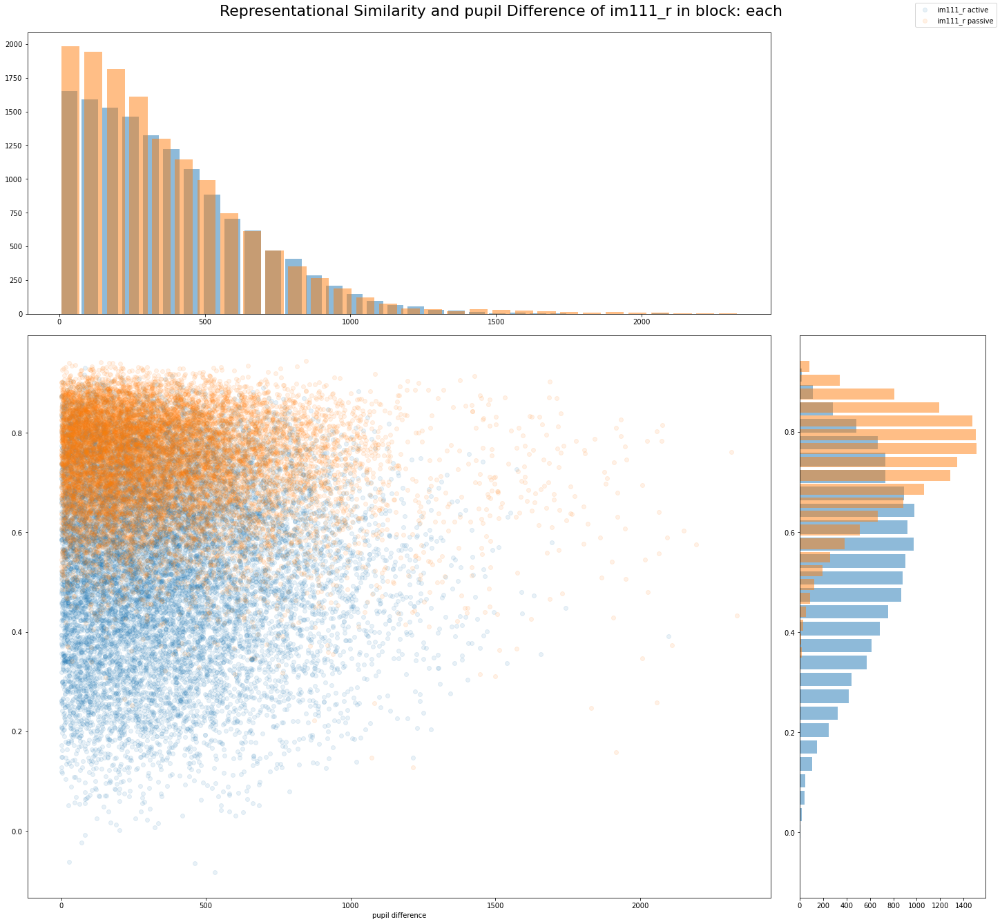

In [163]:
# good VISp

RS_behaviour_active_passive(im, 
                            M_good_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')

RS_behaviour_active_passive(im, 
                            M_good_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# RS_behaviour_active_passive(im, 
#                             M_good_VISp, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')


plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861


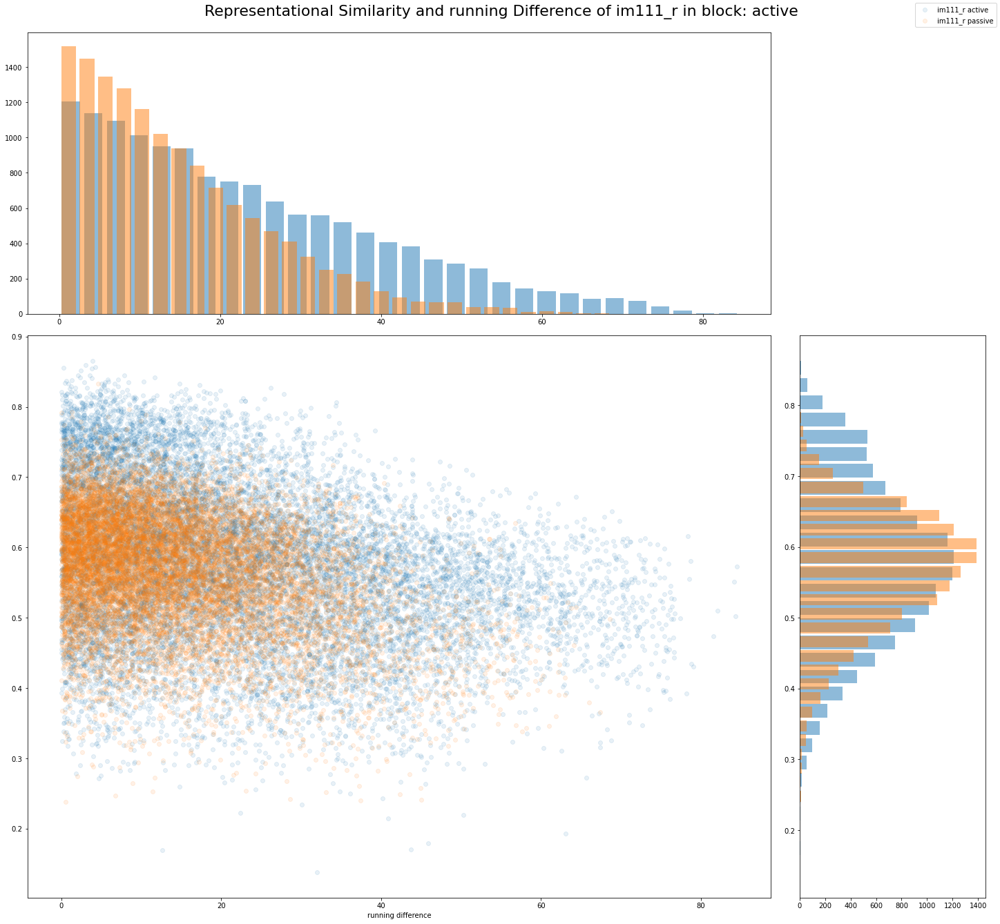

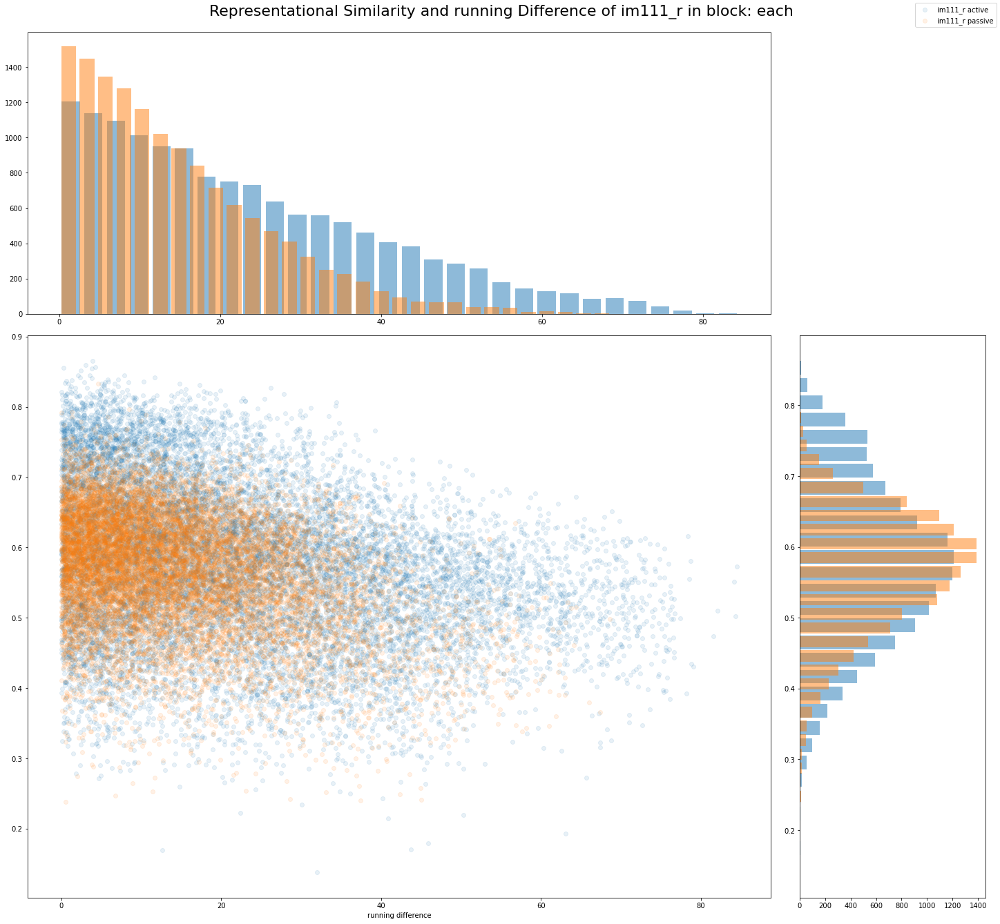

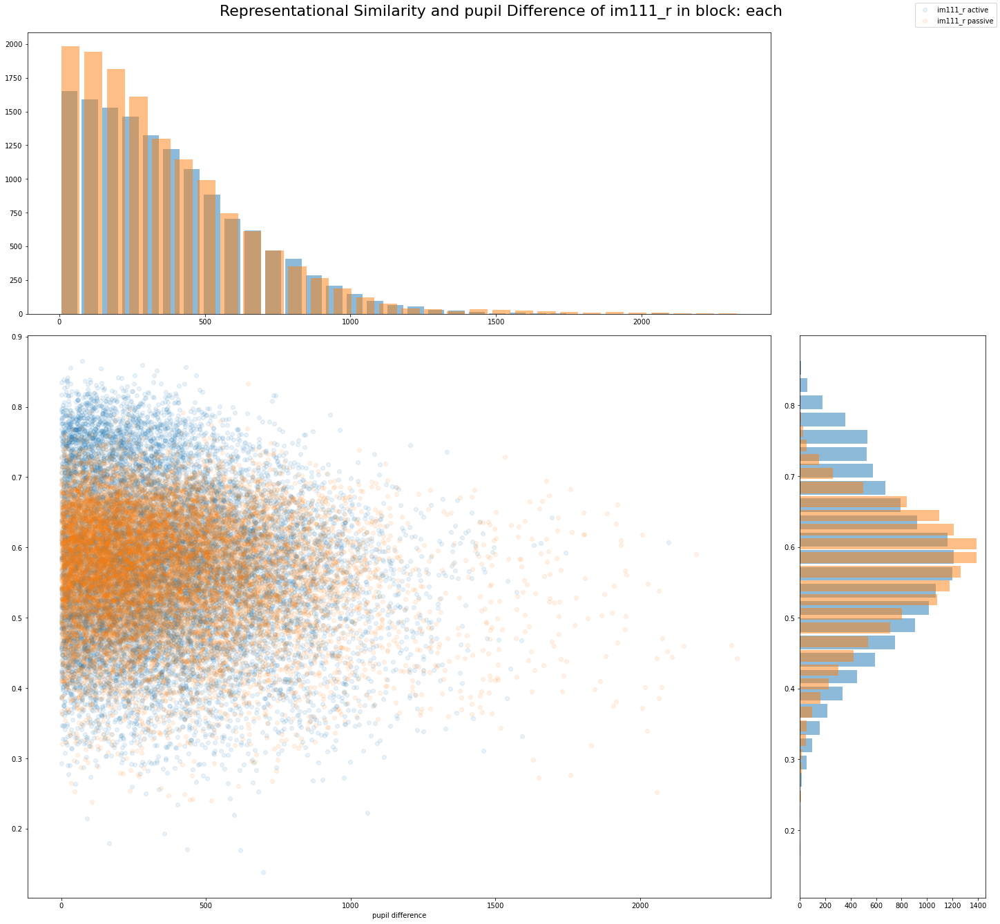

In [166]:
# good VIS without VISp

RS_vs_speed_active_passive(im, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking,'running', 'active')

RS_behaviour_active_passive(im, 
                            M_good_VIS_excld_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')

RS_behaviour_active_passive(im, 
                            M_good_VIS_excld_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# RS_behaviour_active_passive(im, 
#                             M_good_VIS_excld_VISp, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')


In [ ]:
# good CA1

# running speed
RS_behaviour_active_passive(im, 
                            M_good_CA1, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')
# pupil area
RS_behaviour_active_passive(im, 
                            M_good_CA1, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# z-scored behaviour
# RS_behaviour_active_passive(im, 
#                             M_good_CA1, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')



### 4.2 RS vs. Behaviour but averaged over chains
fix picture in active/ passive block

###### all (good) units

im111_r
im111_r


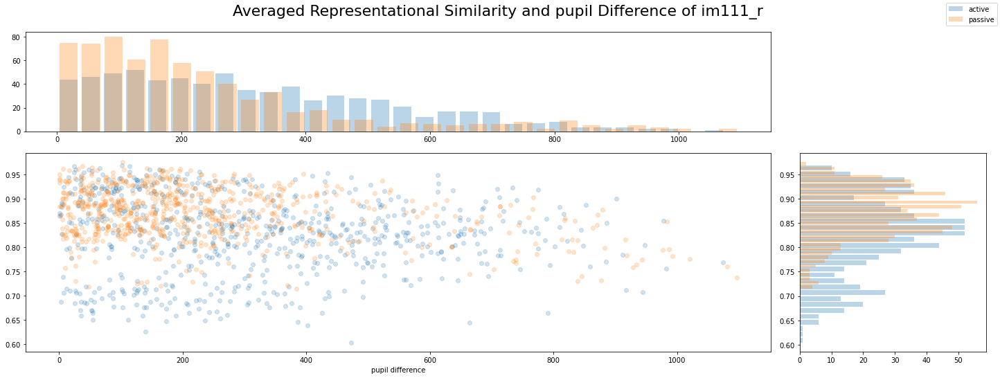

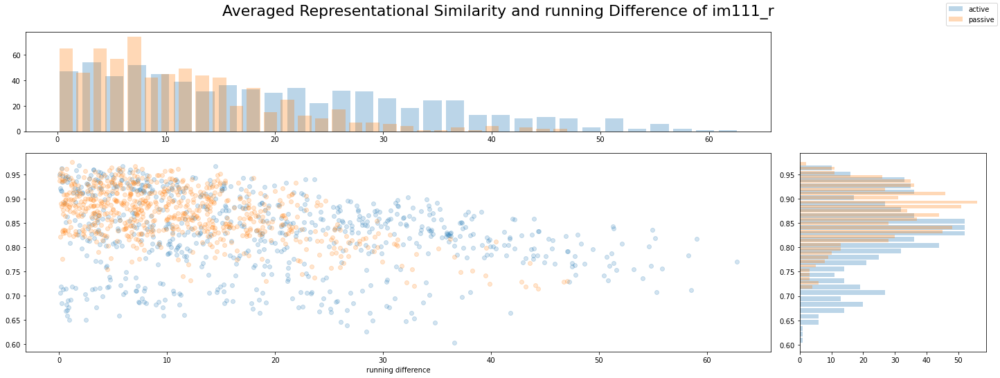

In [168]:
RS_behaviour_avg(im, M_all_good, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_all_good, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good VIS units

im111_r
im111_r


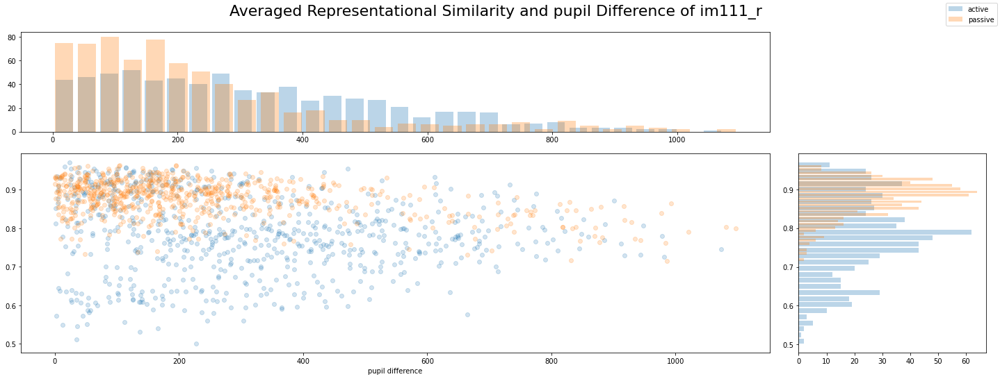

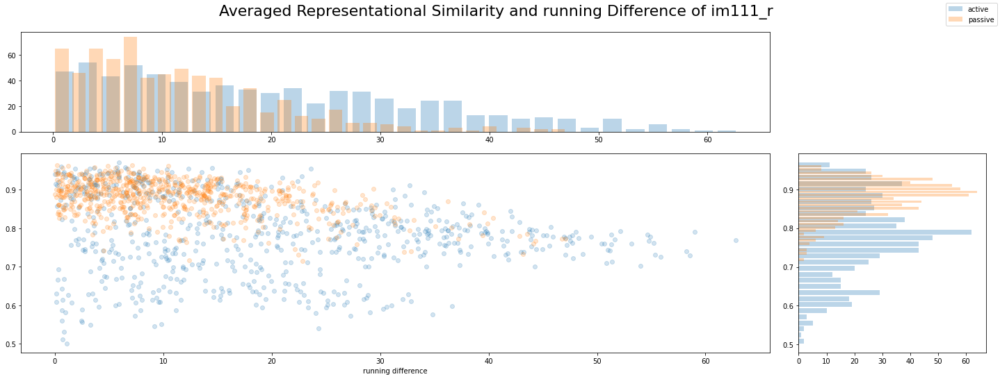

In [172]:
RS_behaviour_avg(im, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good VISp units

im111_r
im111_r


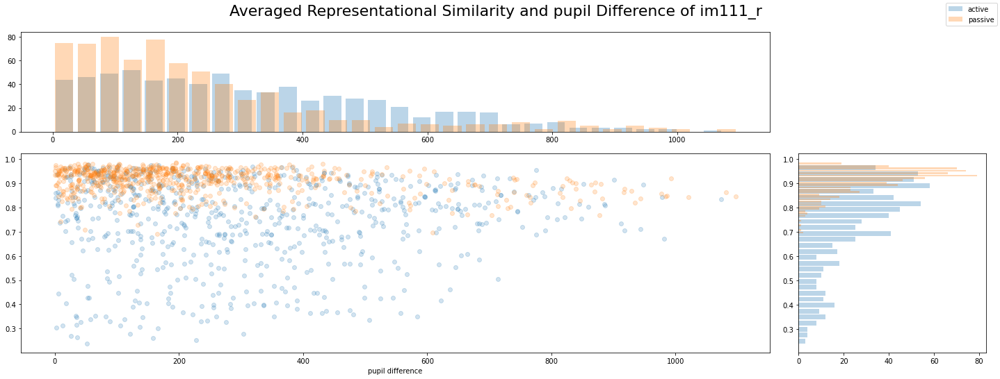

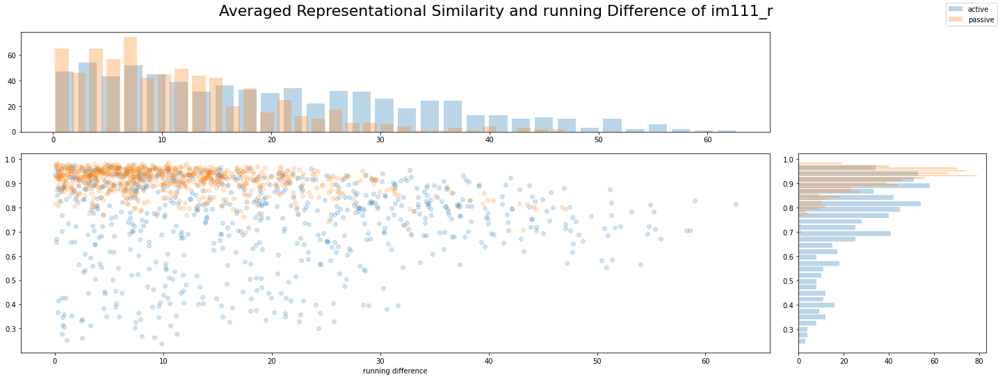

In [173]:
RS_behaviour_avg(im, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good VIS \ VISp units

im111_r
im111_r


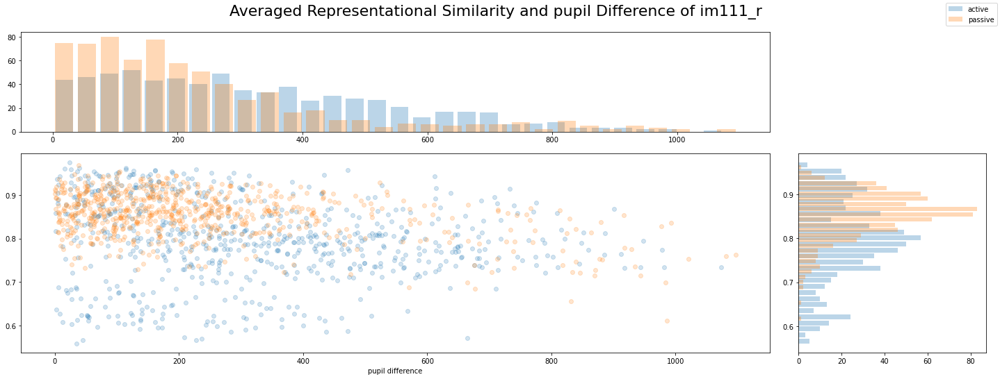

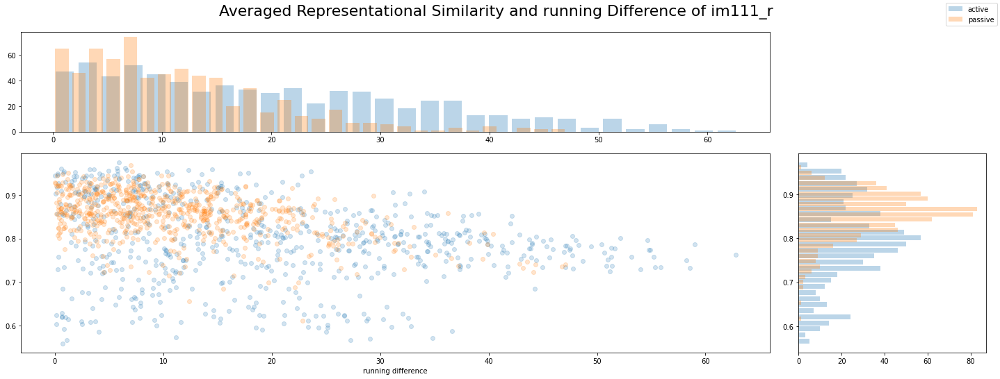

In [174]:
RS_behaviour_avg(im, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good CA1 units

im111_r
im111_r


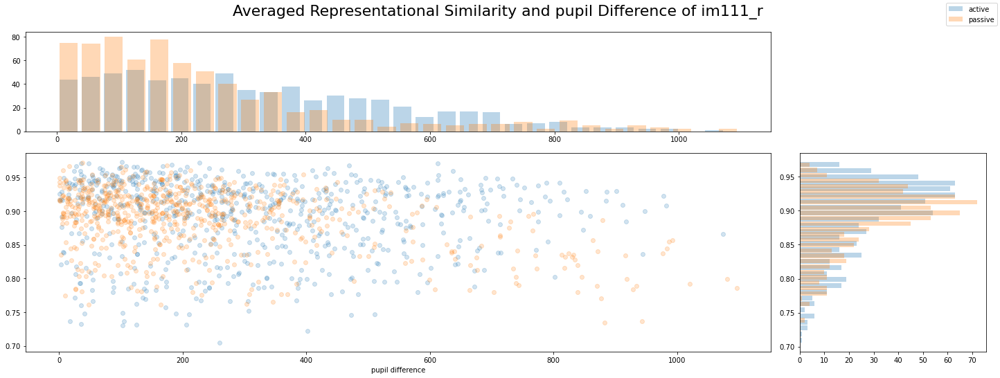

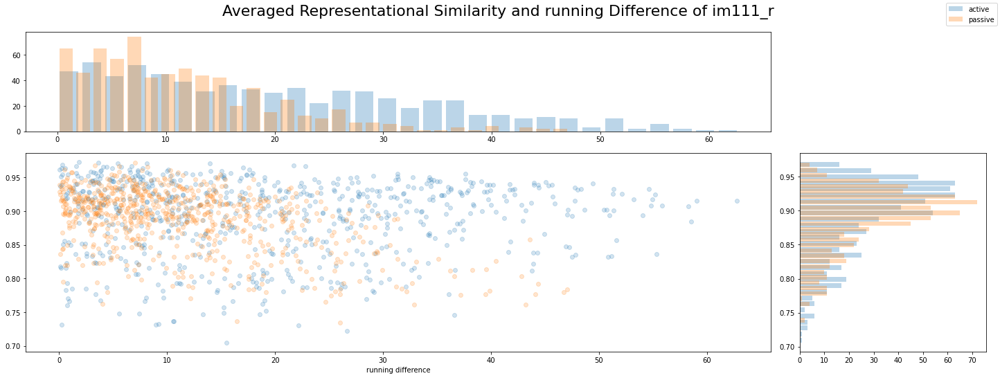

In [171]:
RS_behaviour_avg(im, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good tagged VIS units

im111_r
im111_r


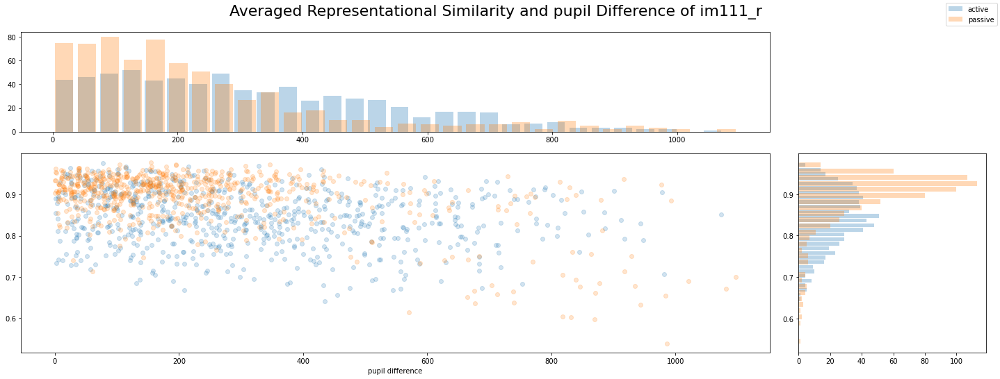

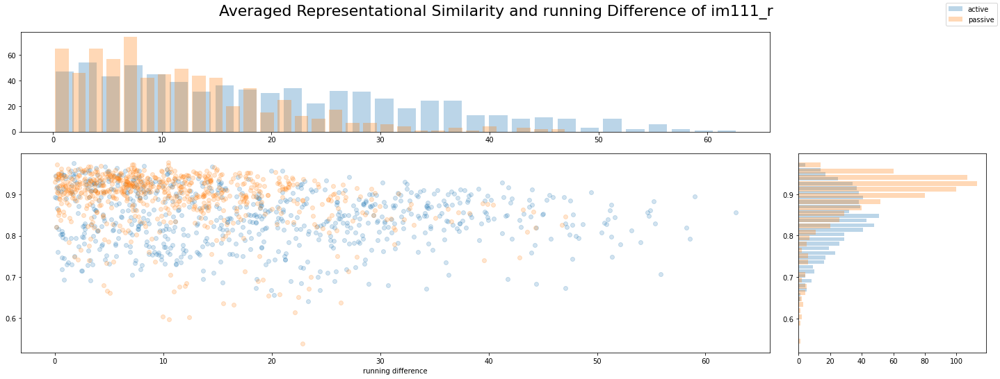

In [170]:
RS_behaviour_avg(im, M_marked_VIS, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_marked_VIS, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good VIS \ tagged VIS units

im111_r
im111_r


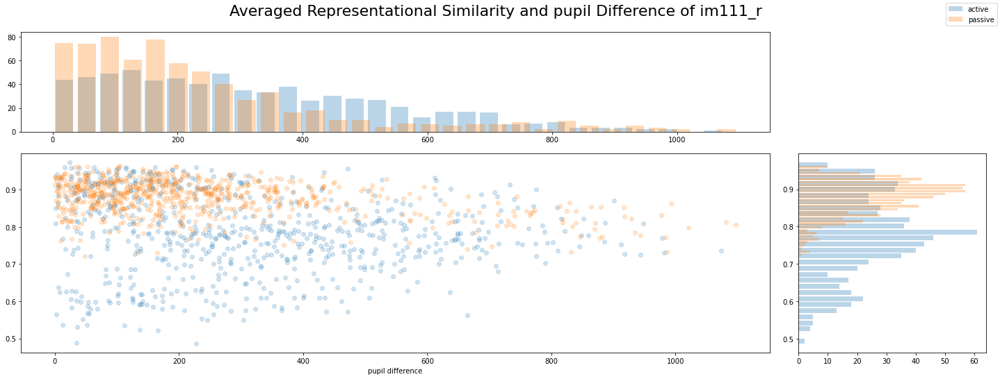

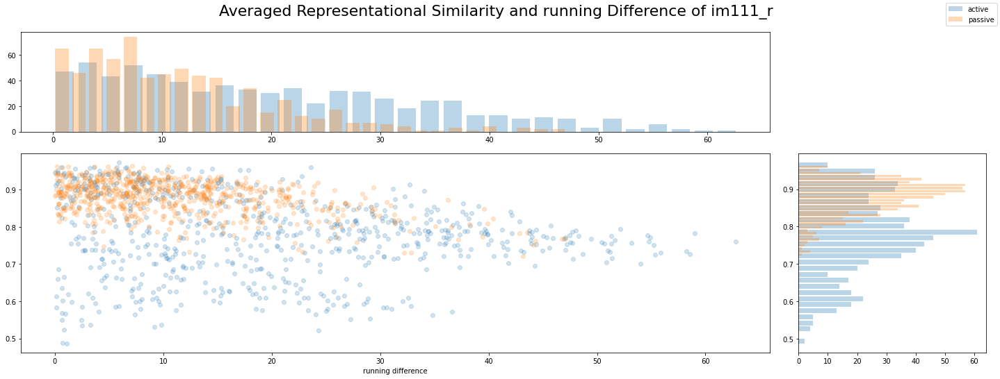

In [169]:
RS_behaviour_avg(im, M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, 'running')

### 4.2 RS vs. z-scored behaviour
fix picture in active/ passive block

###### all (good) units

plotting every 10-th datapoint
13861 13861


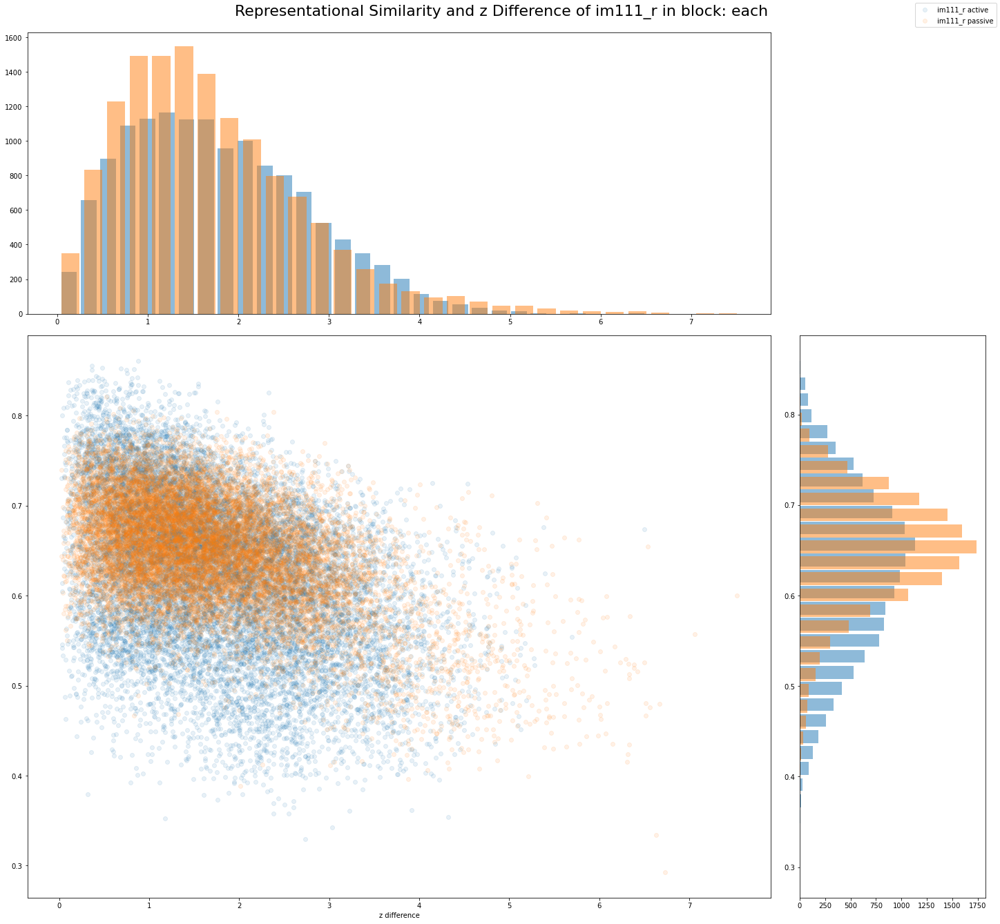

In [187]:
RS_behaviour_active_passive(im, 
                            M_all_good, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good VIS units

plotting every 10-th datapoint
13861 13861


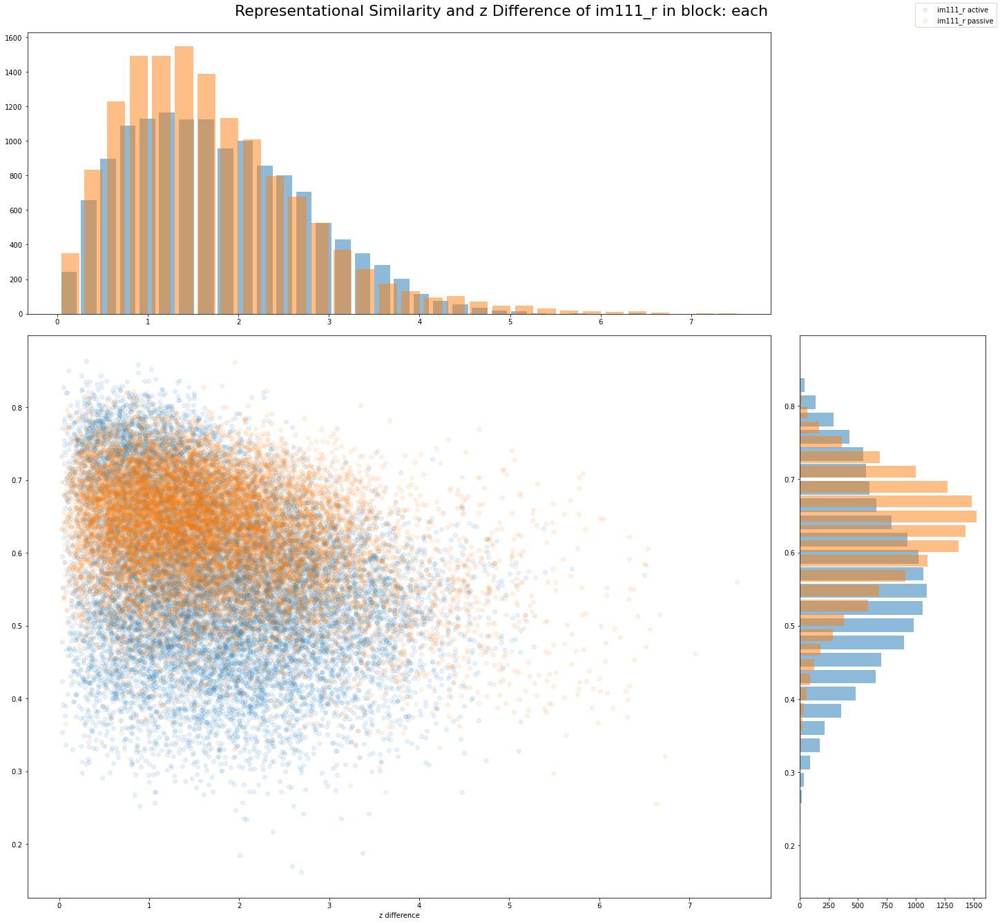

In [188]:
RS_behaviour_active_passive(im, 
                            M_good_VIS, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good VISp units

plotting every 10-th datapoint
13861 13861


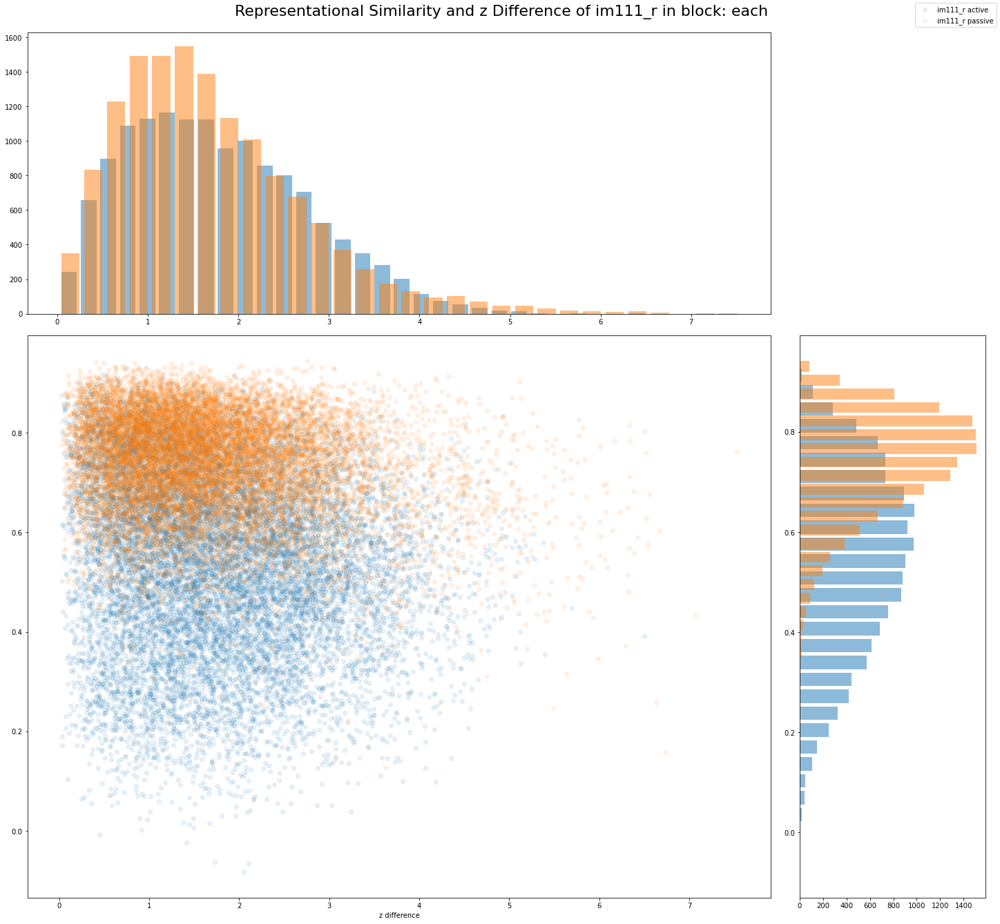

In [189]:
RS_behaviour_active_passive(im, 
                            M_good_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good VIS \ VISp units

plotting every 10-th datapoint
13861 13861


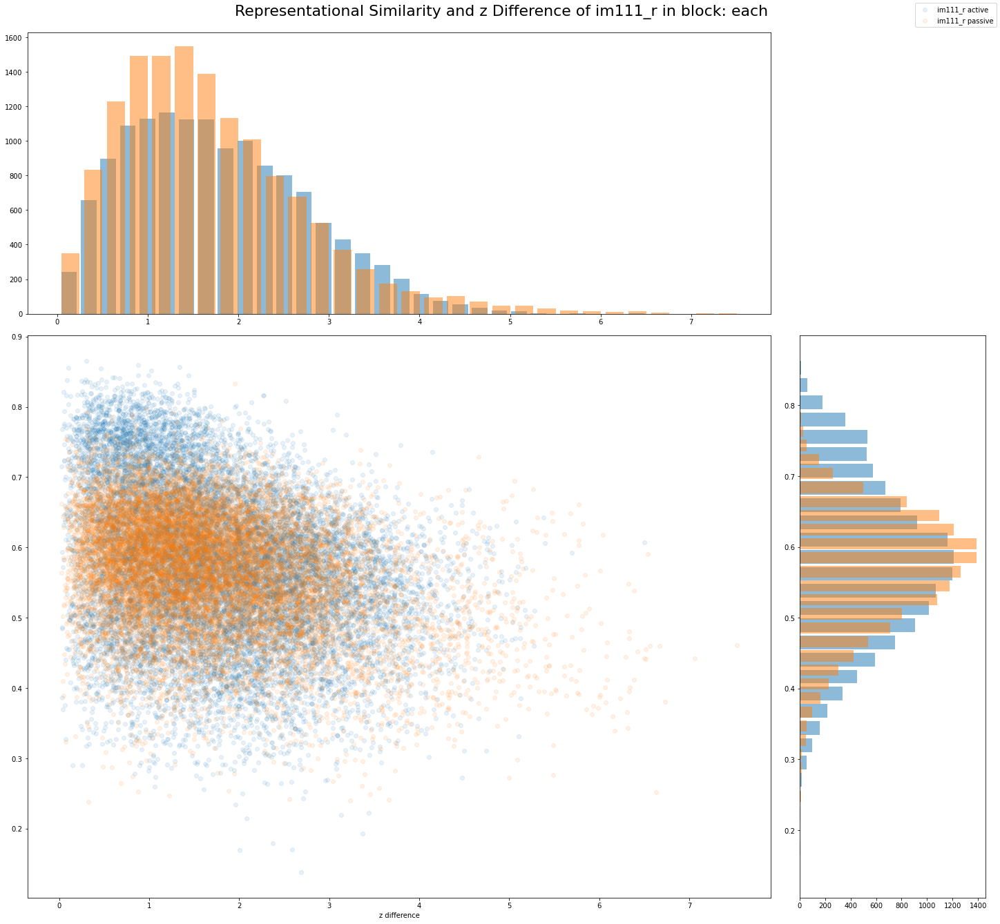

In [190]:
RS_behaviour_active_passive(im, 
                            M_good_VIS_excld_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good CA1 units

plotting every 10-th datapoint
13861 13861


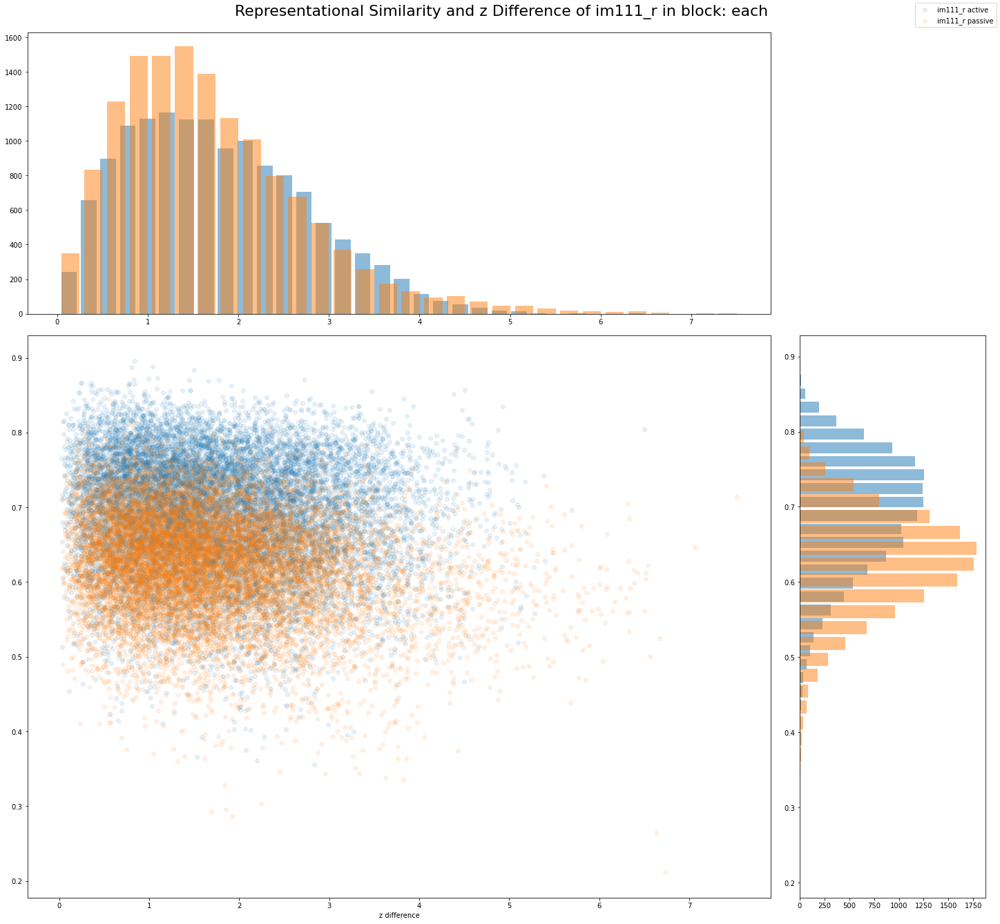

In [191]:
RS_behaviour_active_passive(im, 
                            M_good_CA1, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good tagged VIS units

plotting every 10-th datapoint
13861 13861


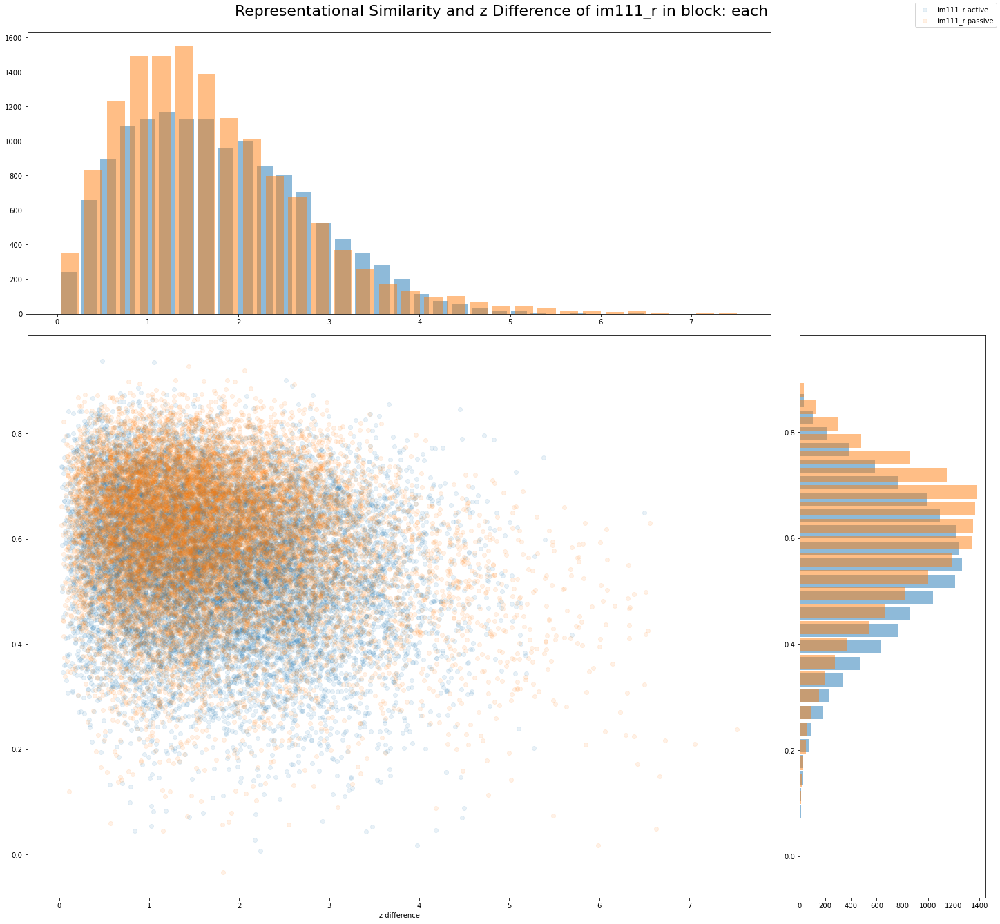

In [192]:
RS_behaviour_active_passive(im, 
                            M_marked_VIS, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good VIS \ tagged VIS units

plotting every 10-th datapoint
13861 13861


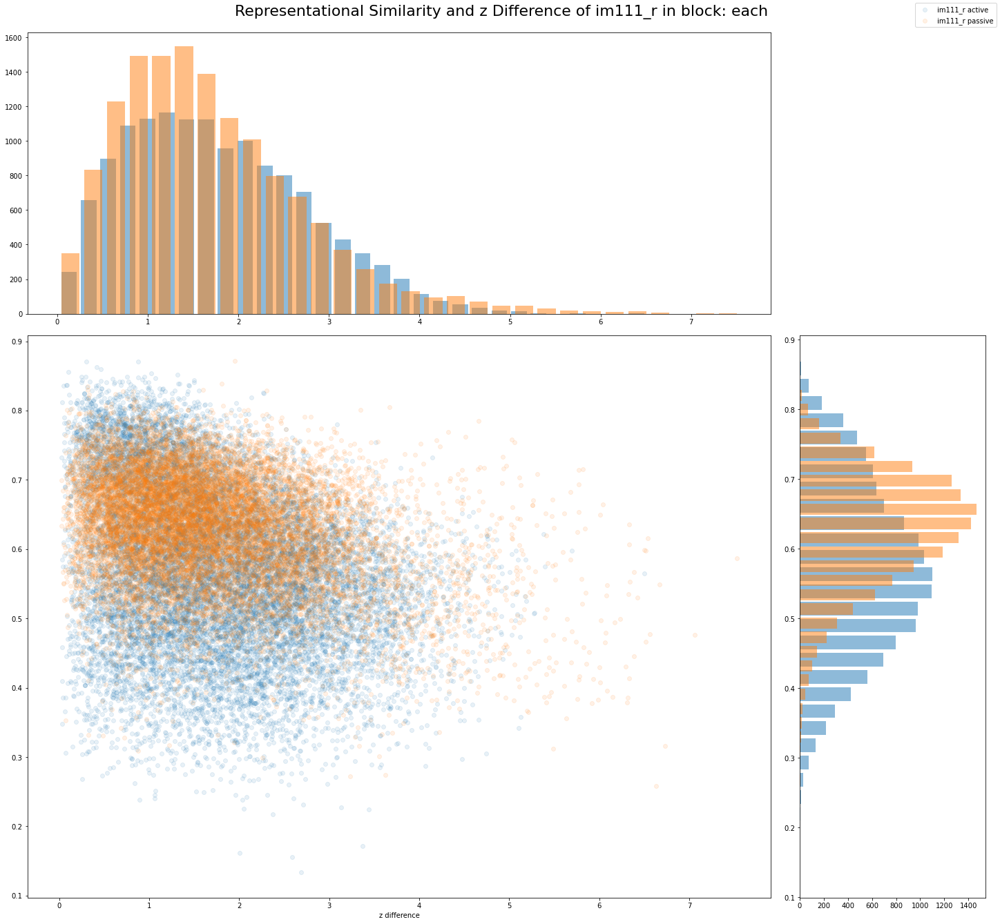

In [193]:
RS_behaviour_active_passive(im, M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, behaviour='z', block='each')


### 4.2 RS vs. z-scored behaviour but averaged over chains
fix picture in active/ passive block

###### all (good) units

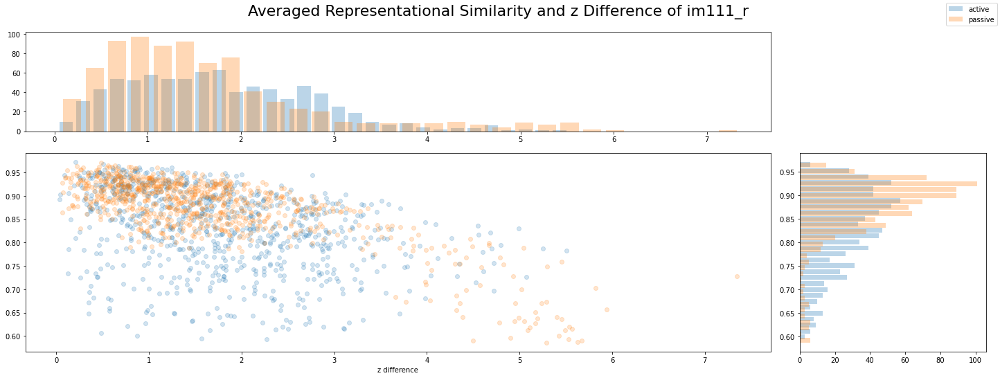

In [40]:
RS_behaviour_avg(im, M_all_good, stimulus_presentations, running_speed, eye_tracking, 'z')

###### good VIS units

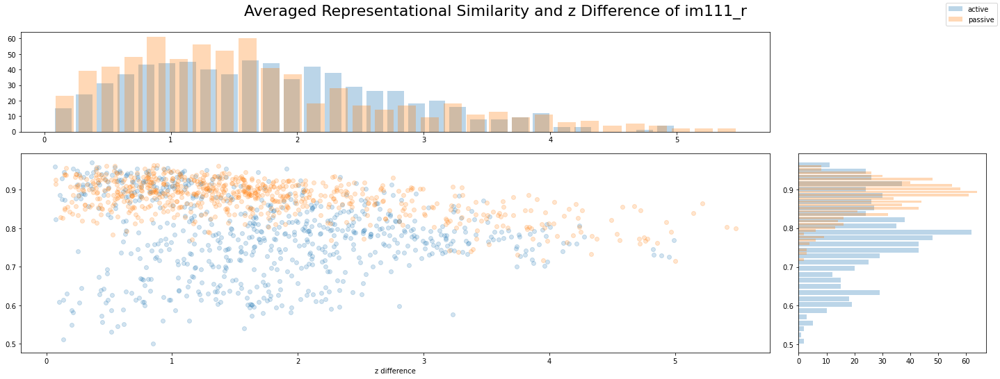

In [184]:
RS_behaviour_avg(im, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, 'z')


###### good VISp units

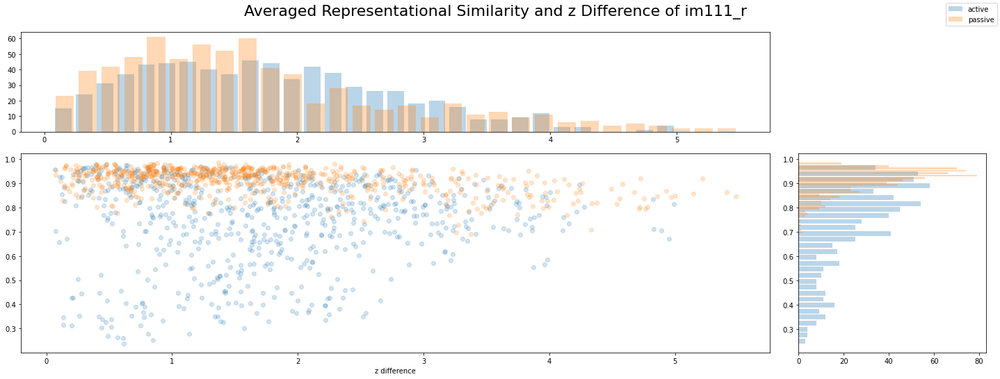

In [183]:
RS_behaviour_avg(im, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'z')

###### good VIS \ VISp units

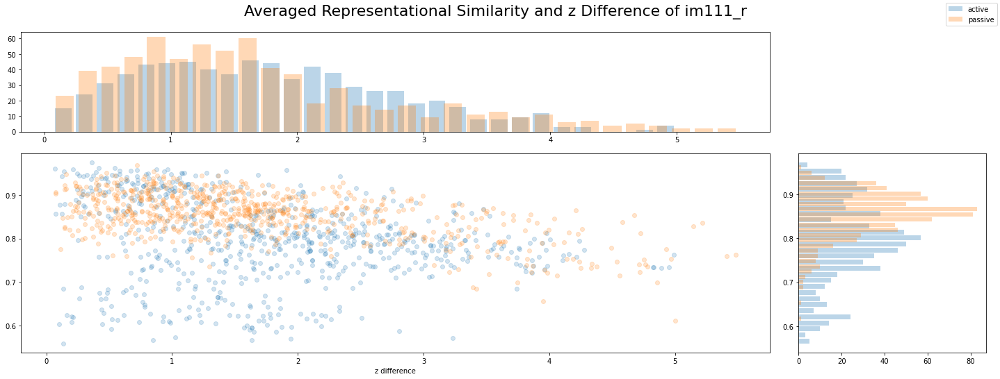

In [182]:
RS_behaviour_avg(im, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, 'z')

###### good CA1 units

im111_r


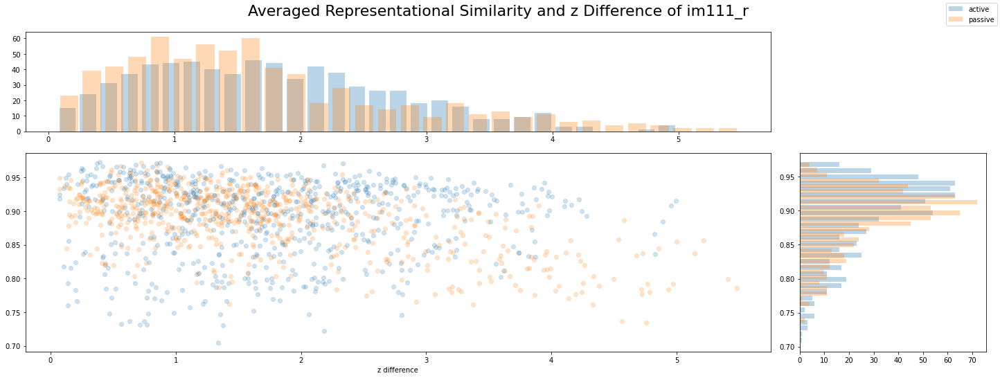

In [180]:
RS_behaviour_avg(im, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, 'z')


###### good tagged VIS units

im111_r


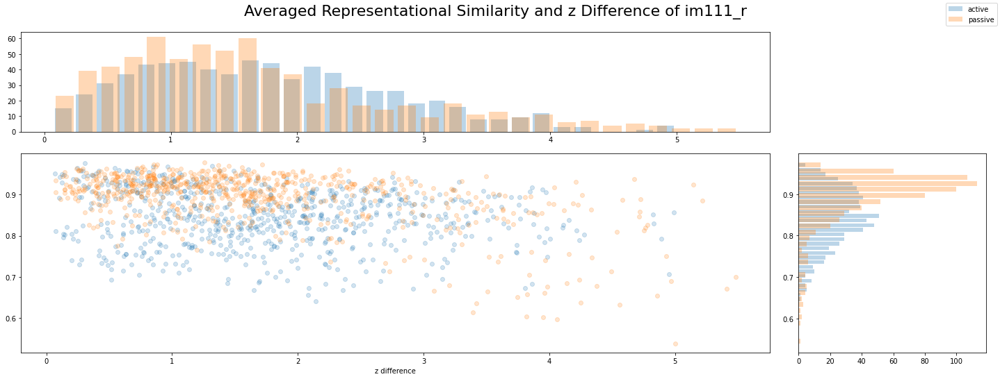

In [179]:
RS_behaviour_avg(im, M_marked_VIS, stimulus_presentations, running_speed, eye_tracking, 'z')


###### good VIS \ tagged VIS units

im111_r


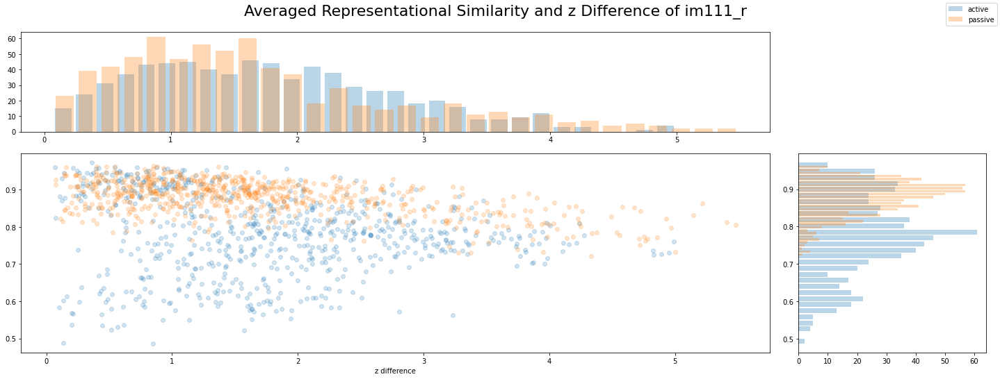

In [178]:
RS_behaviour_avg(im, M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, 'z')

### final plot behaviour vs. RS  (averaged)

In [315]:
from itertools import combinations, product
from numpy.polynomial.polynomial import polyfit

def final_RS_behaviour_avg(image, M, stimulus_presentations, running_speed, eye_tracking, brain_structure, sessionID):

    M_avg_im, M_avg_im_a, M_avg_im_passive, timings_im, timings_start_end_im = average_population_response_over_same_stimulus_presentations(M, image, stimulus_presentations)

    # get the Representational Similarity
    C_avg = np.corrcoef(np.transpose(M_avg_im))            # the Correlation Matrix with reduced stimuli
    C_avg_a = np.corrcoef(np.transpose(M_avg_im_a))
    C_avg_p = np.corrcoef(np.transpose(M_avg_im_passive))

    sp = stimulus_presentations[stimulus_presentations.image_name == image]
    avg_running_speed, std_running_speed, avg_pupil_area, std_pupil_area = extract_speed_and_pupil_data(sp, timings_start_end_im, running_speed, eye_tracking)

    assert len(C_avg) == len(avg_running_speed)

    assert len(C_avg) == len(avg_running_speed)
    assert len(C_avg_a) == len(avg_running_speed)/2
    assert len(C_avg_p) == len(avg_running_speed)/2

    n = len(C_avg)
    half = int(n/2)
    print(n)

    z_t_a, z_t_p = z_score_behaviour(avg_running_speed, avg_pupil_area, half)

    x_im_a = []
    y_im_a = []
    x_im_p = []
    y_im_p = []

    for pair in combinations(range(half), 2):
        i, j = pair

        delta_V_a = np.linalg.norm(z_t_a[i] - z_t_a[j])
        delta_V_p = np.linalg.norm(z_t_p[i] - z_t_p[j])

        # active
        x_im_a.append(delta_V_a)
        y_im_a.append(C_avg_a[i, j])
        # passive
        x_im_p.append(delta_V_p)
        y_im_p.append(C_avg_p[i, j])
        
    
    print(len(x_im_a), len(y_im_a))
    print(len(x_im_p), len(y_im_p))
    
    # Fit with polyfit
    b_a, m_a = polyfit(x_im_a, y_im_a, deg=1)
    b_p, m_p = polyfit(x_im_p, y_im_p, deg=1)
    
    fig, axs = plt.subplots(2, 2, figsize=(12, 7), gridspec_kw={'width_ratios': [4, 1], 'height_ratios': [1,2]})
    fig.tight_layout()
    axs[1,0].grid(axis='both', color='0.95')
    
    # active
    axs[1,0].scatter(x_im_a, y_im_a, alpha=0.2)
    # axs[1,0].legend()
    # hist.,data, 30 bins, 0.5 opacity, label,       for normalized values??       5/4 of binWidth
    axs[0,0].hist(x_im_a, bins=30, alpha=0.3, rwidth=0.8, label='active')
    #plt.title(f"Projection to delta V histogramm plot", fontsize=20)
    axs[0,1].set_visible(False)
    # hist.,data, 30 bins, 0.5 opacity, label,       for normalized values??       5/4 of binWidth
    axs[1,1].hist(y_im_a, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    #plt.title(f"Projection to RS histogramm plot", fontsize=20)
        
    # passive
    axs[1,0].scatter(x_im_p, y_im_p, alpha=0.2)
    # axs[1,0].legend()
    # hist.,data, 30 bins, 0.5 opacity, label,       for normalized values??       5/4 of binWidth
    axs[0,0].hist(x_im_p, bins=30, alpha=0.3, rwidth=0.8, label='passive')
    # plt.title(f"Projection to delta V histogramm plot", fontsize=20)
    # hist.,data, 30 bins, 0.5 opacity, label,       for normalized values??       5/4 of binWidth
    axs[1,1].hist(y_im_p, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    # plt.title(f"Projection to RS histogramm plot", fontsize=20)
    
    # regression:
    # axs[1,0].plot(x_im_a, y_im_a, '.')
    axs[1,0].plot(x_im_a, b_a + np.multiply(m_a,x_im_a) , '--', alpha=0.5)
    axs[1,0].plot(x_im_p, b_p + np.multiply(m_p,x_im_p), '--', alpha=0.5)
    
    
    axs[1,0].set_xlabel("z-behaviour difference")
    axs[1,0].set_ylabel('Representational Similarity')
    
    fig.legend()
    fig.suptitle(t=f'Representational Similarity and Z-Behaviour Difference of {image[:-2]} in {brain_structure}, session={sessionID}', fontsize=20, y=1.05)
    # plt.savefig(f'plots/RS_vs_delta_behaviour_in_{brain_structure}_session_{sessionID}.png', bbox_inches='tight')
    

82
820 820
820 820


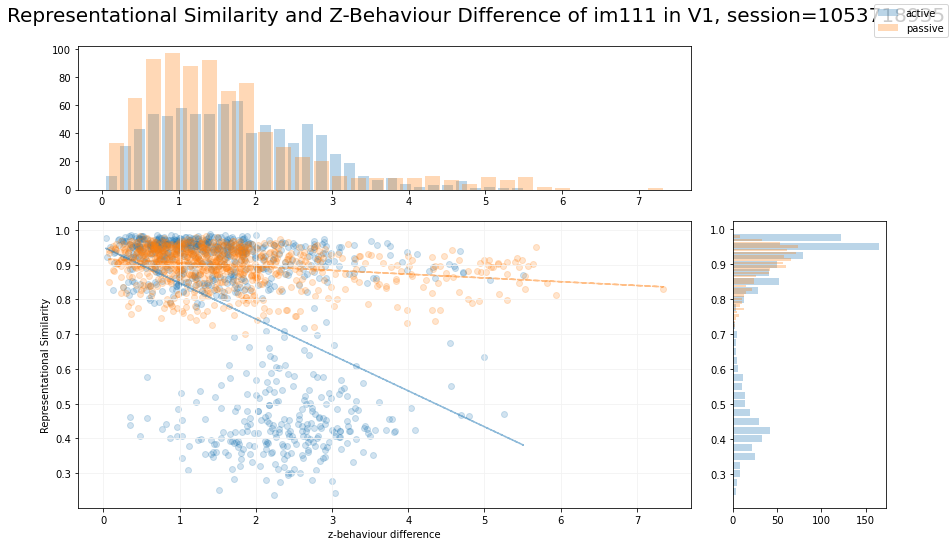

In [316]:
final_RS_behaviour_avg('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'V1', sessionID)


82


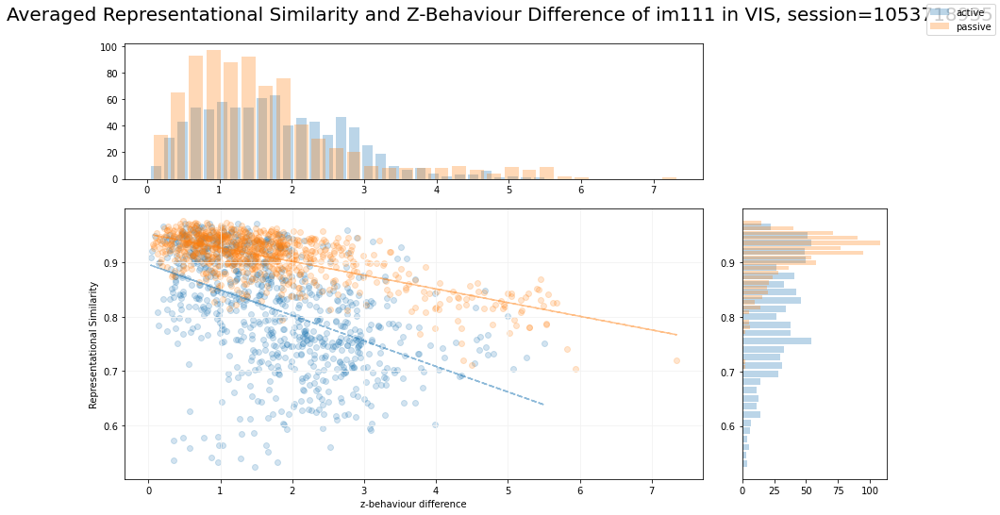

In [133]:
final_RS_behaviour_avg('im111_r', M_good_VIS, stimulus_presentations, running_speed, eye_tracking, 'VIS', sessionID)


82


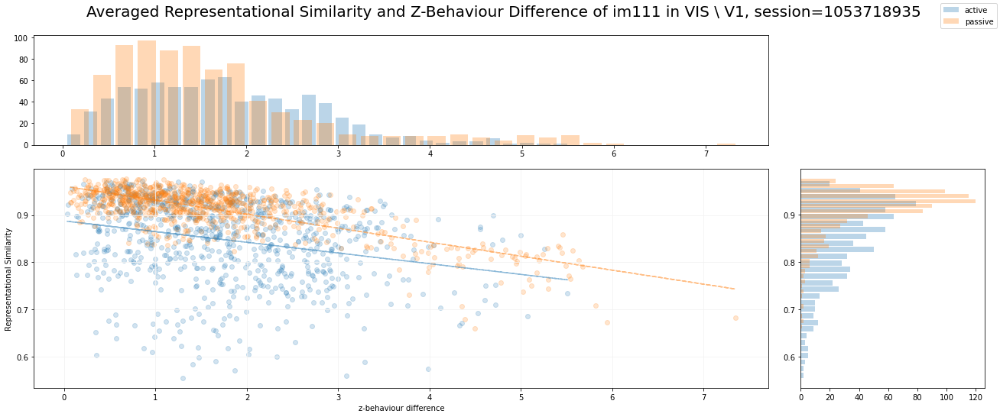

In [122]:
final_RS_behaviour_avg('im111_r', M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, 'VIS \ V1', sessionID)


82


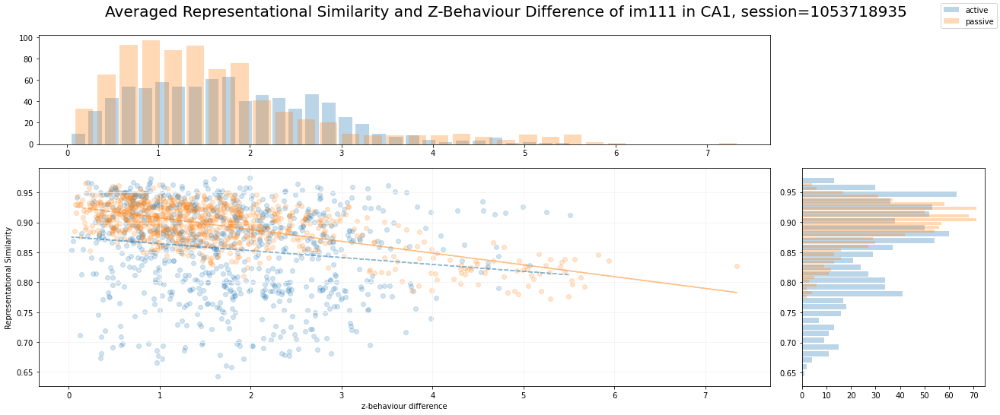

In [125]:
final_RS_behaviour_avg('im111_r', M_good_CA1, stimulus_presentations, running_speed, eye_tracking, 'CA1', sessionID)


### fixed:

In [52]:
from itertools import combinations, product
from numpy.polynomial.polynomial import polyfit

def final_RS_behaviour_avg2(image, M, stimulus_presentations, running_speed, eye_tracking, brain_structure, sessionID):

    M_avg_im, M_avg_im_a, M_avg_im_passive, timings_im, timings_start_end_im = average_population_response_over_same_stimulus_presentations(M, image, stimulus_presentations)

    # get the Representational Similarity
    C_avg = np.corrcoef(np.transpose(M_avg_im))            # the Correlation Matrix with reduced stimuli

    sp = stimulus_presentations[stimulus_presentations.image_name == image]
    avg_running_speed, std_running_speed, avg_pupil_area, std_pupil_area = extract_speed_and_pupil_data(sp, timings_start_end_im, running_speed, eye_tracking)

    assert len(C_avg) == len(avg_running_speed)
    assert len(C_avg) == len(avg_pupil_area)

    n = len(C_avg)
    half = int(n/2)
    print(n, half)

    z_t = z_score_behaviour_full(avg_running_speed, avg_pupil_area)

    x_im_a = []
    y_im_a = []
    x_im_p = []
    y_im_p = []
    x_im_b = []
    y_im_b = []
    x_all = []
    y_all = []

    for pair in combinations(range(n), 2):
        i, j = pair

        delta_V = np.linalg.norm(z_t[i] - z_t[j])
        
        if (i < half) and (j < half):
            # within active block
            # active
            x_im_a.append(delta_V)
            y_im_a.append(C_avg[i, j])
        elif (i >= half) and (j >= half):
            # within passive block
            # passive
            x_im_p.append(delta_V)
            y_im_p.append(C_avg[i, j])
        else:
            x_im_b.append(delta_V)
            y_im_b.append(C_avg[i,j])
        
        x_all.append(delta_V)
        y_all.append(C_avg[i,j])
            
        
    print(len(x_im_a), len(y_im_a))
    print(len(x_im_p), len(y_im_p))
    print(len(x_im_b), len(y_im_b))
    print(len(x_all), len(y_all))
    
    # Fit with polyfit
    # b_a, m_a = polyfit(x_im_a, y_im_a, deg=1)
    # b_p, m_p = polyfit(x_im_p, y_im_p, deg=1)
    # b_b, m_b = polyfit(x_im_b, y_im_b, deg=1)
    b, m = polyfit(x_all, y_all, deg=1)
    
    
    fig, axs = plt.subplots(2, 2, figsize=(14, 8), gridspec_kw={'width_ratios': [4, 1], 'height_ratios': [1,2]}, sharex='col', sharey='row', dpi=dp)
    fig.tight_layout()
    # axs[1,0].grid(axis='both', color='0.95')
    
    # active
    axs[1,0].scatter(x_im_a, y_im_a, alpha=0.15)
    axs[0,0].hist(x_im_a, bins=50, alpha=0.3, rwidth=0.8, label='within active')
    axs[0,0].axvline(np.mean(x_im_a), color='C0', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[0,1].set_visible(False)
    axs[1,1].hist(y_im_a, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_a), color='C0', linestyle='dashed', linewidth=1, alpha=0.5)
        
    # passive
    axs[1,0].scatter(x_im_p, y_im_p, alpha=0.15)
    axs[0,0].hist(x_im_p, bins=50, alpha=0.3, rwidth=0.8, label='within passive')
    axs[0,0].axvline(np.mean(x_im_p), color='C1', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[1,1].hist(y_im_p, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_p), color='C1', linestyle='dashed', linewidth=1, alpha=0.5)
    
    # across
    axs[1,0].scatter(x_im_b, y_im_b, alpha=0.15)
    axs[0,0].hist(x_im_b, bins=50, alpha=0.3, rwidth=0.8, label='across blocks')
    axs[0,0].axvline(np.mean(x_im_b), color='C2', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[1,1].hist(y_im_b, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_b), color='C2', linestyle='dashed', linewidth=1, alpha=0.5)
    
    # means
    axs[1,0].scatter(np.mean(x_im_a), np.mean(y_im_a), marker='X', c='darkblue', edgecolor='white', s=65, label='mean active')
    axs[1,0].scatter(np.mean(x_im_p), np.mean(y_im_p), marker='X', c='darkorange', edgecolor='white', s=65, label='mean passive')
    axs[1,0].scatter(np.mean(x_im_b), np.mean(y_im_b), marker='X', c='darkgreen', edgecolor='white', s=65, label='mean across blocks')
    
    # regression:
    # axs[1,0].plot(x_im_a, y_im_a, '.')
    # axs[1,0].plot(x_im_a, b_a + np.multiply(m_a,x_im_a), '--', alpha=0.5)
    # axs[1,0].plot(x_im_p, b_p + np.multiply(m_p,x_im_p), '--', alpha=0.5)
    # axs[1,0].plot(x_im_b, b_b + np.multiply(m_b,x_im_b), '--', alpha=0.5)
    axs[1,0].plot(x_all, b + np.multiply(m,x_all), ls='dashed', alpha=0.5, c='black', label='regression')
    print(m)
    
    axs[1,0].set_xlabel("z-behaviour difference")
    axs[1,0].set_ylabel('Representational Similarity')
    
    for ax in axs.flat:
        ax.tick_params(labelbottom=True, labelleft=True)
    
    fig.legend(bbox_to_anchor =(0.97, 0.97))
    fig.suptitle(t=f'Representational Similarity and Z-Behaviour Difference of {image[:-2]} in {brain_structure} - session={sessionID}', fontsize=20, y=1.05)
    plt.savefig(f'plots/RS_vs_delta_behaviour_in_{brain_structure}_blocks.png', bbox_inches='tight')
    

82 41
820 820
820 820
1681 1681
3321 3321
-0.16390942940653327


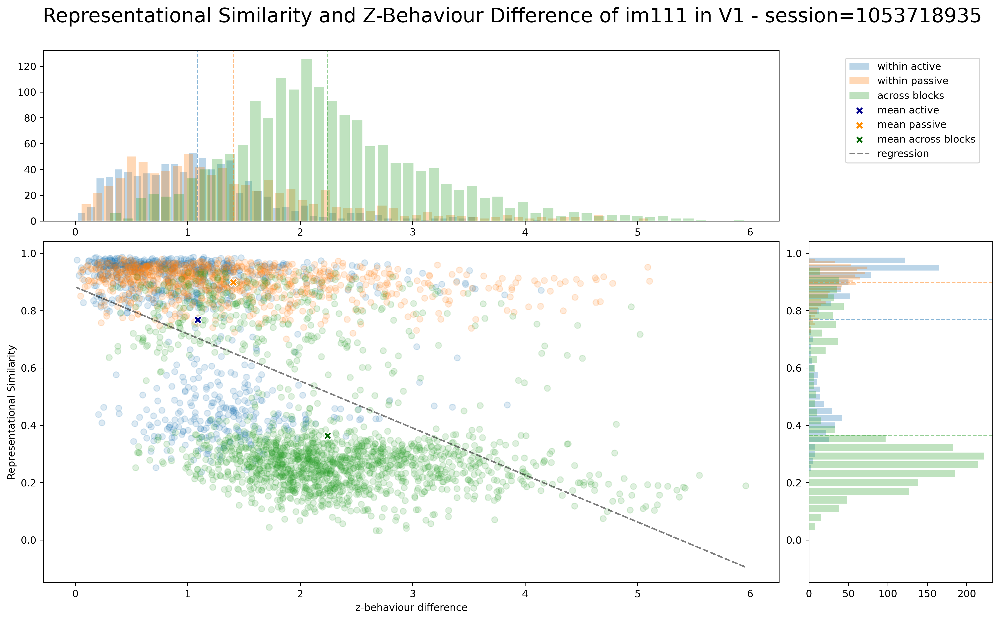

In [53]:
final_RS_behaviour_avg2('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'V1', sessionID)


82 41
820 820
820 820
1681 1681
3321 3321
-0.08478050724422005


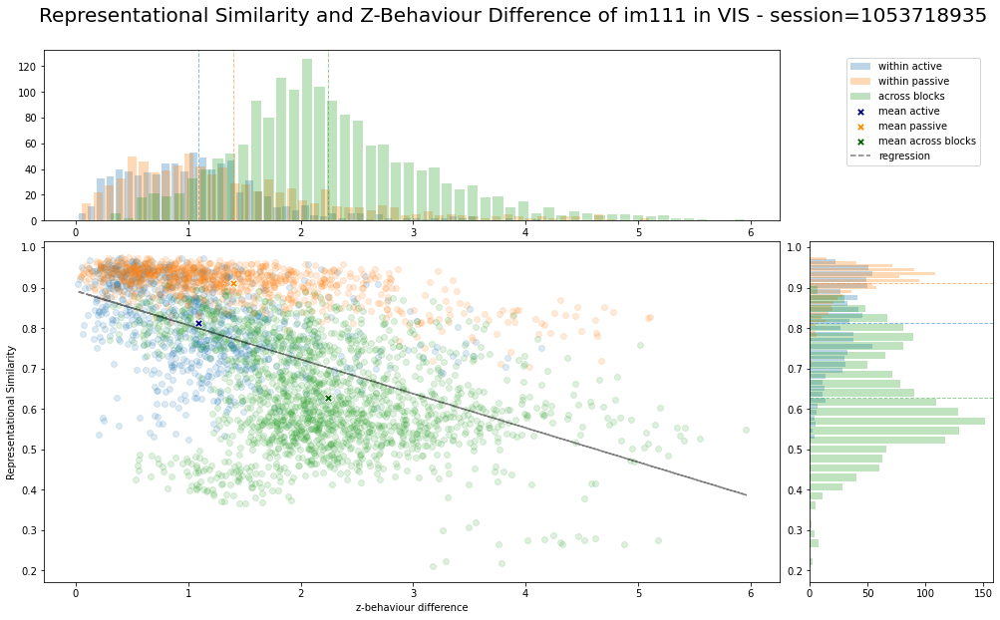

In [319]:
final_RS_behaviour_avg2('im111_r', M_good_VIS, stimulus_presentations, running_speed, eye_tracking, 'VIS', sessionID)


82 41
820 820
820 820
1681 1681
3321 3321
-0.04452755769792529


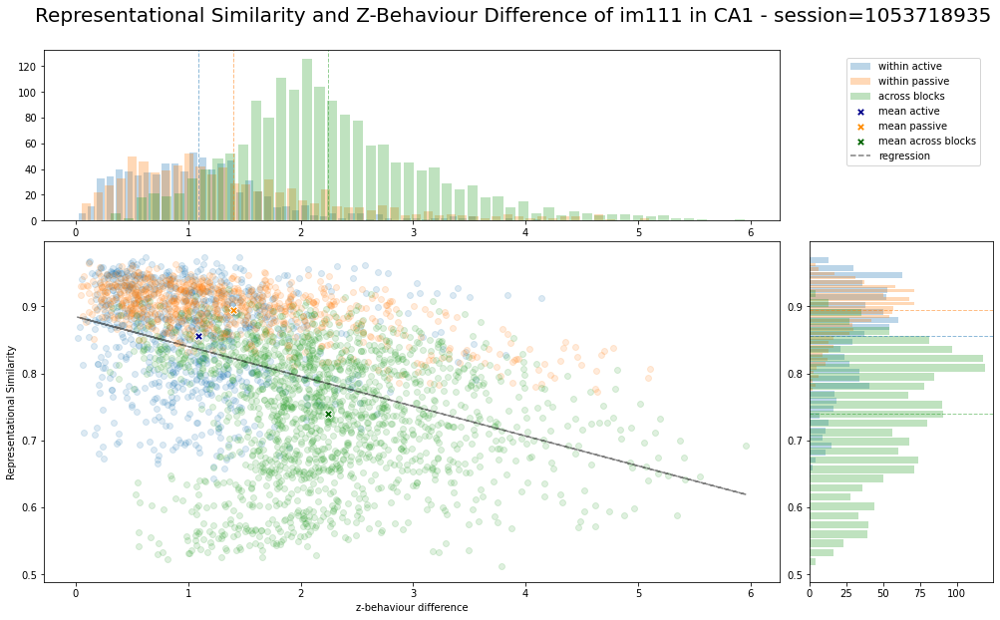

In [320]:
final_RS_behaviour_avg2('im111_r', M_good_CA1, stimulus_presentations, running_speed, eye_tracking, 'CA1', sessionID)


In [159]:
half = 41

act = 0
pas = 0 
across = 0

for pair in combinations(range(82), 2):
    i, j = pair
    if (i < half) and (j < half):
        # within active block
        # print('act', pair)
        act += 1
    elif (i >= half) and (j >= half):
        # within passive block
        # print('pas', pair)
        pas += 1
    else:
        # print('across', pair)
        across += 1

print(act, pas, across)

820 820 1681


In [54]:
# without across block:
def final_RS_behaviour_excl(image, M, stimulus_presentations, running_speed, eye_tracking, brain_structure, sessionID):

    M_avg_im, M_avg_im_a, M_avg_im_passive, timings_im, timings_start_end_im = average_population_response_over_same_stimulus_presentations(M, image, stimulus_presentations)

    # get the Representational Similarity
    C_avg = np.corrcoef(np.transpose(M_avg_im))            # the Correlation Matrix with reduced stimuli

    sp = stimulus_presentations[stimulus_presentations.image_name == image]
    avg_running_speed, std_running_speed, avg_pupil_area, std_pupil_area = extract_speed_and_pupil_data(sp, timings_start_end_im, running_speed, eye_tracking)

    assert len(C_avg) == len(avg_running_speed)
    assert len(C_avg) == len(avg_pupil_area)

    n = len(C_avg)
    half = int(n/2)
    print(n, half)

    z_t = z_score_behaviour_full(avg_running_speed, avg_pupil_area)

    x_im_a = []
    y_im_a = []
    x_im_p = []
    y_im_p = []
    x_im_b = []
    y_im_b = []
    x_all = []
    y_all = []

    for pair in combinations(range(n), 2):
        i, j = pair

        delta_V = np.linalg.norm(z_t[i] - z_t[j])
        
        if (i < half) and (j < half):
            # within active block
            # active
            x_im_a.append(delta_V)
            y_im_a.append(C_avg[i, j])
        elif (i >= half) and (j >= half):
            # within passive block
            # passive
            x_im_p.append(delta_V)
            y_im_p.append(C_avg[i, j])
        else:
            x_im_b.append(delta_V)
            y_im_b.append(C_avg[i,j])
        
        x_all.append(delta_V)
        y_all.append(C_avg[i,j])
            
        
    print(len(x_im_a), len(y_im_a))
    print(len(x_im_p), len(y_im_p))
    print(len(x_im_b), len(y_im_b))
    print(len(x_all), len(y_all))
    
    # Fit with polyfit
    b_a, m_a = polyfit(x_im_a, y_im_a, deg=1)
    b_p, m_p = polyfit(x_im_p, y_im_p, deg=1)
    # b_b, m_b = polyfit(x_im_b, y_im_b, deg=1)
    # b, m = polyfit(x_all, y_all, deg=1)
    
    
    fig, axs = plt.subplots(2, 2, figsize=(13, 8), gridspec_kw={'width_ratios': [4, 1], 'height_ratios': [1,2]}, sharex='col', sharey='row', dpi=dp)
    fig.tight_layout()
    # axs[1,0].grid(axis='both', color='0.95')
    
    # active
    axs[1,0].scatter(x_im_a, y_im_a, alpha=0.15)
    axs[0,0].hist(x_im_a, bins=30, alpha=0.3, rwidth=0.8, label='within active')
    axs[0,0].axvline(np.mean(x_im_a), color='C0', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[0,1].set_visible(False)
    axs[1,1].hist(y_im_a, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_a), color='C0', linestyle='dashed', linewidth=1, alpha=0.5)
        
    # passive
    axs[1,0].scatter(x_im_p, y_im_p, alpha=0.15)
    axs[0,0].hist(x_im_p, bins=30, alpha=0.3, rwidth=0.8, label='within passive')
    axs[0,0].axvline(np.mean(x_im_p), color='C1', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[1,1].hist(y_im_p, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_p), color='C1', linestyle='dashed', linewidth=1, alpha=0.5)
    
    # across
    # axs[1,0].scatter(x_im_b, y_im_b, alpha=0.15)
    # axs[0,0].hist(x_im_b, bins=30, alpha=0.3, rwidth=0.8, label='across blocks')
    # axs[0,0].axvline(np.mean(x_im_b), color='C2', linestyle='dashed', linewidth=1, alpha=0.5)
    # axs[1,1].hist(y_im_b, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    # axs[1,1].axhline(np.mean(y_im_b), color='C2', linestyle='dashed', linewidth=1, alpha=0.5)
    
    # means
    axs[1,0].scatter(np.mean(x_im_a), np.mean(y_im_a), marker='X', c='darkblue', edgecolor='white', s=65, label='mean active')
    axs[1,0].scatter(np.mean(x_im_p), np.mean(y_im_p), marker='X', c='darkorange', edgecolor='white', s=65, label='mean passive')
    # axs[1,0].scatter(np.mean(x_im_b), np.mean(y_im_b), marker='X', c='darkgreen', edgecolor='white', s=65, label='mean across blocks')
    
    # regression:
    # axs[1,0].plot(x_im_a, y_im_a, '.')
    axs[1,0].plot(x_im_a, b_a + np.multiply(m_a,x_im_a), '--', alpha=0.5)
    axs[1,0].plot(x_im_p, b_p + np.multiply(m_p,x_im_p), '--', alpha=0.5)
    # axs[1,0].plot(x_im_b, b_b + np.multiply(m_b,x_im_b), '--', alpha=0.5)
    # axs[1,0].plot(x_all, b + np.multiply(m,x_all), ls='dashed', alpha=0.5, c='black', label='regression')
    # print(m)
    
    axs[1,0].set_xlabel("z-behaviour difference")
    axs[1,0].set_ylabel('Representational Similarity')
    
    for ax in axs.flat:
        ax.tick_params(labelbottom=True, labelleft=True)
    
    fig.legend(bbox_to_anchor =(0.97, 0.97))
    fig.suptitle(t=f'Representational Similarity and Z-Behaviour Difference of {image[:-2]} in {brain_structure} - session={sessionID}', fontsize=20, y=1.05)
    plt.savefig(f'plots/RS_vs_delta_behaviour_in_{brain_structure}_blocks_without_acr.png', bbox_inches='tight')
    

82 41
820 820
820 820
1681 1681
3321 3321


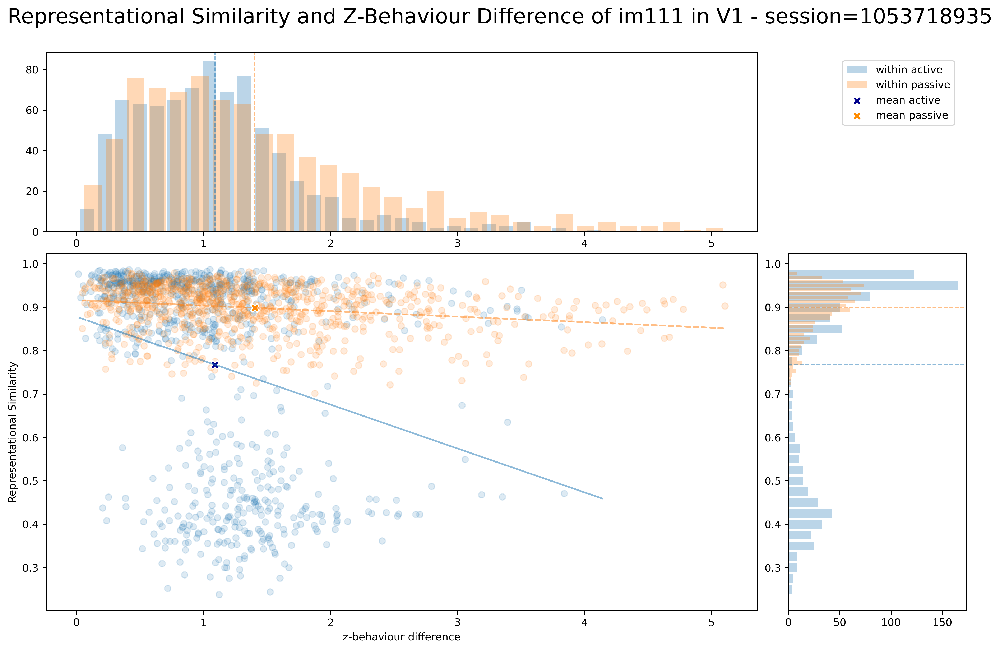

In [55]:
final_RS_behaviour_excl('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'V1', sessionID)


#  5. Representational Similarity vs. Time Difference
averaged over image chains for specified image

In [41]:
# specify image:
im = 'im111_r'

### 5.1 within blocks active/passive

plotting every 10-th datapoint


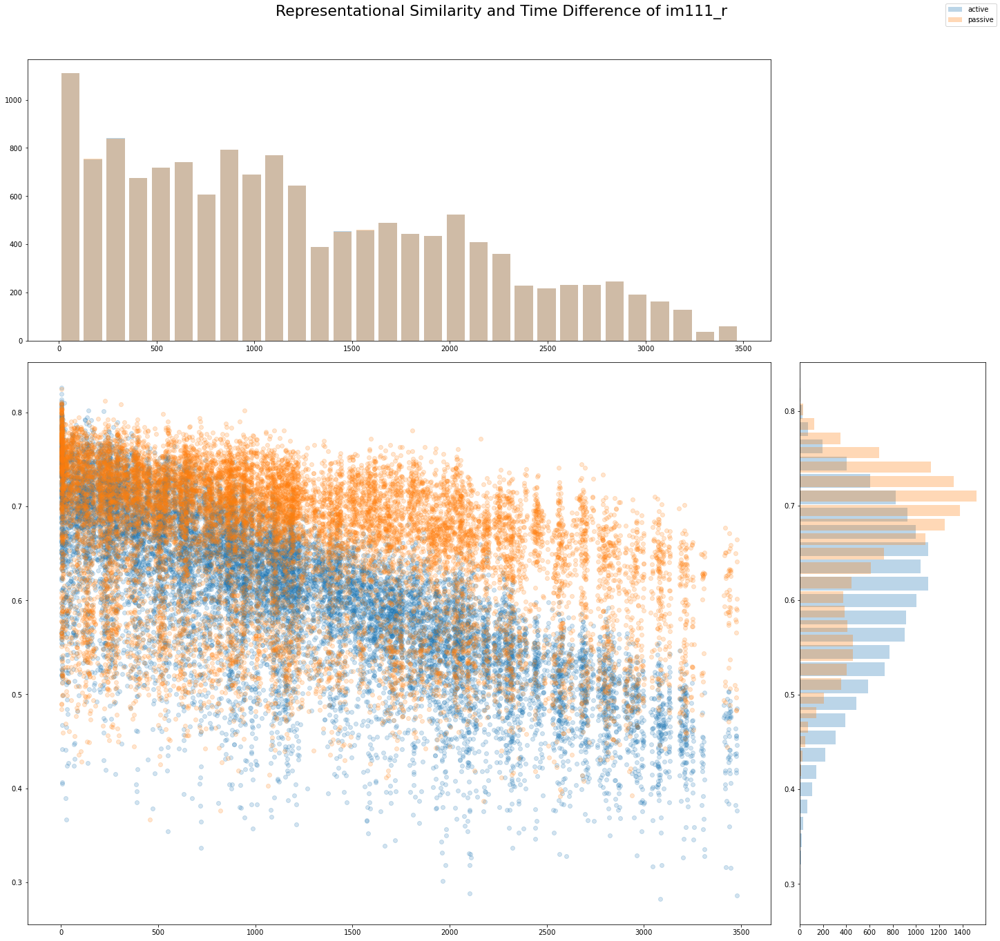

In [42]:
RS_vs_time_active_passive_within_blocks(im, M_all_good, stimulus_presentations)

plotting every 10-th datapoint


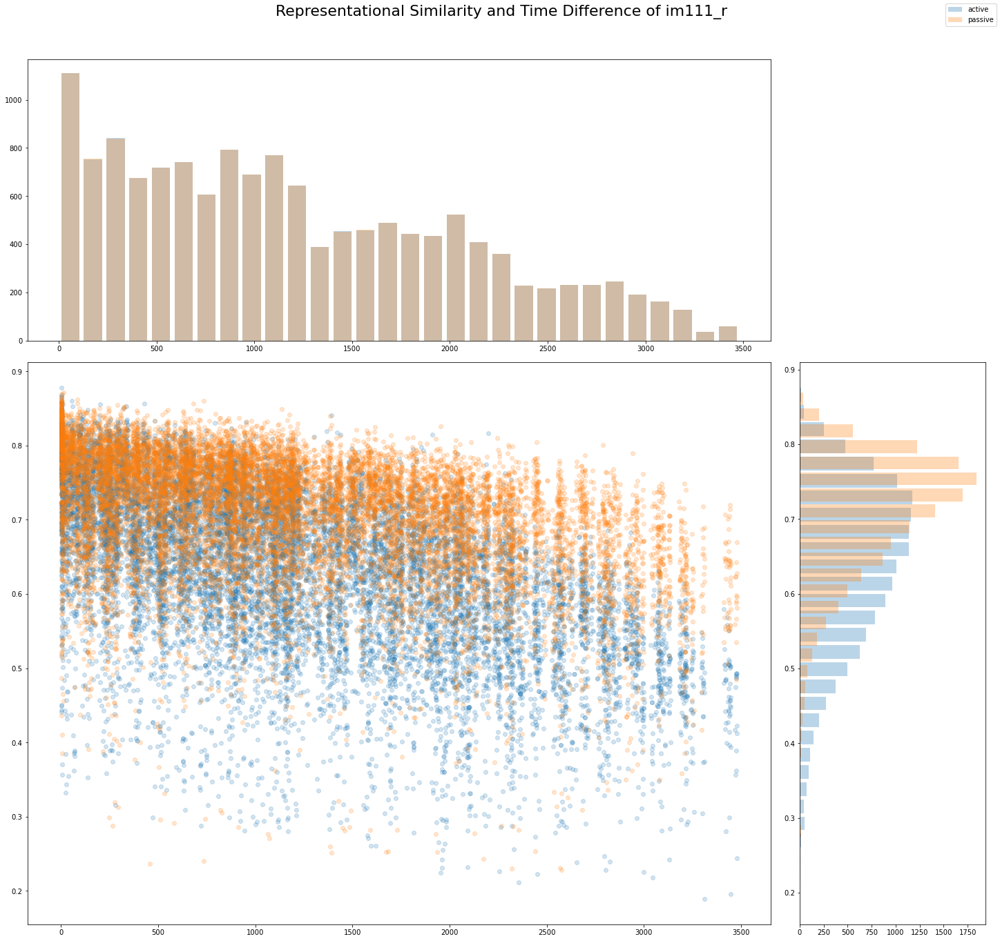

In [43]:
RS_vs_time_active_passive_within_blocks(im, M_good_VIS, stimulus_presentations)

In [ ]:
RS_vs_time_active_passive_within_blocks(im, M_good_VISp, stimulus_presentations)

In [ ]:
RS_vs_time_active_passive_within_blocks(im, M_good_VIS_excld_VISp, stimulus_presentations)

In [ ]:
RS_vs_time_active_passive_within_blocks(im, M_good_CA1, stimulus_presentations)

### 5.2 averaged over chains

im111_r


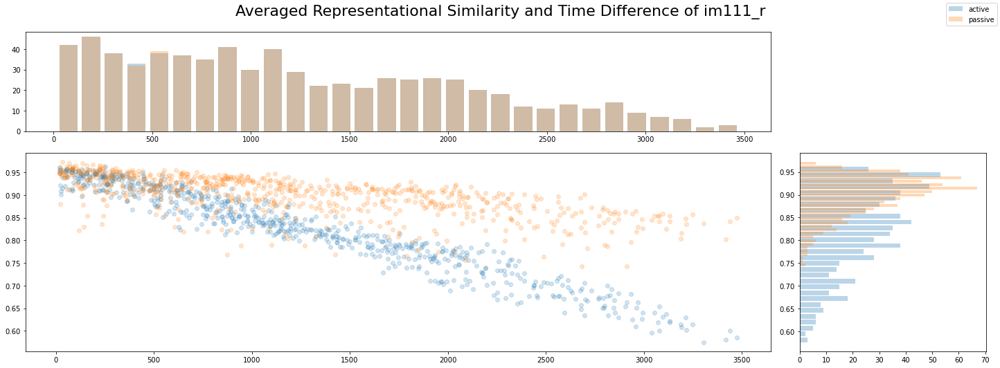

In [44]:
RS_vs_time_avg_active_passive(im, M_all_good, stimulus_presentations)

im111_r


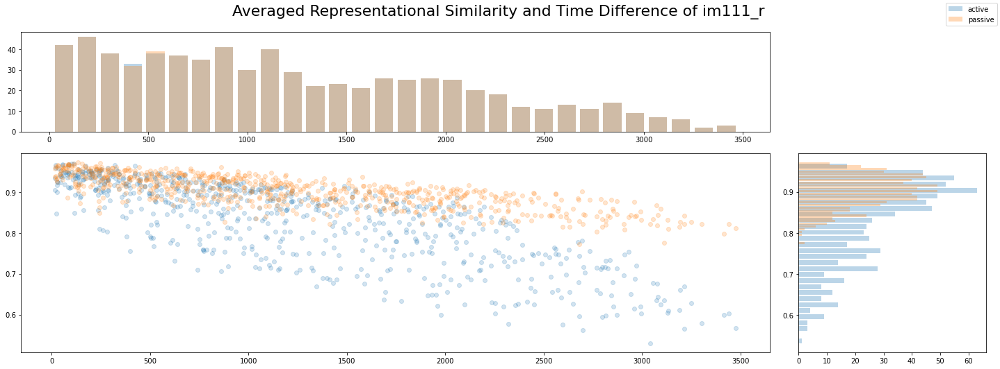

In [45]:
RS_vs_time_avg_active_passive(im, M_good_VIS, stimulus_presentations)

im111_r


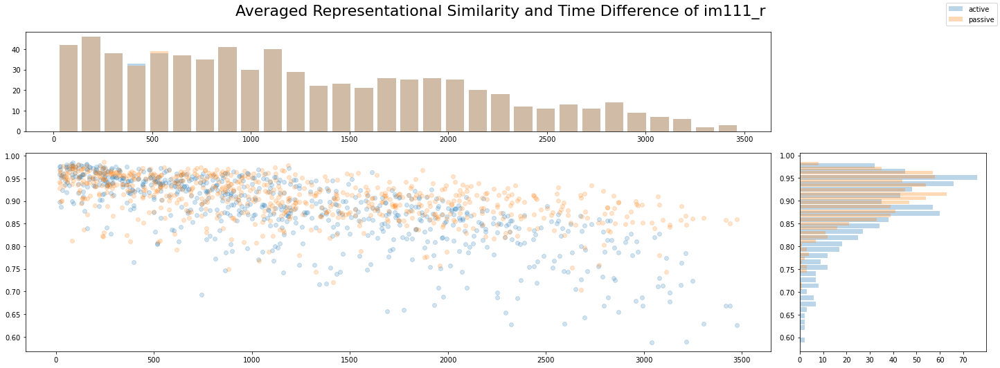

In [46]:
RS_vs_time_avg_active_passive(im, M_good_VISp, stimulus_presentations)

In [ ]:
RS_vs_time_avg_active_passive(im, M_good_VIS_excld_VISp, stimulus_presentations)

In [ ]:
RS_vs_time_avg_active_passive(im, M_good_CA1, stimulus_presentations)

### final average over chains

In [ ]:
def final_time_dif(image, M, stimulus_presentations):

    M_avg_im, M_avg_im_a, M_avg_im_passive, timings_im, timings_start_end_im = average_population_response_over_same_stimulus_presentations(M, image, stimulus_presentations)

    # get the Representational Similarity
    C_avg = np.corrcoef(np.transpose(M_avg_im))            # the Correlation Matrix with reduced stimuli
    C_avg_a = np.corrcoef(np.transpose(M_avg_im_a))
    C_avg_p = np.corrcoef(np.transpose(M_avg_im_passive))

    assert len(C_avg) == len(timings_im)
    assert len(C_avg_a) == len(timings_im)/2
    assert len(C_avg_p) == len(timings_im)/2

    n = len(C_avg)
    half = int(n/2)

    med_timings_a = timings_im[:half]
    med_timings_p = timings_im[half:]


    x_im_a = []
    y_im_a = []
    x_im_p = []
    y_im_p = []

    for pair in combinations(range(half), 2):
        i, j = pair

        # active
        x_im_a.append(np.abs(med_timings_a[i] - med_timings_a[j]))
        y_im_a.append(C_avg_a[i, j])
        # passive
        x_im_p.append(np.abs(med_timings_p[i] - med_timings_p[j]))
        y_im_p.append(C_avg_p[i, j])


    print(image)

    fig, axs = plt.subplots(2, 2, figsize=(20, 7), gridspec_kw={'width_ratios': [4, 1], 'height_ratios': [1,2]})
    fig.tight_layout()
    axs[0,1].set_visible(False)

    # active
    axs[1,0].scatter(x_im_a, y_im_a, alpha=0.2)
    axs[0,0].hist(x_im_a, bins=30, alpha=0.3, rwidth=0.8, label='active')
    axs[1,1].hist(y_im_a, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')

    # passive
    axs[1,0].scatter(x_im_p, y_im_p, alpha=0.2)
    axs[0,0].hist(x_im_p, bins=30, alpha=0.3, rwidth=0.8, label='passive')
    axs[1,1].hist(y_im_p, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')

    fig.legend()
    fig.suptitle(t='Averaged Representational Similarity and Time Difference of '+ image, fontsize=20, y=1.05)

#  6. Tuning Curves
mean spike counts of a unit for each image

### time dependent

In [71]:
curr_M = M_good_VISp
n_units = curr_M.shape[0]

print('_______ active ________')
all_tunings_a = get_all_tunings(curr_M, valid_images, stimulus_presentations, block=0)

print('_______ passive ________')
all_tunings_p = get_all_tunings(curr_M, valid_images, stimulus_presentations, block=5)

assert all_tunings_a.shape == all_tunings_p.shape

_______ active ________
get tuning for 
0 :  im036_r
slice 0  :  37
slice 37  :  83
slice 83  :  138
slice 138  :  183
slice 183  :  219
slice 219  :  278
slice 278  :  333
slice 333  :  365
slice 365  :  412
slice 412  :  515
slice 515  :  541
slice 541  :  619
++++++++++++++++++++++++++++++++
get tuning for 
1 :  im083_r
slice 12  :  0
oh oh
12 | should be < than | 0 
 we are setting mean_spike_cnt to 0
slice 0  :  59
slice 59  :  94
slice 94  :  129
slice 129  :  188
slice 188  :  233
slice 233  :  273
slice 273  :  308
slice 308  :  356
slice 356  :  397
slice 397  :  442
slice 442  :  504
slice 504  :  550
++++++++++++++++++++++++++++++++
get tuning for 
2 :  im111_r
slice 28  :  0
oh oh
28 | should be < than | 0 
 we are setting mean_spike_cnt to 0
slice 0  :  55
slice 55  :  99
slice 99  :  141
slice 141  :  183
slice 183  :  238
slice 238  :  273
slice 273  :  305
slice 305  :  375
slice 375  :  443
slice 443  :  453
slice 453  :  541
slice 541  :  563
+++++++++++++++++++++++++

#### mean activity over time for each unit (fixed image) -possibly unnecessary view?

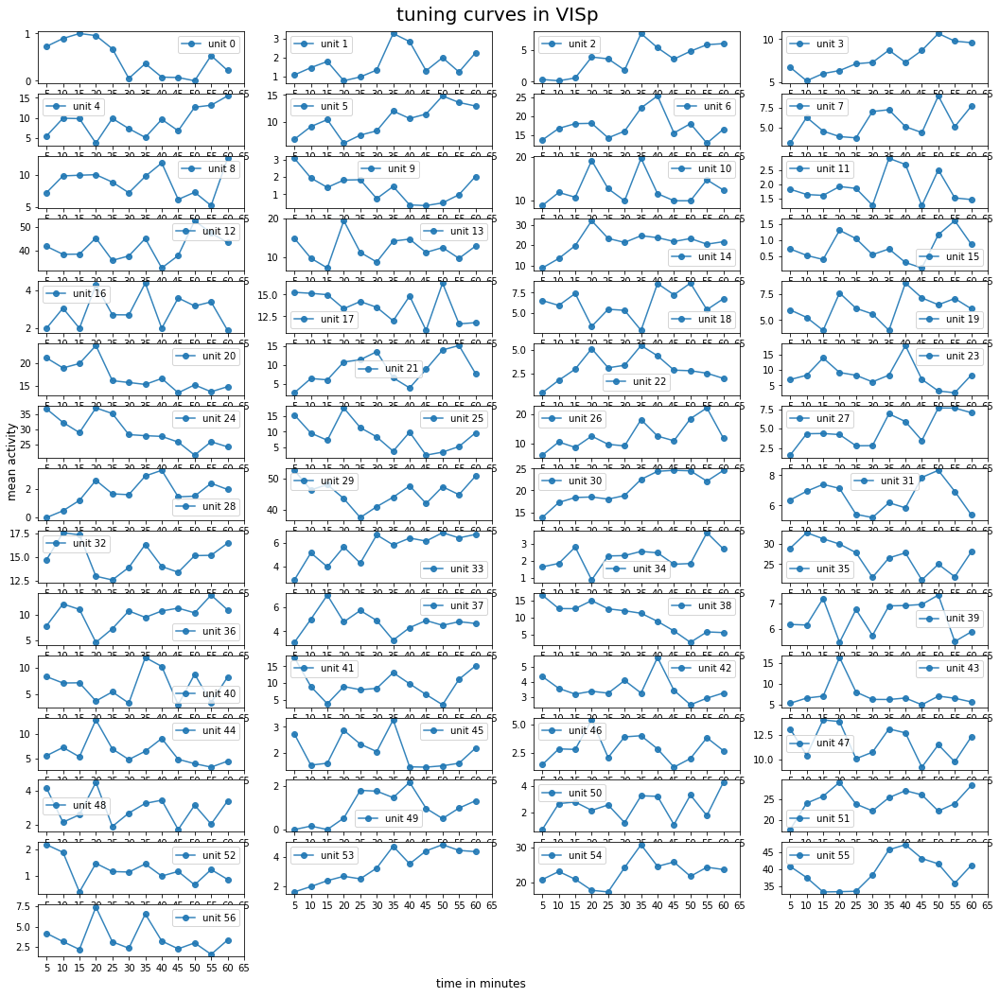

In [42]:
# mean activity over time for each unit (fixed image)
plot_tuning_curves_time_dependent(all_tunings_p[4,:,:], n_units) # this view with unequal y-axes can show normalized view


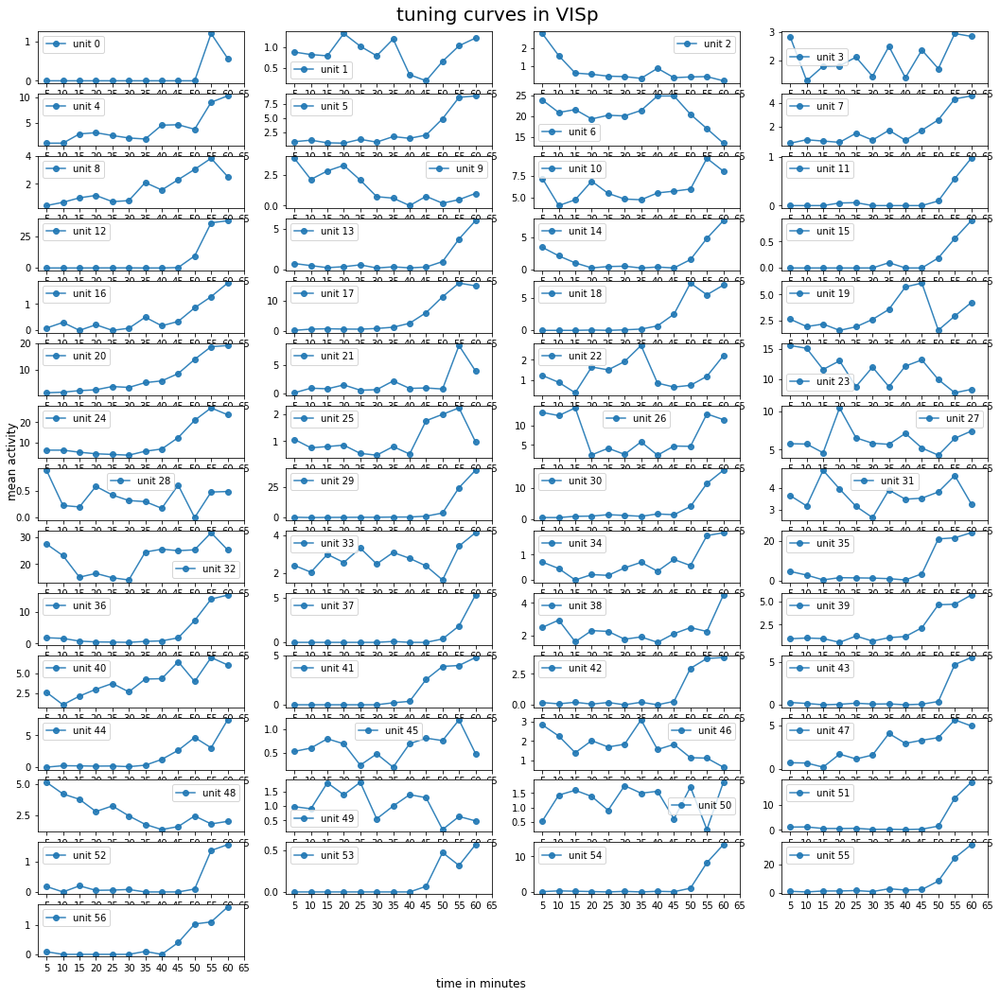

In [43]:
plot_tuning_curves_time_dependent(all_tunings_a[4,:,:], n_units) 

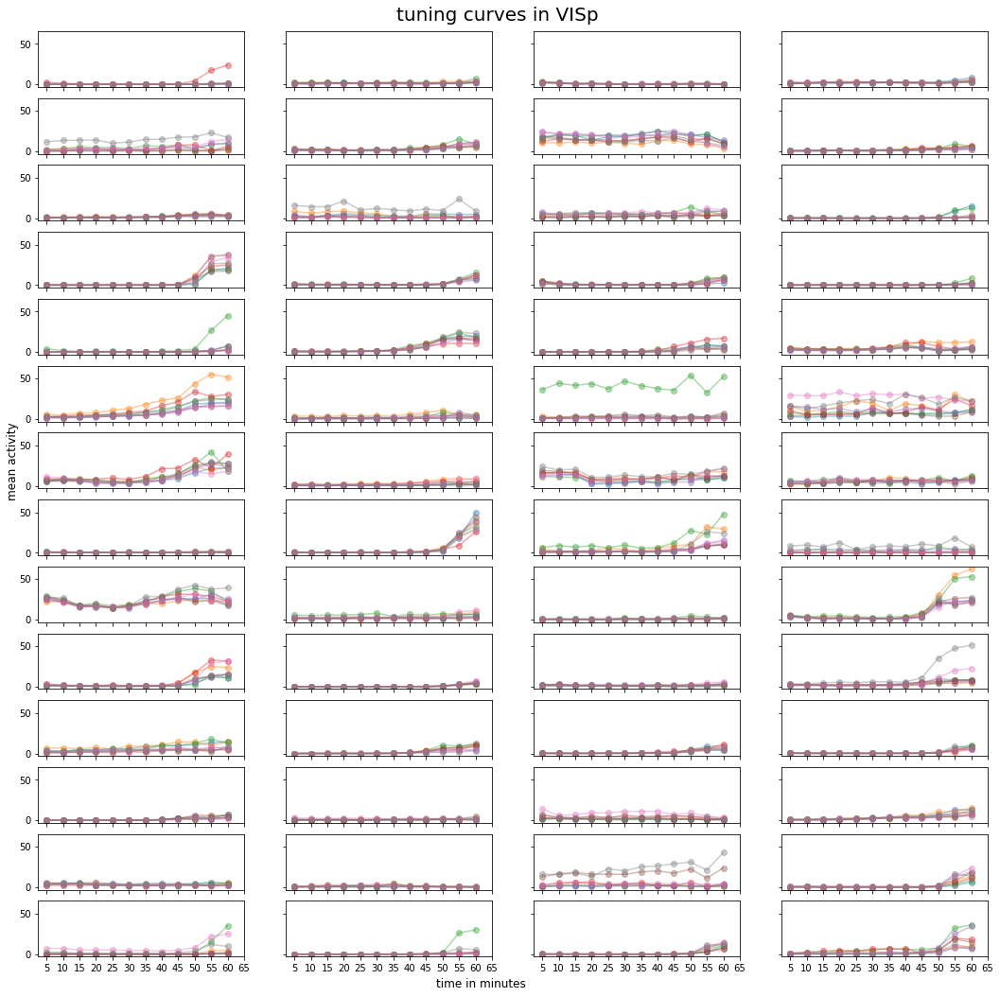

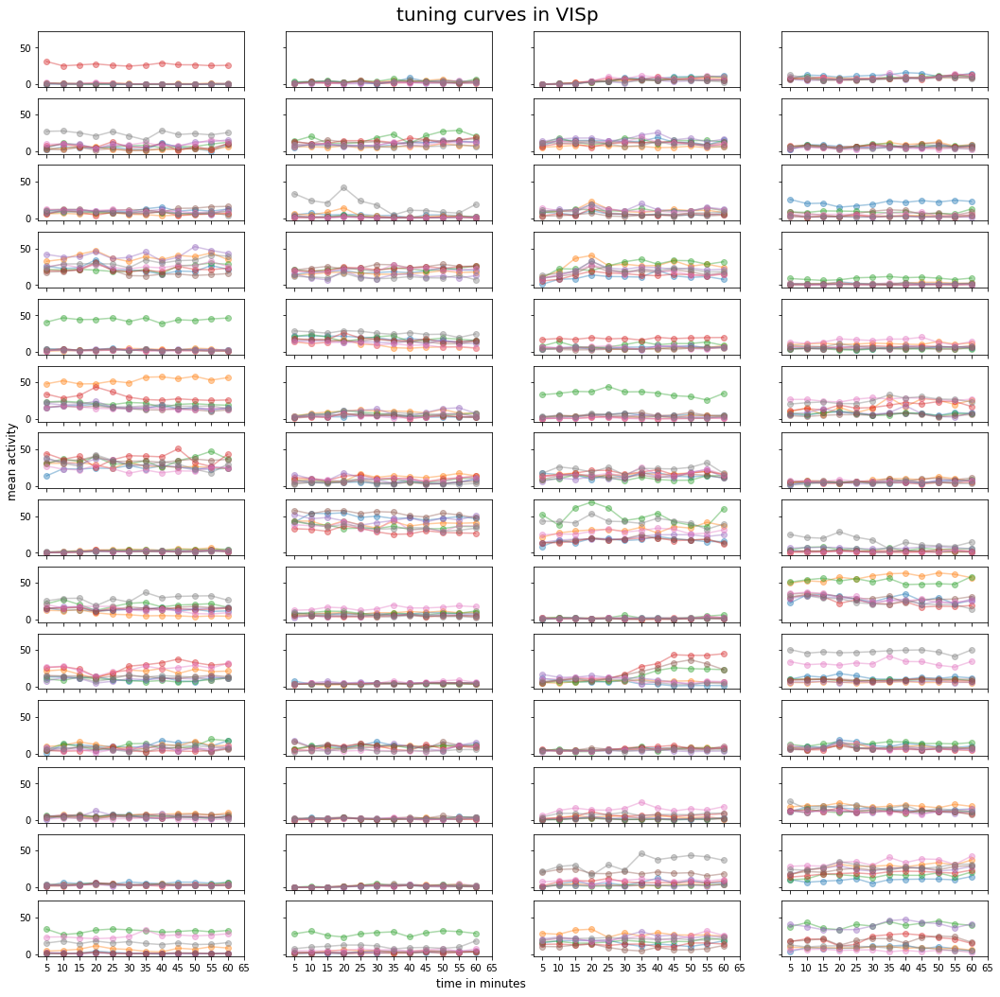

In [46]:
plot_tuning_curves_time_dependent_all_images_layered(all_tunings_a, n_units) # this view is not normalized, due to shared axes
plot_tuning_curves_time_dependent_all_images_layered(all_tunings_p, n_units)

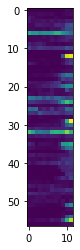

In [47]:
plt.imshow(all_tunings_a[4,:,:])
# this view is unnecessary

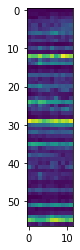

In [48]:
plt.imshow(all_tunings_p[4,:,:])

#### mean activity over bins and images for each unit or fixed unit

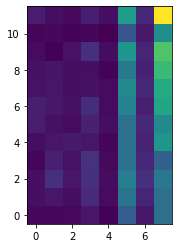

In [49]:
plt.imshow(np.transpose(all_tunings_a[:,50,:]),origin='lower')

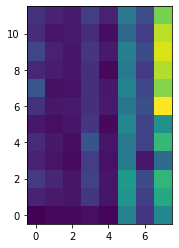

In [50]:
plt.imshow(np.transpose(all_tunings_p[:,50,:]), origin='lower')

In [52]:
all_tunings_a.shape

(8, 57, 12)

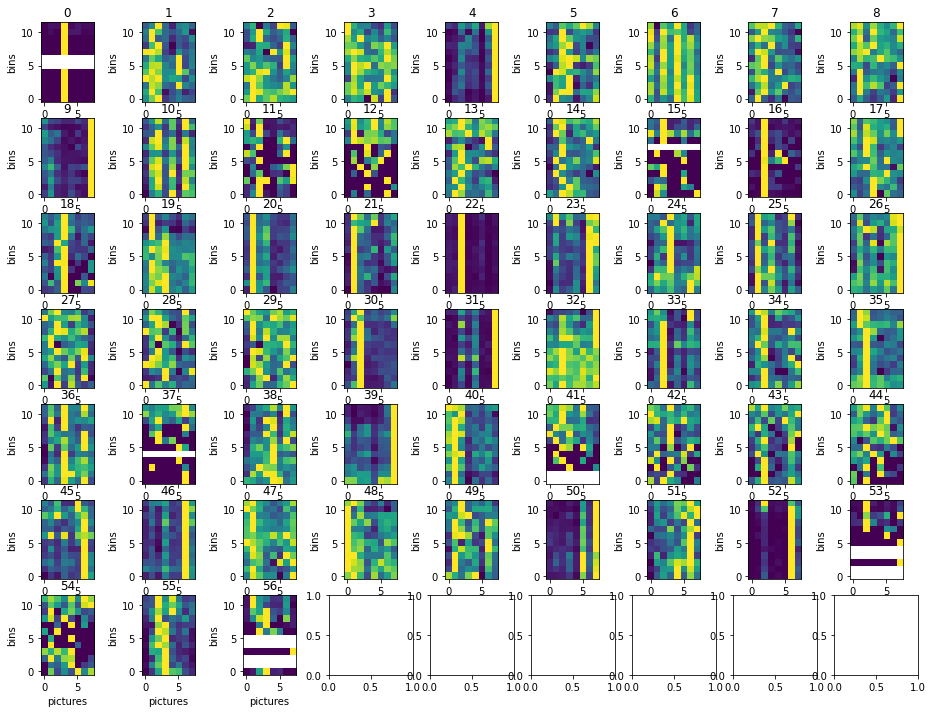

In [58]:
show_tunings_norm_each_unit(all_tunings_a, 9)

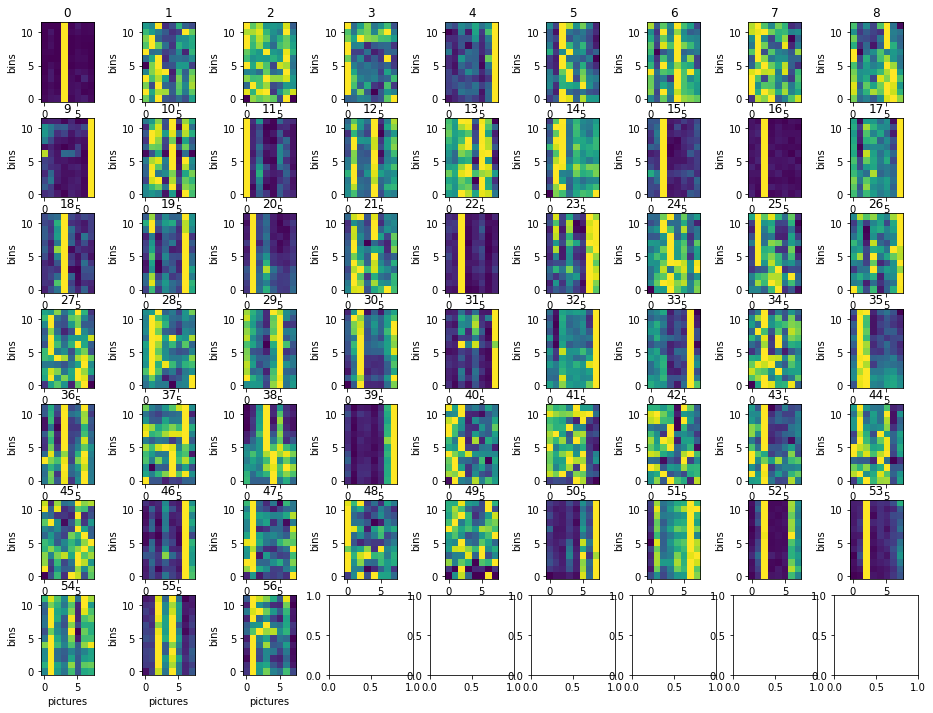

In [59]:
show_tunings_norm_each_unit(all_tunings_p, 9)

#### mean activity over units and images for each bin or fixed bin

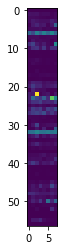

In [60]:
plt.imshow(np.transpose(all_tunings_a[:,:,3]))

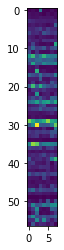

In [61]:
plt.imshow(np.transpose(all_tunings_p[:,:,3]))

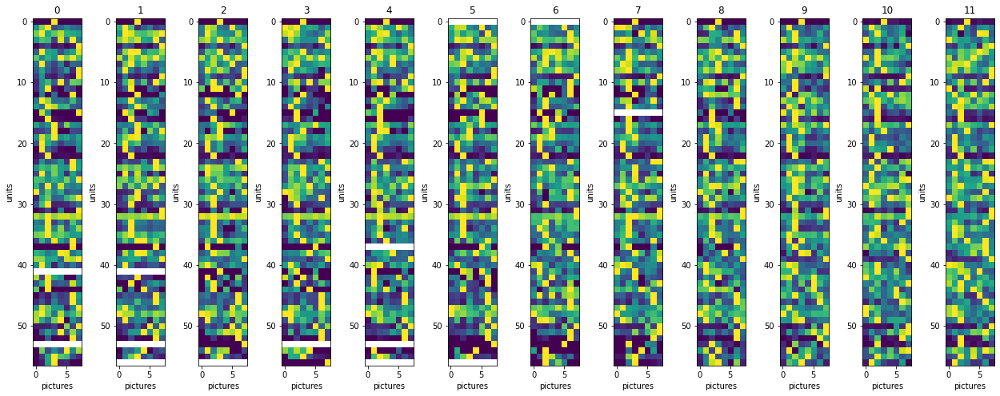

In [62]:
show_tunings_norm_each_bin(all_tunings_a)

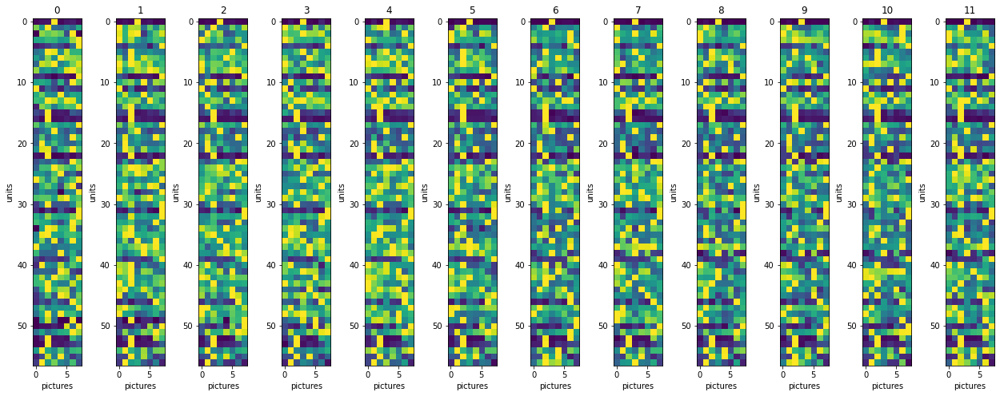

In [63]:
show_tunings_norm_each_bin(all_tunings_p)

# task-related variables

### task vs. no-task stability

In [56]:
def final_task_no_task_plot(image_name, M, stimulus_presentations, brain_structure, sessionID):
    """
    plots Representational Similarity, Running Speed and Pupil Area over time for one fixed image
    """

    # extract the full unit activity for certain image
    # complete, b0, b5 = get_unit_activity_vectors_for_image(image_name, M, stimulus_presentations)

    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M,
                                                                                                                                    image_name,                                                                                                                         stimulus_presentations)
    # visualization of process:
    # check_reduction_over_stimuli(M_reduced, M_rd_active, M_rd_passive)

    # get the Representational Similarity
    C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
    C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
    C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

    half = len(C_rd_active)

    across_blocks = C_reduced[half:, :half]                    # lower middle correlation matrix
    across_blocks2 = C_reduced[:half, half:]                   # passive block? - lower right corr matrix


    # plt.figure(figsize=(16, 12), dpi=80)
    
    # show only representational similarity over time:
    fig, ax = plt.subplots(1, figsize=(8, 6), dpi=dp)
    
    ax.grid(axis='both', color='0.95')
    ax.plot(timings[:half], C_rd_active[0,:], label='within active block')
    ax.plot(timings[:half], C_rd_passive[0,:], label='within passive block')
    ax.set_ylabel('Representational Similarity')
    ax.set_xlabel('time in seconds   -   block (1h)')
    ax.legend()
    
    fig.suptitle(t=f'Representational Similarity over Time by Blocks \n of {image_name[:-2]} in {brain_structure} - session={sessionID}', fontsize=20)
    
    fig.savefig(f'plots/RS_block_contrast_in_{brain_structure}.png')
    

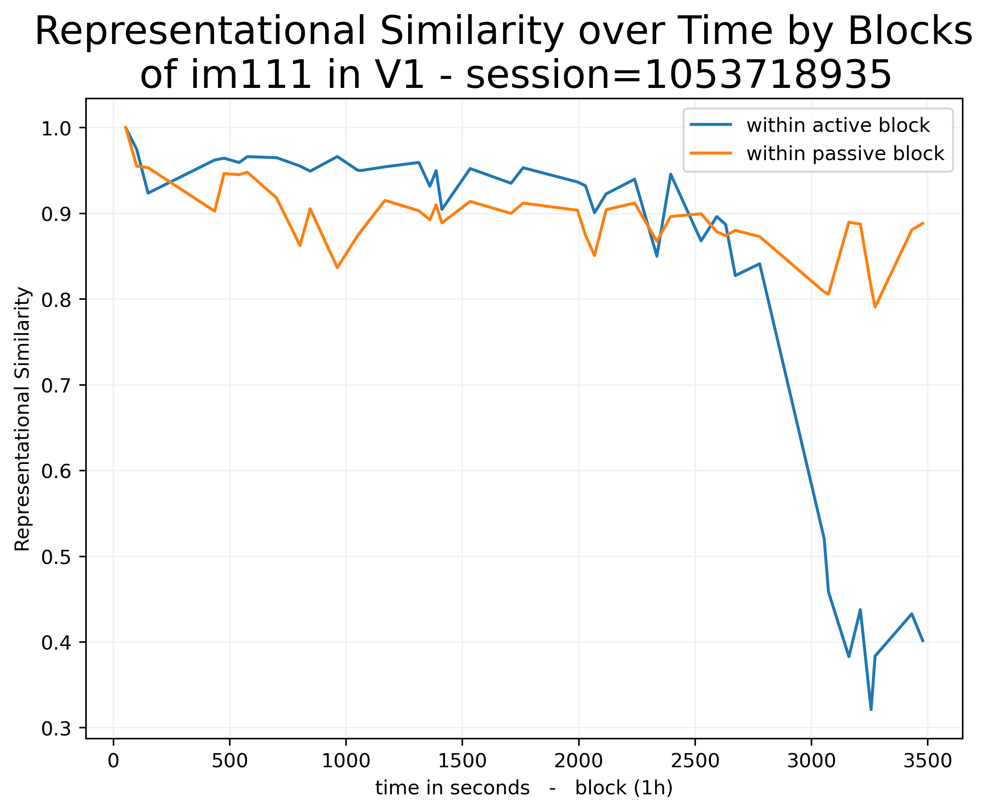

In [57]:
final_task_no_task_plot('im111_r', M_good_VISp, stimulus_presentations, 'V1', sessionID)

### mouse engagement

In [58]:
def plot_RS_engagement(timings, C_rd_active, C_rd_passive, across_blocks2,  hit_change_times,
                       miss_change_times, z_t_a, z_t_p, half, vol_x, vol_y, licks, reward_rate, trial_times):

    fig, axs = plt.subplots(4, figsize=(16,12), gridspec_kw={'height_ratios': [1,5,1,0.5]}, sharex='col', dpi=dp)
    fig.tight_layout()

    x = timings

    # plot representational similarity

    axs[1].plot(x[:half], C_rd_active[0,:], label='active block')           #[0, :] takes first row of matrix
    axs[1].plot(x[:half], C_rd_passive[0,:], label='passive block', alpha=0.25)
    # reward volume:
    axs[1].plot(vol_x, vol_y, label='reward volume', color='darkblue', alpha=0.1, marker='.')
    # hit trials
    axs[1].vlines(hit_change_times, 0.05, 0.1, linestyles="solid", colors="limegreen", label='hit times')
    # ax.vlines(miss_change_times, 0.00, 0.05, linestyles="solid", colors="red", label='miss trials')
    n_licks = len(licks)
    y_licks = n_licks * [0.15]
    axs[1].scatter(licks, y_licks, alpha=0.5, label='lick times', marker='d', c='hotpink')
    axs[1].axhline(0.5, linestyle='--', color='blue', alpha=0.3, label='0.5 ml saturation')

    axs[1].grid(axis='both', color='0.95')
    axs[1].set_ylabel('Representational Similarity and reward volume (ml)')
    axs[1].set_xlabel('time in seconds')
    axs[1].legend(loc='upper right')
    
    axs[0].hist(licks, bins=180, alpha=0.5, rwidth=0.8, label='licks', color='hotpink')
    axs[0].set_ylabel('count')
    axs[0].legend()
    
    # Normalize the y-values to range between 0 and 1
    norm = mcolors.Normalize(vmin=reward_rate.min(), vmax=reward_rate.max())

    # Create a colormap (here we're using the 'viridis' colormap)
    cmap = plt.get_cmap('coolwarm') # 'viridis')

    # Compute the colors for each bar
    bar_colors = cmap(norm(reward_rate))

    axs[2].bar(trial_times, reward_rate, width=3.1, alpha=0.9, color=bar_colors)
    axs[2].axhline(2, linestyle='--', color='red', alpha=0.9, label='proposed threshold')
    axs[2].set_ylabel('engagement rate')
    axs[2].legend()
    
    axs[3].set_visible(False)

    # Add colorbar to the plot
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    plt.colorbar(sm, label='engagement rate', orientation='horizontal')

    for ax in axs.flat:
        ax.tick_params(labelbottom=True, labelleft=True)


    return fig

In [59]:
def final_mouse_engagement(image_name, M, stimulus_presentations, running_speed, eye_tracking, change_trials,
                           reward_rate, rewards, licks, trial_times):
    """
    plots Representational Similarity, performance, rewards, lick times over time for one fixed image
    """

    # extract the full unit activity for certain image
    # complete, b0, b5 = get_unit_activity_vectors_for_image(image_name, M, stimulus_presentations)

    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M,
                                                                                                                                    image_name,
                                                                                                                                    stimulus_presentations)


    # get the Representational Similarity
    C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
    C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
    C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

    half = len(C_rd_active)

    across_blocks = C_reduced[half:, :half]                    # lower middle correlation matrix
    across_blocks2 = C_reduced[:half, half:]                   # passive block? - lower right corr matrix


    # trials - overall: not specific to image
    # get the hit trials
    hit_trials = change_trials[change_trials.hit == True]
    hit_change_times = hit_trials['change_time_no_display_delay'].to_numpy()
    # get the miss trials
    miss_trials = change_trials[change_trials.miss == True]
    miss_change_times = miss_trials['change_time_no_display_delay'].to_numpy()

    sp = stimulus_presentations[stimulus_presentations.image_name == image_name]
    avg_running_speed, std_running_speed, avg_pupil_area, std_pupil_area = extract_speed_and_pupil_data(sp, timings_start_end, running_speed, eye_tracking)
    z_t_a, z_t_p = z_score_behaviour(avg_running_speed, avg_pupil_area, half)
    # plot_single_behaviour(avg_running_speed, std_running_speed, half, 'running speed')
    # plot_single_behaviour(avg_pupil_area, std_pupil_area, half, 'pupil area')

    vol_y = rewards.volume.cumsum()
    vol_x = rewards.timestamps

    # final plot for image:
    fig = plot_RS_engagement(timings, C_rd_active, C_rd_passive, across_blocks2,
                                                       hit_change_times, miss_change_times, z_t_a, z_t_p, half,
                                                       vol_x, vol_y, licks, reward_rate, trial_times)

    fig.suptitle(t=f'Single session{sessionID}: Representational Similarity and task-engagement in V1 for '+ image_name[:-2], fontsize=20, y=1.01)
    fig.savefig(f'plots/engagement.png', bbox_inches='tight')

In [60]:
licks = session.licks.timestamps
reward_rate = session.get_reward_rate()
reward_rate = reward_rate[10:]
len(reward_rate)

449

In [61]:
trials.trial_length.min()

0.31655000000000655

In [62]:
len(trials), len(session.get_reward_rate())

(459, 459)

In [63]:
trial_time_meds = np.median(trials[['start_time', 'stop_time']].to_numpy(), axis=1)
len(trial_time_meds)

459

<BarContainer object of 459 artists>

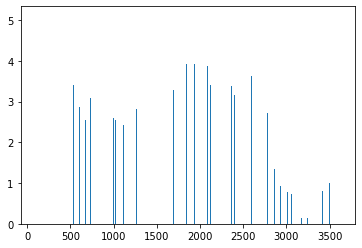

In [64]:
plt.bar(trial_time_meds, session.get_reward_rate())

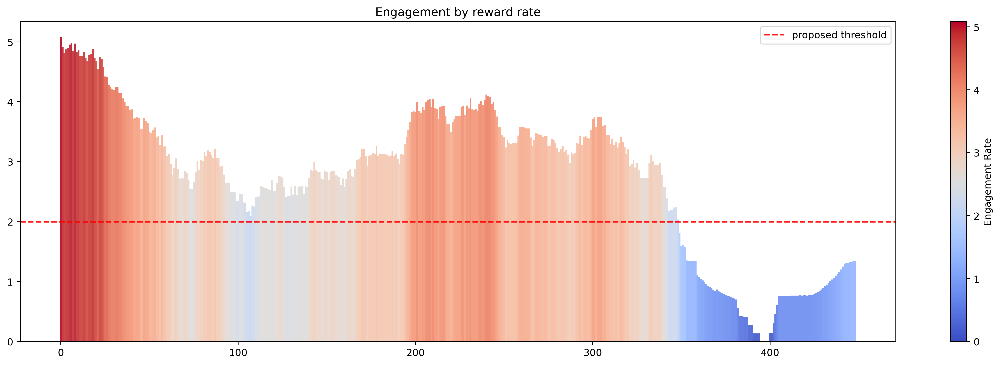

In [65]:
import matplotlib.colors as mcolors

fig, ax = plt.subplots(1, figsize=(20,6), dpi=dp)
plt.title("Engagement by reward rate")

# Normalize the y-values to range between 0 and 1
norm = mcolors.Normalize(vmin=reward_rate.min(), vmax=reward_rate.max())

# Create a colormap (here we're using the 'viridis' colormap)
cmap = plt.get_cmap('coolwarm') # 'viridis')

# Compute the colors for each bar
bar_colors = cmap(norm(reward_rate))

ax.bar(range(len(reward_rate)), reward_rate, width=1, alpha=0.9, color=bar_colors)
ax.axhline(2, linestyle='--', color='red', alpha=0.9, label='proposed threshold')
ax.legend()

# Add colorbar to the plot
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.colorbar(sm, label='Engagement Rate')

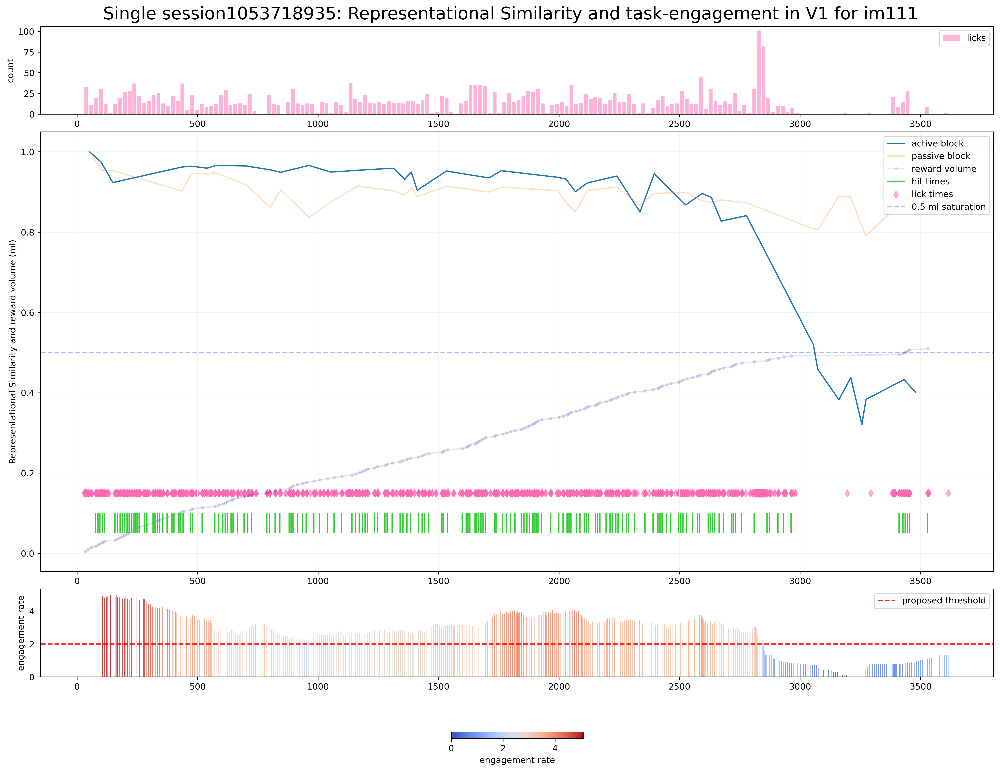

In [66]:
final_mouse_engagement('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials, reward_rate, rewards, licks, trial_time_meds[10:])


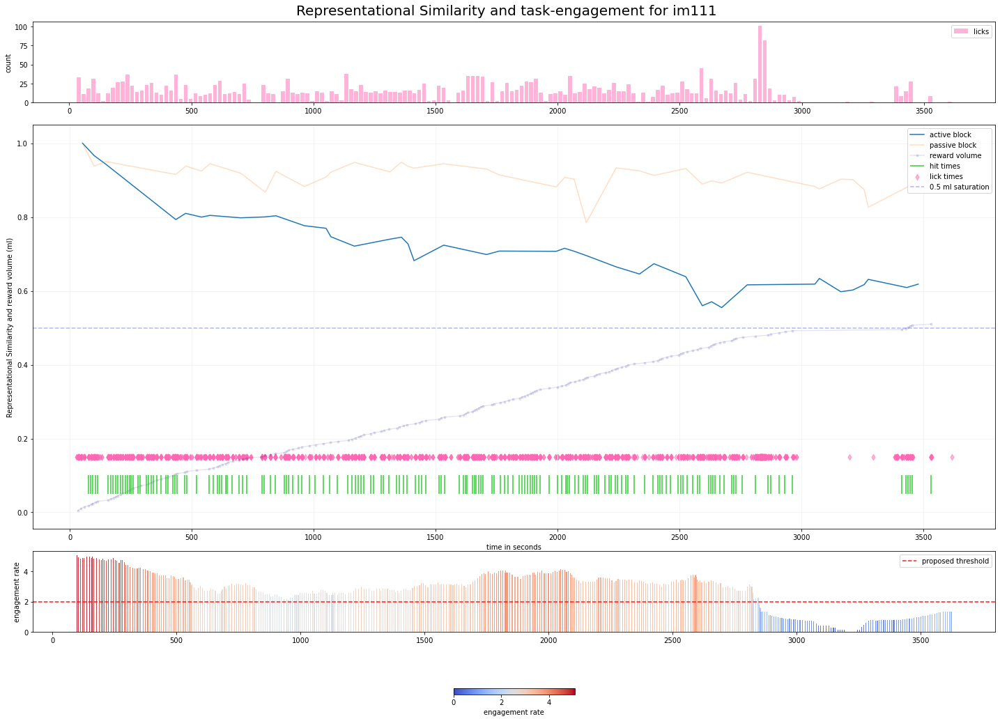

In [385]:
final_mouse_engagement('im111_r', M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials, reward_rate, rewards, licks, trial_time_meds[10:])


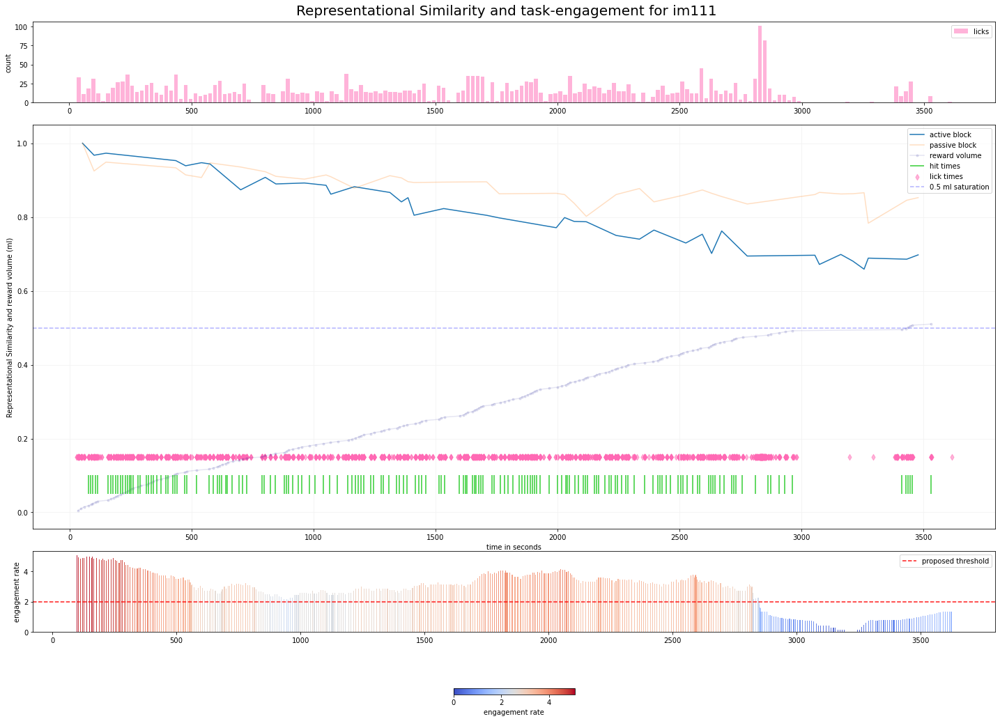

In [384]:
final_mouse_engagement('im111_r', M_good_CA1, stimulus_presentations, running_speed, eye_tracking, change_trials, reward_rate, rewards, licks, trial_time_meds[10:])


#### trying delta engagement

In [769]:
def final_RS_engagement(image, M, stimulus_presentations, trial_times, engagement_rate, brain_structure, sessionID):

    M_avg_im, M_avg_im_a, M_avg_im_passive, timings_im, timings_start_end_im = average_population_response_over_same_stimulus_presentations(M, image, stimulus_presentations)

    # get the Representational Similarity
    C_avg_a = np.corrcoef(np.transpose(M_avg_im_a))
    
    n = len(C_avg_a)
    print(n)
    print(len(engagement_rate))
    print(len(trial_times))
    print(len(timings_im[:n]))
    
    print(trial_times)
    print(timings_im[:n])

    # sp = stimulus_presentations[stimulus_presentations.image_name == image]
    # avg_running_speed, std_running_speed, avg_pupil_area, std_pupil_area = extract_speed_and_pupil_data(sp, timings_start_end_im, running_speed, eye_tracking)
    avg_eng_rate = average_engagement_rate(stimulus_presentations, engagement_rate, trial_times, np.array(timings_start_end_im[:n]))
    avg_eng_rate = average_engagement_rate2(stimulus_presentations, engagement_rate, trial_times, np.array(timings_im[:n]))
    

    print(len(avg_eng_rate))
    print(avg_eng_rate)

    #z_t_a, z_t_p = z_score_behaviour(avg_running_speed, avg_pupil_area, half)

    x_im_a = []
    y_im_a = []

    for pair in combinations(range(n), 2):
        i, j = pair

        delta_E_a = np.abs(avg_eng_rate[i] - avg_eng_rate[j])

        # active
        x_im_a.append(delta_E_a)
        y_im_a.append(C_avg_a[i, j])
        
    
    # Fit with polyfit
    # b_a, m_a = polyfit(x_im_a, y_im_a, deg=1)
    
    fig, axs = plt.subplots(2, 2, figsize=(18, 7), gridspec_kw={'width_ratios': [4, 1], 'height_ratios': [1,2]})
    fig.tight_layout()
    
    # active
    axs[1,0].scatter(x_im_a, y_im_a, alpha=0.2)
    # axs[1,0].legend()
    # hist.,data, 30 bins, 0.5 opacity, label,       for normalized values??       5/4 of binWidth
    axs[0,0].hist(x_im_a, bins=30, alpha=0.3, rwidth=0.8, label='active')
    #plt.title(f"Projection to delta V histogramm plot", fontsize=20)
    axs[0,1].set_visible(False)
    # hist.,data, 30 bins, 0.5 opacity, label,       for normalized values??       5/4 of binWidth
    axs[1,1].hist(y_im_a, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    #plt.title(f"Projection to RS histogramm plot", fontsize=20)
    
    # regression:
    # axs[1,0].plot(x_im_a, y_im_a, '.')
    # axs[1,0].plot(x_im_a, b_a + np.multiply(m_a,x_im_a) , '--', alpha=0.5)
    
    axs[1,0].set_xlabel("engagement difference")
    axs[1,0].set_ylabel('Representational Similarity')
    
    fig.legend()
    fig.suptitle(t=f'Averaged Representational Similarity and Engagement Difference of {image[:-2]} in {brain_structure}, session={sessionID}', fontsize=20, y=1.05)
    # plt.savefig(f'plots/RS_vs_delta_engagement_in_{brain_structure}_session_{sessionID}.png')
    

41
449
449
41
[  99.670165  105.383125  114.01523   121.02947   127.760275  138.03532
  148.91933   157.55184   162.005495  167.309965  177.44328   187.952015
  196.95952   202.19715   207.86076   216.109005  225.8755    236.000645
  244.657935  252.53105   260.04571   269.045045  275.24999   280.70482
  289.336835  296.417685  303.59899   313.7407    323.482065  332.88151
  342.24774   348.49474   355.39231   365.150275  374.15783   384.291225
  394.424945  401.93094   407.810945  414.31637   422.58996   430.84691
  439.479065  447.73609   455.25079   460.780335  469.14588   479.65439
  487.91143   493.415815  498.795685  507.803045  518.31172   527.694615
  535.951465  544.58383   550.62215   552.465325  554.50876   556.877405
  558.4371    563.34955   571.6064    579.86337   587.75323   596.752375
  605.39291   614.008545  623.408235  631.648225  639.53829   647.419755
  656.802635  666.560835  674.442365  679.68846   684.95119   693.216505
  701.48176   708.987935  714.60115   722.

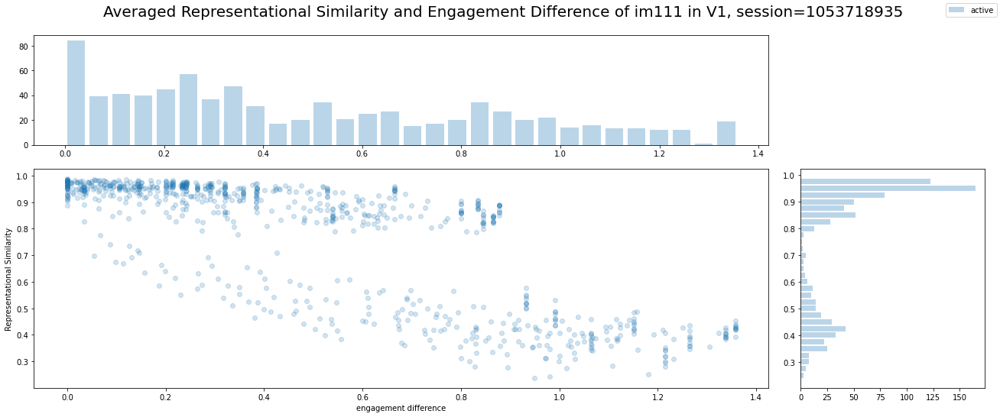

In [770]:
final_RS_engagement('im111_r', M_good_VISp, stimulus_presentations, trial_time_meds[10:], reward_rate, 'V1', sessionID)


In [746]:
def average_engagement_rate(stimulus_presentations, eng_rate, trial_times, custom_timings=None):

    startTimes = stimulus_presentations['start_time'].to_numpy()
    endTimes = stimulus_presentations['stop_time'].to_numpy()
    if custom_timings is not None:
        startTimes = custom_timings[:, 0]
        endTimes = custom_timings[:, 1]

    mean_eng_rate = []

    for i, start in enumerate(startTimes):
        startInd = np.searchsorted(trial_times, start)
        endInd = np.searchsorted(trial_times, endTimes[i])

        mean_eng_rate.append(np.mean(eng_rate[startInd:endInd]))

    # assert len(mean_running_speeds) == len(stimulus_presentations)
    return mean_eng_rate

In [768]:
def average_engagement_rate2(stimulus_presentations, eng_rate, trial_times, custom_timings):

    new_timestamps = np.linspace(0, len(trial_times)-1, len(custom_timings))

    # Define interpolation function
    interpolated_array = np.interp(new_timestamps, trial_times, eng_rate)

    # assert len(mean_running_speeds) == len(stimulus_presentations)
    return interpolated_array

### mouse attention

In [497]:
10 * [0]

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [545]:
session.get_reward_rate()
eye_tracking_noblinks = eye_tracking[~eye_tracking['likely_blink']]
eye_track = eye_tracking_noblinks[['timestamps', 'pupil_center_x', 'pupil_center_y'] ]
eye_track_act = eye_track[eye_track['timestamps'] <= 3601.0] # how long exactly??
eye_track_act

,timestamps,pupil_center_x,pupil_center_y
frame,,,
16,1.65176,315.331616,247.563679
17,1.66843,315.616852,247.836699
18,1.68508,315.857805,247.748486
19,1.70175,315.561537,248.060906
20,1.71842,316.027373,248.333818
...,...,...,...
215957,3600.92369,302.301467,245.160991
215958,3600.94034,303.421947,244.921613
215959,3600.95702,303.190896,244.560199


In [556]:
center_x = eye_track_act.pupil_center_x.to_numpy()
center_y = eye_track_act.pupil_center_y.to_numpy()
eye_timestamps = eye_track_act.timestamps.to_numpy()

len(center_x), len(eye_timestamps)

(214495, 214495)

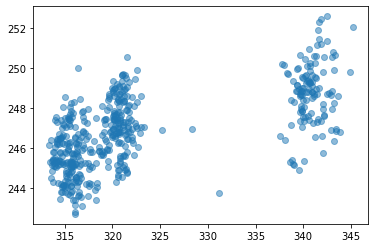

In [557]:
plt.scatter(center_x[:500], center_y[:500], alpha=0.5)

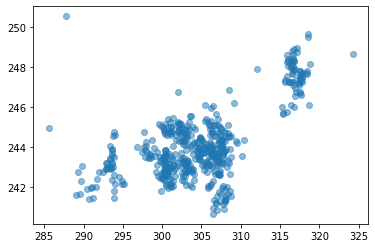

In [558]:
plt.scatter(center_x[-500:], center_y[-500:], alpha=0.5)

In [552]:
center_dist = np.abs(center_x - center_y)
len(center_dist)

214495

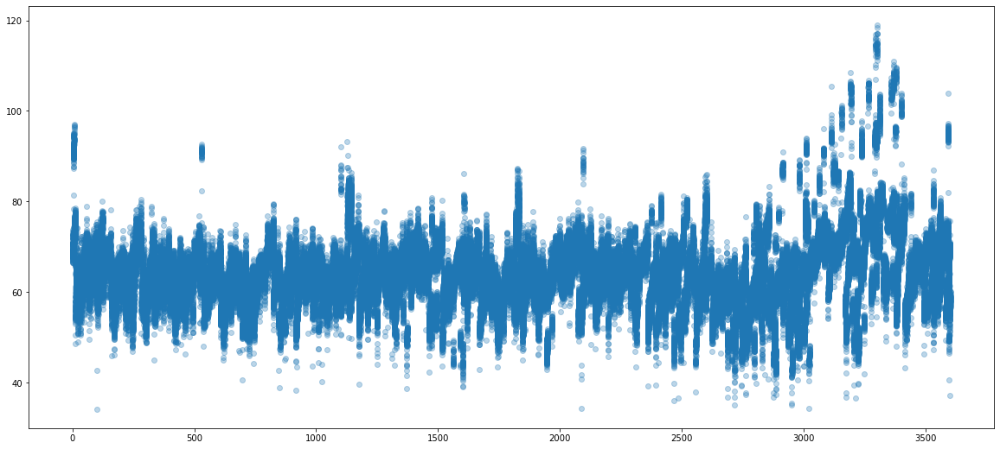

In [562]:
plt.subplots(1, figsize=(20,9))
plt.scatter(eye_timestamps, center_dist, alpha=0.3)

In [573]:
def eye_center_distances(sp, timings_start_end, eye_tracking):

    # sp = stimulus_presentations[stimulus_presentations.image_name == 'im111_r']
    timings_start_end = np.array(timings_start_end)

    # pupil area:
    eye_tracking_noblinks = eye_tracking[~eye_tracking['likely_blink']]
    eye_track = eye_tracking_noblinks[['timestamps', 'pupil_center_x', 'pupil_center_y'] ]

    startTimes = stimulus_presentations['start_time'].to_numpy()
    endTimes = stimulus_presentations['stop_time'].to_numpy()

    center_x = eye_track.pupil_center_x.to_numpy()
    center_y = eye_track.pupil_center_y.to_numpy()
    eye_timestamps = eye_track.timestamps.to_numpy()

    center_dist = np.abs(center_x - center_y)

        
    mean_center_dist = []
    std_center_dist = []

    for i, start in enumerate(startTimes):
        startInd = np.searchsorted(eye_timestamps, start)
        endInd = np.searchsorted(eye_timestamps, endTimes[i])

        mean_center_dist.append(np.mean(center_dist[startInd:endInd]))
        std_center_dist.append(np.std(center_dist[startInd:endInd]))

    return mean_center_dist, std_center_dist

In [574]:
def specific_image_behaviour(image_name, M, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards):
    """
    plots Representational Similarity, Running Speed and Pupil Area over time for one fixed image
    """

    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M,
                                                                                                                                    image_name,
                                                                                                                                    stimulus_presentations)

    # get the Representational Similarity
    C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
    C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
    C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

    half = len(C_rd_active)

    across_blocks = C_reduced[half:, :half]                    # lower middle correlation matrix
    across_blocks2 = C_reduced[:half, half:]                   # passive block? - lower right corr matrix


    # trials - overall: not specific to image
    # get the hit trials
    hit_trials = change_trials[change_trials.hit == True]
    hit_change_times = hit_trials['change_time_no_display_delay'].to_numpy()
    # get the miss trials
    miss_trials = change_trials[change_trials.miss == True]
    miss_change_times = miss_trials['change_time_no_display_delay'].to_numpy()

    sp = stimulus_presentations[stimulus_presentations.image_name == image_name]
    avg_running_speed, std_running_speed, avg_pupil_area, std_pupil_area = extract_speed_and_pupil_data(sp, timings_start_end, running_speed, eye_tracking)
    avg_center_dist, std_center_dist = eye_center_distances(sp, timings_start_end, eye_tracking)
    
    vol_y = rewards.volume.cumsum()
    vol_x = rewards.timestamps

    # final plot for image:
    fig = plot_active_vs_passive_RS_running_speed_and_pupil_area_over_time_plus(timings,
                                                                                C_rd_active,
                                                                                C_rd_passive,
                                                                                across_blocks2,
                                                                                hit_change_times,
                                                                                miss_change_times,
                                                                                avg_running_speed,
                                                                                std_running_speed,
                                                                                avg_pupil_area,
                                                                                std_pupil_area,
                                                                                half,
                                                                                avg_center_dist,
                                                                                std_center_dist,
                                                                                vol_x,
                                                                                vol_y)

    fig.suptitle(t='Representational Similarity and Behaviour over Time of '+ image_name, fontsize=22, y=1.01)

In [579]:
def plot_active_vs_passive_RS_running_speed_and_pupil_area_over_time_plus(timings,
                                                                          C_rd_active,
                                                                          C_rd_passive,
                                                                          across_blocks2,
                                                                          hit_change_times,
                                                                          miss_change_times,
                                                                          avg_running_speed,
                                                                          std_running_speed,
                                                                          avg_pupil_area,
                                                                          std_pupil_area,
                                                                          half,
                                                                          avg_center_dist,
                                                                          std_center_dist,
                                                                          vol_x,
                                                                          vol_y):

    fig, axs = plt.subplots(4, 2, figsize=(20,20), gridspec_kw={'width_ratios': [1, 2], 'height_ratios': [2,1,1,1]})
    fig.tight_layout()

    x = timings

    # plot representational similarity

    axs[0,0].plot(x[:half], C_rd_active[0,:], label='active block')           #[0, :] takes first row of matrix
    axs[0,0].plot(x[:half], C_rd_passive[0,:], label='passive block')
    axs[0,0].vlines(hit_change_times, 0.05, 0.1, linestyles ="solid", colors ="limegreen")
    #axs[0,0].set_xlabel('stimulus presentations')
    axs[0,0].set_ylabel('Representational Similarity')
    axs[0,0].legend()

    #axs[0,1].plot(timings, C_reduced[0,:], c='purple', alpha=0.2)
    axs[0,1].vlines(hit_change_times, 0.05, 0.1, linestyles ="solid", colors ="limegreen", label='hit trials')
    axs[0,1].vlines(miss_change_times, 0.00, 0.05, linestyles ="solid", colors ="red", label='miss trials')
    axs[0,1].plot(x[:half], C_rd_active[0,:], alpha=0.8, label='active block')
    axs[0,1].plot(x[half:], across_blocks2[0,:], alpha=0.8, label='passive block')
    #axs[0,1].set_xlabel('time in seconds')
    axs[0,1].set_ylabel('Representational Similarity')
    axs[0,1].legend()
    
    # n_licks = len(licks)
    # y_licks = n_licks * [0.15]
    # axs[0,1].scatter(licks, y_licks, alpha=0.5, label='lick times', marker='d', c='hotpink')
    
    # reward volume:
    axs[0,1].plot(vol_x, vol_y, label='reward volume', color='darkblue', alpha=0.1, marker='.')

    # plot running speed
    y = avg_center_dist
    error = np.array(std_center_dist)

    #axs[1,0].set_title(label='running speed')
    axs[1,0].plot(x[:half], y[:half], label='center_dist active block')
    axs[1,0].fill_between(x[:half], np.array(y[:half])-error[:half], np.array(y[:half])+error[:half], alpha=0.2)
    axs[1,0].plot(x[:half], y[-half:], label='center_dist passive block')
    axs[1,0].fill_between(x[:half], np.array(y[-half:])-error[-half:], np.array(y[-half:])+error[-half:], alpha=0.2)
    axs[1,0].set_xlabel('time in seconds')
    axs[1,0].set_ylabel('center_dist')
    axs[1,0].legend()

    #axs[1,1].set_title(label='running speed')
    axs[1,1].plot(x[:half], y[:half], label='center dist')
    axs[1,1].fill_between(x[:half], np.array(y[:half])-error[:half], np.array(y[:half])+error[:half], alpha=0.2)
    axs[1,1].plot(x[half:], y[half:], label='center dist')
    axs[1,1].fill_between(x[half:], np.array(y[half:])-error[half:], np.array(y[half:])+error[half:], alpha=0.2)
    #axs[1,1].axvline(half, c='r')
    axs[1,1].set_xlabel('time in seconds')
    axs[1,1].set_ylabel('center_dist')
    axs[1,1].legend()


    # plot pupil area
    error2 = np.array(std_pupil_area)
    y = avg_pupil_area

    axs[2,0].plot(x[:half], y[:half], label='pupil area - active block')
    axs[2,0].fill_between(x[:half], np.array(y[:half])-error2[:half], np.array(y[:half])+error2[:half], alpha=0.2)
    axs[2,0].plot(x[:half], y[-half:], label='pupil area - passive block')
    axs[2,0].fill_between(x[:half], np.array(y[-half:])-error2[-half:], np.array(y[-half:])+error2[-half:], alpha=0.2)
    axs[2,0].set_xlabel('Stimulus Presentations')
    axs[2,0].set_ylabel('Pupil Area')
    axs[2,0].legend()

    axs[2,1].plot(x[:half], y[:half], label='pupil area')
    axs[2,1].fill_between(x[:half], np.array(y[:half])-error2[:half], np.array(y[:half])+error2[:half], alpha=0.2)
    axs[2,1].plot(x[half:], y[half:], label='pupil area')
    axs[2,1].fill_between(x[half:], np.array(y[half:])-error2[half:], np.array(y[half:])+error2[half:], alpha=0.2)
    axs[2,1].set_xlabel('time in seconds')
    axs[2,1].set_ylabel('Pupil Area')
    axs[2,1].legend()
    
    # plot running speed
    y = avg_running_speed
    error = np.array(std_running_speed)

    #axs[1,0].set_title(label='running speed')
    axs[3,0].plot(x[:half], y[:half], label='speed active block')
    axs[3,0].fill_between(x[:half], np.array(y[:half])-error[:half], np.array(y[:half])+error[:half], alpha=0.2)
    axs[3,0].plot(x[:half], y[-half:], label='speed passive block')
    axs[3,0].fill_between(x[:half], np.array(y[-half:])-error[-half:], np.array(y[-half:])+error[-half:], alpha=0.2)
    axs[3,0].set_xlabel('time in seconds')
    axs[3,0].set_ylabel('Running speed (cm/s)')
    axs[3,0].legend()

    #axs[1,1].set_title(label='running speed')
    axs[3,1].plot(x[:half], y[:half], label='run speed')
    axs[3,1].fill_between(x[:half], np.array(y[:half])-error[:half], np.array(y[:half])+error[:half], alpha=0.2)
    axs[3,1].plot(x[half:], y[half:], label='run speed')
    axs[3,1].fill_between(x[half:], np.array(y[half:])-error[half:], np.array(y[half:])+error[half:], alpha=0.2)
    #axs31,1].axvline(half, c='r')
    axs[3,1].set_xlabel('time in seconds')
    axs[3,1].set_ylabel('Running speed (cm/s)')
    axs[3,1].legend()
    

    return fig

/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3441: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:263: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims, where=where)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:223: RuntimeWarning: invalid value encountered in true_divide
  subok=False)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:254: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


ValueError: x and y must have same first dimension, but have shapes (41,) and (13352,)

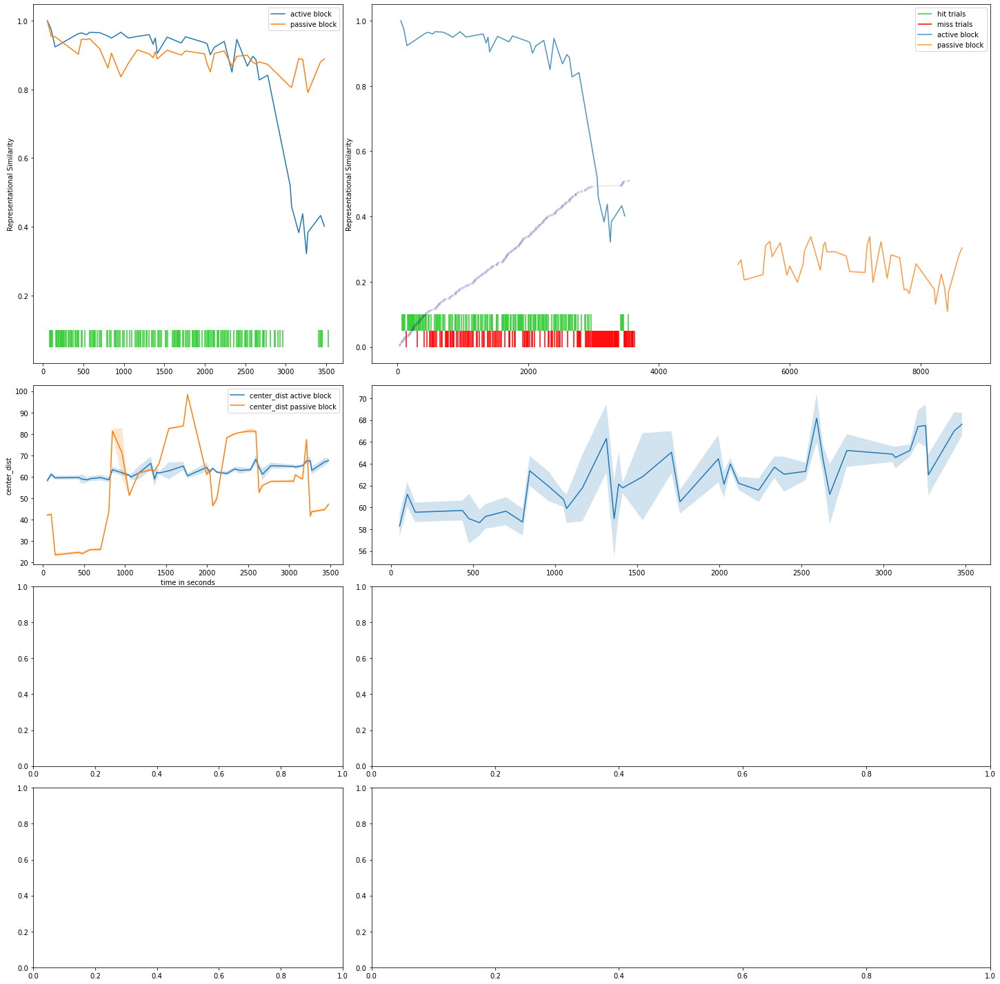

In [580]:
specific_image_behaviour('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards) #, licks)

# all sessions

In [391]:
'hello', f"length of hello: {len('hello')}"

('hello', 'length of hello: 5')

In [392]:
class Unit_Activities:
    def __init__(self, image, unit_set, x_timings, y_active, y_passive, y_act_pas, half):
        self.unit_set = unit_set
        self.image = image
        self.x_timings = x_timings
        self.y_active = y_active
        self.y_passive = y_passive
        self.y_act_pas = y_act_pas
        
        self.half = half
        
    def __str__(self):
        return f"Resp. of {self.unit_set} for image {self.image}"

    def info(self):
        print(f"Hello I'm {self.unit_set} in response to stimuli {self.image}")
      

In [393]:
class Sess:
    def __init__(self, sessionID, mouseID, novel, gen_type, sex, M_good_VIS, M_good_VISp, M_good_VIS_excld_VISp, M_good_CA1):
        self.sessionID = sessionID
        self.mouseID = mouseID
        self.novel = novel
        self.gen_type = gen_type
        self.sex = sex
        self.M_good_VIS = M_good_VIS
        self.M_good_VISp = M_good_VISp
        self.M_good_VIS_excld_VISp = M_good_VIS_excld_VISp
        self.M_good_CA1 = M_good_CA1
        self.responses = []
        self.behaviour = []
        self.task_related = []
        
    def __str__(self):
        return f"Responses of session {self.sessionID} (mouse {self.mouseID}) currently {len(self.responses)}"
        
    def info(self):
        print(f"Hello I'm session {self.sessionID} of mouse {self.mouseID} with type {self.gen_type} and sex {self.sex}, novel={self.novel}")
        
    def basic_repr_similarity(self, image, M, unit_name, sp):
        print(f"adding {unit_name} data for {image}...")
        # final_Repr_Sim_plot(image, M, sp, unit_name, self.sessionID)
        
        x, active, passive, active_passive, half = get_single_plot_content(image, M, sp, unit_name, self.sessionID)
        resp = Unit_Activities(image, unit_name, x, active, passive, active_passive, half)
        self.responses.append(resp)
        
    def novel_repr_similarity(self, image, M, unit_name, sp):
        print(f"adding {unit_name} data for {image}...")
        x, active, passive, active_passive, half = get_single_plot_content(image, M, sp, unit_name, self.sessionID)
        t_r = Unit_Activities(image, unit_name, x, active, passive, active_passive, half)
        self.task_related.append(t_r)

In [395]:
def get_single_plot_content(image_name, M, stimulus_presentations, brain_structure, sessionID):

    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M, image_name, stimulus_presentations)

    # get the Representational Similarity
    C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
    C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
    C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

    half = len(C_rd_active)

    across_blocks = C_reduced[half:, :half]                    # lower middle correlation matrix
    across_blocks2 = C_reduced[:half, half:]                   # passive block? - lower right corr matrix
    
    return timings, C_rd_active[0,:], C_rd_passive[0,:], across_blocks2[0,:], half
    

In [396]:
# plot all sessions mean Representational Similarity with std fill 
'hello'

'hello'

In [397]:
def all_sessions_loop(sessions):
    
    session_data = []
    for sessionID in tqdm(sessions):
        print(f"--loading session {sessionID}")
        session = get_session(session_id=sessionID)
        mouse_id = session.metadata['mouse_id']

        print('--loading tables and units')
        # tables:
        stimulus_presentations = session.stimulus_presentations
        units = session.get_units()
        units.head()
        channels = session.get_channels()
        channels.head(3)
        units = units.merge(channels, left_on='peak_channel_id', right_index=True)
        trials = session.trials
        change_trials = trials[trials.is_change]
        spike_times = session.spike_times
        running_speed = session.running_speed
        eye_tracking = session.eye_tracking
        rewards = session.rewards

        # units:
        # Filter units by the quality criteria
        good_units = units[(units['quality']=='good') &
                           (units['firing_rate']>1) &
                           (units['snr']>1) &
                           (units['isi_violations']<1)]

        good_VISp_units = good_units[good_units['structure_acronym']=='VISp']
        good_CA1_units = good_units[good_units['structure_acronym']=='CA1']
        good_VIS_units = good_units[good_units['structure_acronym'].str.contains('VIS')]
        good_VISpm_units = good_units[good_units['structure_acronym'] == 'VISpm']
        all_VISp_units = good_units[good_units['structure_acronym'].str.contains('VISp')]
        good_non_VISp_units = good_units[good_units['structure_acronym']!='VISp']
        good_VIS_without_VISp_units = good_non_VISp_units[good_non_VISp_units['structure_acronym'].str.contains('VIS')]
        assert len(good_VIS_units) == (len(good_VIS_without_VISp_units)+len(good_VISp_units))
        
        cells = False
        # tagged units:
        if 'Sst' in session.metadata['full_genotype']:
            gen_type = 'Sst'
            cells = True
        elif 'Vip' in session.metadata['full_genotype']:
            gen_type = 'Vip'
            cells = True
        else:
            gen_type = 'wt'
            
        if cells:
            print('--checking optotagging')
            cre_pos_units_from_function = get_cre_pos_unit_ids_from_optotagging(session, structure_acronym='VIS')
            marked_VIS_units = cre_pos_units_from_function.flatten()
            VIS_units_tagged = good_units.loc[marked_VIS_units]
            VIS_units_no_tag = good_VIS_units[~good_VIS_units.index.isin(marked_VIS_units)]
            assert len(VIS_units_no_tag) == len(good_VIS_units) - len(marked_VIS_units)
            M_marked_VIS = construct_unit_activity_population_response_matrix(VIS_units_tagged, spike_times, stimulus_presentations)
            M_VIS_no_tag = construct_unit_activity_population_response_matrix(VIS_units_no_tag, spike_times, stimulus_presentations)

        print('--getting Matrices')
        # Unit Activity Matrices
        # M_all_good = construct_unit_activity_population_response_matrix(good_units, spike_times, stimulus_presentations)
        print('--for VIS')
        M_good_VIS = construct_unit_activity_population_response_matrix(good_VIS_units, spike_times, stimulus_presentations)
        print('--for VISp')
        M_good_VISp = construct_unit_activity_population_response_matrix(good_VISp_units, spike_times, stimulus_presentations)
        print('--for VIS ohne VISp')        
        M_good_VIS_excld_VISp = construct_unit_activity_population_response_matrix(good_VIS_without_VISp_units, spike_times, stimulus_presentations)
        print('--for CA')        
        M_good_CA1 = construct_unit_activity_population_response_matrix(good_CA1_units, spike_times, stimulus_presentations)

        novel=False
        if ecephys_sessions_table.loc[sessionID].experience_level == 'Novel':
            if ecephys_sessions_table.loc[sessionID].image_set == 'H':
                novel = True

        print('--create session Object')
        s0 = Sess(sessionID, mouse_id, novel, gen_type, sex, M_good_VIS, M_good_VISp, M_good_VIS_excld_VISp, M_good_CA1)
        s0.info()
        s0.basic_repr_similarity(image='im111_r', M=M_good_VISp, unit_name='V1', sp=stimulus_presentations)
        s0.basic_repr_similarity(image='im111_r', M=M_good_VIS_excld_VISp, unit_name='VIS without V1', sp=stimulus_presentations)
        s0.basic_repr_similarity(image='im111_r', M=M_good_CA1, unit_name='CA1', sp=stimulus_presentations)
        
        if novel:
            # get novel image to compare with familiar
            s0.novel_repr_similarity(image='im114_r', M=M_good_VISp, unit_name='V1', sp=stimulus_presentations)
            s0.novel_repr_similarity(image='im114_r', M=M_good_VIS_excld_VISp, unit_name='VIS without V1', sp=stimulus_presentations)
            s0.novel_repr_similarity(image='im114_r', M=M_good_CA1, unit_name='CA1', sp=stimulus_presentations)
        
        if cells:
            s0.basic_repr_similarity(image='im111_r', M=M_marked_VIS, unit_name='inhibitory', sp=stimulus_presentations)
            s0.basic_repr_similarity(image='im111_r', M=M_VIS_no_tag, unit_name='exhibitory', sp=stimulus_presentations)
        
        session_data.append(s0)

        print(f'session {sessionID} completed--')
    
    return session_data


In [398]:
# loop through all locally saved sessions 
loc_session_ids = [1053941483, 1053718935, 1124285719, 1111013640]
loc_sessions = all_sessions_loop(loc_session_ids)


  0%|                                                     | 0/4 [00:00<?, ?it/s]

--loading session 1053941483
--loading tables and units
--checking optotagging
Number of trials: 150



0it [00:00, ?it/s]
1it [00:00,  1.47it/s]
2it [00:00,  2.23it/s]
3it [00:01,  2.67it/s]
4it [00:01,  2.96it/s]
5it [00:01,  3.14it/s]
6it [00:02,  3.26it/s]
7it [00:02,  3.33it/s]
8it [00:02,  3.40it/s]
9it [00:02,  3.45it/s]
10it [00:03,  3.49it/s]
11it [00:03,  3.50it/s]
12it [00:03,  3.50it/s]
13it [00:04,  3.52it/s]
14it [00:04,  3.54it/s]
15it [00:04,  3.55it/s]
16it [00:04,  3.56it/s]
17it [00:05,  3.57it/s]
18it [00:05,  3.57it/s]
19it [00:05,  3.59it/s]
20it [00:06,  3.60it/s]
21it [00:06,  3.60it/s]
22it [00:06,  3.61it/s]
23it [00:06,  3.59it/s]
24it [00:07,  3.59it/s]
25it [00:07,  3.60it/s]
26it [00:07,  3.61it/s]
27it [00:07,  3.62it/s]
28it [00:08,  3.63it/s]
29it [00:08,  3.62it/s]
30it [00:08,  3.62it/s]
31it [00:09,  3.63it/s]
32it [00:09,  3.63it/s]
33it [00:09,  3.63it/s]
34it [00:09,  3.63it/s]
35it [00:10,  3.63it/s]
36it [00:10,  3.64it/s]
37it [00:10,  3.63it/s]
38it [00:10,  3.63it/s]
39it [00:11,  3.63it/s]
40it [00:11,  3.63it/s]
41it [00:11,  3.63it/s]
42it 

--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1053941483 of mouse 527749 
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...


 25%|███████████                                 | 1/4 [01:41<05:04, 101.41s/it]

session 1053941483 completed--
--loading session 1053718935
--loading tables and units
--checking optotagging
Number of trials: 150



0it [00:00, ?it/s]
1it [00:01,  1.08s/it]
2it [00:01,  1.49it/s]
3it [00:01,  1.95it/s]
4it [00:02,  2.18it/s]
5it [00:02,  2.47it/s]
6it [00:02,  2.70it/s]
7it [00:03,  2.88it/s]
8it [00:03,  2.98it/s]
9it [00:03,  3.09it/s]
10it [00:03,  3.16it/s]
11it [00:04,  3.20it/s]
12it [00:04,  3.22it/s]
13it [00:04,  3.26it/s]
14it [00:05,  3.29it/s]
15it [00:05,  3.31it/s]
16it [00:05,  3.32it/s]
17it [00:06,  3.32it/s]
18it [00:06,  3.33it/s]
19it [00:06,  3.32it/s]
20it [00:06,  3.33it/s]
21it [00:07,  3.33it/s]
22it [00:07,  3.30it/s]
23it [00:07,  3.31it/s]
24it [00:08,  3.32it/s]
25it [00:08,  3.31it/s]
26it [00:08,  3.32it/s]
27it [00:09,  3.32it/s]
28it [00:09,  3.31it/s]
29it [00:09,  3.29it/s]
30it [00:10,  3.15it/s]
31it [00:10,  3.14it/s]
32it [00:10,  3.10it/s]
33it [00:11,  2.83it/s]
34it [00:11,  2.87it/s]
35it [00:11,  2.61it/s]
36it [00:12,  2.68it/s]
37it [00:12,  2.85it/s]
38it [00:12,  2.97it/s]
39it [00:13,  3.08it/s]
40it [00:13,  3.14it/s]
41it [00:13,  3.19it/s]
42it 

--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1053718935 of mouse 527749 
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...


 50%|██████████████████████                      | 2/4 [03:38<03:40, 110.49s/it]

session 1053718935 completed--
--loading session 1124285719
--loading tables and units
--checking optotagging
Number of trials: 150



0it [00:00, ?it/s]
1it [00:00,  1.24it/s]
2it [00:01,  1.78it/s]
3it [00:01,  2.06it/s]
4it [00:01,  2.24it/s]
5it [00:02,  2.26it/s]
6it [00:02,  2.38it/s]
7it [00:03,  2.46it/s]
8it [00:03,  2.51it/s]
9it [00:03,  2.54it/s]
10it [00:04,  2.57it/s]
11it [00:04,  2.59it/s]
12it [00:05,  2.61it/s]
13it [00:05,  2.63it/s]
14it [00:05,  2.53it/s]
15it [00:06,  2.47it/s]
16it [00:06,  2.52it/s]
17it [00:07,  2.56it/s]
18it [00:07,  2.60it/s]
19it [00:07,  2.62it/s]
20it [00:08,  2.63it/s]
21it [00:08,  2.64it/s]
22it [00:08,  2.65it/s]
23it [00:09,  2.66it/s]
24it [00:09,  2.66it/s]
25it [00:10,  2.67it/s]
26it [00:10,  2.67it/s]
27it [00:10,  2.67it/s]
28it [00:11,  2.67it/s]
29it [00:11,  2.68it/s]
30it [00:11,  2.67it/s]
31it [00:12,  2.67it/s]
32it [00:12,  2.68it/s]
33it [00:13,  2.68it/s]
34it [00:13,  2.67it/s]
35it [00:13,  2.67it/s]
36it [00:14,  2.68it/s]
37it [00:14,  2.67it/s]
38it [00:14,  2.67it/s]
39it [00:15,  2.68it/s]
40it [00:15,  2.68it/s]
41it [00:16,  2.67it/s]
42it 

--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1124285719 of mouse 577287 
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...


 75%|█████████████████████████████████           | 3/4 [05:31<01:51, 111.64s/it]

session 1124285719 completed--
--loading session 1111013640
--loading tables and units
--checking optotagging
Number of trials: 150



0it [00:00, ?it/s]
1it [00:01,  1.14s/it]
2it [00:01,  1.37it/s]
3it [00:02,  1.69it/s]
4it [00:02,  1.91it/s]
5it [00:02,  2.04it/s]
6it [00:03,  2.13it/s]
7it [00:03,  2.19it/s]
8it [00:04,  2.24it/s]
9it [00:04,  2.26it/s]
10it [00:05,  2.29it/s]
11it [00:05,  2.30it/s]
12it [00:05,  2.29it/s]
13it [00:06,  2.31it/s]
14it [00:06,  2.32it/s]
15it [00:07,  2.33it/s]
16it [00:07,  2.34it/s]
17it [00:07,  2.35it/s]
18it [00:08,  2.36it/s]
19it [00:08,  2.36it/s]
20it [00:09,  2.37it/s]
21it [00:09,  2.37it/s]
22it [00:10,  2.38it/s]
23it [00:10,  2.37it/s]
24it [00:10,  2.37it/s]
25it [00:11,  2.36it/s]
26it [00:11,  2.35it/s]
27it [00:12,  2.36it/s]
28it [00:12,  2.36it/s]
29it [00:13,  2.36it/s]
30it [00:13,  2.37it/s]
31it [00:13,  2.37it/s]
32it [00:14,  2.38it/s]
33it [00:14,  2.38it/s]
34it [00:15,  2.38it/s]
35it [00:15,  2.37it/s]
36it [00:16,  2.37it/s]
37it [00:16,  2.38it/s]
38it [00:16,  2.38it/s]
39it [00:17,  2.38it/s]
40it [00:17,  2.38it/s]
41it [00:18,  2.38it/s]
42it 

--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1111013640 of mouse 568963 
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...


100%|████████████████████████████████████████████| 4/4 [07:46<00:00, 116.70s/it]

session 1111013640 completed--


In [404]:
loc_sessions[2].task_related[0].image

'im114_r'

In [ ]:
# data per session all im111:
# 0 - V1
# 1 - VIS \ V1
# 2 - CA1
# 3 - tagged VIS (in) - opt
# 4 - untagged VIS (ex) - opt

In [314]:
def conflate_all_session_responses(sessions, k=0):
    
    x_1st_half_list = []
    x_2nd_half_list = []
    
    y_1_list = []
    y_2_list = []
    y_3_list = []
    
    for session in sessions:
        half = session.responses[k].half
        
        x = session.responses[k].x_timings      # responses 0 refers to a fix response type with V1
        
        y_1 = session.responses[k].y_active
        y_2 = session.responses[k].y_act_pas
        y_3 = session.responses[k].y_passive
        # y = np.concatenate((y_1, y_2))
        
        x_1st_half_list.append(x[:half])
        x_2nd_half_list.append(x[half:])
        
        y_1_list.append(y_1)
        y_2_list.append(y_2)
        y_3_list.append(y_3)
        
        unit_name = session.responses[k].unit_set
        im_name = session.responses[k].image
        
    
    return x_1st_half_list, x_2nd_half_list, y_1_list, y_2_list, y_3_list, im_name[:-2], unit_name, len(sessions)
        

In [350]:
def make_mean_curve(x_1st_half_data, x_2nd_half_data, y_act_data, y_act_pas_data, y_pas_data, image='im111', unit_set='V1', n=9):
    
    x1_list = np.empty(shape=(0,100))
    x2_list = np.empty(shape=(0,100))
    
    y1_list = np.empty(shape=(0,100))
    y2_list = np.empty(shape=(0,100))
    y3_list = np.empty(shape=(0,100))
    
    for i, x1 in enumerate(x_1st_half_data):
        x2 = x_2nd_half_data[i]
        y1 = y_act_data[i]
        y2 = y_pas_data[i]
        y3 = y_act_pas_data[i]
        
        min_x1, max_x1 = min(x1), max(x1)
        new_x1 = np.linspace(min_x1, max_x1, 100)
        min_x2, max_x2 = min(x2), max(x2)
        new_x2 = np.linspace(min_x2, max_x2, 100)
        # print(len(new_x))
        x1_list = np.vstack((x1_list, new_x1))
        x2_list = np.vstack((x2_list, new_x2))
        
        new_y1 = np.interp(new_x1, x1, y1)
        y1_list = np.vstack((y1_list, new_y1))
        new_y2 = np.interp(new_x1, x1, y2)
        y2_list = np.vstack((y2_list, new_y2))
        new_y3 = np.interp(new_x2, x2, y3)
        y3_list = np.vstack((y3_list, new_y3))
        
        
    midx1 = np.mean(x1_list, axis=0)
    midx2 = np.mean(x2_list, axis=0)
    
    midy1 = np.mean(y1_list, axis=0)
    midy2 = np.mean(y2_list, axis=0)
    midy3 = np.mean(y3_list, axis=0)
    
    # print(len(x_list), len(y_list), x_list.shape, y_list.shape, midx.shape, midy.shape)

    fig, ax = plt.subplots(figsize=(16, 8), dpi=80)
    fig.suptitle(t=f'All Sessions: Representational Similarity over Time of {image} in {unit_set}', fontsize=20)
    
    for i in range(n):
        ax.plot(x_1st_half_data[i], y_act_data[i], c='skyblue', alpha=0.5)
        ax.plot(x_2nd_half_data[i], y_act_pas_data[i], c='orange', alpha=0.3)

    ax.plot(midx1, midy1, '--', c='darkblue', label='active')
    ax.plot(midx2, midy3, '--', c='darkorange', label='passive')
    ax.plot(midx1, midy2, '--', c='purple', label='within passive', alpha=0.5)

    ax.set_xlabel('time in seconds   -   complete session (2.5h)') 
    ax.set_ylabel('Representational Similarity')
    ax.legend()
    ax.grid()
    
    plt.savefig(f'plots/all_sessions_rs_in_{unit_set}.png')

    return (midx1, midx2, midy1, midy2, midy3)


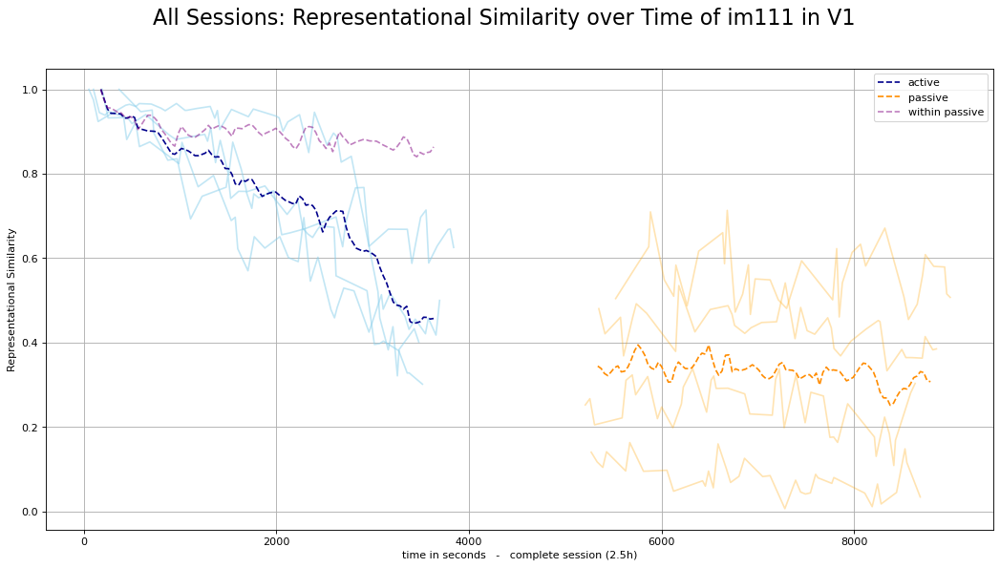

In [351]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 0)
v1_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

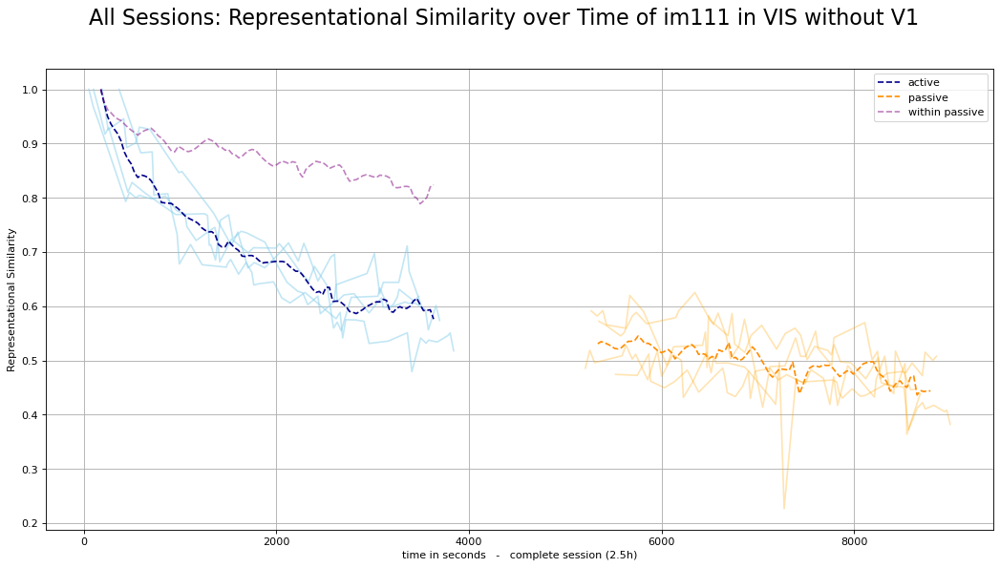

In [352]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 1)
vis_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

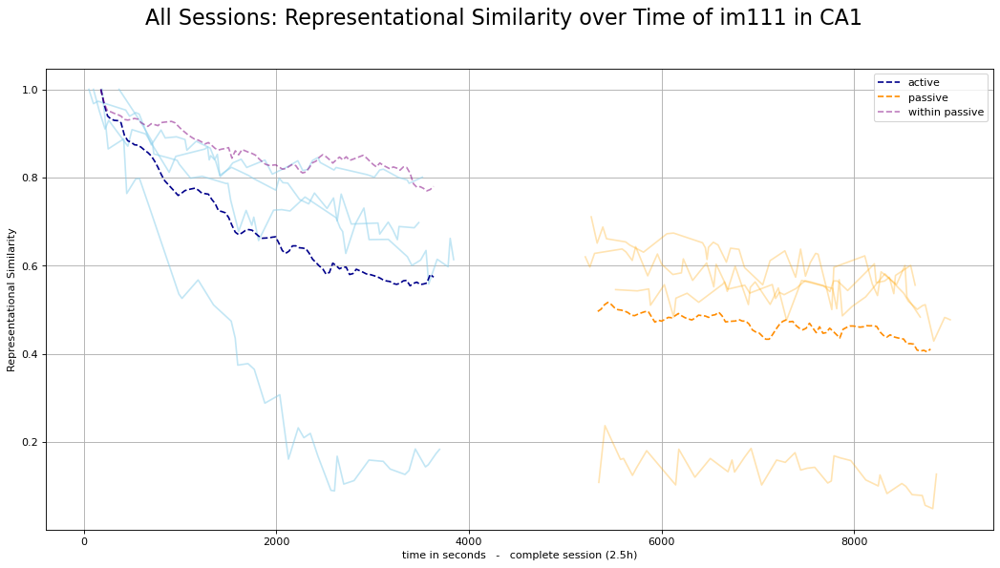

In [353]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 2)
ca1_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

In [364]:
def all_sessions_by_hierarchy(v1_data, vis_data, ca1_data):
    
    (v1_midx1, v1_midx2, v1_midy1, v1_midy2, v1_midy3) = v1_data
    (vis_midx1, vis_midx2, vis_midy1, vis_midy2, vis_midy3) = vis_data
    (ca1_midx1, ca1_midx2, ca1_midy1, ca1_midy2, ca1_midy3) = ca1_data
    
    
    fig, ax = plt.subplots(figsize=(16, 8), dpi=80)
    fig.suptitle(t=f'All Sessions: Representational Similarity over Time by Hierarchy', fontsize=20)

    ax.plot(v1_midx1, v1_midy1, '--', c='hotpink', label='V1')
    ax.plot(v1_midx2, v1_midy3, '--', c='hotpink')
    ax.plot(v1_midx1, v1_midy2, '--', c='hotpink', alpha=0.5)
    
    ax.plot(vis_midx1, vis_midy1, '--', c='mediumorchid', label='VIS without V1')
    ax.plot(vis_midx2, vis_midy3, '--', c='mediumorchid')
    ax.plot(vis_midx1, vis_midy2, '--', c='mediumorchid', alpha=0.5)
    
    ax.plot(ca1_midx1, ca1_midy1, '--', c='mediumslateblue', label='CA1')
    ax.plot(ca1_midx2, ca1_midy3, '--', c='mediumslateblue')
    ax.plot(ca1_midx1, ca1_midy2, '--', c='mediumslateblue', alpha=0.5)

    ax.set_xlabel('time in seconds   -   complete session (2.5h)') 
    ax.set_ylabel('Representational Similarity')
    ax.legend()
    ax.grid()
    
    plt.savefig(f'plots/all_sessions_rs_by_hierarchy.png')

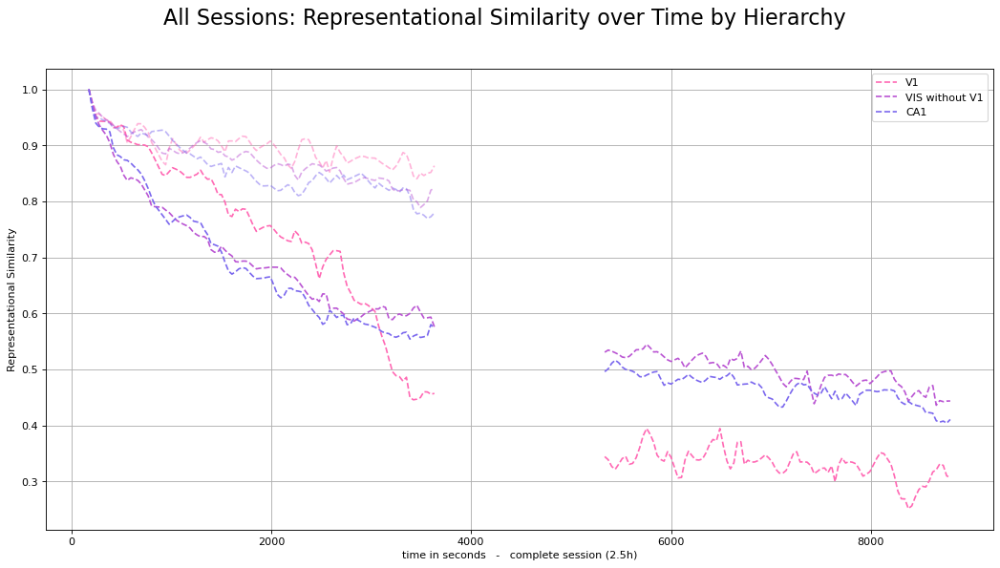

In [365]:
all_sessions_by_hierarchy(v1_data, vis_data, ca1_data)

In [367]:
def all_sessions_by_cell_type(in_data, ex_data):
    
    (in_midx1, in_midx2, in_midy1, in_midy2, in_midy3) = in_data
    (ex_midx1, ex_midx2, ex_midy1, ex_midy2, ex_midy3) = ex_data

    
    
    fig, ax = plt.subplots(figsize=(16, 8), dpi=80)
    fig.suptitle(t=f'All Sessions: Representational Similarity over Time by Cell Type', fontsize=20)

    ax.plot(in_midx1, in_midy1, '--', c='red', label='inhibitory')
    ax.plot(in_midx2, in_midy3, '--', c='red')
    ax.plot(in_midx1, in_midy2, '--', c='red', alpha=0.5)
    
    ax.plot(ex_midx1, ex_midy1, '--', c='blue', label='exhibitory')
    ax.plot(ex_midx2, ex_midy3, '--', c='blue')
    ax.plot(ex_midx1, ex_midy2, '--', c='blue', alpha=0.5)

    ax.set_xlabel('time in seconds   -   complete session (2.5h)') 
    ax.set_ylabel('Representational Similarity')
    ax.legend()
    ax.grid()
    
    plt.savefig(f'plots/all_sessions_rs_by_cell_type.png')

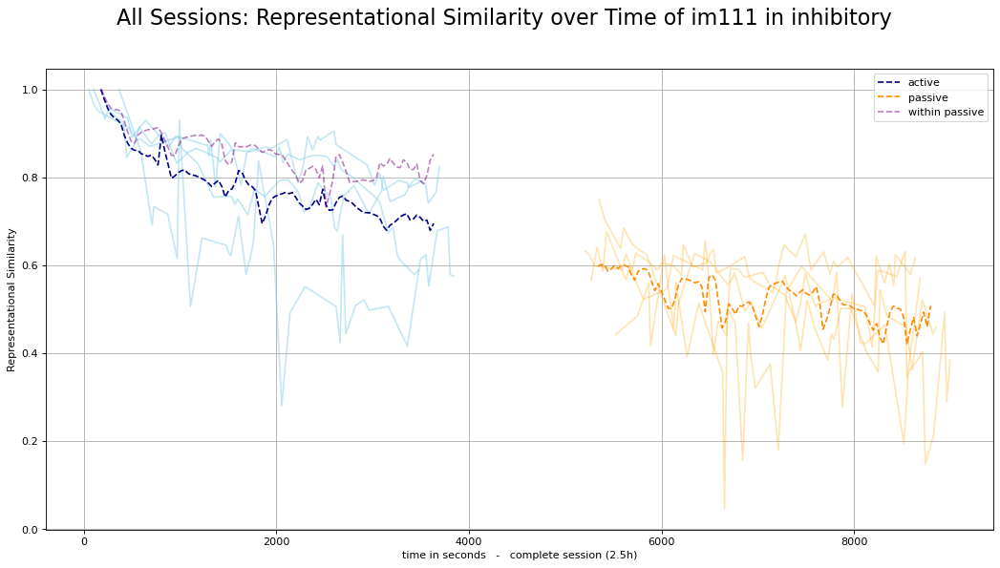

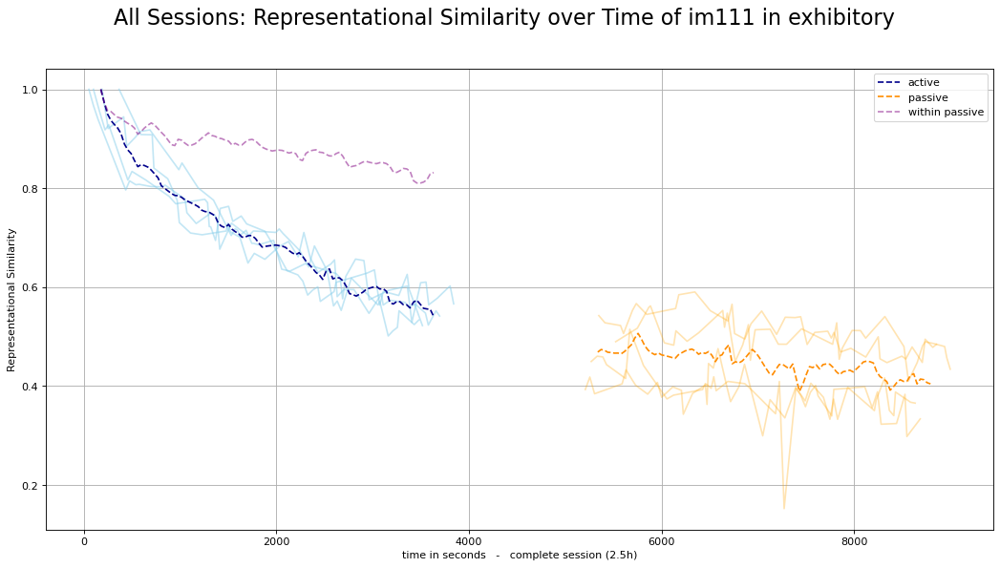

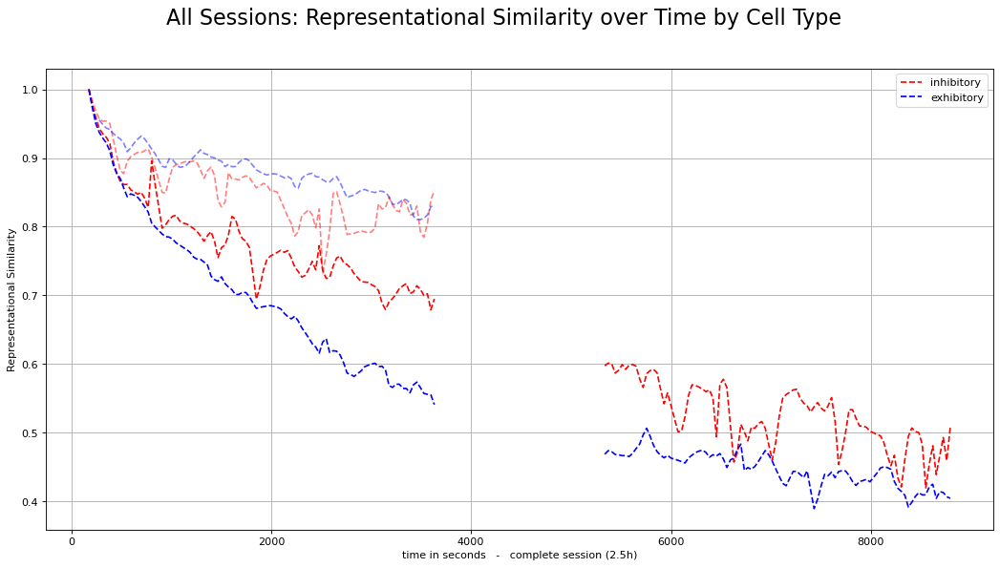

In [368]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 3)
in_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 4)
ex_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

all_sessions_by_cell_type(in_data, ex_data)

In [223]:
import shutil

def delete_session_from_cache(sessionID):
    path = f"/Users/kiracordes/allenSDK/VBNcache/visual-behavior-neuropixels-0.4.0/behavior_ecephys_sessions/{sessionID}"
    shutil.rmtree(path)
    print(f'deleted session {sessionID} from system')
    

In [225]:
def all_sessions_clean(sessions):
    
    session_data = []
    for sessionID in tqdm(sessions):
        print(f"--loading session {sessionID}")
        session = get_session(session_id=sessionID)
        mouse_id = session.metadata['mouse_id']

        print('--loading tables and units')
        # tables:
        stimulus_presentations = session.stimulus_presentations
        units = session.get_units()
        units.head()
        channels = session.get_channels()
        channels.head(3)
        units = units.merge(channels, left_on='peak_channel_id', right_index=True)
        trials = session.trials
        change_trials = trials[trials.is_change]
        spike_times = session.spike_times
        running_speed = session.running_speed
        eye_tracking = session.eye_tracking
        rewards = session.rewards

        # units:
        # Filter units by the quality criteria
        good_units = units[(units['quality']=='good') &
                           (units['firing_rate']>1) &
                           (units['snr']>1) &
                           (units['isi_violations']<1)]

        good_VISp_units = good_units[good_units['structure_acronym']=='VISp']
        good_CA1_units = good_units[good_units['structure_acronym']=='CA1']
        good_VIS_units = good_units[good_units['structure_acronym'].str.contains('VIS')]
        good_VISpm_units = good_units[good_units['structure_acronym'] == 'VISpm']
        all_VISp_units = good_units[good_units['structure_acronym'].str.contains('VISp')]
        good_non_VISp_units = good_units[good_units['structure_acronym']!='VISp']
        good_VIS_without_VISp_units = good_non_VISp_units[good_non_VISp_units['structure_acronym'].str.contains('VIS')]
        assert len(good_VIS_units) == (len(good_VIS_without_VISp_units)+len(good_VISp_units))
        # tagged units:
        # cre_pos_units_from_function = get_cre_pos_unit_ids_from_optotagging(session, structure_acronym='VIS')
        # marked_VIS_units = cre_pos_units_from_function.flatten()
        # VIS_units_tagged = good_units.loc[marked_VIS_units]
        # VIS_units_no_tag = good_VIS_units[~good_VIS_units.index.isin(marked_VIS_units)]
        # assert len(VIS_units_no_tag) == len(good_VIS_units) - len(marked_VIS_units)

        print('--getting Matrices')
        # Unit Activity Matrices
        # M_all_good = construct_unit_activity_population_response_matrix(good_units, spike_times, stimulus_presentations)
        print('--for VIS')
        M_good_VIS = construct_unit_activity_population_response_matrix(good_VIS_units, spike_times, stimulus_presentations)
        print('--for VISp')
        M_good_VISp = construct_unit_activity_population_response_matrix(good_VISp_units, spike_times, stimulus_presentations)
        print('--for VIS ohne VISp')        
        M_good_VIS_excld_VISp = construct_unit_activity_population_response_matrix(good_VIS_without_VISp_units, spike_times, stimulus_presentations)
        print('--for CA')        
        M_good_CA1 = construct_unit_activity_population_response_matrix(good_CA1_units, spike_times, stimulus_presentations)
        # M_marked_VIS = construct_unit_activity_population_response_matrix(VIS_units_tagged, spike_times, stimulus_presentations)
        # M_VIS_no_tag = construct_unit_activity_population_response_matrix(VIS_units_no_tag, spike_times, stimulus_presentations)

        print('--create session Object')
        s0 = Sess(sessionID, mouse_id, M_good_VIS, M_good_VISp, M_good_VIS_excld_VISp, M_good_CA1)
        s0.info()
        s0.basic_repr_similarity(image='im111_r', M=M_good_VISp, unit_name='V1', sp=stimulus_presentations)
        session_data.append(s0)

        # x, active, passive, active_passive = get_single_plot_content('im111_r', M_good_VISp, stimulus_presentations, 'V1', sessionID)
        # final_Repr_Sim_plot('im111_r', M_good_VISp, stimulus_presentations, 'VISp (V1)', sessionID)
        print(f'session {sessionID} completed--')
        
        delete_session_from_cache(sessionID)
    
    return session_data

In [237]:
ecephys_sessions_table.sample(5) # changing!

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1086200042,1086220230,2021-02-24 14:33:38.933000+00:00,NP.1,EPHYS_1_images_G_3uL_reward,554013,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,156,1485.0,...,1920.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,18.0,1,Familiar,0,943,NaN,NaN
1099598937,1099625106,2021-04-28 13:41:43.554000+00:00,NP.0,EPHYS_1_images_H_3uL_reward,560962,wt/wt,M,NeuropixelVisualBehavior,166,2888.0,...,2304.0,"['grey', 'root', 'VISal', 'VISam', 'VISl', 'VI...",H,17.0,1,Familiar,0,966,NaN,NaN
1092283837,1092312238,2021-03-24 15:47:12.529000+00:00,NP.0,EPHYS_1_images_G_3uL_reward,560771,Vip-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,132,2732.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,23.0,1,Familiar,0,954,NaN,NaN
1118512505,1118600316,2021-07-29 13:18:24.439000+00:00,NP.1,EPHYS_1_images_G_3uL_reward,576324,wt/wt,F,NeuropixelVisualBehavior,139,1638.0,...,2304.0,"['APN', 'CA1', 'DG-mo', 'DG-po', 'DG-sg', 'HPF...",G,0.0,2,Novel,1,1003,NaN,NaN
1093864136,1093938328,2021-04-01 14:43:52.154000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,553253,Vip-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,197,2202.0,...,2304.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'gre...",H,0.0,2,Novel,1,958,NaN,NaN


  0%|                                                     | 0/5 [00:00<?, ?it/s]

--loading session 1152632711



ecephys_session_1152632711.nwb:   0%|              | 0.00/1.81G [00:00<?, ?MB/s]
ecephys_session_1152632711.nwb:   0%| | 1.02k/1.81G [00:00<173:10:18, 2.91kMB/s]
ecephys_session_1152632711.nwb:   0%|  | 19.5k/1.81G [00:00<11:13:04, 44.9kMB/s]
ecephys_session_1152632711.nwb:   0%|    | 69.6k/1.81G [00:00<3:52:19, 130kMB/s]
ecephys_session_1152632711.nwb:   0%|     | 157k/1.81G [00:00<1:54:09, 265kMB/s]
ecephys_session_1152632711.nwb:   0%|       | 366k/1.81G [00:01<57:07, 529kMB/s]
ecephys_session_1152632711.nwb:   0%|      | 765k/1.81G [00:01<28:07, 1.07MMB/s]
ecephys_session_1152632711.nwb:   0%|     | 1.17M/1.81G [00:01<21:35, 1.40MMB/s]
ecephys_session_1152632711.nwb:   0%|     | 1.57M/1.81G [00:01<18:33, 1.63MMB/s]
ecephys_session_1152632711.nwb:   0%|     | 2.76M/1.81G [00:01<10:13, 2.95MMB/s]
ecephys_session_1152632711.nwb:   0%|     | 4.11M/1.81G [00:01<06:10, 4.89MMB/s]
ecephys_session_1152632711.nwb:   0%|     | 5.17M/1.81G [00:02<05:03, 5.95MMB/s]
ecephys_session_1152632711.

ecephys_session_1152632711.nwb:  14%|▊     | 252M/1.81G [00:20<01:54, 13.6MMB/s]
ecephys_session_1152632711.nwb:  14%|▊     | 253M/1.81G [00:20<02:18, 11.2MMB/s]
ecephys_session_1152632711.nwb:  14%|▊     | 254M/1.81G [00:20<02:12, 11.8MMB/s]
ecephys_session_1152632711.nwb:  14%|▊     | 255M/1.81G [00:21<02:13, 11.6MMB/s]
ecephys_session_1152632711.nwb:  14%|▊     | 257M/1.81G [00:21<02:15, 11.5MMB/s]
ecephys_session_1152632711.nwb:  14%|▊     | 258M/1.81G [00:21<02:09, 12.0MMB/s]
ecephys_session_1152632711.nwb:  14%|▊     | 260M/1.81G [00:21<02:05, 12.4MMB/s]
ecephys_session_1152632711.nwb:  14%|▊     | 261M/1.81G [00:21<02:02, 12.6MMB/s]
ecephys_session_1152632711.nwb:  14%|▊     | 262M/1.81G [00:21<02:00, 12.8MMB/s]
ecephys_session_1152632711.nwb:  15%|▊     | 264M/1.81G [00:21<01:59, 13.0MMB/s]
ecephys_session_1152632711.nwb:  15%|▉     | 265M/1.81G [00:21<01:57, 13.1MMB/s]
ecephys_session_1152632711.nwb:  15%|▉     | 266M/1.81G [00:21<01:57, 13.2MMB/s]
ecephys_session_1152632711.n

ecephys_session_1152632711.nwb:  28%|█▋    | 512M/1.81G [00:40<01:37, 13.3MMB/s]
ecephys_session_1152632711.nwb:  28%|█▋    | 514M/1.81G [00:40<01:37, 13.3MMB/s]
ecephys_session_1152632711.nwb:  28%|█▋    | 515M/1.81G [00:40<01:37, 13.3MMB/s]
ecephys_session_1152632711.nwb:  28%|█▋    | 516M/1.81G [00:40<01:36, 13.4MMB/s]
ecephys_session_1152632711.nwb:  29%|█▋    | 518M/1.81G [00:40<01:36, 13.4MMB/s]
ecephys_session_1152632711.nwb:  29%|█▋    | 519M/1.81G [00:40<01:36, 13.4MMB/s]
ecephys_session_1152632711.nwb:  29%|█▋    | 520M/1.81G [00:41<01:36, 13.4MMB/s]
ecephys_session_1152632711.nwb:  29%|█▋    | 522M/1.81G [00:41<01:36, 13.4MMB/s]
ecephys_session_1152632711.nwb:  29%|█▋    | 523M/1.81G [00:41<01:36, 13.4MMB/s]
ecephys_session_1152632711.nwb:  29%|█▋    | 524M/1.81G [00:41<01:35, 13.4MMB/s]
ecephys_session_1152632711.nwb:  29%|█▋    | 526M/1.81G [00:41<01:35, 13.4MMB/s]
ecephys_session_1152632711.nwb:  29%|█▋    | 527M/1.81G [00:41<01:35, 13.5MMB/s]
ecephys_session_1152632711.n

ecephys_session_1152632711.nwb:  43%|██▌   | 773M/1.81G [01:00<01:17, 13.4MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 774M/1.81G [01:00<01:17, 13.4MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 776M/1.81G [01:00<01:17, 13.4MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 777M/1.81G [01:00<01:17, 13.4MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 779M/1.81G [01:00<01:17, 13.4MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 780M/1.81G [01:00<01:18, 13.2MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 781M/1.81G [01:00<01:18, 13.2MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 783M/1.81G [01:00<01:17, 13.2MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 784M/1.81G [01:00<01:18, 13.1MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 785M/1.81G [01:01<01:17, 13.2MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 787M/1.81G [01:01<01:17, 13.2MMB/s]
ecephys_session_1152632711.nwb:  43%|██▌   | 788M/1.81G [01:01<01:20, 12.8MMB/s]
ecephys_session_1152632711.n

ecephys_session_1152632711.nwb:  57%|██▊  | 1.03G/1.81G [01:19<00:59, 13.1MMB/s]
ecephys_session_1152632711.nwb:  57%|██▊  | 1.04G/1.81G [01:19<00:58, 13.2MMB/s]
ecephys_session_1152632711.nwb:  57%|██▊  | 1.04G/1.81G [01:20<00:58, 13.3MMB/s]
ecephys_session_1152632711.nwb:  57%|██▊  | 1.04G/1.81G [01:20<00:58, 13.3MMB/s]
ecephys_session_1152632711.nwb:  57%|██▊  | 1.04G/1.81G [01:20<00:58, 13.3MMB/s]
ecephys_session_1152632711.nwb:  57%|██▊  | 1.04G/1.81G [01:20<00:58, 13.3MMB/s]
ecephys_session_1152632711.nwb:  57%|██▊  | 1.04G/1.81G [01:20<00:57, 13.3MMB/s]
ecephys_session_1152632711.nwb:  58%|██▉  | 1.04G/1.81G [01:20<00:57, 13.4MMB/s]
ecephys_session_1152632711.nwb:  58%|██▉  | 1.04G/1.81G [01:20<00:57, 13.4MMB/s]
ecephys_session_1152632711.nwb:  58%|██▉  | 1.05G/1.81G [01:20<00:58, 13.1MMB/s]
ecephys_session_1152632711.nwb:  58%|██▉  | 1.05G/1.81G [01:20<00:58, 13.2MMB/s]
ecephys_session_1152632711.nwb:  58%|██▉  | 1.05G/1.81G [01:20<00:57, 13.3MMB/s]
ecephys_session_1152632711.n

ecephys_session_1152632711.nwb:  71%|███▌ | 1.29G/1.81G [01:39<00:39, 13.0MMB/s]
ecephys_session_1152632711.nwb:  71%|███▌ | 1.30G/1.81G [01:39<00:40, 12.9MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.30G/1.81G [01:39<00:39, 13.0MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.30G/1.81G [01:39<00:39, 13.0MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.30G/1.81G [01:39<00:39, 13.0MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.30G/1.81G [01:39<00:39, 12.9MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.30G/1.81G [01:40<00:39, 12.9MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.30G/1.81G [01:40<00:39, 13.0MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.30G/1.81G [01:40<00:38, 13.0MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.31G/1.81G [01:40<00:38, 13.1MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.31G/1.81G [01:40<00:38, 13.0MMB/s]
ecephys_session_1152632711.nwb:  72%|███▌ | 1.31G/1.81G [01:40<00:39, 12.9MMB/s]
ecephys_session_1152632711.n

ecephys_session_1152632711.nwb:  86%|████▎| 1.55G/1.81G [01:59<00:19, 13.3MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.55G/1.81G [01:59<00:19, 13.4MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.56G/1.81G [01:59<00:19, 13.4MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.56G/1.81G [01:59<00:19, 13.4MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.56G/1.81G [01:59<00:19, 13.4MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.56G/1.81G [01:59<00:18, 13.4MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.56G/1.81G [01:59<00:18, 13.4MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.56G/1.81G [01:59<00:18, 13.4MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.56G/1.81G [02:00<00:18, 13.4MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.56G/1.81G [02:00<00:18, 13.4MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.57G/1.81G [02:00<00:18, 13.5MMB/s]
ecephys_session_1152632711.nwb:  86%|████▎| 1.57G/1.81G [02:00<00:18, 13.5MMB/s]
ecephys_session_1152632711.n

--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1152632711 of mouse 599294 
adding V1 data for im111_r...


 20%|████████▊                                   | 1/5 [03:10<12:42, 190.62s/it]

session 1152632711 completed--
deleted session 1152632711 from system
--loading session 1048189115



ecephys_session_1048189115.nwb:   0%|              | 0.00/2.76G [00:00<?, ?MB/s]
ecephys_session_1048189115.nwb:   0%| | 1.02k/2.76G [00:00<278:31:49, 2.76kMB/s]
ecephys_session_1048189115.nwb:   0%|  | 17.4k/2.76G [00:00<20:02:16, 38.3kMB/s]
ecephys_session_1048189115.nwb:   0%|    | 71.7k/2.76G [00:00<5:49:08, 132kMB/s]
ecephys_session_1048189115.nwb:   0%|     | 159k/2.76G [00:00<3:07:38, 246kMB/s]
ecephys_session_1048189115.nwb:   0%|     | 368k/2.76G [00:01<1:26:52, 530kMB/s]
ecephys_session_1048189115.nwb:   0%|      | 751k/2.76G [00:01<43:07, 1.07MMB/s]
ecephys_session_1048189115.nwb:   0%|     | 1.15M/2.76G [00:01<33:03, 1.39MMB/s]
ecephys_session_1048189115.nwb:   0%|     | 1.57M/2.76G [00:01<27:55, 1.65MMB/s]
ecephys_session_1048189115.nwb:   0%|     | 2.63M/2.76G [00:01<13:38, 3.37MMB/s]
ecephys_session_1048189115.nwb:   0%|     | 3.08M/2.76G [00:01<13:56, 3.30MMB/s]
ecephys_session_1048189115.nwb:   0%|     | 4.42M/2.76G [00:02<08:20, 5.51MMB/s]
ecephys_session_1048189115.

ecephys_session_1048189115.nwb:   9%|▌     | 250M/2.76G [00:20<03:07, 13.4MMB/s]
ecephys_session_1048189115.nwb:   9%|▌     | 251M/2.76G [00:20<03:07, 13.4MMB/s]
ecephys_session_1048189115.nwb:   9%|▌     | 253M/2.76G [00:20<03:06, 13.4MMB/s]
ecephys_session_1048189115.nwb:   9%|▌     | 254M/2.76G [00:20<03:06, 13.4MMB/s]
ecephys_session_1048189115.nwb:   9%|▌     | 255M/2.76G [00:20<03:06, 13.4MMB/s]
ecephys_session_1048189115.nwb:   9%|▌     | 257M/2.76G [00:21<03:07, 13.4MMB/s]
ecephys_session_1048189115.nwb:   9%|▌     | 258M/2.76G [00:21<03:07, 13.4MMB/s]
ecephys_session_1048189115.nwb:   9%|▌     | 259M/2.76G [00:21<03:07, 13.4MMB/s]
ecephys_session_1048189115.nwb:   9%|▌     | 261M/2.76G [00:21<03:07, 13.4MMB/s]
ecephys_session_1048189115.nwb:   9%|▌     | 262M/2.76G [00:21<03:06, 13.4MMB/s]
ecephys_session_1048189115.nwb:  10%|▌     | 263M/2.76G [00:21<03:06, 13.4MMB/s]
ecephys_session_1048189115.nwb:  10%|▌     | 265M/2.76G [00:21<03:06, 13.4MMB/s]
ecephys_session_1048189115.n

ecephys_session_1048189115.nwb:  18%|█     | 510M/2.76G [00:40<02:48, 13.3MMB/s]
ecephys_session_1048189115.nwb:  19%|█     | 512M/2.76G [00:40<02:48, 13.3MMB/s]
ecephys_session_1048189115.nwb:  19%|█     | 513M/2.76G [00:40<02:48, 13.4MMB/s]
ecephys_session_1048189115.nwb:  19%|█     | 514M/2.76G [00:40<02:48, 13.4MMB/s]
ecephys_session_1048189115.nwb:  19%|█     | 516M/2.76G [00:40<02:48, 13.3MMB/s]
ecephys_session_1048189115.nwb:  19%|█     | 517M/2.76G [00:40<02:48, 13.3MMB/s]
ecephys_session_1048189115.nwb:  19%|█▏    | 518M/2.76G [00:40<02:48, 13.3MMB/s]
ecephys_session_1048189115.nwb:  19%|█▏    | 520M/2.76G [00:40<02:48, 13.4MMB/s]
ecephys_session_1048189115.nwb:  19%|█▏    | 521M/2.76G [00:40<02:48, 13.3MMB/s]
ecephys_session_1048189115.nwb:  19%|█▏    | 522M/2.76G [00:41<02:50, 13.1MMB/s]
ecephys_session_1048189115.nwb:  19%|█▏    | 524M/2.76G [00:41<02:48, 13.3MMB/s]
ecephys_session_1048189115.nwb:  19%|█▏    | 525M/2.76G [00:41<02:48, 13.3MMB/s]
ecephys_session_1048189115.n

ecephys_session_1048189115.nwb:  28%|█▋    | 768M/2.76G [01:01<03:00, 11.1MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 769M/2.76G [01:01<03:15, 10.2MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 770M/2.76G [01:01<02:58, 11.2MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 772M/2.76G [01:01<03:09, 10.5MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 773M/2.76G [01:01<02:56, 11.3MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 774M/2.76G [01:01<03:03, 10.8MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 775M/2.76G [01:01<02:52, 11.5MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 777M/2.76G [01:02<03:07, 10.6MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 778M/2.76G [01:02<02:56, 11.2MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 779M/2.76G [01:02<03:01, 11.0MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 780M/2.76G [01:02<02:51, 11.6MMB/s]
ecephys_session_1048189115.nwb:  28%|█▋    | 782M/2.76G [01:02<03:02, 10.9MMB/s]
ecephys_session_1048189115.n

ecephys_session_1048189115.nwb:  37%|█▊   | 1.02G/2.76G [01:22<02:12, 13.2MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.02G/2.76G [01:22<02:12, 13.2MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.02G/2.76G [01:22<02:11, 13.3MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.02G/2.76G [01:22<02:20, 12.4MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.02G/2.76G [01:22<02:17, 12.6MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.02G/2.76G [01:22<02:15, 12.8MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.03G/2.76G [01:22<02:13, 13.0MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.03G/2.76G [01:22<02:13, 13.0MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.03G/2.76G [01:22<02:12, 13.1MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.03G/2.76G [01:23<02:12, 13.1MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.03G/2.76G [01:23<02:11, 13.2MMB/s]
ecephys_session_1048189115.nwb:  37%|█▊   | 1.03G/2.76G [01:23<02:10, 13.3MMB/s]
ecephys_session_1048189115.n

ecephys_session_1048189115.nwb:  46%|██▎  | 1.28G/2.76G [01:42<01:50, 13.4MMB/s]
ecephys_session_1048189115.nwb:  46%|██▎  | 1.28G/2.76G [01:42<01:50, 13.4MMB/s]
ecephys_session_1048189115.nwb:  46%|██▎  | 1.28G/2.76G [01:42<01:50, 13.4MMB/s]
ecephys_session_1048189115.nwb:  46%|██▎  | 1.28G/2.76G [01:42<01:50, 13.4MMB/s]
ecephys_session_1048189115.nwb:  46%|██▎  | 1.28G/2.76G [01:42<01:50, 13.4MMB/s]
ecephys_session_1048189115.nwb:  46%|██▎  | 1.28G/2.76G [01:42<01:59, 12.4MMB/s]
ecephys_session_1048189115.nwb:  46%|██▎  | 1.29G/2.76G [01:42<01:57, 12.6MMB/s]
ecephys_session_1048189115.nwb:  47%|██▎  | 1.29G/2.76G [01:42<01:55, 12.8MMB/s]
ecephys_session_1048189115.nwb:  47%|██▎  | 1.29G/2.76G [01:42<01:53, 13.0MMB/s]
ecephys_session_1048189115.nwb:  47%|██▎  | 1.29G/2.76G [01:43<01:52, 13.1MMB/s]
ecephys_session_1048189115.nwb:  47%|██▎  | 1.29G/2.76G [01:43<01:52, 13.1MMB/s]
ecephys_session_1048189115.nwb:  47%|██▎  | 1.29G/2.76G [01:43<01:51, 13.2MMB/s]
ecephys_session_1048189115.n

ecephys_session_1048189115.nwb:  56%|██▊  | 1.54G/2.76G [02:01<01:31, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.54G/2.76G [02:01<01:31, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.54G/2.76G [02:01<01:31, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.54G/2.76G [02:02<01:31, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.54G/2.76G [02:02<01:31, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.55G/2.76G [02:02<01:30, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.55G/2.76G [02:02<01:30, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.55G/2.76G [02:02<01:30, 13.5MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.55G/2.76G [02:02<01:30, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.55G/2.76G [02:02<01:30, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.55G/2.76G [02:02<01:30, 13.4MMB/s]
ecephys_session_1048189115.nwb:  56%|██▊  | 1.55G/2.76G [02:02<01:30, 13.4MMB/s]
ecephys_session_1048189115.n

ecephys_session_1048189115.nwb:  65%|███▎ | 1.80G/2.76G [02:21<01:13, 13.2MMB/s]
ecephys_session_1048189115.nwb:  65%|███▎ | 1.80G/2.76G [02:21<01:12, 13.2MMB/s]
ecephys_session_1048189115.nwb:  65%|███▎ | 1.80G/2.76G [02:21<01:12, 13.3MMB/s]
ecephys_session_1048189115.nwb:  65%|███▎ | 1.80G/2.76G [02:21<01:11, 13.3MMB/s]
ecephys_session_1048189115.nwb:  65%|███▎ | 1.81G/2.76G [02:21<01:11, 13.4MMB/s]
ecephys_session_1048189115.nwb:  65%|███▎ | 1.81G/2.76G [02:21<01:11, 13.3MMB/s]
ecephys_session_1048189115.nwb:  65%|███▎ | 1.81G/2.76G [02:22<01:11, 13.3MMB/s]
ecephys_session_1048189115.nwb:  65%|███▎ | 1.81G/2.76G [02:22<01:11, 13.4MMB/s]
ecephys_session_1048189115.nwb:  65%|███▎ | 1.81G/2.76G [02:22<01:11, 13.3MMB/s]
ecephys_session_1048189115.nwb:  66%|███▎ | 1.81G/2.76G [02:22<01:12, 13.2MMB/s]
ecephys_session_1048189115.nwb:  66%|███▎ | 1.81G/2.76G [02:22<01:11, 13.3MMB/s]
ecephys_session_1048189115.nwb:  66%|███▎ | 1.81G/2.76G [02:22<01:12, 13.2MMB/s]
ecephys_session_1048189115.n

ecephys_session_1048189115.nwb:  75%|███▋ | 2.06G/2.76G [02:41<00:52, 13.3MMB/s]
ecephys_session_1048189115.nwb:  75%|███▋ | 2.06G/2.76G [02:41<00:52, 13.3MMB/s]
ecephys_session_1048189115.nwb:  75%|███▋ | 2.06G/2.76G [02:41<00:52, 13.4MMB/s]
ecephys_session_1048189115.nwb:  75%|███▋ | 2.06G/2.76G [02:41<00:53, 13.1MMB/s]
ecephys_session_1048189115.nwb:  75%|███▋ | 2.07G/2.76G [02:41<00:53, 13.2MMB/s]
ecephys_session_1048189115.nwb:  75%|███▋ | 2.07G/2.76G [02:41<00:52, 13.3MMB/s]
ecephys_session_1048189115.nwb:  75%|███▋ | 2.07G/2.76G [02:41<00:54, 12.9MMB/s]
ecephys_session_1048189115.nwb:  75%|███▋ | 2.07G/2.76G [02:41<00:53, 13.0MMB/s]
ecephys_session_1048189115.nwb:  75%|███▋ | 2.07G/2.76G [02:41<00:52, 13.1MMB/s]
ecephys_session_1048189115.nwb:  75%|███▋ | 2.07G/2.76G [02:41<00:52, 13.2MMB/s]
ecephys_session_1048189115.nwb:  75%|███▊ | 2.07G/2.76G [02:42<00:52, 13.3MMB/s]
ecephys_session_1048189115.nwb:  75%|███▊ | 2.08G/2.76G [02:42<00:53, 12.9MMB/s]
ecephys_session_1048189115.n

ecephys_session_1048189115.nwb:  84%|████▏| 2.32G/2.76G [03:00<00:32, 13.4MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.32G/2.76G [03:00<00:34, 12.9MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.32G/2.76G [03:00<00:33, 13.1MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.33G/2.76G [03:01<00:33, 13.2MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.33G/2.76G [03:01<00:32, 13.3MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.33G/2.76G [03:01<00:32, 13.3MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.33G/2.76G [03:01<00:32, 13.3MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.33G/2.76G [03:01<00:32, 13.3MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.33G/2.76G [03:01<00:32, 13.3MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.33G/2.76G [03:01<00:32, 13.4MMB/s]
ecephys_session_1048189115.nwb:  84%|████▏| 2.34G/2.76G [03:01<00:32, 13.4MMB/s]
ecephys_session_1048189115.nwb:  85%|████▏| 2.34G/2.76G [03:01<00:31, 13.4MMB/s]
ecephys_session_1048189115.n

ecephys_session_1048189115.nwb:  93%|████▋| 2.58G/2.76G [03:20<00:13, 13.4MMB/s]
ecephys_session_1048189115.nwb:  93%|████▋| 2.58G/2.76G [03:21<00:14, 12.9MMB/s]
ecephys_session_1048189115.nwb:  93%|████▋| 2.58G/2.76G [03:21<00:13, 13.1MMB/s]
ecephys_session_1048189115.nwb:  94%|████▋| 2.59G/2.76G [03:21<00:13, 13.2MMB/s]
ecephys_session_1048189115.nwb:  94%|████▋| 2.59G/2.76G [03:21<00:13, 13.2MMB/s]
ecephys_session_1048189115.nwb:  94%|████▋| 2.59G/2.76G [03:21<00:13, 13.3MMB/s]
ecephys_session_1048189115.nwb:  94%|████▋| 2.59G/2.76G [03:21<00:13, 13.3MMB/s]
ecephys_session_1048189115.nwb:  94%|████▋| 2.59G/2.76G [03:21<00:13, 13.3MMB/s]
ecephys_session_1048189115.nwb:  94%|████▋| 2.59G/2.76G [03:21<00:12, 13.3MMB/s]
ecephys_session_1048189115.nwb:  94%|████▋| 2.59G/2.76G [03:21<00:12, 13.4MMB/s]
ecephys_session_1048189115.nwb:  94%|████▋| 2.60G/2.76G [03:21<00:12, 13.4MMB/s]
ecephys_session_1048189115.nwb:  94%|████▋| 2.60G/2.76G [03:22<00:12, 13.4MMB/s]
ecephys_session_1048189115.n

--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1048189115 of mouse 509808 
adding V1 data for im111_r...


 40%|█████████████████▌                          | 2/5 [07:49<12:07, 242.60s/it]

session 1048189115 completed--
deleted session 1048189115 from system
--loading session 1064644573



ecephys_session_1064644573.nwb:   0%|              | 0.00/2.99G [00:00<?, ?MB/s]
ecephys_session_1064644573.nwb:   0%| | 1.02k/2.99G [00:00<289:04:07, 2.88kMB/s]
ecephys_session_1064644573.nwb:   0%|  | 17.4k/2.99G [00:00<21:02:59, 39.5kMB/s]
ecephys_session_1064644573.nwb:   0%|    | 71.7k/2.99G [00:00<6:09:44, 135kMB/s]
ecephys_session_1064644573.nwb:   0%|     | 159k/2.99G [00:00<3:18:53, 251kMB/s]
ecephys_session_1064644573.nwb:   0%|     | 368k/2.99G [00:01<1:32:29, 539kMB/s]
ecephys_session_1064644573.nwb:   0%|      | 751k/2.99G [00:01<49:18, 1.01MMB/s]
ecephys_session_1064644573.nwb:   0%|     | 1.15M/2.99G [00:01<37:07, 1.34MMB/s]
ecephys_session_1064644573.nwb:   0%|     | 1.55M/2.99G [00:01<31:28, 1.58MMB/s]
ecephys_session_1064644573.nwb:   0%|     | 2.80M/2.99G [00:01<16:25, 3.04MMB/s]
ecephys_session_1064644573.nwb:   0%|     | 4.14M/2.99G [00:01<10:04, 4.95MMB/s]
ecephys_session_1064644573.nwb:   0%|     | 4.77M/2.99G [00:02<09:46, 5.10MMB/s]
ecephys_session_1064644573.

ecephys_session_1064644573.nwb:   8%|▍     | 249M/2.99G [00:20<03:52, 11.8MMB/s]
ecephys_session_1064644573.nwb:   8%|▌     | 251M/2.99G [00:20<03:44, 12.2MMB/s]
ecephys_session_1064644573.nwb:   8%|▌     | 252M/2.99G [00:21<03:38, 12.5MMB/s]
ecephys_session_1064644573.nwb:   8%|▌     | 253M/2.99G [00:21<03:33, 12.8MMB/s]
ecephys_session_1064644573.nwb:   9%|▌     | 255M/2.99G [00:21<03:30, 13.0MMB/s]
ecephys_session_1064644573.nwb:   9%|▌     | 256M/2.99G [00:21<03:33, 12.8MMB/s]
ecephys_session_1064644573.nwb:   9%|▌     | 258M/2.99G [00:21<03:25, 13.3MMB/s]
ecephys_session_1064644573.nwb:   9%|▌     | 259M/2.99G [00:21<03:24, 13.3MMB/s]
ecephys_session_1064644573.nwb:   9%|▌     | 260M/2.99G [00:21<03:25, 13.3MMB/s]
ecephys_session_1064644573.nwb:   9%|▌     | 262M/2.99G [00:21<03:24, 13.4MMB/s]
ecephys_session_1064644573.nwb:   9%|▌     | 263M/2.99G [00:21<03:24, 13.3MMB/s]
ecephys_session_1064644573.nwb:   9%|▌     | 264M/2.99G [00:22<03:24, 13.4MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  17%|█     | 512M/2.99G [00:41<03:04, 13.5MMB/s]
ecephys_session_1064644573.nwb:  17%|█     | 513M/2.99G [00:41<03:04, 13.5MMB/s]
ecephys_session_1064644573.nwb:  17%|█     | 514M/2.99G [00:41<03:04, 13.4MMB/s]
ecephys_session_1064644573.nwb:  17%|█     | 516M/2.99G [00:41<03:04, 13.4MMB/s]
ecephys_session_1064644573.nwb:  17%|█     | 517M/2.99G [00:41<03:04, 13.4MMB/s]
ecephys_session_1064644573.nwb:  17%|█     | 518M/2.99G [00:41<03:04, 13.4MMB/s]
ecephys_session_1064644573.nwb:  17%|█     | 520M/2.99G [00:41<03:04, 13.4MMB/s]
ecephys_session_1064644573.nwb:  17%|█     | 521M/2.99G [00:41<03:05, 13.3MMB/s]
ecephys_session_1064644573.nwb:  17%|█     | 522M/2.99G [00:41<03:03, 13.4MMB/s]
ecephys_session_1064644573.nwb:  17%|█     | 524M/2.99G [00:42<03:04, 13.4MMB/s]
ecephys_session_1064644573.nwb:  18%|█     | 525M/2.99G [00:42<03:04, 13.4MMB/s]
ecephys_session_1064644573.nwb:  18%|█     | 526M/2.99G [00:42<03:03, 13.4MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  26%|█▌    | 773M/2.99G [01:00<02:45, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 774M/2.99G [01:00<02:45, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 775M/2.99G [01:00<02:45, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 777M/2.99G [01:01<02:45, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 778M/2.99G [01:01<02:45, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 780M/2.99G [01:01<02:45, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 781M/2.99G [01:01<02:44, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 782M/2.99G [01:01<02:44, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 784M/2.99G [01:01<02:45, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 785M/2.99G [01:01<02:44, 13.5MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 786M/2.99G [01:01<02:45, 13.4MMB/s]
ecephys_session_1064644573.nwb:  26%|█▌    | 788M/2.99G [01:01<02:44, 13.4MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  35%|█▋   | 1.03G/2.99G [01:20<02:26, 13.4MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.03G/2.99G [01:20<02:25, 13.4MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.04G/2.99G [01:20<02:26, 13.4MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.04G/2.99G [01:20<02:26, 13.3MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.04G/2.99G [01:20<02:25, 13.4MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.04G/2.99G [01:21<02:25, 13.4MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.04G/2.99G [01:21<02:25, 13.4MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.04G/2.99G [01:21<02:25, 13.4MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.04G/2.99G [01:21<02:26, 13.3MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.05G/2.99G [01:21<02:26, 13.3MMB/s]
ecephys_session_1064644573.nwb:  35%|█▋   | 1.05G/2.99G [01:21<02:25, 13.3MMB/s]
ecephys_session_1064644573.nwb:  35%|█▊   | 1.05G/2.99G [01:21<02:26, 13.3MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  43%|██▏  | 1.29G/2.99G [01:40<02:07, 13.4MMB/s]
ecephys_session_1064644573.nwb:  43%|██▏  | 1.30G/2.99G [01:40<02:06, 13.4MMB/s]
ecephys_session_1064644573.nwb:  43%|██▏  | 1.30G/2.99G [01:40<02:08, 13.2MMB/s]
ecephys_session_1064644573.nwb:  43%|██▏  | 1.30G/2.99G [01:40<02:06, 13.4MMB/s]
ecephys_session_1064644573.nwb:  43%|██▏  | 1.30G/2.99G [01:40<02:06, 13.4MMB/s]
ecephys_session_1064644573.nwb:  43%|██▏  | 1.30G/2.99G [01:40<02:06, 13.4MMB/s]
ecephys_session_1064644573.nwb:  44%|██▏  | 1.30G/2.99G [01:40<02:06, 13.4MMB/s]
ecephys_session_1064644573.nwb:  44%|██▏  | 1.30G/2.99G [01:40<02:06, 13.4MMB/s]
ecephys_session_1064644573.nwb:  44%|██▏  | 1.31G/2.99G [01:40<02:05, 13.4MMB/s]
ecephys_session_1064644573.nwb:  44%|██▏  | 1.31G/2.99G [01:41<02:06, 13.4MMB/s]
ecephys_session_1064644573.nwb:  44%|██▏  | 1.31G/2.99G [01:41<02:05, 13.4MMB/s]
ecephys_session_1064644573.nwb:  44%|██▏  | 1.31G/2.99G [01:41<02:05, 13.4MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  52%|██▌  | 1.56G/2.99G [01:59<01:48, 13.3MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.56G/2.99G [01:59<01:48, 13.3MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.56G/2.99G [01:59<01:47, 13.4MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.56G/2.99G [02:00<01:47, 13.4MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.56G/2.99G [02:00<01:46, 13.4MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.56G/2.99G [02:00<01:47, 13.4MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.56G/2.99G [02:00<01:46, 13.4MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.57G/2.99G [02:00<01:47, 13.3MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.57G/2.99G [02:00<01:46, 13.4MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.57G/2.99G [02:00<01:46, 13.4MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.57G/2.99G [02:00<01:46, 13.4MMB/s]
ecephys_session_1064644573.nwb:  52%|██▌  | 1.57G/2.99G [02:00<01:46, 13.3MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  61%|███  | 1.82G/2.99G [02:19<01:29, 13.1MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.82G/2.99G [02:19<01:31, 12.9MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.82G/2.99G [02:19<01:30, 12.9MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.82G/2.99G [02:19<01:30, 13.0MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.82G/2.99G [02:19<01:29, 13.1MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.82G/2.99G [02:19<01:28, 13.2MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.82G/2.99G [02:19<01:28, 13.2MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.83G/2.99G [02:20<01:28, 13.2MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.83G/2.99G [02:20<01:27, 13.3MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.83G/2.99G [02:20<01:27, 13.3MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.83G/2.99G [02:20<01:27, 13.3MMB/s]
ecephys_session_1064644573.nwb:  61%|███  | 1.83G/2.99G [02:20<01:26, 13.4MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  69%|███▍ | 2.08G/2.99G [02:38<01:08, 13.4MMB/s]
ecephys_session_1064644573.nwb:  69%|███▍ | 2.08G/2.99G [02:38<01:09, 13.1MMB/s]
ecephys_session_1064644573.nwb:  69%|███▍ | 2.08G/2.99G [02:39<01:09, 13.1MMB/s]
ecephys_session_1064644573.nwb:  70%|███▍ | 2.08G/2.99G [02:39<01:08, 13.3MMB/s]
ecephys_session_1064644573.nwb:  70%|███▍ | 2.08G/2.99G [02:39<01:08, 13.3MMB/s]
ecephys_session_1064644573.nwb:  70%|███▍ | 2.08G/2.99G [02:39<01:07, 13.4MMB/s]
ecephys_session_1064644573.nwb:  70%|███▍ | 2.09G/2.99G [02:39<01:07, 13.4MMB/s]
ecephys_session_1064644573.nwb:  70%|███▍ | 2.09G/2.99G [02:39<01:07, 13.4MMB/s]
ecephys_session_1064644573.nwb:  70%|███▍ | 2.09G/2.99G [02:39<01:07, 13.4MMB/s]
ecephys_session_1064644573.nwb:  70%|███▍ | 2.09G/2.99G [02:39<01:07, 13.4MMB/s]
ecephys_session_1064644573.nwb:  70%|███▍ | 2.09G/2.99G [02:39<01:07, 13.4MMB/s]
ecephys_session_1064644573.nwb:  70%|███▍ | 2.09G/2.99G [02:40<01:07, 13.3MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  78%|███▉ | 2.34G/2.99G [02:58<00:48, 13.4MMB/s]
ecephys_session_1064644573.nwb:  78%|███▉ | 2.34G/2.99G [02:58<00:48, 13.4MMB/s]
ecephys_session_1064644573.nwb:  78%|███▉ | 2.34G/2.99G [02:58<00:48, 13.4MMB/s]
ecephys_session_1064644573.nwb:  78%|███▉ | 2.34G/2.99G [02:58<00:48, 13.4MMB/s]
ecephys_session_1064644573.nwb:  78%|███▉ | 2.34G/2.99G [02:58<00:48, 13.4MMB/s]
ecephys_session_1064644573.nwb:  78%|███▉ | 2.35G/2.99G [02:58<00:48, 13.4MMB/s]
ecephys_session_1064644573.nwb:  78%|███▉ | 2.35G/2.99G [02:59<00:48, 13.4MMB/s]
ecephys_session_1064644573.nwb:  78%|███▉ | 2.35G/2.99G [02:59<00:47, 13.4MMB/s]
ecephys_session_1064644573.nwb:  79%|███▉ | 2.35G/2.99G [02:59<00:48, 13.4MMB/s]
ecephys_session_1064644573.nwb:  79%|███▉ | 2.35G/2.99G [02:59<00:47, 13.4MMB/s]
ecephys_session_1064644573.nwb:  79%|███▉ | 2.35G/2.99G [02:59<00:47, 13.4MMB/s]
ecephys_session_1064644573.nwb:  79%|███▉ | 2.35G/2.99G [02:59<00:47, 13.4MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  87%|████▎| 2.60G/2.99G [03:18<00:29, 13.4MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.60G/2.99G [03:18<00:29, 13.4MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.60G/2.99G [03:18<00:29, 13.4MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.61G/2.99G [03:18<00:28, 13.4MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.61G/2.99G [03:18<00:28, 13.4MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.61G/2.99G [03:18<00:28, 13.4MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.61G/2.99G [03:18<00:28, 13.4MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.61G/2.99G [03:18<00:28, 13.5MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.61G/2.99G [03:18<00:28, 13.4MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.61G/2.99G [03:18<00:28, 13.4MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.61G/2.99G [03:19<00:28, 13.3MMB/s]
ecephys_session_1064644573.nwb:  87%|████▎| 2.62G/2.99G [03:19<00:28, 13.4MMB/s]
ecephys_session_1064644573.n

ecephys_session_1064644573.nwb:  96%|████▊| 2.86G/2.99G [03:37<00:09, 13.2MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.86G/2.99G [03:37<00:09, 13.3MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.87G/2.99G [03:37<00:09, 13.3MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.87G/2.99G [03:37<00:09, 13.4MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.87G/2.99G [03:38<00:09, 13.3MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.87G/2.99G [03:38<00:09, 13.4MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.87G/2.99G [03:38<00:09, 13.4MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.87G/2.99G [03:38<00:09, 13.4MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.87G/2.99G [03:38<00:08, 13.4MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.88G/2.99G [03:38<00:08, 13.4MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.88G/2.99G [03:38<00:08, 13.4MMB/s]
ecephys_session_1064644573.nwb:  96%|████▊| 2.88G/2.99G [03:38<00:08, 13.4MMB/s]
ecephys_session_1064644573.n

--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1064644573 of mouse 544456 
adding V1 data for im111_r...


 60%|██████████████████████████▍                 | 3/5 [12:47<08:55, 267.79s/it]

session 1064644573 completed--
deleted session 1064644573 from system
--loading session 1044385384


/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/allensdk/brain_observatory/behavior/data_objects/metadata/subject_metadata/full_genotype.py:57: UserWarning: Unable to parse cre_line from full_genotype
  warnings.warn('Unable to parse cre_line from full_genotype')


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1044385384 of mouse 524761 
adding V1 data for im111_r...


 80%|███████████████████████████████████▏        | 4/5 [13:39<03:02, 182.48s/it]

session 1044385384 completed--
deleted session 1044385384 from system
--loading session 1092283837



ecephys_session_1092283837.nwb:   0%|              | 0.00/3.82G [00:00<?, ?MB/s]
ecephys_session_1092283837.nwb:   0%| | 1.02k/3.82G [00:00<403:48:57, 2.63kMB/s]
ecephys_session_1092283837.nwb:   0%|  | 19.5k/3.82G [00:00<24:57:36, 42.5kMB/s]
ecephys_session_1092283837.nwb:   0%|    | 68.6k/3.82G [00:00<8:32:03, 124kMB/s]
ecephys_session_1092283837.nwb:   0%|     | 162k/3.82G [00:00<4:12:08, 252kMB/s]
ecephys_session_1092283837.nwb:   0%|     | 340k/3.82G [00:01<2:11:47, 483kMB/s]
ecephys_session_1092283837.nwb:   0%|     | 727k/3.82G [00:01<1:04:33, 986kMB/s]
ecephys_session_1092283837.nwb:   0%|     | 1.45M/3.82G [00:01<33:50, 1.88MMB/s]
ecephys_session_1092283837.nwb:   0%|     | 2.69M/3.82G [00:01<16:21, 3.89MMB/s]
ecephys_session_1092283837.nwb:   0%|     | 3.21M/3.82G [00:01<15:45, 4.04MMB/s]
ecephys_session_1092283837.nwb:   0%|     | 4.55M/3.82G [00:01<10:17, 6.18MMB/s]
ecephys_session_1092283837.nwb:   0%|     | 5.87M/3.82G [00:01<08:01, 7.91MMB/s]
ecephys_session_1092283837.

ecephys_session_1092283837.nwb:   7%|▍     | 250M/3.82G [00:20<04:29, 13.3MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 252M/3.82G [00:20<04:28, 13.3MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 253M/3.82G [00:20<04:29, 13.2MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 254M/3.82G [00:20<04:32, 13.1MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 256M/3.82G [00:20<04:31, 13.1MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 257M/3.82G [00:20<04:31, 13.1MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 258M/3.82G [00:21<04:29, 13.2MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 260M/3.82G [00:21<04:28, 13.3MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 261M/3.82G [00:21<04:28, 13.3MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 262M/3.82G [00:21<04:29, 13.2MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 264M/3.82G [00:21<04:28, 13.3MMB/s]
ecephys_session_1092283837.nwb:   7%|▍     | 265M/3.82G [00:21<04:27, 13.3MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  13%|▊     | 509M/3.82G [00:40<04:59, 11.0MMB/s]
ecephys_session_1092283837.nwb:  13%|▊     | 510M/3.82G [00:40<05:00, 11.0MMB/s]
ecephys_session_1092283837.nwb:  13%|▊     | 512M/3.82G [00:40<04:43, 11.7MMB/s]
ecephys_session_1092283837.nwb:  13%|▊     | 513M/3.82G [00:40<04:46, 11.6MMB/s]
ecephys_session_1092283837.nwb:  13%|▊     | 514M/3.82G [00:40<04:40, 11.8MMB/s]
ecephys_session_1092283837.nwb:  13%|▊     | 515M/3.82G [00:40<04:39, 11.8MMB/s]
ecephys_session_1092283837.nwb:  14%|▊     | 516M/3.82G [00:41<04:36, 12.0MMB/s]
ecephys_session_1092283837.nwb:  14%|▊     | 518M/3.82G [00:41<04:37, 11.9MMB/s]
ecephys_session_1092283837.nwb:  14%|▊     | 519M/3.82G [00:41<04:39, 11.8MMB/s]
ecephys_session_1092283837.nwb:  14%|▊     | 520M/3.82G [00:41<04:43, 11.6MMB/s]
ecephys_session_1092283837.nwb:  14%|▊     | 521M/3.82G [00:41<04:39, 11.8MMB/s]
ecephys_session_1092283837.nwb:  14%|▊     | 523M/3.82G [00:41<04:34, 12.0MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  20%|█▏    | 762M/3.82G [01:00<03:49, 13.3MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 764M/3.82G [01:00<03:49, 13.3MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 765M/3.82G [01:00<03:49, 13.3MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 766M/3.82G [01:00<03:53, 13.1MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 768M/3.82G [01:00<03:48, 13.4MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 769M/3.82G [01:00<03:47, 13.4MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 770M/3.82G [01:00<03:49, 13.3MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 772M/3.82G [01:01<03:49, 13.3MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 773M/3.82G [01:01<03:48, 13.3MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 774M/3.82G [01:01<03:49, 13.3MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 776M/3.82G [01:01<03:48, 13.3MMB/s]
ecephys_session_1092283837.nwb:  20%|█▏    | 777M/3.82G [01:01<03:48, 13.3MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  27%|█▎   | 1.02G/3.82G [01:20<03:39, 12.7MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.02G/3.82G [01:20<03:32, 13.2MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.03G/3.82G [01:20<03:32, 13.2MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.03G/3.82G [01:20<03:30, 13.3MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.03G/3.82G [01:20<03:31, 13.2MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.03G/3.82G [01:20<03:29, 13.3MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.03G/3.82G [01:20<03:30, 13.2MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.03G/3.82G [01:20<03:30, 13.3MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.03G/3.82G [01:20<03:29, 13.3MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.03G/3.82G [01:21<03:29, 13.3MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.04G/3.82G [01:21<03:29, 13.3MMB/s]
ecephys_session_1092283837.nwb:  27%|█▎   | 1.04G/3.82G [01:21<03:29, 13.3MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  34%|█▋   | 1.28G/3.82G [01:39<03:09, 13.4MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.28G/3.82G [01:40<03:11, 13.3MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.28G/3.82G [01:40<03:10, 13.3MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.28G/3.82G [01:40<03:09, 13.4MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.29G/3.82G [01:40<03:10, 13.3MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.29G/3.82G [01:40<03:10, 13.3MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.29G/3.82G [01:40<03:09, 13.3MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.29G/3.82G [01:40<03:10, 13.3MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.29G/3.82G [01:40<03:10, 13.3MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.29G/3.82G [01:40<03:09, 13.3MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.29G/3.82G [01:40<03:10, 13.3MMB/s]
ecephys_session_1092283837.nwb:  34%|█▋   | 1.30G/3.82G [01:41<03:09, 13.3MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  40%|██   | 1.54G/3.82G [01:59<02:52, 13.2MMB/s]
ecephys_session_1092283837.nwb:  40%|██   | 1.54G/3.82G [01:59<02:52, 13.2MMB/s]
ecephys_session_1092283837.nwb:  40%|██   | 1.54G/3.82G [01:59<02:51, 13.3MMB/s]
ecephys_session_1092283837.nwb:  40%|██   | 1.54G/3.82G [01:59<02:51, 13.3MMB/s]
ecephys_session_1092283837.nwb:  40%|██   | 1.55G/3.82G [01:59<02:51, 13.2MMB/s]
ecephys_session_1092283837.nwb:  41%|██   | 1.55G/3.82G [01:59<02:51, 13.2MMB/s]
ecephys_session_1092283837.nwb:  41%|██   | 1.55G/3.82G [02:00<02:50, 13.3MMB/s]
ecephys_session_1092283837.nwb:  41%|██   | 1.55G/3.82G [02:00<02:52, 13.2MMB/s]
ecephys_session_1092283837.nwb:  41%|██   | 1.55G/3.82G [02:00<02:51, 13.2MMB/s]
ecephys_session_1092283837.nwb:  41%|██   | 1.55G/3.82G [02:00<03:01, 12.5MMB/s]
ecephys_session_1092283837.nwb:  41%|██   | 1.55G/3.82G [02:00<02:57, 12.7MMB/s]
ecephys_session_1092283837.nwb:  41%|██   | 1.56G/3.82G [02:00<02:54, 13.0MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  47%|██▎  | 1.80G/3.82G [02:19<02:31, 13.3MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.80G/3.82G [02:19<02:31, 13.3MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.80G/3.82G [02:19<02:31, 13.3MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.80G/3.82G [02:19<02:30, 13.4MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.81G/3.82G [02:19<02:34, 13.1MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.81G/3.82G [02:19<02:32, 13.2MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.81G/3.82G [02:19<02:34, 13.0MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.81G/3.82G [02:19<02:38, 12.7MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.81G/3.82G [02:19<02:35, 12.9MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.81G/3.82G [02:20<02:34, 13.0MMB/s]
ecephys_session_1092283837.nwb:  47%|██▎  | 1.81G/3.82G [02:20<02:35, 12.9MMB/s]
ecephys_session_1092283837.nwb:  48%|██▍  | 1.81G/3.82G [02:20<02:34, 13.0MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  54%|██▋  | 2.06G/3.82G [02:38<02:12, 13.3MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.06G/3.82G [02:38<02:12, 13.3MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.06G/3.82G [02:39<02:11, 13.3MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.06G/3.82G [02:39<02:11, 13.3MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.06G/3.82G [02:39<02:11, 13.3MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.07G/3.82G [02:39<02:12, 13.2MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.07G/3.82G [02:39<02:11, 13.3MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.07G/3.82G [02:39<02:11, 13.3MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.07G/3.82G [02:39<02:13, 13.1MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.07G/3.82G [02:39<02:12, 13.2MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.07G/3.82G [02:39<02:12, 13.2MMB/s]
ecephys_session_1092283837.nwb:  54%|██▋  | 2.07G/3.82G [02:39<02:11, 13.3MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  61%|███  | 2.32G/3.82G [02:58<01:52, 13.3MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.32G/3.82G [02:58<01:52, 13.4MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.32G/3.82G [02:58<01:52, 13.3MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.32G/3.82G [02:58<01:52, 13.2MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.32G/3.82G [02:58<01:52, 13.3MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.33G/3.82G [02:59<01:52, 13.3MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.33G/3.82G [02:59<01:52, 13.3MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.33G/3.82G [02:59<01:52, 13.3MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.33G/3.82G [02:59<01:52, 13.3MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.33G/3.82G [02:59<01:52, 13.3MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.33G/3.82G [02:59<01:52, 13.3MMB/s]
ecephys_session_1092283837.nwb:  61%|███  | 2.33G/3.82G [02:59<01:51, 13.3MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  68%|███▍ | 2.58G/3.82G [03:18<01:33, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.58G/3.82G [03:18<01:34, 13.2MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.58G/3.82G [03:18<01:32, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.58G/3.82G [03:19<01:32, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.59G/3.82G [03:19<01:32, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.59G/3.82G [03:19<01:32, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.59G/3.82G [03:19<01:32, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.59G/3.82G [03:19<01:32, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.59G/3.82G [03:19<01:32, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.59G/3.82G [03:19<01:32, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.59G/3.82G [03:19<01:32, 13.3MMB/s]
ecephys_session_1092283837.nwb:  68%|███▍ | 2.59G/3.82G [03:19<01:32, 13.3MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  74%|███▋ | 2.84G/3.82G [03:38<01:13, 13.3MMB/s]
ecephys_session_1092283837.nwb:  74%|███▋ | 2.84G/3.82G [03:38<01:13, 13.3MMB/s]
ecephys_session_1092283837.nwb:  74%|███▋ | 2.84G/3.82G [03:38<01:13, 13.3MMB/s]
ecephys_session_1092283837.nwb:  74%|███▋ | 2.84G/3.82G [03:38<01:13, 13.3MMB/s]
ecephys_session_1092283837.nwb:  74%|███▋ | 2.84G/3.82G [03:38<01:13, 13.3MMB/s]
ecephys_session_1092283837.nwb:  75%|███▋ | 2.85G/3.82G [03:38<01:13, 13.3MMB/s]
ecephys_session_1092283837.nwb:  75%|███▋ | 2.85G/3.82G [03:38<01:13, 13.3MMB/s]
ecephys_session_1092283837.nwb:  75%|███▋ | 2.85G/3.82G [03:38<01:13, 13.3MMB/s]
ecephys_session_1092283837.nwb:  75%|███▋ | 2.85G/3.82G [03:39<01:12, 13.3MMB/s]
ecephys_session_1092283837.nwb:  75%|███▋ | 2.85G/3.82G [03:39<01:12, 13.3MMB/s]
ecephys_session_1092283837.nwb:  75%|███▋ | 2.85G/3.82G [03:39<01:12, 13.3MMB/s]
ecephys_session_1092283837.nwb:  75%|███▋ | 2.85G/3.82G [03:39<01:12, 13.3MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  81%|████ | 3.10G/3.82G [03:57<00:54, 13.2MMB/s]
ecephys_session_1092283837.nwb:  81%|████ | 3.10G/3.82G [03:57<00:54, 13.3MMB/s]
ecephys_session_1092283837.nwb:  81%|████ | 3.10G/3.82G [03:58<00:54, 13.3MMB/s]
ecephys_session_1092283837.nwb:  81%|████ | 3.10G/3.82G [03:58<00:54, 13.3MMB/s]
ecephys_session_1092283837.nwb:  81%|████ | 3.10G/3.82G [03:58<00:53, 13.3MMB/s]
ecephys_session_1092283837.nwb:  81%|████ | 3.11G/3.82G [03:58<00:53, 13.3MMB/s]
ecephys_session_1092283837.nwb:  81%|████ | 3.11G/3.82G [03:58<00:53, 13.3MMB/s]
ecephys_session_1092283837.nwb:  81%|████ | 3.11G/3.82G [03:58<00:53, 13.3MMB/s]
ecephys_session_1092283837.nwb:  81%|████ | 3.11G/3.82G [03:58<00:53, 13.2MMB/s]
ecephys_session_1092283837.nwb:  81%|████ | 3.11G/3.82G [03:58<00:53, 13.2MMB/s]
ecephys_session_1092283837.nwb:  82%|████ | 3.11G/3.82G [03:58<00:53, 13.3MMB/s]
ecephys_session_1092283837.nwb:  82%|████ | 3.11G/3.82G [03:58<00:54, 13.0MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  88%|████▍| 3.36G/3.82G [04:17<00:34, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.36G/3.82G [04:17<00:34, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.36G/3.82G [04:17<00:34, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.36G/3.82G [04:17<00:34, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.36G/3.82G [04:17<00:34, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.36G/3.82G [04:18<00:34, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.37G/3.82G [04:18<00:34, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.37G/3.82G [04:18<00:33, 13.4MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.37G/3.82G [04:18<00:33, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.37G/3.82G [04:18<00:33, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.37G/3.82G [04:18<00:33, 13.3MMB/s]
ecephys_session_1092283837.nwb:  88%|████▍| 3.37G/3.82G [04:18<00:33, 13.3MMB/s]
ecephys_session_1092283837.n

ecephys_session_1092283837.nwb:  95%|████▋| 3.62G/3.82G [04:37<00:15, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▋| 3.62G/3.82G [04:37<00:15, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▋| 3.62G/3.82G [04:37<00:14, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▋| 3.62G/3.82G [04:37<00:14, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▋| 3.62G/3.82G [04:37<00:14, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▋| 3.62G/3.82G [04:37<00:14, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▋| 3.62G/3.82G [04:37<00:14, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▋| 3.63G/3.82G [04:37<00:14, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▋| 3.63G/3.82G [04:37<00:14, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▊| 3.63G/3.82G [04:37<00:14, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▊| 3.63G/3.82G [04:38<00:14, 13.3MMB/s]
ecephys_session_1092283837.nwb:  95%|████▊| 3.63G/3.82G [04:38<00:14, 13.3MMB/s]
ecephys_session_1092283837.n

--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1092283837 of mouse 560771 
adding V1 data for im111_r...


100%|████████████████████████████████████████████| 5/5 [19:55<00:00, 239.00s/it]

session 1092283837 completed--
deleted session 1092283837 from system


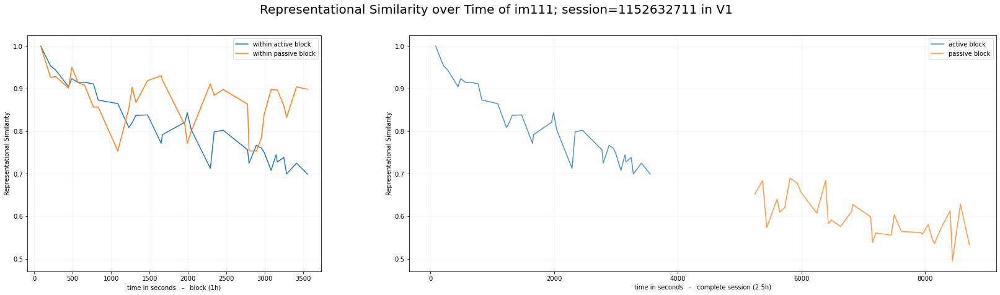

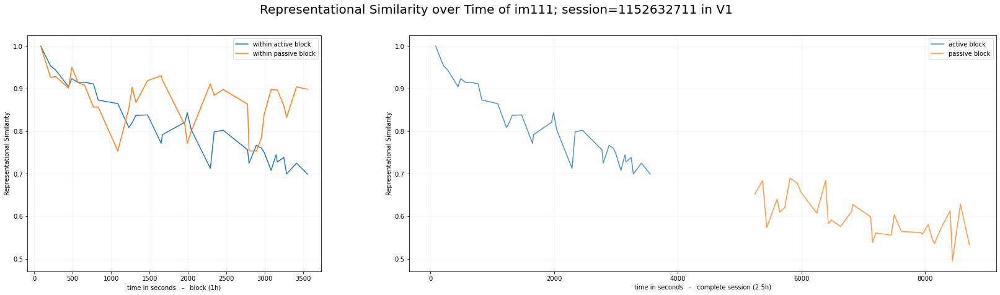

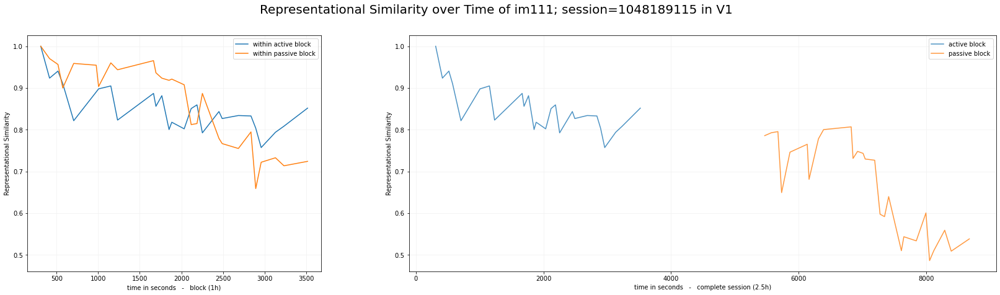

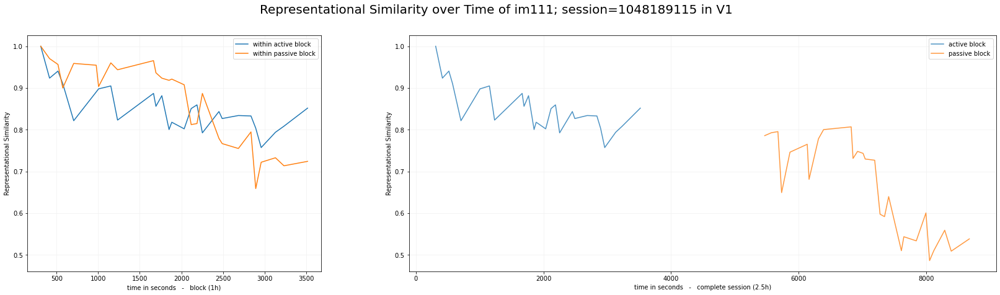

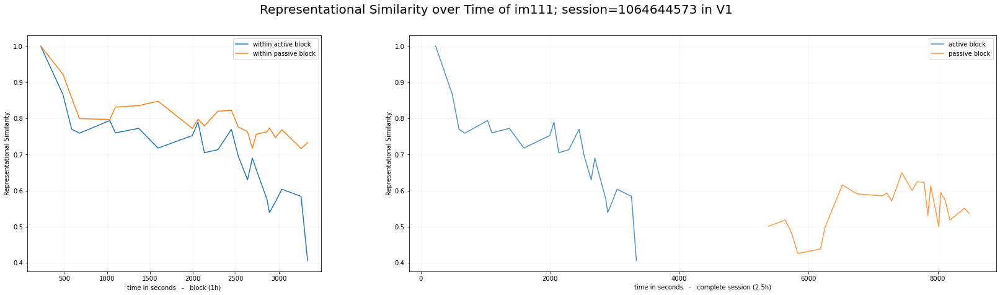

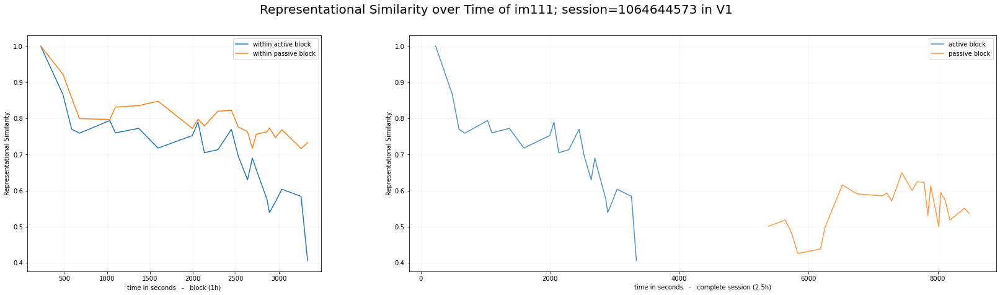

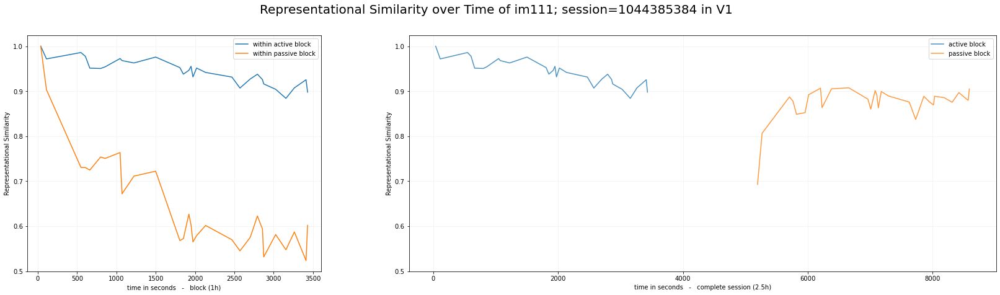

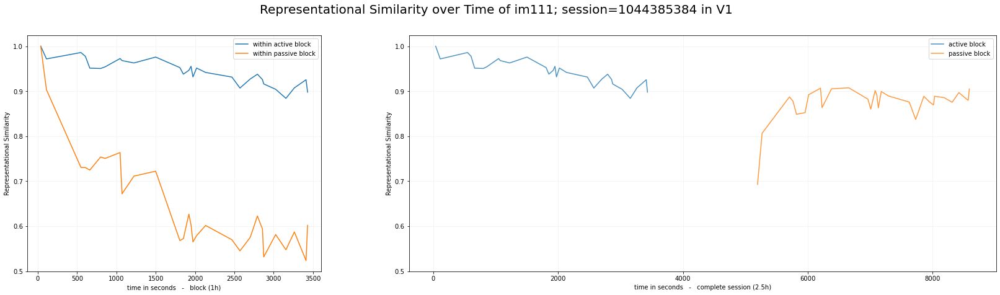

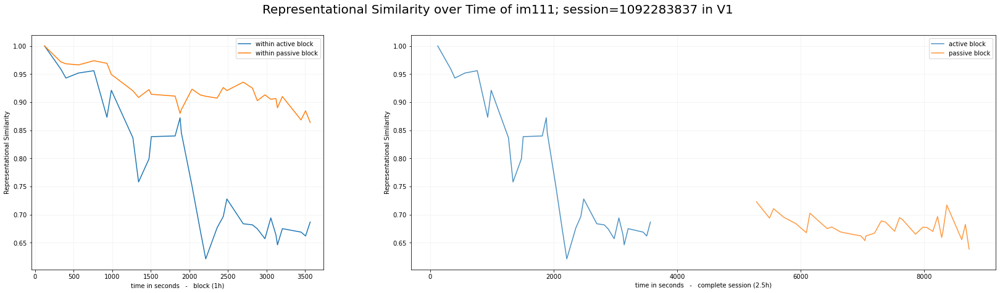

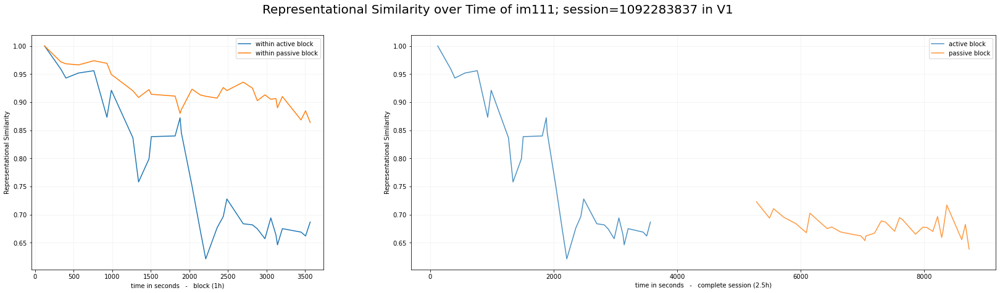

In [238]:
# loop through five new sessions to test download-analyse-delete process
session_ids = [1152632711, 1048189115, 1064644573, 1044385384, 1092283837]
sessions = all_sessions_clean(session_ids)

In [254]:
print(len(loc_sessions), len(sessions), len(loc_session_ids), len(session_ids), type(loc_sessions))
loc_sessions[0].info()
loc_sessions[1].info()
loc_sessions[2].info()
loc_sessions[3].info()
joined_sessions = [loc_sessions[0], loc_sessions[1], loc_sessions[2], loc_sessions[3], sessions[0], sessions[1], sessions[2], sessions[3], sessions[4]]
len(joined_sessions)

8 5 4 5 <class 'list'>
Hello I'm session 1053941483 of mouse 527749 
Hello I'm session 1053718935 of mouse 527749 
Hello I'm session 1124285719 of mouse 577287 
Hello I'm session 1111013640 of mouse 568963 


9

# TODO and NEXT

In [710]:
 def all_image_responses(images, M, stimulus_presentations, session, brain_structure):
    
    x_1st_half_list = []  # block0
    x_2nd_half_list = []  # block5
    
    y_1_list = []         # active         RS
    y_2_list = []         # active-passive RS
    y_3_list = []         # passive        RS
    
    for image in images:
        
        # get image specific unit activities
        M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M, image, stimulus_presentations)

        # get the Representational Similarity
        C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
        C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
        C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

        half = len(C_rd_active)

        across_blocks2 = C_reduced[:half, half:]

        x = timings
        
        y_1 = C_rd_active
        y_2 = across_blocks2
        y_3 = C_rd_passive
        
        x_1st_half_list.append(x[:half])
        x_2nd_half_list.append(x[half:])
        
        y_1_list.append(y_1)
        y_2_list.append(y_2)
        y_3_list.append(y_3)
        
        
    x1_list = np.empty(shape=(0,100))
    x2_list = np.empty(shape=(0,100))
    
    y1_list = np.empty(shape=(0,100))
    y2_list = np.empty(shape=(0,100))
    y3_list = np.empty(shape=(0,100))
    
    for i, x1 in enumerate(x_1st_half_list):
        x2 = x_2nd_half_list[i]
        y1 = y_1_list[i]
        y2 = y_3_list[i]
        y3 = y_2_list[i]
        
        min_x1, max_x1 = min(x1), max(x1)
        new_x1 = np.linspace(min_x1, max_x1, 100)
        min_x2, max_x2 = min(x2), max(x2)
        new_x2 = np.linspace(min_x2, max_x2, 100)
        # print(len(new_x))
        x1_list = np.vstack((x1_list, new_x1))
        x2_list = np.vstack((x2_list, new_x2))
        
        new_y1 = np.interp(new_x1, x1, y1)
        y1_list = np.vstack((y1_list, new_y1))
        new_y2 = np.interp(new_x1, x1, y2)
        y2_list = np.vstack((y2_list, new_y2))
        new_y3 = np.interp(new_x2, x2, y3)
        y3_list = np.vstack((y3_list, new_y3))
        
        
    midx1 = np.mean(x1_list, axis=0)
    midx2 = np.mean(x2_list, axis=0)
    
    midy1 = np.mean(y1_list, axis=0)
    midy2 = np.mean(y2_list, axis=0)
    midy3 = np.mean(y3_list, axis=0)
    
    # print(len(x_list), len(y_list), x_list.shape, y_list.shape, midx.shape, midy.shape)

    fig, ax = plt.subplots(figsize=(16, 8), dpi=80)
    fig.suptitle(t=f'Representational Similarity over Time of single session {session} in {unit_set}', fontsize=20)
    
    for i in range(n):
        ax.plot(x_1st_half_list[i], y_1_list[i], c='skyblue', alpha=0.5)
        ax.plot(x_2nd_half_list[i], y_2_list[i], c='orange', alpha=0.3)

    ax.plot(midx1, midy1, '--', c='darkblue', label='active')
    ax.plot(midx2, midy3, '--', c='darkorange', label='passive')
    ax.plot(midx1, midy2, '--', c='purple', label='within passive', alpha=0.5)

    ax.set_xlabel('time in seconds   -   complete session (2.5h)') 
    ax.set_ylabel('Representational Similarity')
    ax.legend()
    ax.grid()
    
    # plt.savefig(f'plots/all_sessions_rs_in_{unit_set}.png')

    return (midx1, midx2, midy1, midy2, midy3)
        

In [711]:
all_image_responses(valid_images, M_good_VISp, stimulus_presentations, sessionID, 'V1')

ValueError: object too deep for desired array

In [707]:
sessionID

1053718935

In [708]:
valid_images

['im036_r',
 'im083_r',
 'im111_r',
 'im012_r',
 'im115_r',
 'im044_r',
 'im047_r',
 'im078_r']